In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
import nltk
from wordcloud import WordCloud
from nltk.corpus import stopwords
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.preprocessing import LabelEncoder
from imblearn.over_sampling import SMOTE
from gensim.models import Word2Vec
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.metrics import classification_report
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, Conv1D, MaxPooling1D, GlobalMaxPooling1D, Dense,Dropout,BatchNormalization, Input
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers.legacy import Adam
from tensorflow.keras.layers import Embedding, LSTM, Dense, Conv1D, GlobalMaxPooling1D
from sklearn.model_selection import StratifiedKFold

In [2]:
df = pd.read_csv('dataset_skripsi_clean_labeling_fix.csv',delimiter=';')
df

,Unnamed: 0,text,label
0,0,terimakasih tonton langsung lewat menit,Neutral
1,1,keren panji berani botak kritis apatis,Negative
2,2,prabowo masuk akal titik gagasanya muter,Positive
3,3,refleksi anies refleksi ganjar pranowo refleks...,Neutral
4,4,menit prabowo bilang aset mandek kuasa iya tol...,Neutral
...,...,...,...
17823,17965,kandidat ganjar pranowo calon presiden ideal p...,Neutral
17824,17966,tertawa data bps yohanes mnjabat tingkat miski...,Neutral
17825,17968,nampancoklat orang jawa tengah kadrun masuk ke...,Negative
17826,17969,prabowo halang urus rumah tanga beranta urus n...,Negative


In [3]:
df.dropna(inplace=True)
df.reset_index(drop=True, inplace=True)
df

,Unnamed: 0,text,label
0,0,terimakasih tonton langsung lewat menit,Neutral
1,1,keren panji berani botak kritis apatis,Negative
2,2,prabowo masuk akal titik gagasanya muter,Positive
3,3,refleksi anies refleksi ganjar pranowo refleks...,Neutral
4,4,menit prabowo bilang aset mandek kuasa iya tol...,Neutral
...,...,...,...
17823,17965,kandidat ganjar pranowo calon presiden ideal p...,Neutral
17824,17966,tertawa data bps yohanes mnjabat tingkat miski...,Neutral
17825,17968,nampancoklat orang jawa tengah kadrun masuk ke...,Negative
17826,17969,prabowo halang urus rumah tanga beranta urus n...,Negative


In [5]:
df['label'].value_counts()

label
Neutral     9047
Negative    4553
Positive    4228
Name: count, dtype: int64

In [5]:
import multiprocessing
from time import time
cores = multiprocessing.cpu_count() # Count the number of cores in a computer
print("Total Core Computer : {} Core".format(cores))

Total Core Computer : 8 Core


In [6]:
from gensim.models import Word2Vec
tokenized_data = df['text'].apply(lambda x: x.split())  # tokenizing
model_w2v = Word2Vec(
    tokenized_data,
    vector_size=100,  # desired no. of features/independent variables
    window=5,  # context window size
    min_count=2,  # Ignores all words with total frequency lower than 2.
    sg=0,  # 1 for skip-gram model
    hs=0,
    negative=20,  # for negative sampling
    workers=cores - 4,  # no.of cores
    epochs=100
)
print(model_w2v)
print("Vocabulary Length:", len(model_w2v.wv.key_to_index))

Word2Vec<vocab=5528, vector_size=100, alpha=0.025>
Vocabulary Length: 5528


In [6]:
t = time()

model_w2v.build_vocab(tokenized_data, progress_per=10000)

print('Time to build vocab: {} mins'.format(round((time() - t) / 60, 2)))

NameError: name 'time' is not defined

In [8]:
train_mw2v = model_w2v.train(tokenized_data, total_examples=len(df['text']), epochs=50, report_delay=1)
print(train_mw2v)
print('Time to build vocab: {} mins'.format(round((time() - t) / 60, 2)))

(5524897, 7537000)
Time to build vocab: 0.18 mins


In [13]:
# Tokenize text data
max_len = 50
tokenizer = Tokenizer(num_words=len(model_w2v.wv.key_to_index))
tokenizer.fit_on_texts(df['text'])
text = tokenizer.texts_to_sequences(df['text'])
# Pad sequences
text = pad_sequences(text, maxlen=max_len, padding='post', truncating='post')

In [14]:
num_words = 50
embedding_dim = 100
embedding_matrix = np.zeros((num_words, embedding_dim))

embedding_matrix = np.zeros((len(tokenizer.word_index) + 1, embedding_dim))  # Initialize with zeros
for word, i in tokenizer.word_index.items():
    if word in model_w2v.wv.key_to_index:
        embedding_matrix[i] = model_w2v.wv[word]

In [15]:
X=df['text']
encoder = LabelEncoder()
y = encoder.fit_transform(df['label'])

In [16]:
# Perform SMOTE oversampling on training data
smote = SMOTE(random_state=0)
X_train_smote, y_train_smote = smote.fit_resample(text, y)

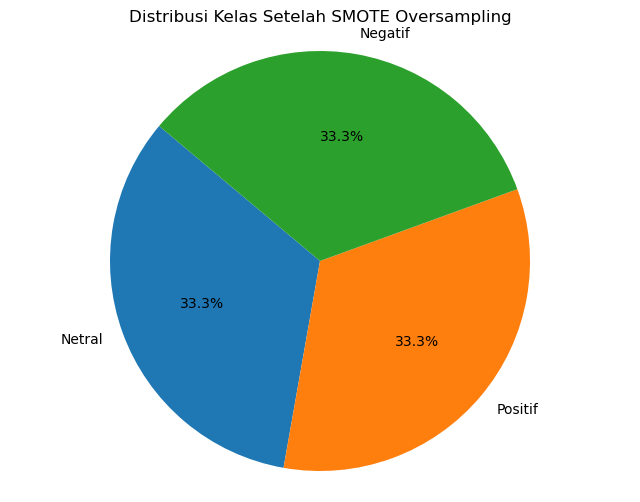

In [17]:
class_counts = pd.Series(y_train_smote).value_counts()

# Daftar label untuk klasifikasi (0=netral, 1=positif, 2=negatif)
labels = ['Netral', 'Positif', 'Negatif']

# Plot diagram lingkaran
plt.figure(figsize=(8, 6))
plt.pie(class_counts, labels=labels, autopct='%1.1f%%', startangle=140)
plt.title('Distribusi Kelas Setelah SMOTE Oversampling')
plt.axis('equal')  # Membuat diagram lingkaran menjadi lingkaran
plt.show()

In [18]:
pd.value_counts(y_train_smote)

C:\Users\ekaad\AppData\Local\Temp\ipykernel_4616\585918252.py:1: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  pd.value_counts(y_train_smote)


2    8927
0    8927
1    8927
Name: count, dtype: int64

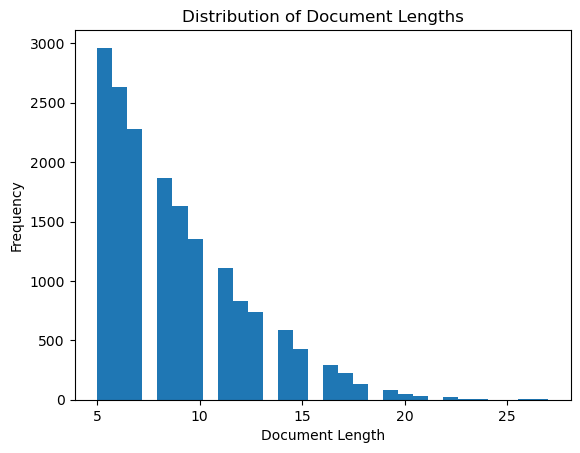

In [19]:
# Split data into train and test sets
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Tokenize
tokenizer = Tokenizer()
tokenizer.fit_on_texts(df['text'])
# Tokenize text to get lengths
tokenized_text = tokenizer.texts_to_sequences(df['text'])
lengths = [len(seq) for seq in tokenized_text]

# Plot the distribution
plt.hist(lengths, bins=30)
plt.title('Distribution of Document Lengths')
plt.xlabel('Document Length')
plt.ylabel('Frequency')
plt.show()

In [20]:
label_encoder = LabelEncoder()
train_df['label'] = label_encoder.fit_transform(train_df['label'])
test_df['label'] = label_encoder.transform(test_df['label'])

In [21]:
y_train = to_categorical(train_df['label'])
y_test = to_categorical(test_df['label'])

# KLO MAU CEK PERVARIASI

Number of Epochs: 10, Test Size: 0.15, Validation Size: 0.15
Fold 1


Epoch 1/10


230/230 [==============================] - 3s 7ms/step - loss: 1.5102 - accuracy: 0.5202 - val_loss: 0.7785 - val_accuracy: 0.6635
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.8976 - accuracy: 0.6183 - val_loss: 0.7237 - val_accuracy: 0.6865
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.7701 - accuracy: 0.6646 - val_loss: 0.7080 - val_accuracy: 0.7001
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.7183 - accuracy: 0.6872 - val_loss: 0.6868 - val_accuracy: 0.7128
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.6886 - accuracy: 0.6980 - val_loss: 0.6775 - val_accuracy: 0.7147
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.6636 - accuracy: 0.7133 - val_loss: 0.6609 - val_accuracy: 0.7278
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7264195213514781, Validation F1 Score: 0.7227766877380322


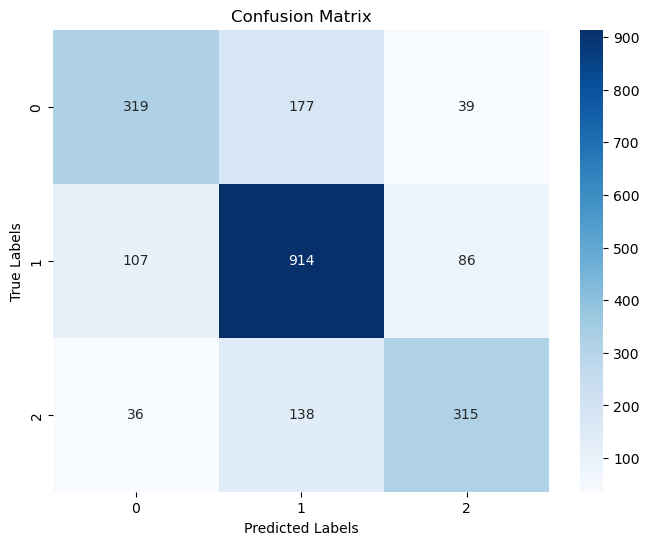

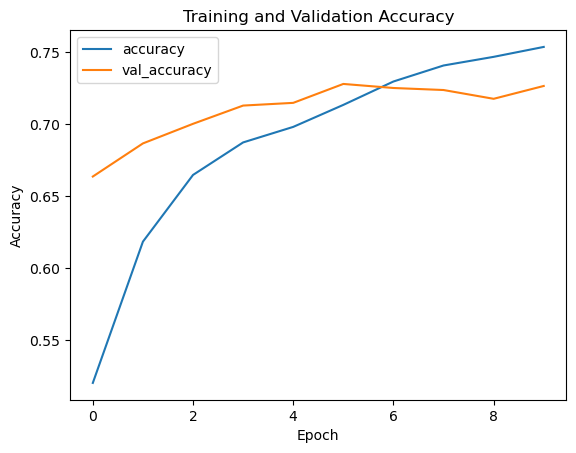

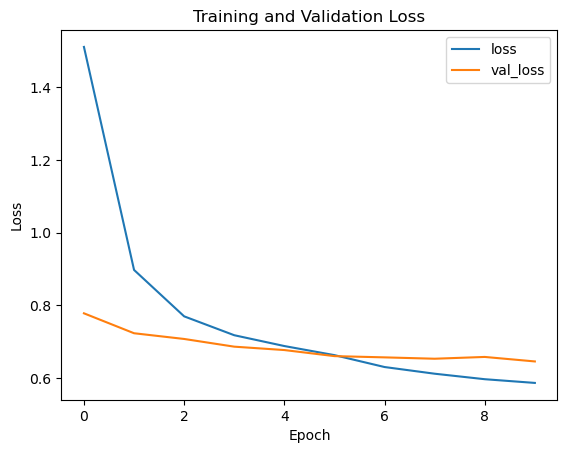

Fold 2
Epoch 1/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5701 - accuracy: 0.7629 - val_loss: 0.6493 - val_accuracy: 0.7255
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5502 - accuracy: 0.7694 - val_loss: 0.6529 - val_accuracy: 0.7255
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5336 - accuracy: 0.7786 - val_loss: 0.6533 - val_accuracy: 0.7255
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5353 - accuracy: 0.7773 - val_loss: 0.6579 - val_accuracy: 0.7264
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5147 - accuracy: 0.7824 - val_loss: 0.6625 - val_accuracy: 0.7245
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5057 - accuracy: 0.7878 - val_loss: 0.6579 - val_accuracy: 0.7260
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4912 - accuracy: 0.7948 - val_loss: 0.6574 - val_accuracy: 0.7194

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7301736274049742, Validation F1 Score: 0.7272941247470223


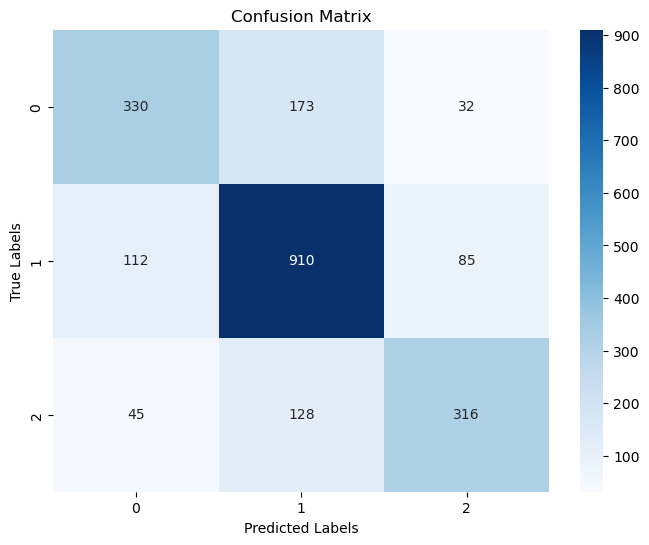

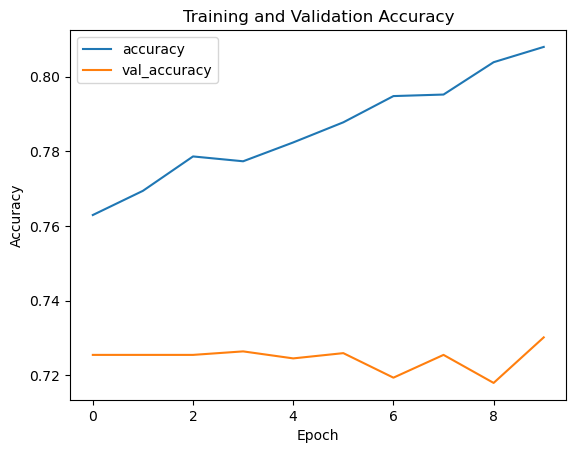

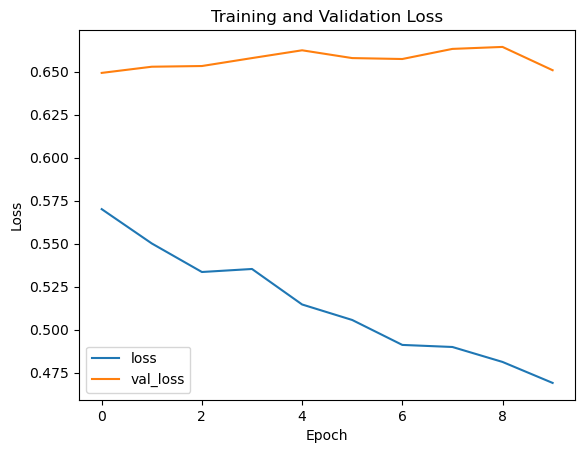

Fold 3
Epoch 1/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4524 - accuracy: 0.8162 - val_loss: 0.6640 - val_accuracy: 0.7278
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4529 - accuracy: 0.8151 - val_loss: 0.6789 - val_accuracy: 0.7109
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4457 - accuracy: 0.8222 - val_loss: 0.6673 - val_accuracy: 0.7255
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4447 - accuracy: 0.8198 - val_loss: 0.6774 - val_accuracy: 0.7274
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4136 - accuracy: 0.8314 - val_loss: 0.6893 - val_accuracy: 0.7142
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4282 - accuracy: 0.8263 - val_loss: 0.6721 - val_accuracy: 0.7283
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4149 - accuracy: 0.8320 - val_loss: 0.6870 - val_accuracy: 0.7255

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7193805725011732, Validation F1 Score: 0.7156999253230667


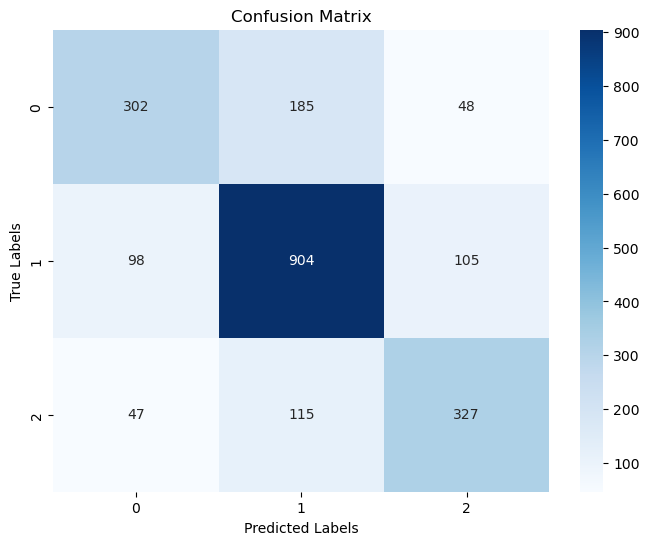

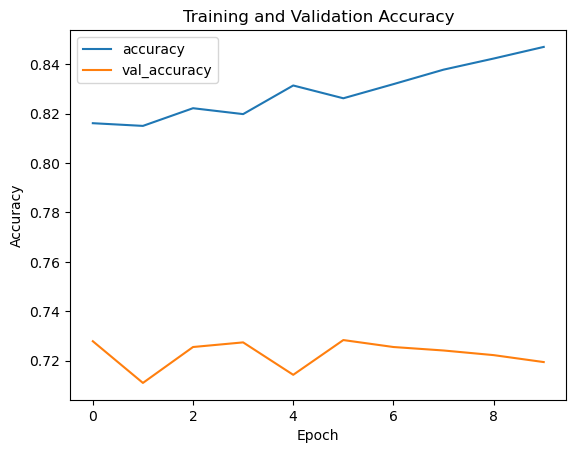

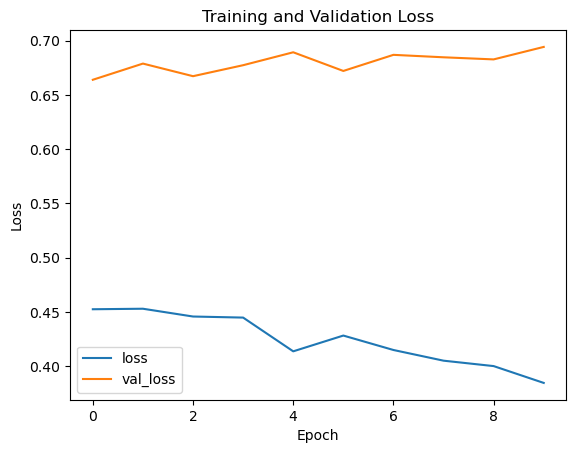

Fold 4
Epoch 1/10
230/230 [==============================] - 2s 6ms/step - loss: 0.3875 - accuracy: 0.8466 - val_loss: 0.7144 - val_accuracy: 0.7208
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3804 - accuracy: 0.8475 - val_loss: 0.7094 - val_accuracy: 0.7255
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3815 - accuracy: 0.8451 - val_loss: 0.7092 - val_accuracy: 0.7189
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3815 - accuracy: 0.8463 - val_loss: 0.7068 - val_accuracy: 0.7208
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3630 - accuracy: 0.8569 - val_loss: 0.7241 - val_accuracy: 0.7227
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3550 - accuracy: 0.8572 - val_loss: 0.7256 - val_accuracy: 0.7208
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3549 - accuracy: 0.8577 - val_loss: 0.7223 - val_accuracy: 0.7208

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7311121539183482, Validation F1 Score: 0.7277981215504844


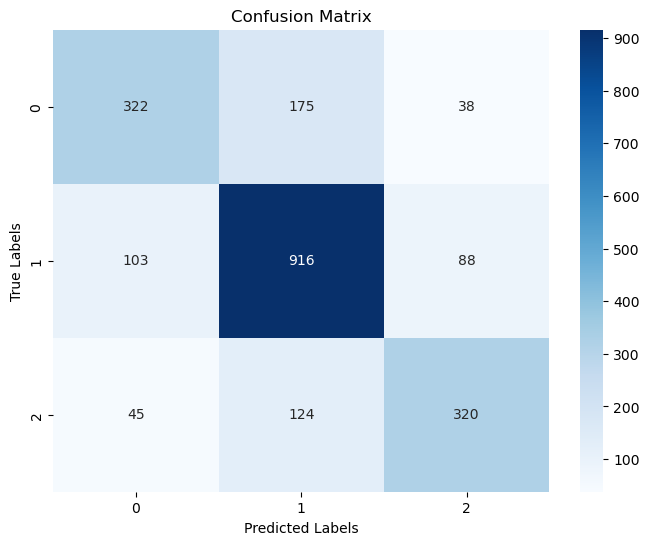

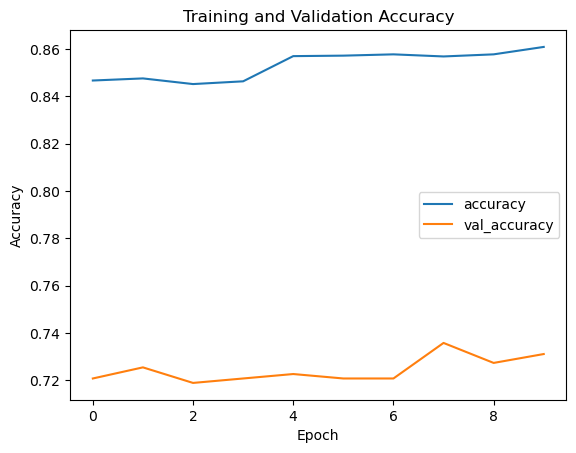

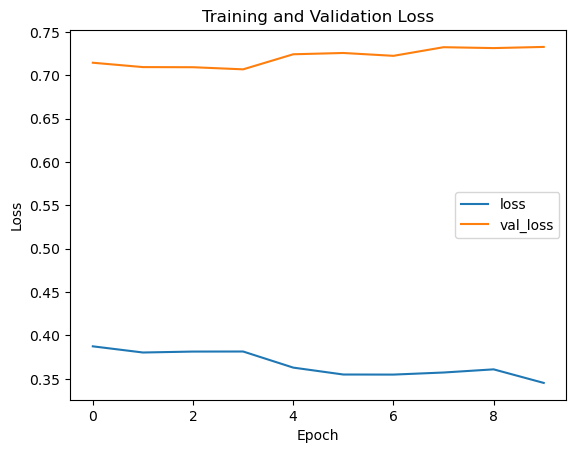

Fold 5
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.3532 - accuracy: 0.8596 - val_loss: 0.7328 - val_accuracy: 0.7274
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3391 - accuracy: 0.8653 - val_loss: 0.7402 - val_accuracy: 0.7260
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3367 - accuracy: 0.8646 - val_loss: 0.7529 - val_accuracy: 0.7330
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3333 - accuracy: 0.8668 - val_loss: 0.7396 - val_accuracy: 0.7288
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3308 - accuracy: 0.8726 - val_loss: 0.7534 - val_accuracy: 0.7260
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3242 - accuracy: 0.8777 - val_loss: 0.7565 - val_accuracy: 0.7278
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3200 - accuracy: 0.8723 - val_loss: 0.7758 - val_accuracy: 0.7274

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7287658376349132, Validation F1 Score: 0.7237139665379841


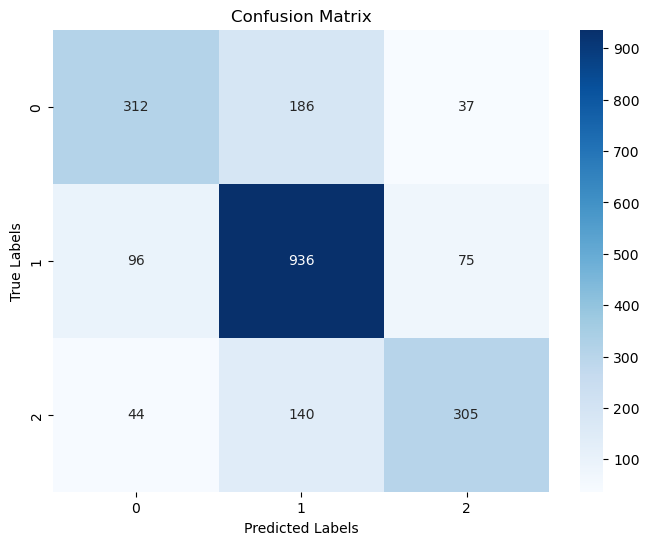

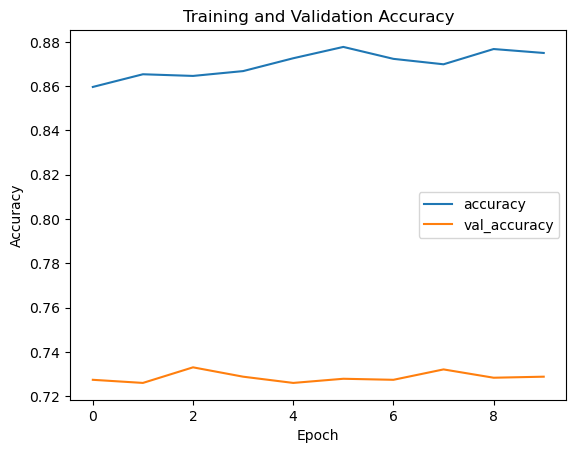

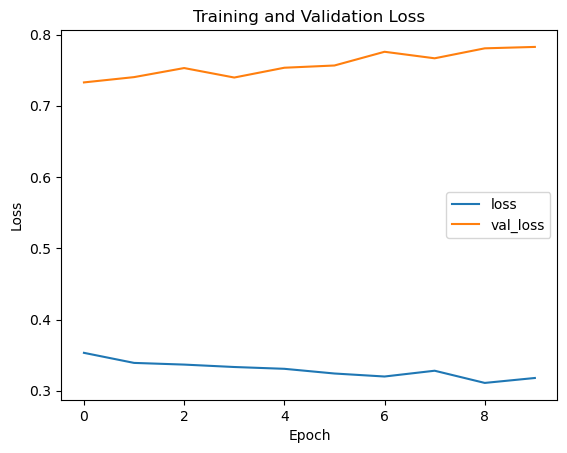

Fold 6
Epoch 1/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3169 - accuracy: 0.8773 - val_loss: 0.7698 - val_accuracy: 0.7288
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3205 - accuracy: 0.8771 - val_loss: 0.7937 - val_accuracy: 0.7316
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3088 - accuracy: 0.8766 - val_loss: 0.7736 - val_accuracy: 0.7321
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2977 - accuracy: 0.8859 - val_loss: 0.8008 - val_accuracy: 0.7269
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3070 - accuracy: 0.8784 - val_loss: 0.7799 - val_accuracy: 0.7288
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3114 - accuracy: 0.8776 - val_loss: 0.7963 - val_accuracy: 0.7335
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2938 - accuracy: 0.8826 - val_loss: 0.8104 - val_accuracy: 0.7311

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 3ms/step
Validation Accuracy: 0.7264195213514781, Validation F1 Score: 0.7221246243521643


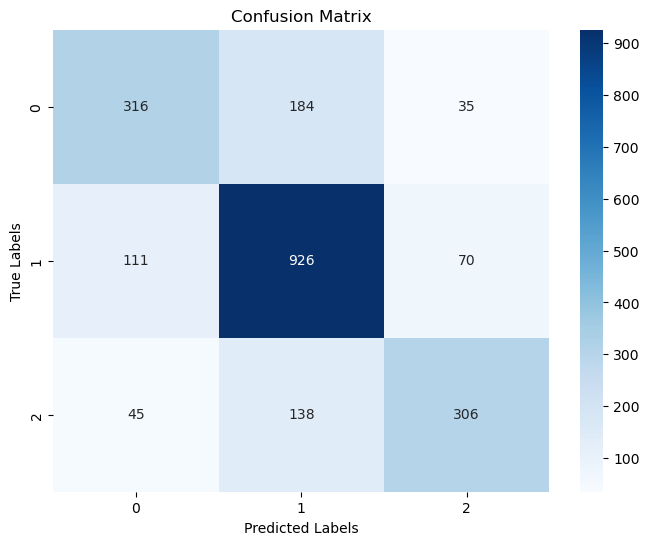

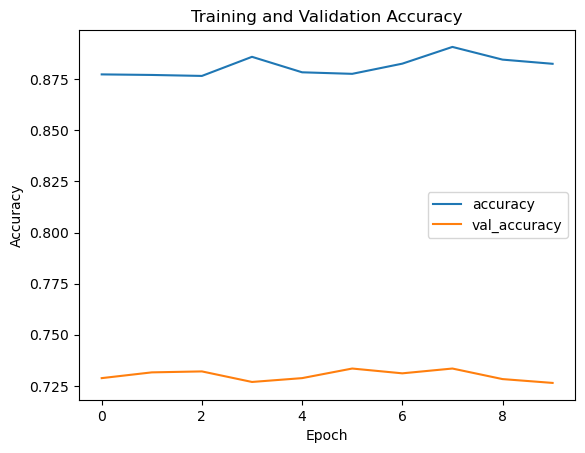

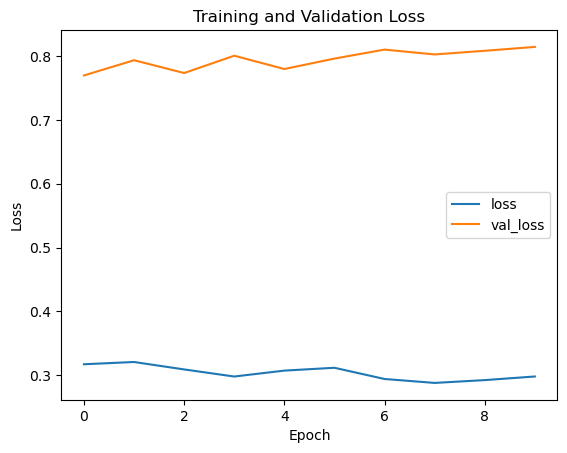

Fold 7
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.2939 - accuracy: 0.8868 - val_loss: 0.8016 - val_accuracy: 0.7213
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2878 - accuracy: 0.8880 - val_loss: 0.8147 - val_accuracy: 0.7245
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2855 - accuracy: 0.8882 - val_loss: 0.8213 - val_accuracy: 0.7321
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2899 - accuracy: 0.8899 - val_loss: 0.8332 - val_accuracy: 0.7250
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2777 - accuracy: 0.8890 - val_loss: 0.8364 - val_accuracy: 0.7227
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2853 - accuracy: 0.8887 - val_loss: 0.8475 - val_accuracy: 0.7255
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2827 - accuracy: 0.8903 - val_loss: 0.8427 - val_accuracy: 0.7269

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7231346785546692, Validation F1 Score: 0.7215605966902467


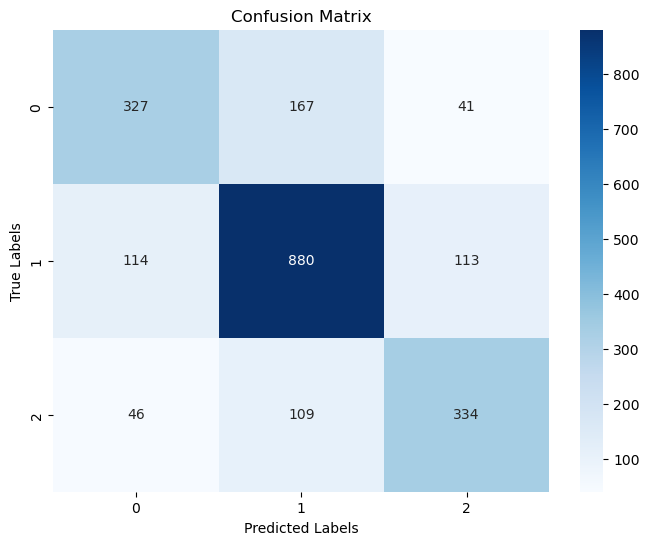

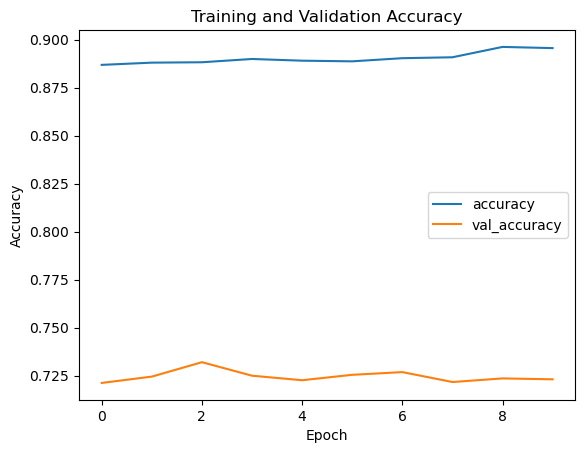

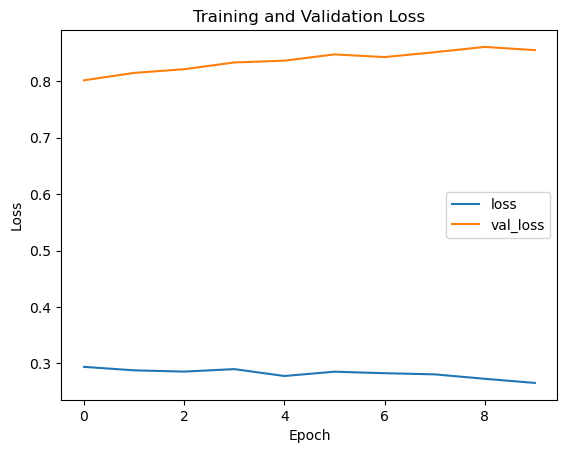

Fold 8
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.2727 - accuracy: 0.8927 - val_loss: 0.8939 - val_accuracy: 0.7189
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2667 - accuracy: 0.8977 - val_loss: 0.8911 - val_accuracy: 0.7170
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2627 - accuracy: 0.8999 - val_loss: 0.8934 - val_accuracy: 0.7194
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2538 - accuracy: 0.8996 - val_loss: 0.8764 - val_accuracy: 0.7189
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2623 - accuracy: 0.8969 - val_loss: 0.8969 - val_accuracy: 0.7269
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2587 - accuracy: 0.9004 - val_loss: 0.8828 - val_accuracy: 0.7217
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2561 - accuracy: 0.8986 - val_loss: 0.8960 - val_accuracy: 0.7245

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7236039418113561, Validation F1 Score: 0.7221602117146781


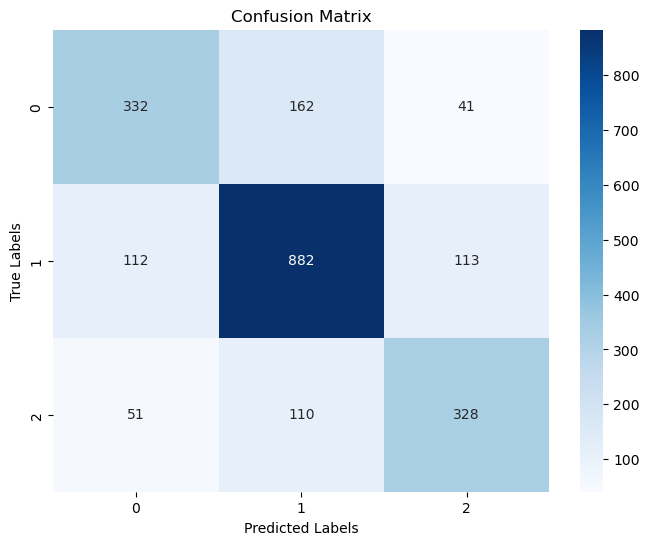

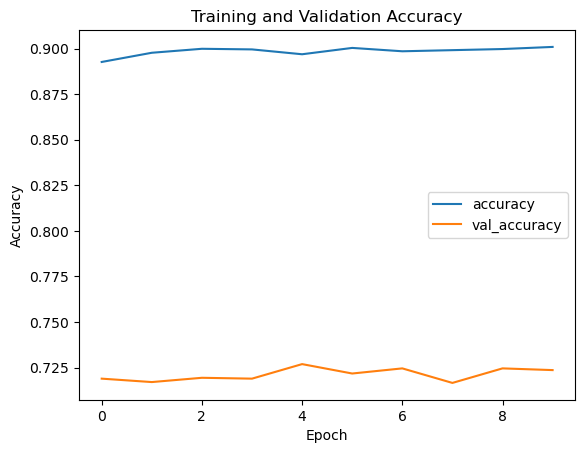

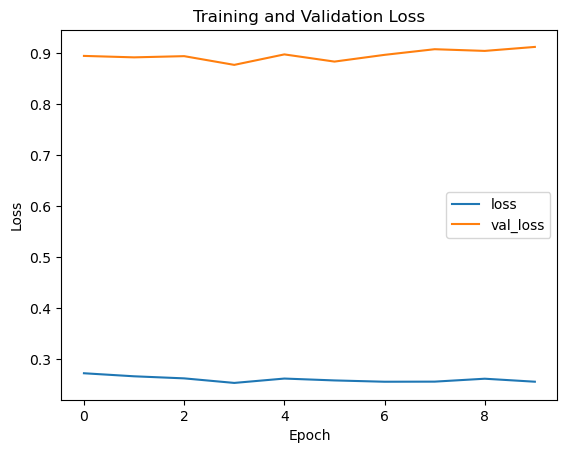

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7261262318160489
Mean F1 Score: 0.7228910323317099
Number of Epochs: 10, Test Size: 0.15, Validation Size: 0.2
Fold 1
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 1.4501 - accuracy: 0.5259 - val_loss: 0.7797 - val_accuracy: 0.6670
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.8839 - accuracy: 0.6170 - val_loss: 0.7291 - val_accuracy: 0.6897
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.7663 - accuracy: 0.6622 - val_loss: 0.7009 - val_accuracy: 0.7039
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.7125 - accuracy: 0.6909 - val_loss: 0.6860 - val_accuracy: 0.7170
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.6850 - accuracy: 0.7061 - val_loss: 0.6732 - val_accuracy: 0.7196
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.6550 - accuracy: 0.7174 - val_loss: 0.6628 - val_accuracy: 0.7261
Epoch 7/10
23

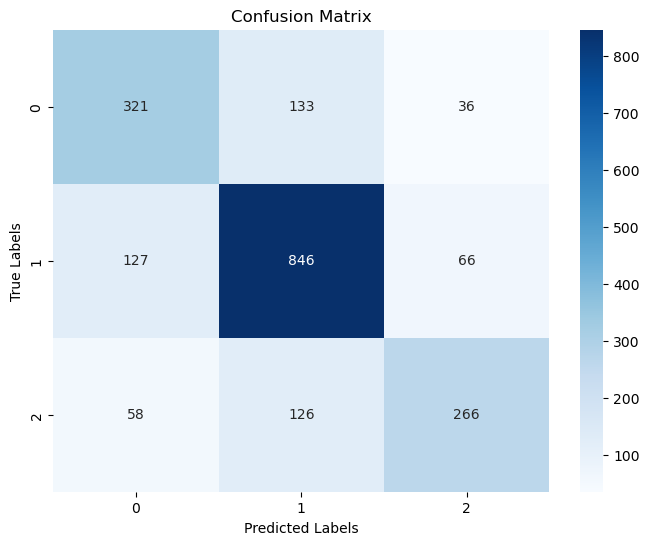

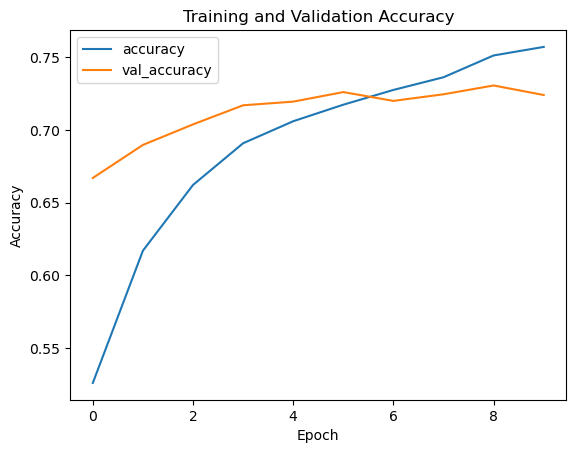

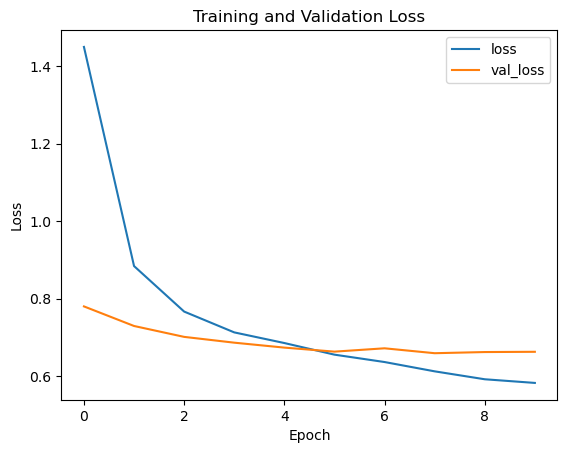

Fold 2
Epoch 1/10
230/230 [==============================] - 2s 6ms/step - loss: 0.5596 - accuracy: 0.7662 - val_loss: 0.6689 - val_accuracy: 0.7251
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5486 - accuracy: 0.7714 - val_loss: 0.6581 - val_accuracy: 0.7261
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5499 - accuracy: 0.7707 - val_loss: 0.6592 - val_accuracy: 0.7266
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5249 - accuracy: 0.7842 - val_loss: 0.6569 - val_accuracy: 0.7302
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5126 - accuracy: 0.7902 - val_loss: 0.6669 - val_accuracy: 0.7236
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5060 - accuracy: 0.7907 - val_loss: 0.6737 - val_accuracy: 0.7231
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4892 - accuracy: 0.8018 - val_loss: 0.6665 - val_accuracy: 0.7312

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7266296109146033, Validation F1 Score: 0.7256323597509127


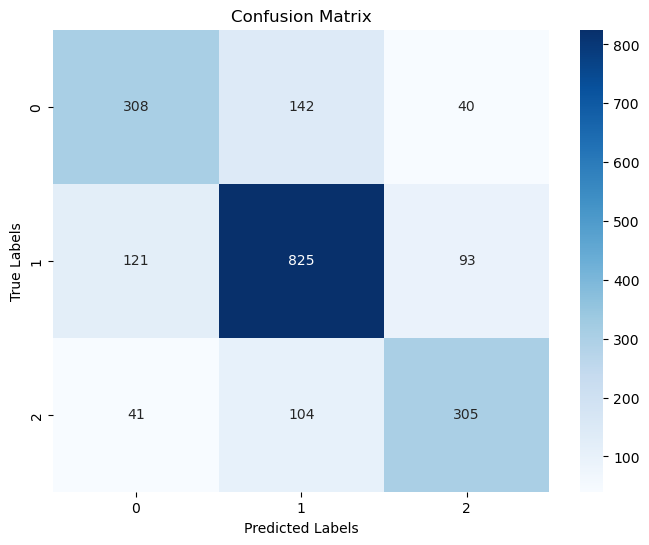

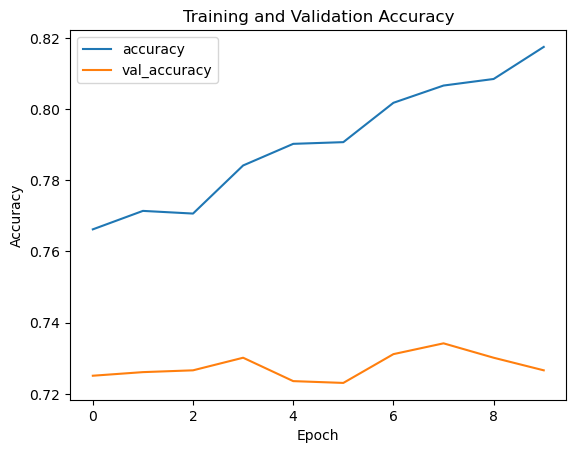

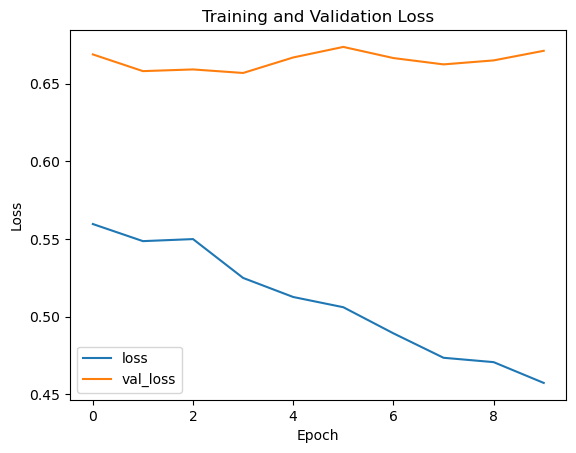

Fold 3
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.4470 - accuracy: 0.8179 - val_loss: 0.6730 - val_accuracy: 0.7332
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4473 - accuracy: 0.8202 - val_loss: 0.6696 - val_accuracy: 0.7372
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4279 - accuracy: 0.8295 - val_loss: 0.6752 - val_accuracy: 0.7377
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4266 - accuracy: 0.8275 - val_loss: 0.6774 - val_accuracy: 0.7347
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4312 - accuracy: 0.8304 - val_loss: 0.6800 - val_accuracy: 0.7352
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4120 - accuracy: 0.8358 - val_loss: 0.6800 - val_accuracy: 0.7307
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4251 - accuracy: 0.8288 - val_loss: 0.6818 - val_accuracy: 0.7342

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7241030823648307, Validation F1 Score: 0.7191806354234735


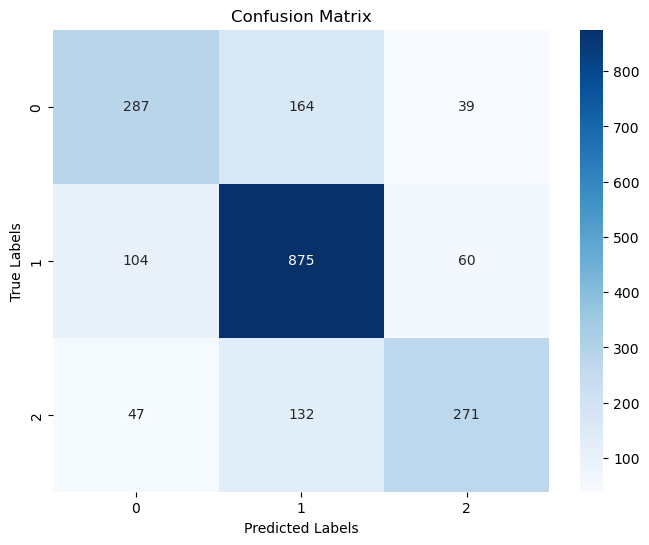

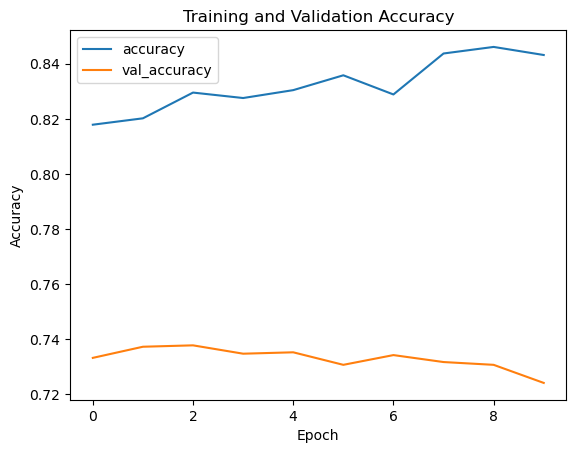

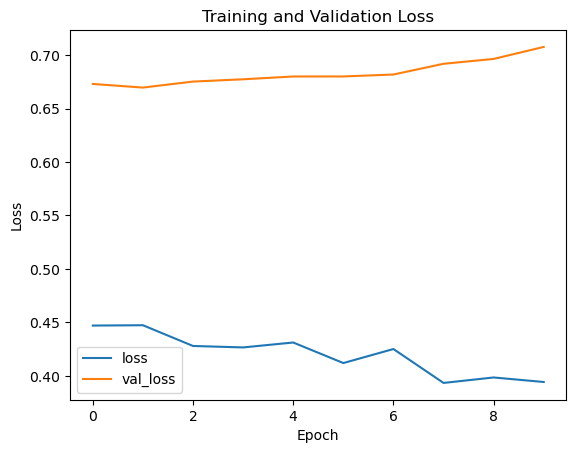

Fold 4
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.3841 - accuracy: 0.8434 - val_loss: 0.6960 - val_accuracy: 0.7383
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3738 - accuracy: 0.8545 - val_loss: 0.7071 - val_accuracy: 0.7322
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3656 - accuracy: 0.8523 - val_loss: 0.7129 - val_accuracy: 0.7312
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3628 - accuracy: 0.8573 - val_loss: 0.7225 - val_accuracy: 0.7292
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3618 - accuracy: 0.8567 - val_loss: 0.7169 - val_accuracy: 0.7297
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3592 - accuracy: 0.8609 - val_loss: 0.7214 - val_accuracy: 0.7281
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3485 - accuracy: 0.8637 - val_loss: 0.7305 - val_accuracy: 0.7236

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7367357251136938, Validation F1 Score: 0.7336897217692148


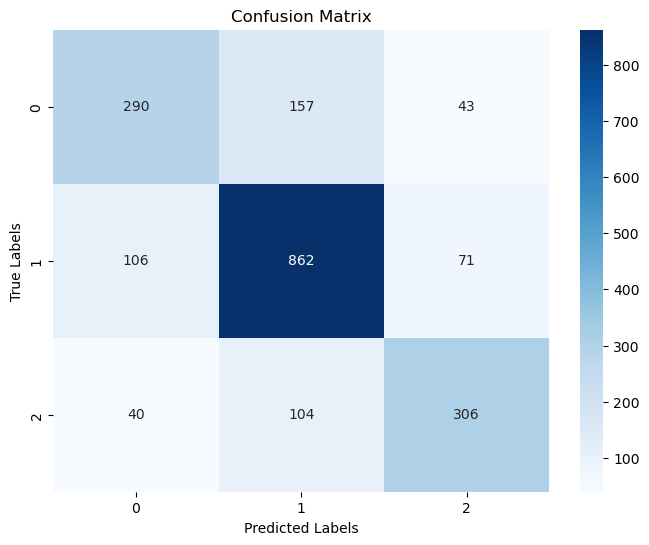

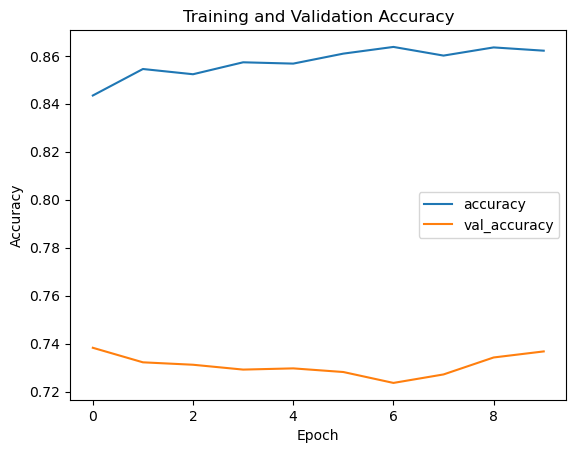

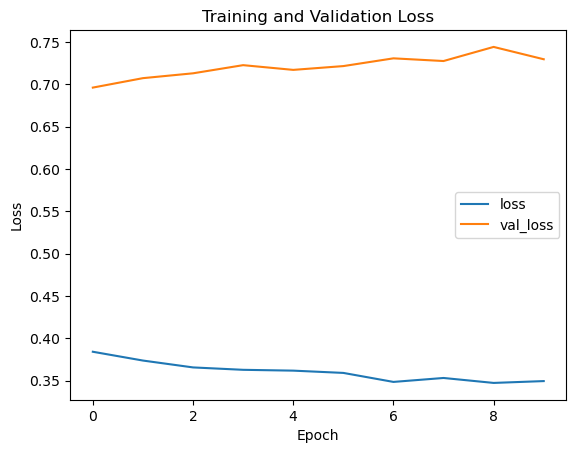

Fold 5
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.3323 - accuracy: 0.8696 - val_loss: 0.7482 - val_accuracy: 0.7241
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3283 - accuracy: 0.8708 - val_loss: 0.7619 - val_accuracy: 0.7271
Epoch 3/10
230/230 [==============================] - 1s 7ms/step - loss: 0.3320 - accuracy: 0.8693 - val_loss: 0.7459 - val_accuracy: 0.7377
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3156 - accuracy: 0.8790 - val_loss: 0.7671 - val_accuracy: 0.7337
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3212 - accuracy: 0.8741 - val_loss: 0.7544 - val_accuracy: 0.7367
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3192 - accuracy: 0.8747 - val_loss: 0.7698 - val_accuracy: 0.7337
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3195 - accuracy: 0.8714 - val_loss: 0.7899 - val_accuracy: 0.7307

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7251136937847398, Validation F1 Score: 0.7221540554158482


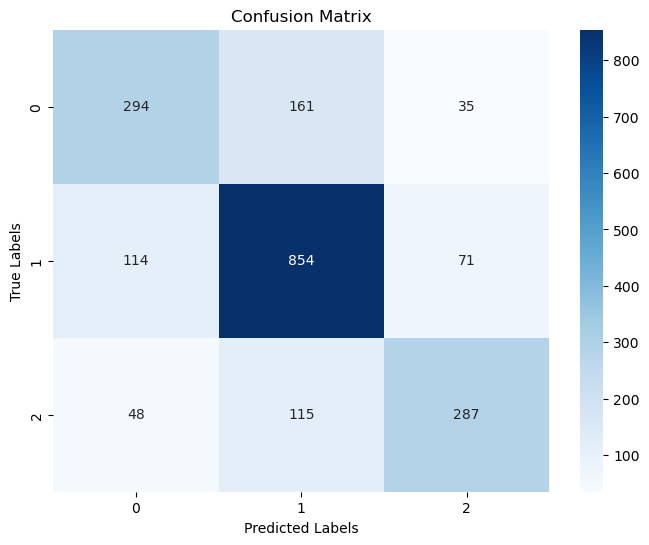

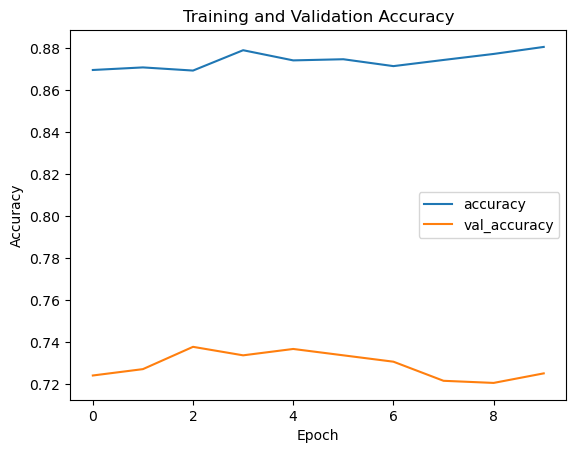

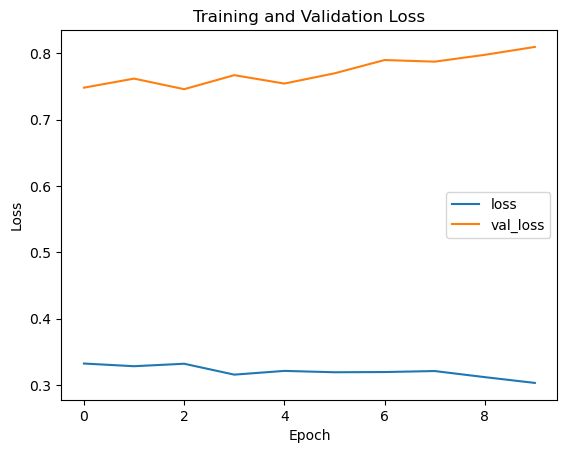

Fold 6
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.2993 - accuracy: 0.8822 - val_loss: 0.8137 - val_accuracy: 0.7271
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3031 - accuracy: 0.8810 - val_loss: 0.8032 - val_accuracy: 0.7261
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3042 - accuracy: 0.8804 - val_loss: 0.8088 - val_accuracy: 0.7271
Epoch 4/10
230/230 [==============================] - 2s 7ms/step - loss: 0.3028 - accuracy: 0.8786 - val_loss: 0.8269 - val_accuracy: 0.7160
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3016 - accuracy: 0.8831 - val_loss: 0.8434 - val_accuracy: 0.7180
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2967 - accuracy: 0.8829 - val_loss: 0.8352 - val_accuracy: 0.7120
Epoch 7/10
230/230 [==============================] - 1s 7ms/step - loss: 0.2937 - accuracy: 0.8858 - val_loss: 0.8480 - val_accuracy: 0.7105

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.71955533097524, Validation F1 Score: 0.7157276320904651


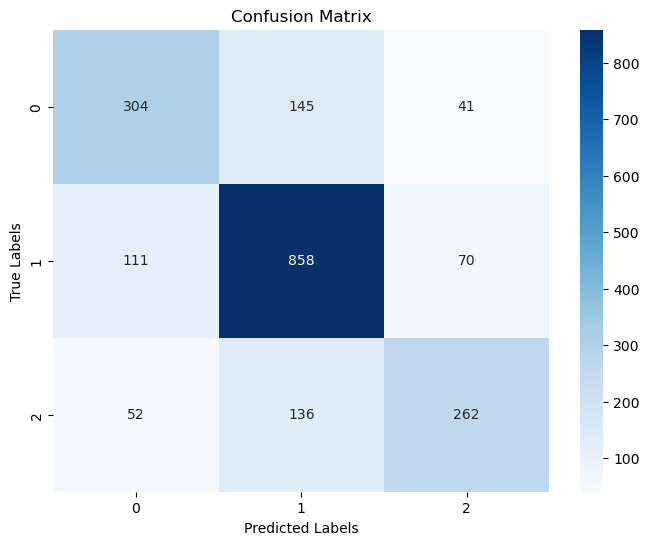

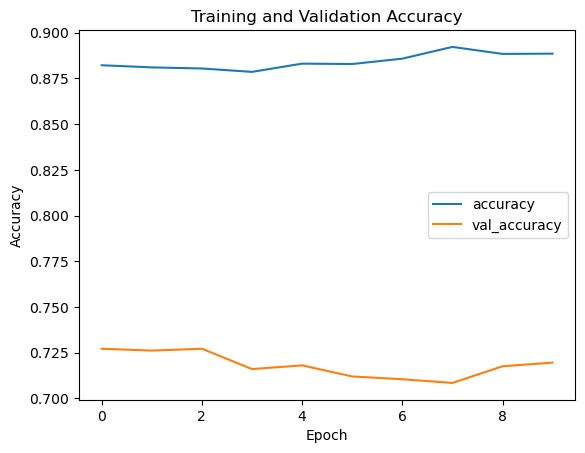

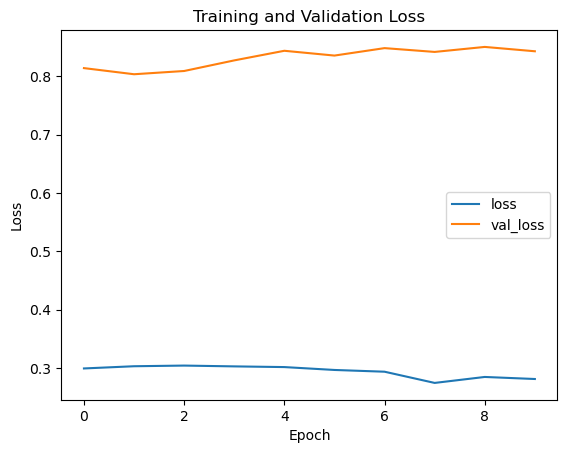

Fold 7
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.2772 - accuracy: 0.8914 - val_loss: 0.8605 - val_accuracy: 0.7145
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2930 - accuracy: 0.8867 - val_loss: 0.8542 - val_accuracy: 0.7216
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2803 - accuracy: 0.8923 - val_loss: 0.8697 - val_accuracy: 0.7216
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2754 - accuracy: 0.8928 - val_loss: 0.8626 - val_accuracy: 0.7266
Epoch 5/10
230/230 [==============================] - 2s 7ms/step - loss: 0.2785 - accuracy: 0.8934 - val_loss: 0.8620 - val_accuracy: 0.7165
Epoch 6/10
230/230 [==============================] - 2s 7ms/step - loss: 0.2749 - accuracy: 0.8944 - val_loss: 0.8632 - val_accuracy: 0.7206
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2740 - accuracy: 0.8936 - val_loss: 0.8709 - val_accuracy: 0.7271

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7155128852956039, Validation F1 Score: 0.7125927511581878


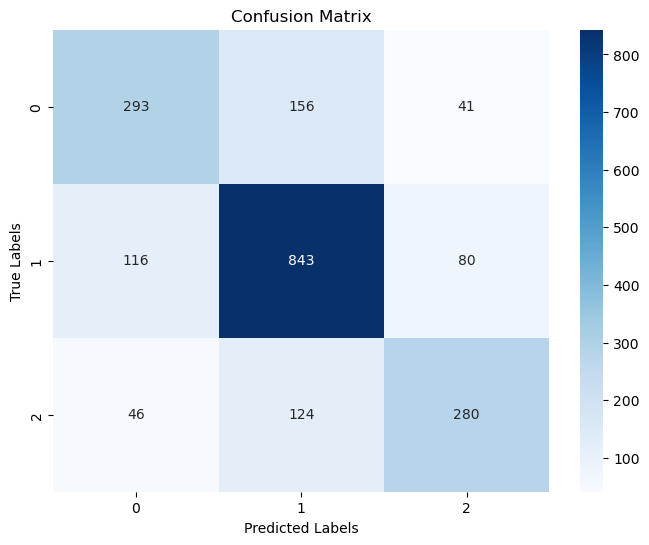

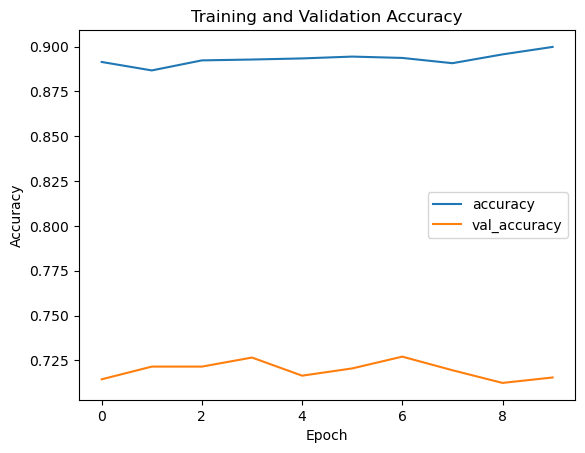

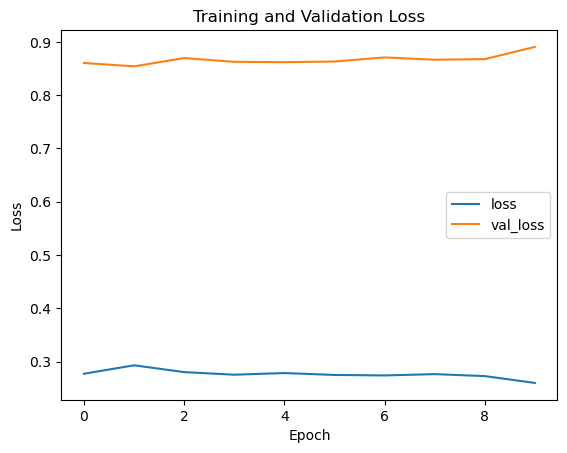

Fold 8
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.2576 - accuracy: 0.9004 - val_loss: 0.8963 - val_accuracy: 0.7165
Epoch 2/10
230/230 [==============================] - 2s 6ms/step - loss: 0.2718 - accuracy: 0.8960 - val_loss: 0.8895 - val_accuracy: 0.7165
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2669 - accuracy: 0.8979 - val_loss: 0.8926 - val_accuracy: 0.7221
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2597 - accuracy: 0.9000 - val_loss: 0.8930 - val_accuracy: 0.7251
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2603 - accuracy: 0.9019 - val_loss: 0.8925 - val_accuracy: 0.7241
Epoch 6/10
230/230 [==============================] - 2s 7ms/step - loss: 0.2523 - accuracy: 0.8979 - val_loss: 0.9124 - val_accuracy: 0.7135
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2592 - accuracy: 0.9014 - val_loss: 0.9063 - val_accuracy: 0.7231

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.71955533097524, Validation F1 Score: 0.7165481030551409


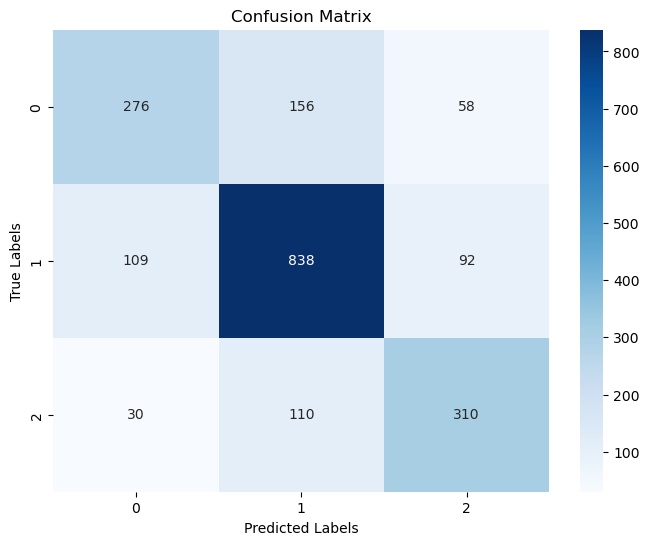

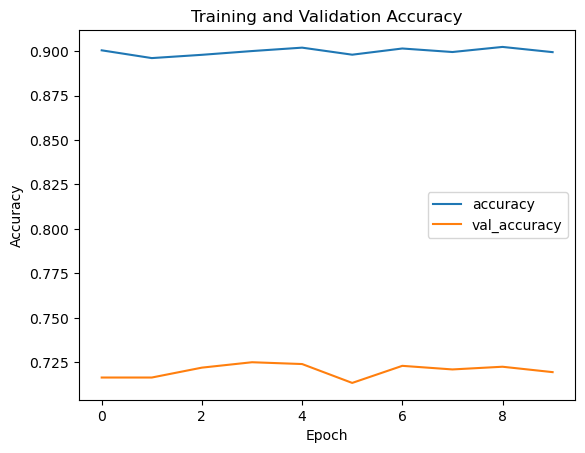

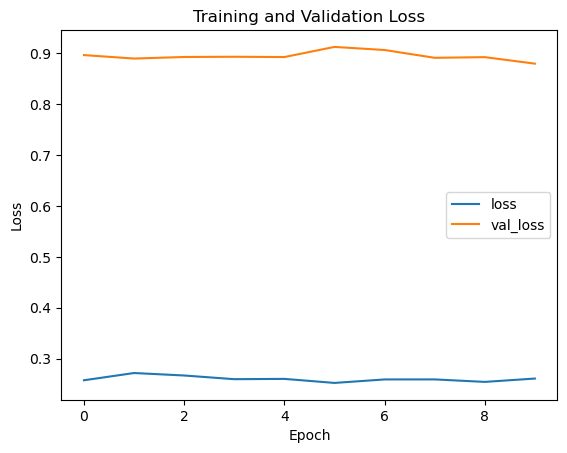

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7239135927235978
Mean F1 Score: 0.7209171290181651
Number of Epochs: 10, Test Size: 0.15, Validation Size: 0.25
Fold 1
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 1.5414 - accuracy: 0.5259 - val_loss: 0.7917 - val_accuracy: 0.6681
Epoch 2/10
230/230 [==============================] - 2s 7ms/step - loss: 0.9127 - accuracy: 0.6135 - val_loss: 0.7376 - val_accuracy: 0.6824
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.7722 - accuracy: 0.6608 - val_loss: 0.7040 - val_accuracy: 0.6939
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.7160 - accuracy: 0.6893 - val_loss: 0.6867 - val_accuracy: 0.7229
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.6824 - accuracy: 0.7061 - val_loss: 0.6811 - val_accuracy: 0.7147
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.6591 - accuracy: 0.7170 - val_loss: 0.6661 - val_accuracy: 0.7267
Epoch 7/10
2

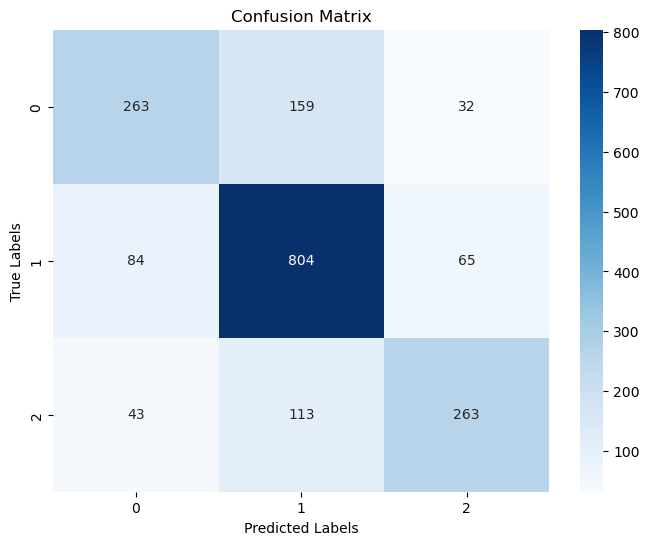

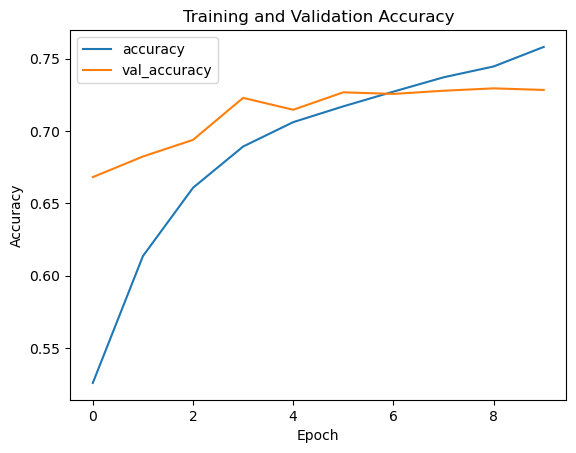

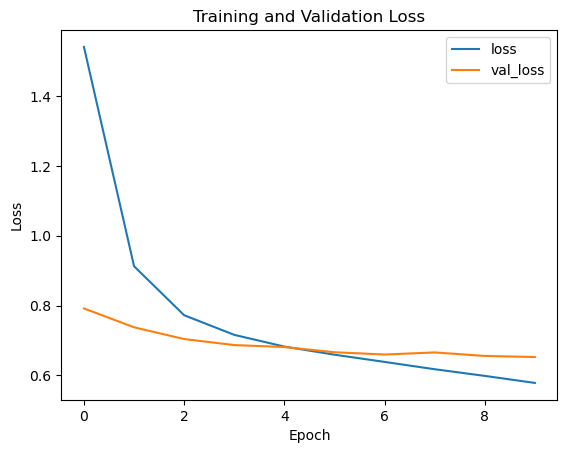

Fold 2
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.5651 - accuracy: 0.7627 - val_loss: 0.6481 - val_accuracy: 0.7300
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5622 - accuracy: 0.7625 - val_loss: 0.6447 - val_accuracy: 0.7388
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5408 - accuracy: 0.7737 - val_loss: 0.6509 - val_accuracy: 0.7421
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5280 - accuracy: 0.7820 - val_loss: 0.6471 - val_accuracy: 0.7333
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5151 - accuracy: 0.7855 - val_loss: 0.6610 - val_accuracy: 0.7344
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.5064 - accuracy: 0.7934 - val_loss: 0.6525 - val_accuracy: 0.7432
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4990 - accuracy: 0.7930 - val_loss: 0.6523 - val_accuracy: 0.7360

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7371303395399781, Validation F1 Score: 0.7326614735491357


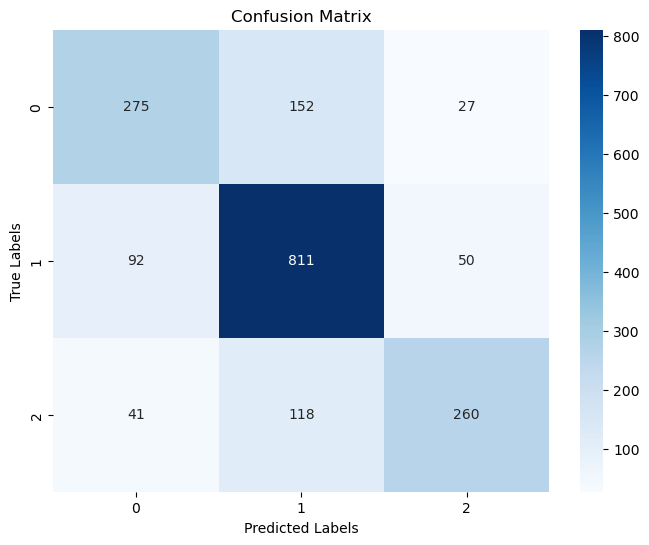

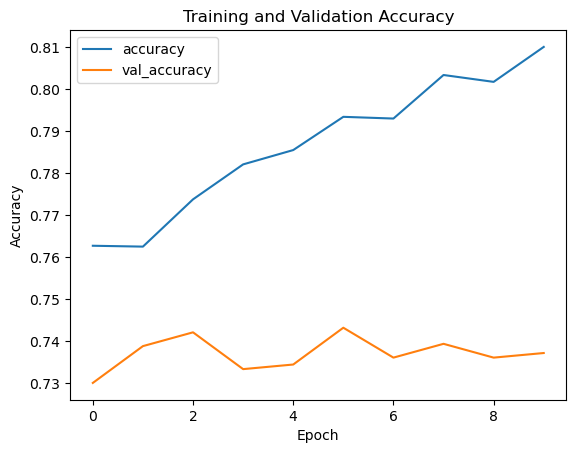

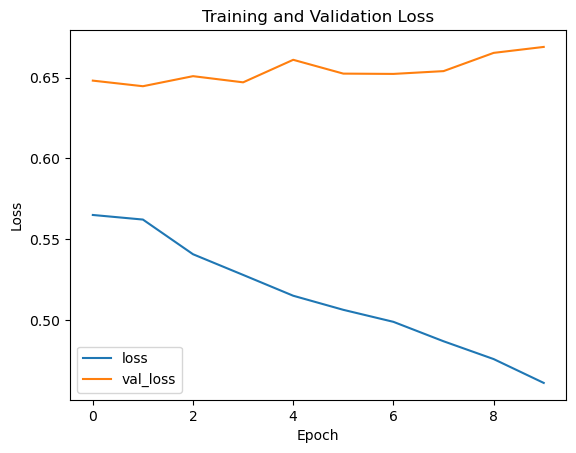

Fold 3
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.4477 - accuracy: 0.8199 - val_loss: 0.6799 - val_accuracy: 0.7327
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4426 - accuracy: 0.8238 - val_loss: 0.6794 - val_accuracy: 0.7410
Epoch 3/10
230/230 [==============================] - 2s 7ms/step - loss: 0.4403 - accuracy: 0.8205 - val_loss: 0.6646 - val_accuracy: 0.7437
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4329 - accuracy: 0.8247 - val_loss: 0.6848 - val_accuracy: 0.7393
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4281 - accuracy: 0.8275 - val_loss: 0.6820 - val_accuracy: 0.7442
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4221 - accuracy: 0.8288 - val_loss: 0.6900 - val_accuracy: 0.7410
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.4133 - accuracy: 0.8354 - val_loss: 0.6933 - val_accuracy: 0.7388

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7404162102957283, Validation F1 Score: 0.7367263887701361


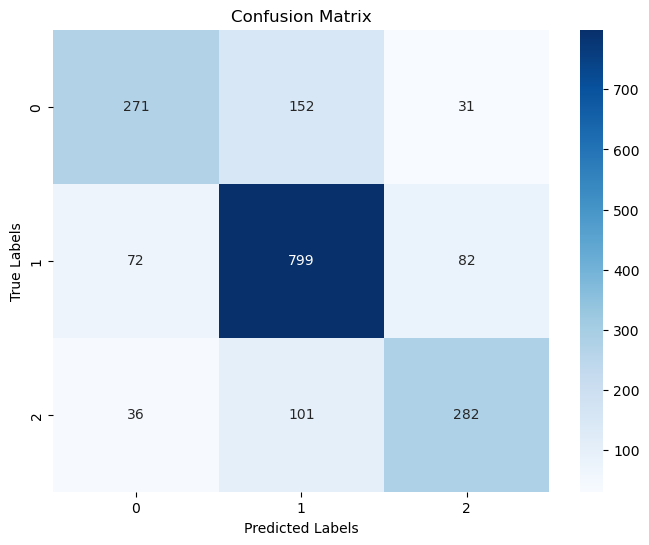

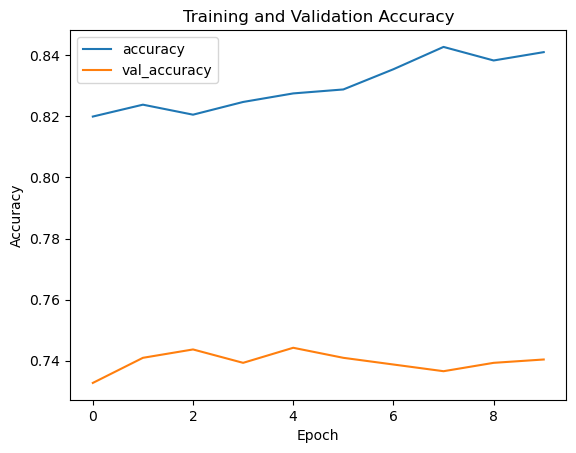

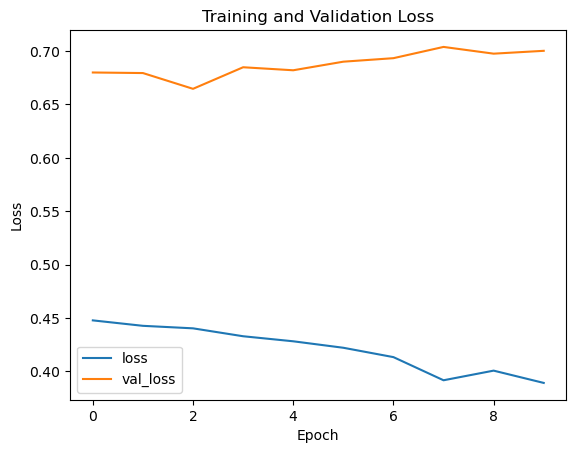

Fold 4
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.3869 - accuracy: 0.8447 - val_loss: 0.7029 - val_accuracy: 0.7404
Epoch 2/10
230/230 [==============================] - 2s 7ms/step - loss: 0.3742 - accuracy: 0.8514 - val_loss: 0.6980 - val_accuracy: 0.7377
Epoch 3/10
230/230 [==============================] - 2s 7ms/step - loss: 0.3736 - accuracy: 0.8506 - val_loss: 0.7192 - val_accuracy: 0.7333
Epoch 4/10
230/230 [==============================] - 2s 7ms/step - loss: 0.3754 - accuracy: 0.8500 - val_loss: 0.7160 - val_accuracy: 0.7410
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3710 - accuracy: 0.8522 - val_loss: 0.7170 - val_accuracy: 0.7377
Epoch 6/10
230/230 [==============================] - 2s 7ms/step - loss: 0.3587 - accuracy: 0.8569 - val_loss: 0.7331 - val_accuracy: 0.7382
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3466 - accuracy: 0.8599 - val_loss: 0.7410 - val_accuracy: 0.7366

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7447973713033954, Validation F1 Score: 0.7404408687011527


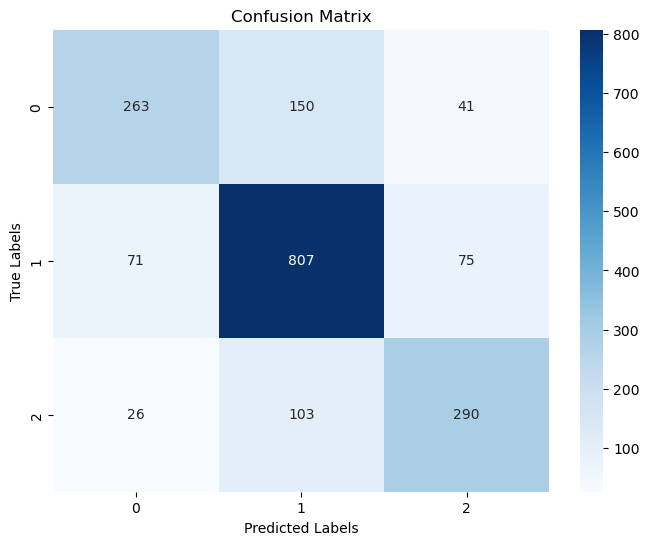

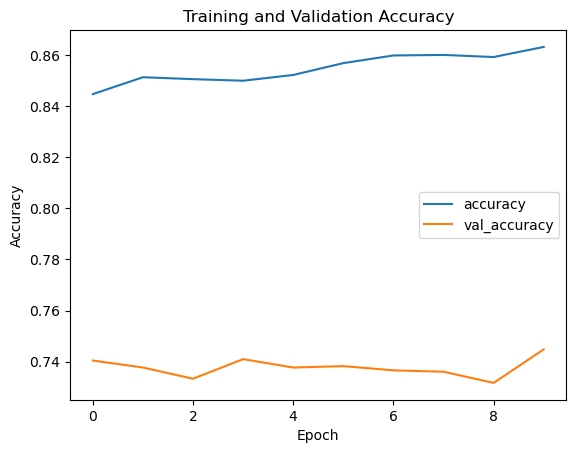

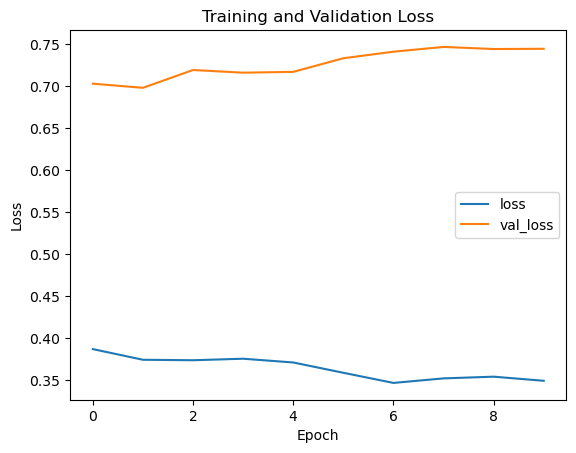

Fold 5
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.3345 - accuracy: 0.8671 - val_loss: 0.7668 - val_accuracy: 0.7349
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3330 - accuracy: 0.8713 - val_loss: 0.7501 - val_accuracy: 0.7338
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3345 - accuracy: 0.8679 - val_loss: 0.7546 - val_accuracy: 0.7404
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3313 - accuracy: 0.8704 - val_loss: 0.7717 - val_accuracy: 0.7377
Epoch 5/10
230/230 [==============================] - 2s 6ms/step - loss: 0.3224 - accuracy: 0.8709 - val_loss: 0.7642 - val_accuracy: 0.7382
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3156 - accuracy: 0.8786 - val_loss: 0.7583 - val_accuracy: 0.7459
Epoch 7/10
230/230 [==============================] - 2s 7ms/step - loss: 0.3175 - accuracy: 0.8754 - val_loss: 0.7603 - val_accuracy: 0.7410

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7365826944140197, Validation F1 Score: 0.7337973912879497


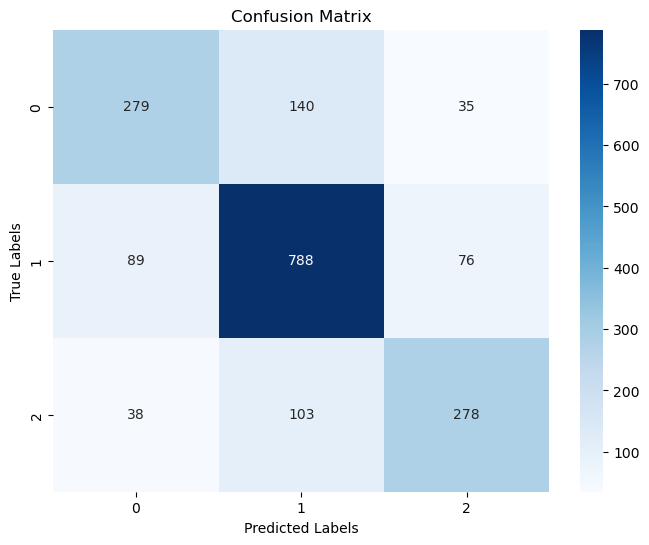

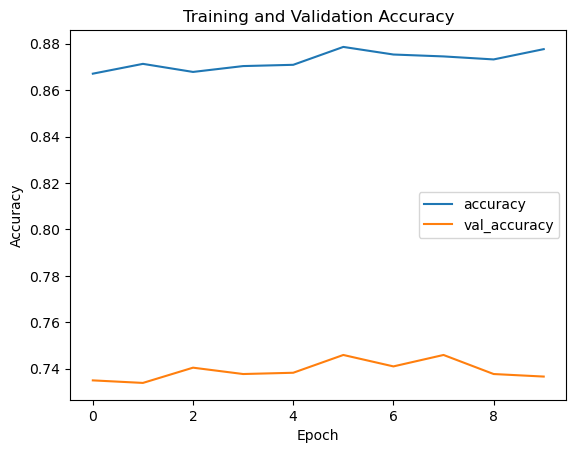

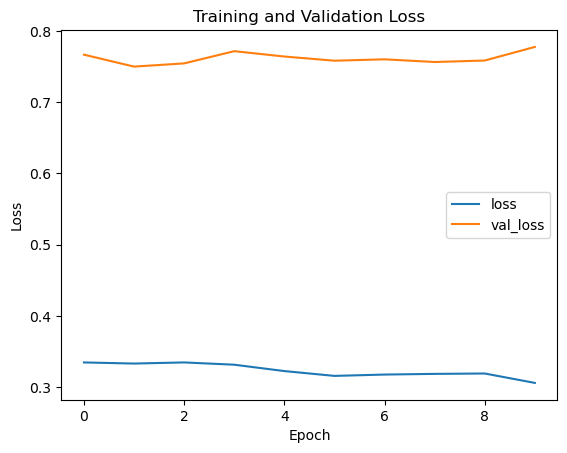

Fold 6
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.3079 - accuracy: 0.8826 - val_loss: 0.7704 - val_accuracy: 0.7322
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3167 - accuracy: 0.8735 - val_loss: 0.7861 - val_accuracy: 0.7371
Epoch 3/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3112 - accuracy: 0.8776 - val_loss: 0.7860 - val_accuracy: 0.7377
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.3031 - accuracy: 0.8814 - val_loss: 0.8072 - val_accuracy: 0.7327
Epoch 5/10
230/230 [==============================] - 1s 7ms/step - loss: 0.2907 - accuracy: 0.8902 - val_loss: 0.8265 - val_accuracy: 0.7338
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2932 - accuracy: 0.8848 - val_loss: 0.8054 - val_accuracy: 0.7377
Epoch 7/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2900 - accuracy: 0.8877 - val_loss: 0.7959 - val_accuracy: 0.7399

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7349397590361446, Validation F1 Score: 0.7328792772853222


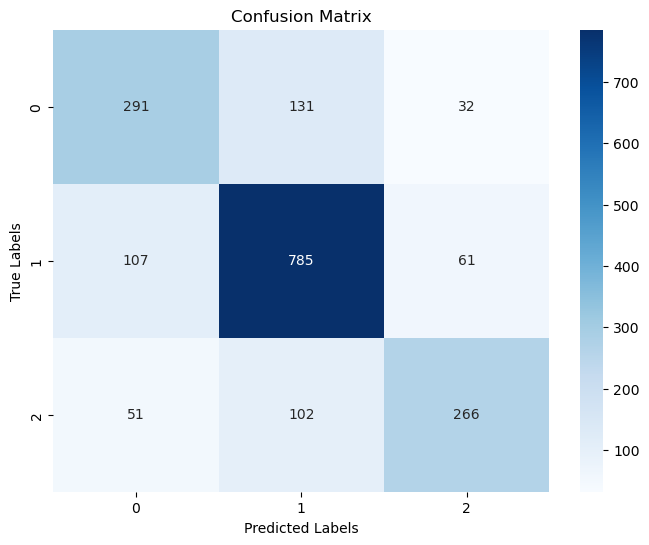

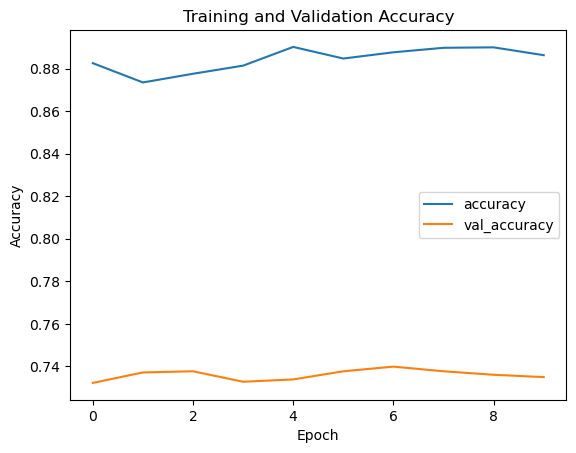

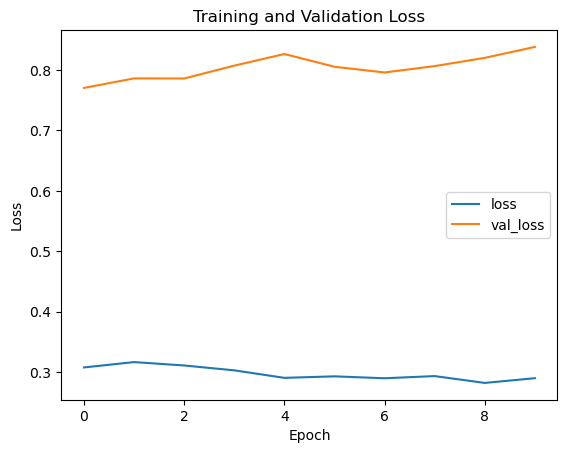

Fold 7
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.2982 - accuracy: 0.8802 - val_loss: 0.8371 - val_accuracy: 0.7410
Epoch 2/10
230/230 [==============================] - 2s 6ms/step - loss: 0.2823 - accuracy: 0.8871 - val_loss: 0.8386 - val_accuracy: 0.7355
Epoch 3/10
230/230 [==============================] - 2s 6ms/step - loss: 0.2857 - accuracy: 0.8875 - val_loss: 0.8575 - val_accuracy: 0.7306
Epoch 4/10
230/230 [==============================] - 2s 7ms/step - loss: 0.2874 - accuracy: 0.8848 - val_loss: 0.8525 - val_accuracy: 0.7327
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2927 - accuracy: 0.8838 - val_loss: 0.8429 - val_accuracy: 0.7317
Epoch 6/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2691 - accuracy: 0.8928 - val_loss: 0.8538 - val_accuracy: 0.7240
Epoch 7/10
230/230 [==============================] - 1s 7ms/step - loss: 0.2705 - accuracy: 0.8964 - val_loss: 0.8631 - val_accuracy: 0.7234

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Validation Accuracy: 0.732749178532311, Validation F1 Score: 0.7306388784091403


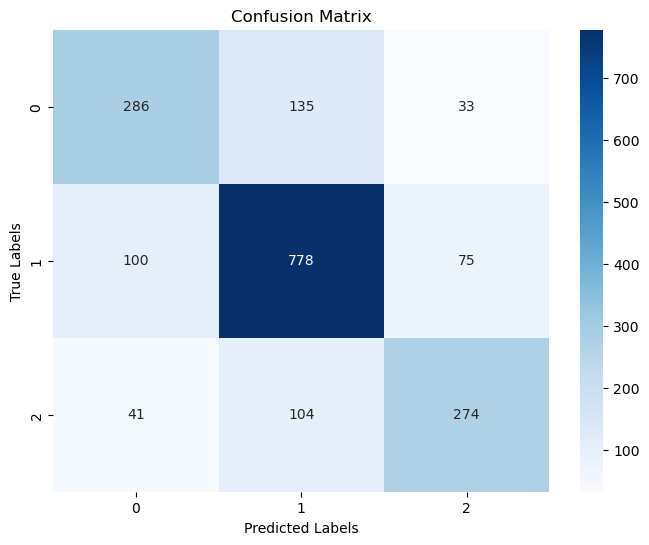

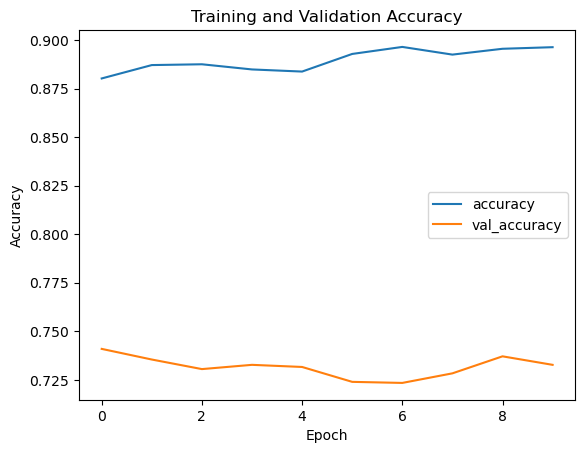

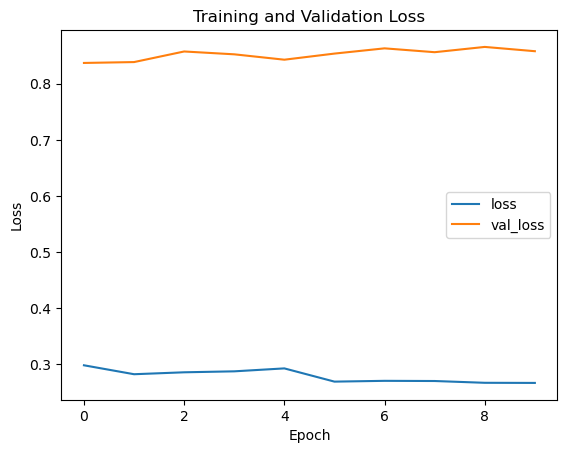

Fold 8
Epoch 1/10
230/230 [==============================] - 2s 7ms/step - loss: 0.2728 - accuracy: 0.8924 - val_loss: 0.8891 - val_accuracy: 0.7295
Epoch 2/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2737 - accuracy: 0.8947 - val_loss: 0.8726 - val_accuracy: 0.7185
Epoch 3/10
230/230 [==============================] - 2s 7ms/step - loss: 0.2626 - accuracy: 0.9012 - val_loss: 0.8954 - val_accuracy: 0.7300
Epoch 4/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2672 - accuracy: 0.8964 - val_loss: 0.9000 - val_accuracy: 0.7300
Epoch 5/10
230/230 [==============================] - 1s 6ms/step - loss: 0.2569 - accuracy: 0.8976 - val_loss: 0.9011 - val_accuracy: 0.7322
Epoch 6/10
230/230 [==============================] - 1s 7ms/step - loss: 0.2611 - accuracy: 0.9016 - val_loss: 0.8969 - val_accuracy: 0.7371
Epoch 7/10
230/230 [==============================] - 2s 7ms/step - loss: 0.2556 - accuracy: 0.9027 - val_loss: 0.8936 - val_accuracy: 0.7267

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7179627601314348, Validation F1 Score: 0.7156788999080504


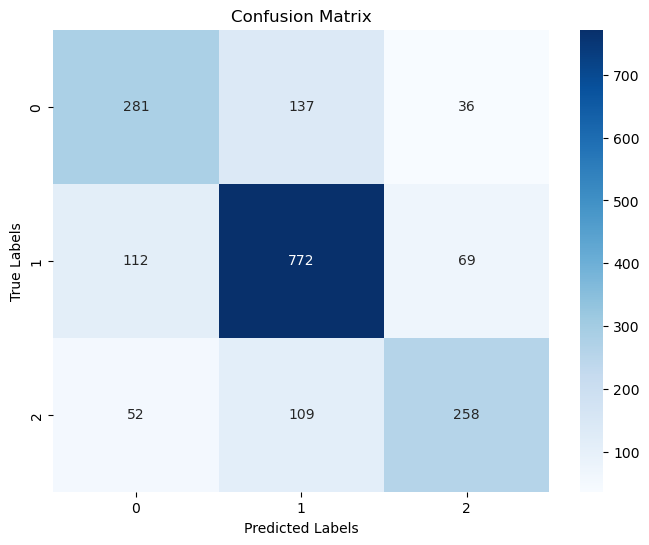

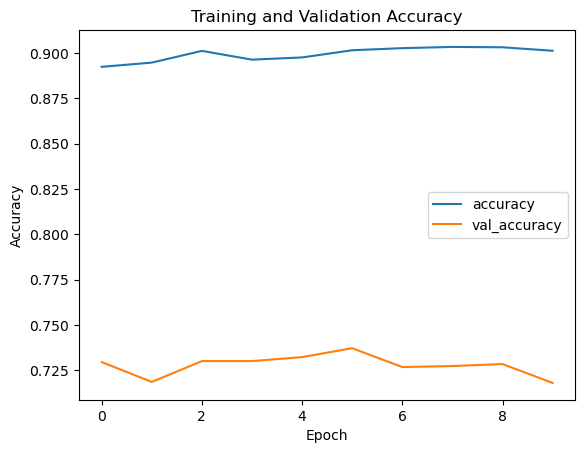

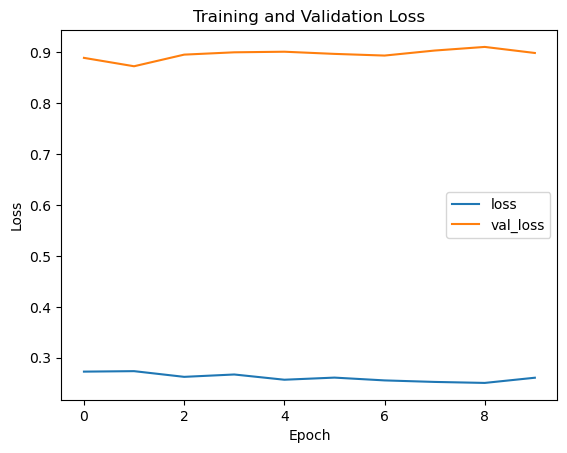

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7341182913472071
Mean F1 Score: 0.7307912169687611
Number of Epochs: 10, Test Size: 0.2, Validation Size: 0.15
Fold 1
Epoch 1/10
216/216 [==============================] - 2s 7ms/step - loss: 1.6472 - accuracy: 0.5186 - val_loss: 0.7842 - val_accuracy: 0.6629
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.9531 - accuracy: 0.6140 - val_loss: 0.7224 - val_accuracy: 0.6921
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.7889 - accuracy: 0.6531 - val_loss: 0.6992 - val_accuracy: 0.7053
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.7228 - accuracy: 0.6830 - val_loss: 0.6893 - val_accuracy: 0.7046
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.6844 - accuracy: 0.7019 - val_loss: 0.6725 - val_accuracy: 0.7189
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.6559 - accuracy: 0.7207 - val_loss: 0.6578 - val_accuracy: 0.7253
Epoch 7/10
21

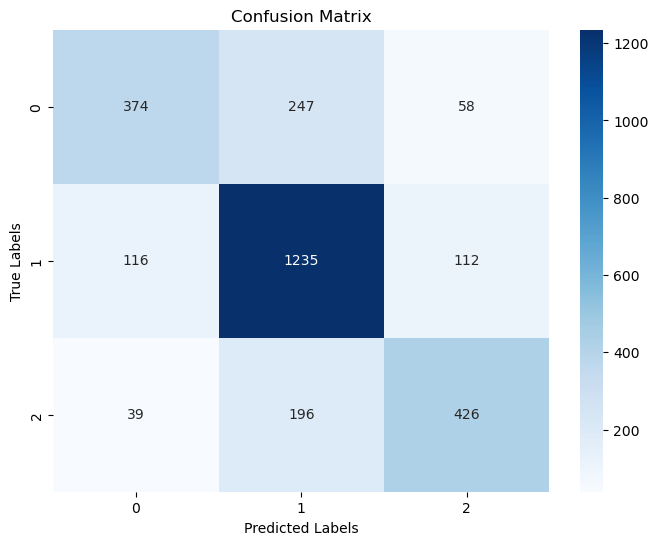

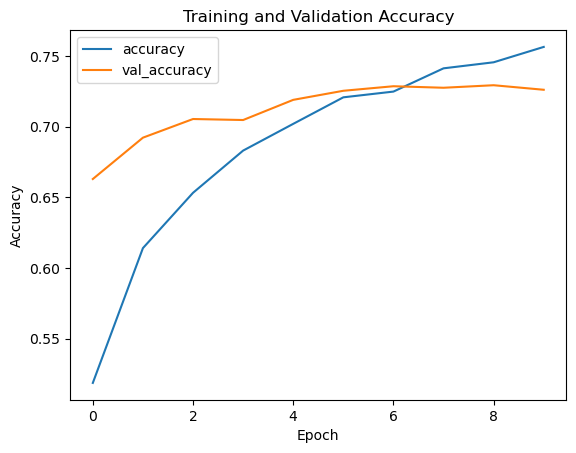

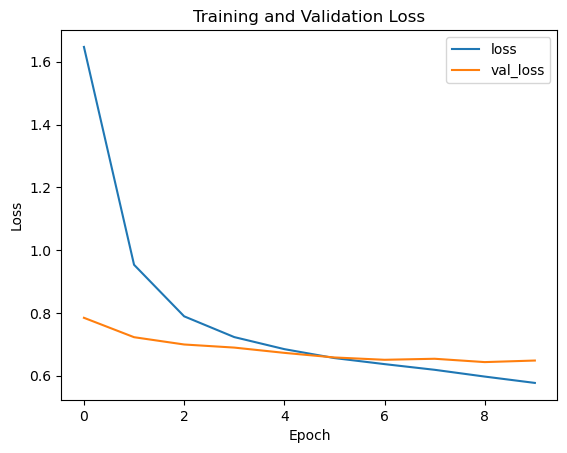

Fold 2
Epoch 1/10
216/216 [==============================] - 2s 8ms/step - loss: 0.5622 - accuracy: 0.7633 - val_loss: 0.6475 - val_accuracy: 0.7281
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5486 - accuracy: 0.7694 - val_loss: 0.6445 - val_accuracy: 0.7314
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5265 - accuracy: 0.7808 - val_loss: 0.6444 - val_accuracy: 0.7299
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5101 - accuracy: 0.7860 - val_loss: 0.6467 - val_accuracy: 0.7364
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5137 - accuracy: 0.7888 - val_loss: 0.6469 - val_accuracy: 0.7299
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5015 - accuracy: 0.7952 - val_loss: 0.6466 - val_accuracy: 0.7342
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4681 - accuracy: 0.8097 - val_loss: 0.6763 - val_accuracy: 0.7271

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7213699607563325, Validation F1 Score: 0.7128753762089856


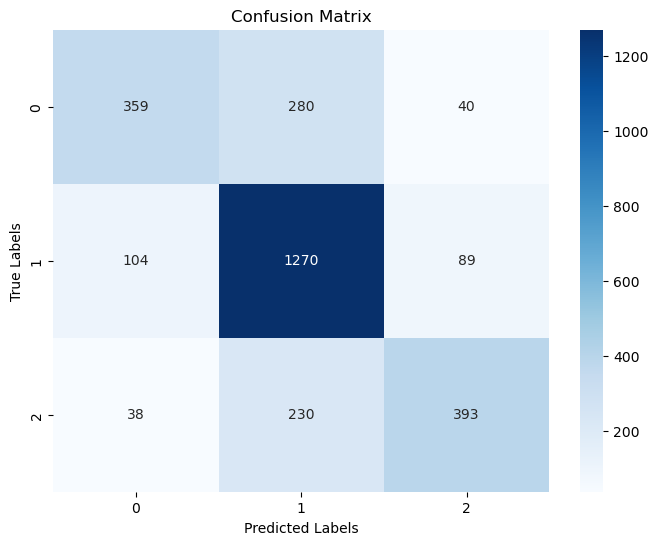

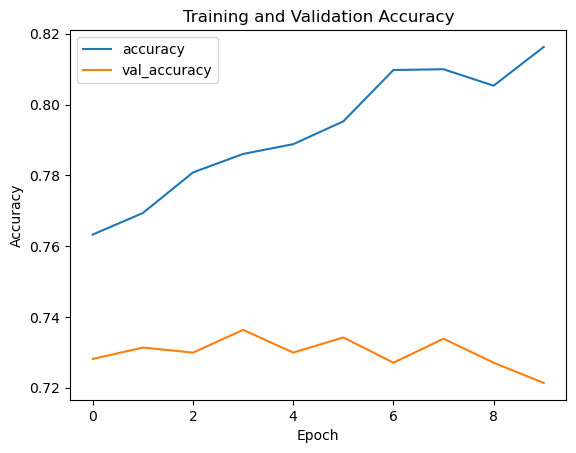

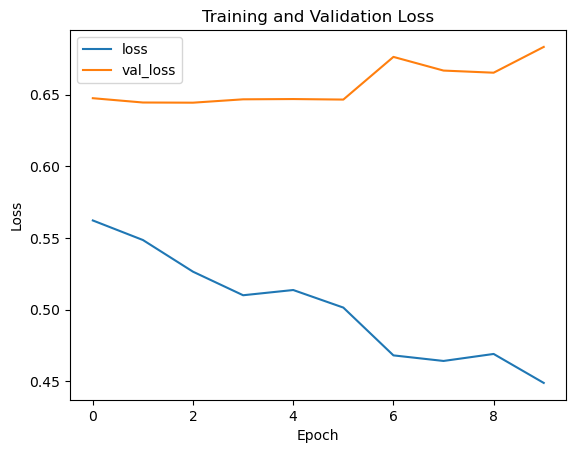

Fold 3
Epoch 1/10
216/216 [==============================] - 2s 7ms/step - loss: 0.4427 - accuracy: 0.8210 - val_loss: 0.6735 - val_accuracy: 0.7246
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4327 - accuracy: 0.8239 - val_loss: 0.6831 - val_accuracy: 0.7314
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4260 - accuracy: 0.8284 - val_loss: 0.6857 - val_accuracy: 0.7296
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4201 - accuracy: 0.8318 - val_loss: 0.7018 - val_accuracy: 0.7271
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4018 - accuracy: 0.8380 - val_loss: 0.7060 - val_accuracy: 0.7217
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4095 - accuracy: 0.8376 - val_loss: 0.7041 - val_accuracy: 0.7189
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3856 - accuracy: 0.8462 - val_loss: 0.7023 - val_accuracy: 0.7303

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7242240456653586, Validation F1 Score: 0.7194593259566447


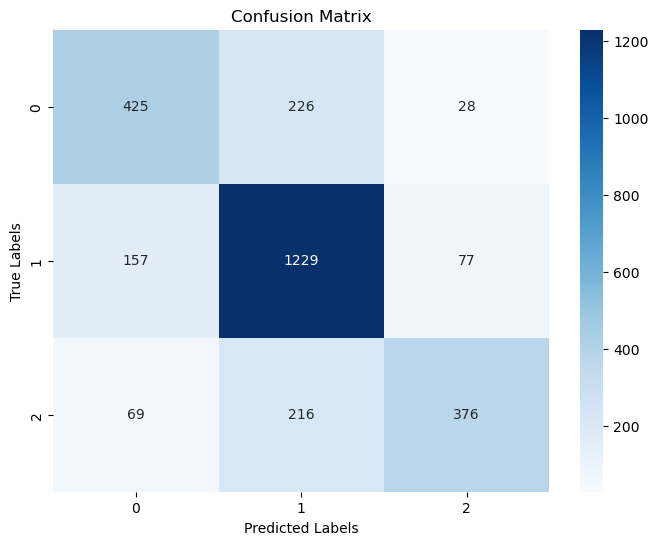

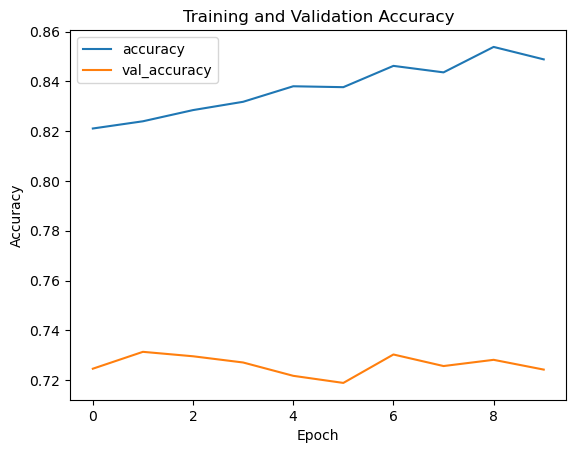

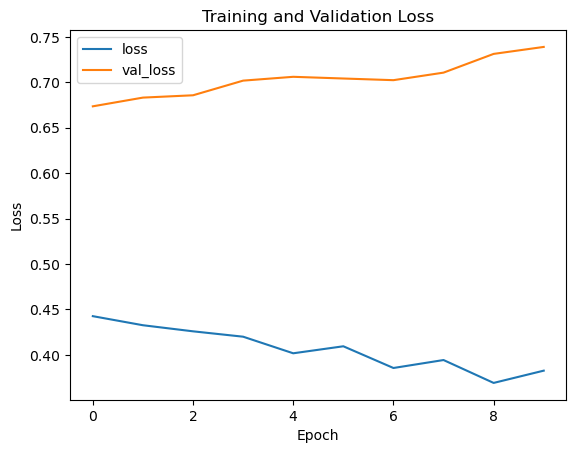

Fold 4
Epoch 1/10
216/216 [==============================] - 2s 7ms/step - loss: 0.3700 - accuracy: 0.8489 - val_loss: 0.7253 - val_accuracy: 0.7257
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3561 - accuracy: 0.8565 - val_loss: 0.7256 - val_accuracy: 0.7253
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3607 - accuracy: 0.8560 - val_loss: 0.7360 - val_accuracy: 0.7253
Epoch 4/10
216/216 [==============================] - 2s 7ms/step - loss: 0.3472 - accuracy: 0.8609 - val_loss: 0.7569 - val_accuracy: 0.7271
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3533 - accuracy: 0.8624 - val_loss: 0.7476 - val_accuracy: 0.7210
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3438 - accuracy: 0.8665 - val_loss: 0.7521 - val_accuracy: 0.7214
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3428 - accuracy: 0.8651 - val_loss: 0.7575 - val_accuracy: 0.7257

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7188726364609347, Validation F1 Score: 0.7143506238517995


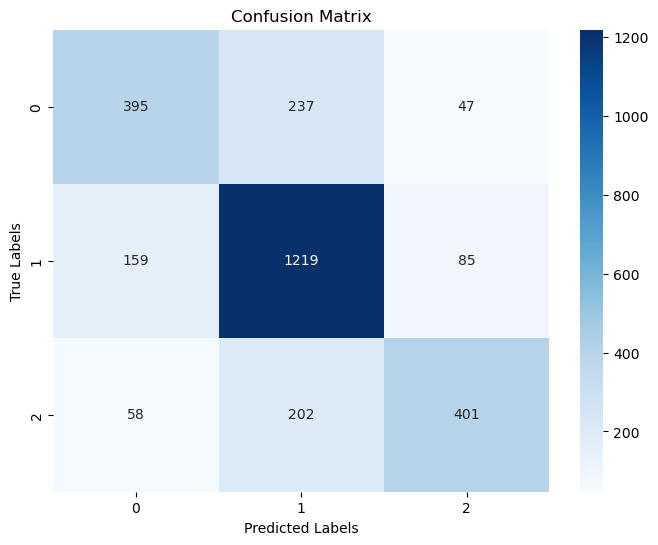

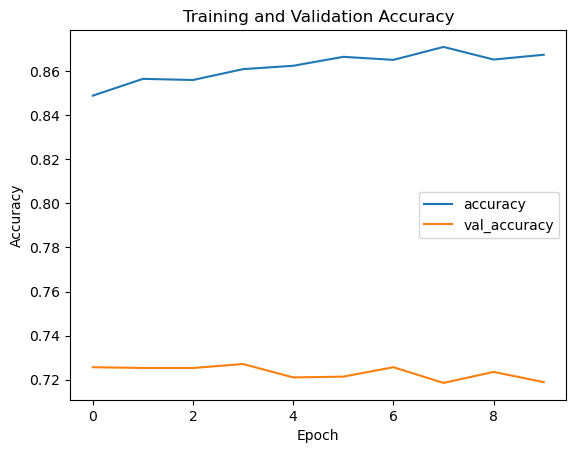

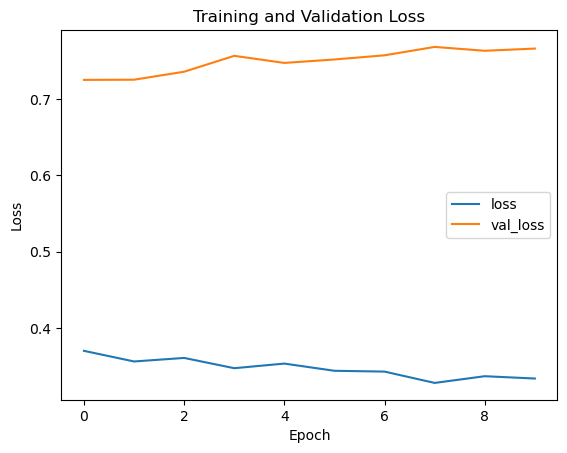

Fold 5
Epoch 1/10
216/216 [==============================] - 2s 7ms/step - loss: 0.3355 - accuracy: 0.8657 - val_loss: 0.7656 - val_accuracy: 0.7196
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3190 - accuracy: 0.8746 - val_loss: 0.7838 - val_accuracy: 0.7146
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3220 - accuracy: 0.8726 - val_loss: 0.7742 - val_accuracy: 0.7121
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3186 - accuracy: 0.8751 - val_loss: 0.7893 - val_accuracy: 0.7164
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3080 - accuracy: 0.8762 - val_loss: 0.7806 - val_accuracy: 0.7257
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3113 - accuracy: 0.8791 - val_loss: 0.7843 - val_accuracy: 0.7192
Epoch 7/10
216/216 [==============================] - 2s 7ms/step - loss: 0.3019 - accuracy: 0.8812 - val_loss: 0.7924 - val_accuracy: 0.7171

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7181591152336781, Validation F1 Score: 0.7151699270846833


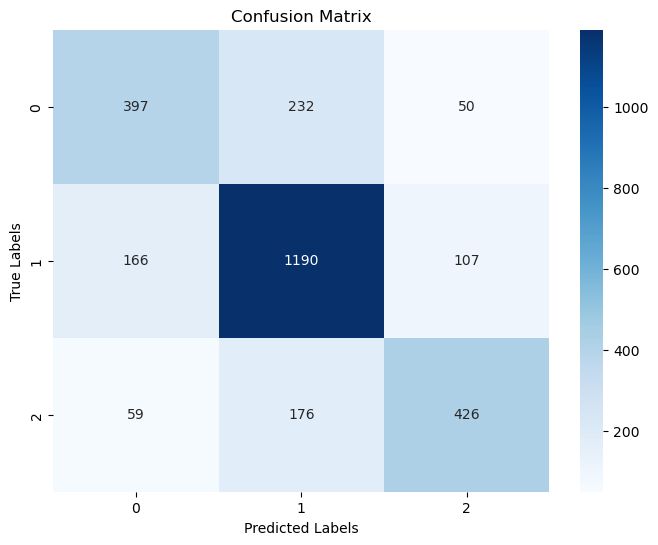

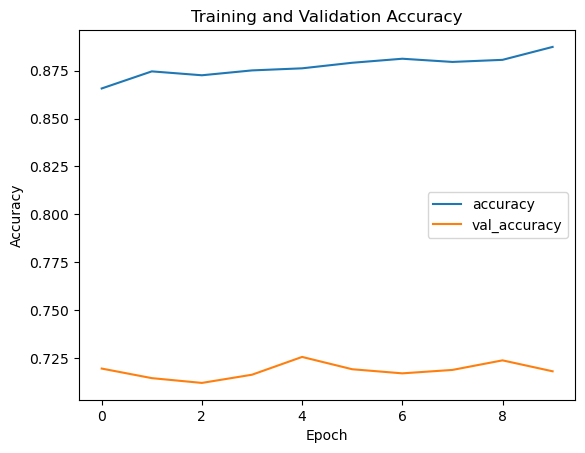

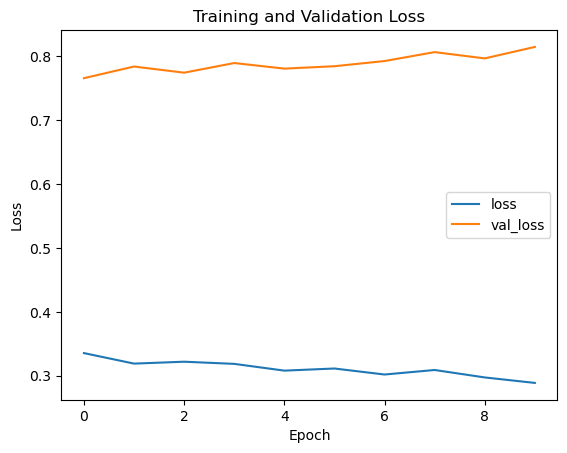

Fold 6
Epoch 1/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2939 - accuracy: 0.8849 - val_loss: 0.8351 - val_accuracy: 0.7171
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2909 - accuracy: 0.8882 - val_loss: 0.8330 - val_accuracy: 0.7125
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2897 - accuracy: 0.8853 - val_loss: 0.8329 - val_accuracy: 0.7139
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2967 - accuracy: 0.8856 - val_loss: 0.8369 - val_accuracy: 0.7149
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2828 - accuracy: 0.8885 - val_loss: 0.8414 - val_accuracy: 0.7164
Epoch 6/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2796 - accuracy: 0.8915 - val_loss: 0.8407 - val_accuracy: 0.7196
Epoch 7/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2803 - accuracy: 0.8901 - val_loss: 0.8512 - val_accuracy: 0.7210

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7131644666428826, Validation F1 Score: 0.7092462005411891


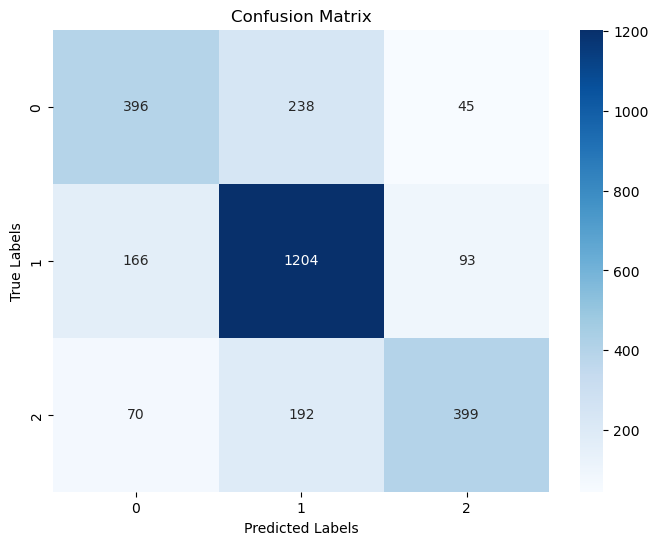

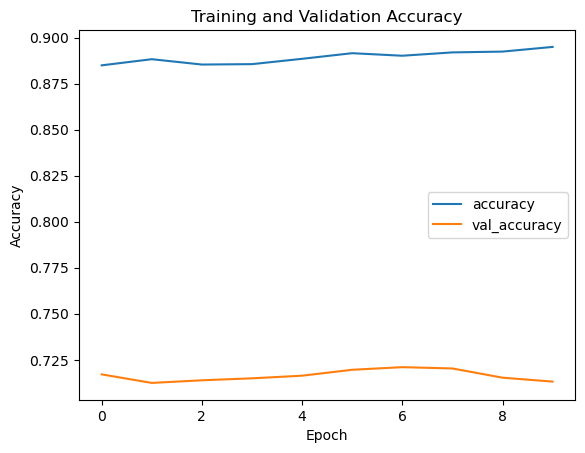

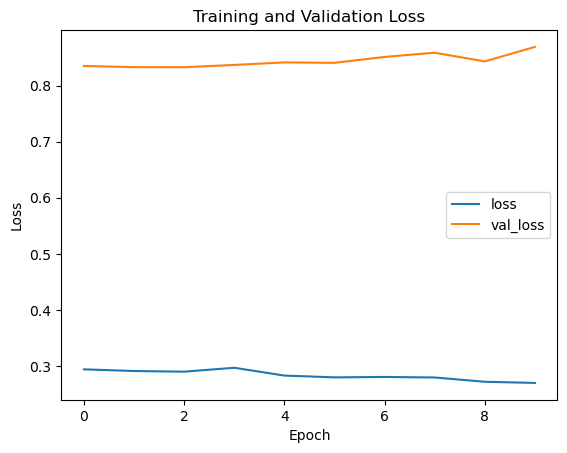

Fold 7
Epoch 1/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2741 - accuracy: 0.8935 - val_loss: 0.8583 - val_accuracy: 0.7207
Epoch 2/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2692 - accuracy: 0.8938 - val_loss: 0.8588 - val_accuracy: 0.7142
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2744 - accuracy: 0.8928 - val_loss: 0.8683 - val_accuracy: 0.7199
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2704 - accuracy: 0.8970 - val_loss: 0.8601 - val_accuracy: 0.7214
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2687 - accuracy: 0.8961 - val_loss: 0.8694 - val_accuracy: 0.7182
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2548 - accuracy: 0.9001 - val_loss: 0.8834 - val_accuracy: 0.7182
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2553 - accuracy: 0.9006 - val_loss: 0.8737 - val_accuracy: 0.7153

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7210132001427042, Validation F1 Score: 0.7192890074626116


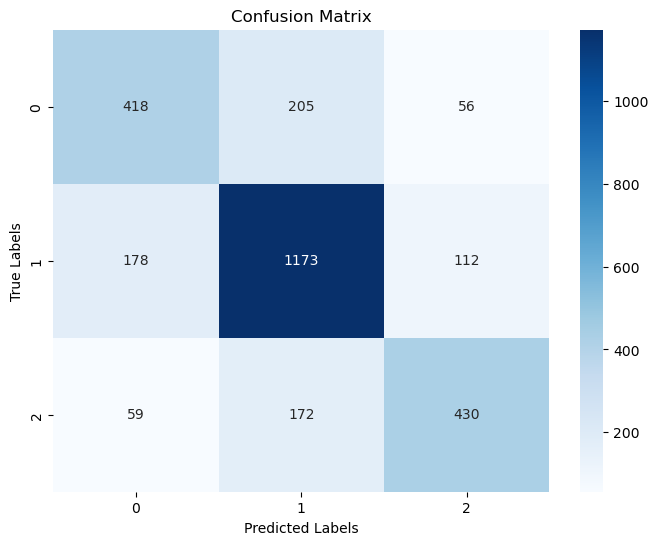

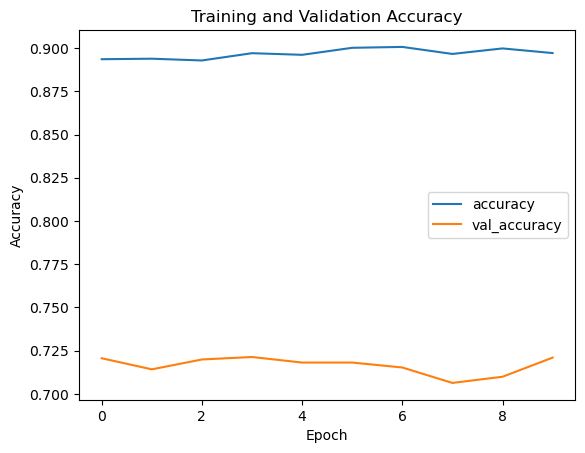

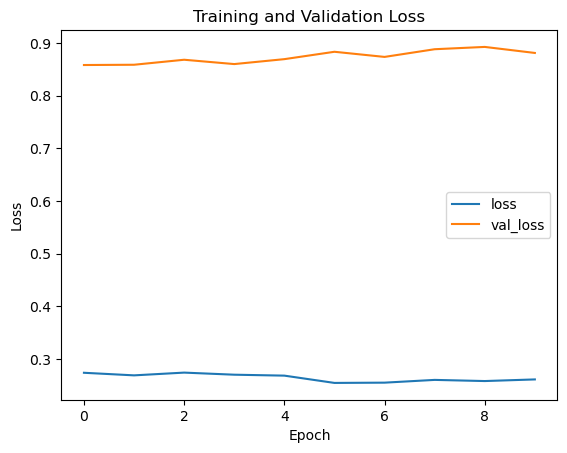

Fold 8
Epoch 1/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2555 - accuracy: 0.9045 - val_loss: 0.8999 - val_accuracy: 0.7142
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2570 - accuracy: 0.9014 - val_loss: 0.8881 - val_accuracy: 0.7207
Epoch 3/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2501 - accuracy: 0.9046 - val_loss: 0.8958 - val_accuracy: 0.7242
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2497 - accuracy: 0.9044 - val_loss: 0.8903 - val_accuracy: 0.7203
Epoch 5/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2468 - accuracy: 0.9066 - val_loss: 0.8874 - val_accuracy: 0.7139
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2474 - accuracy: 0.9020 - val_loss: 0.8886 - val_accuracy: 0.7271
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2424 - accuracy: 0.9057 - val_loss: 0.9045 - val_accuracy: 0.7214

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7263646093471281, Validation F1 Score: 0.7226033834563608


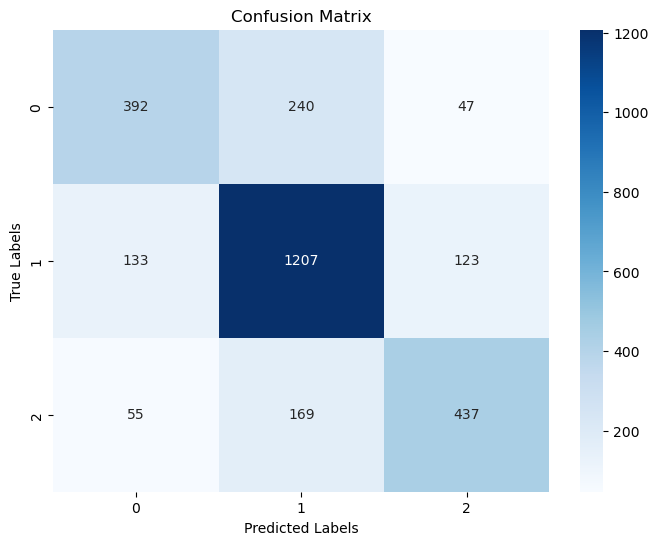

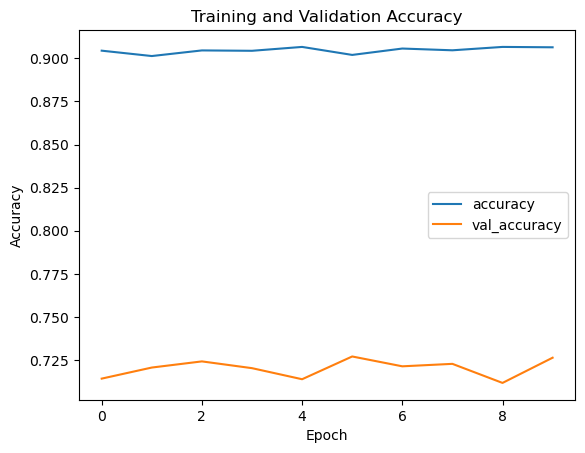

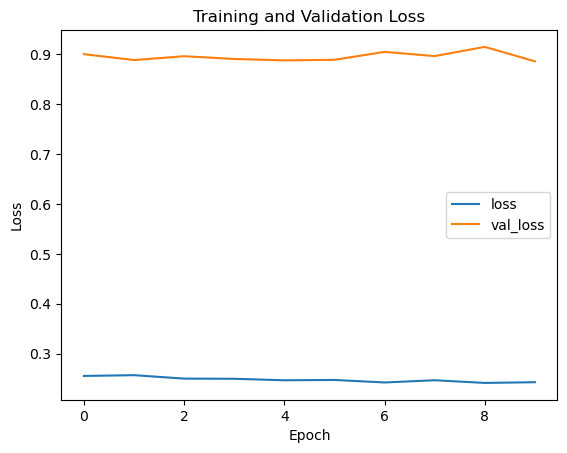

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7211469853728149
Mean F1 Score: 0.7166587407865754
Number of Epochs: 10, Test Size: 0.2, Validation Size: 0.2
Fold 1
Epoch 1/10
216/216 [==============================] - 2s 7ms/step - loss: 1.5819 - accuracy: 0.5287 - val_loss: 0.7756 - val_accuracy: 0.6652
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.9361 - accuracy: 0.6138 - val_loss: 0.7224 - val_accuracy: 0.6942
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.7750 - accuracy: 0.6585 - val_loss: 0.6968 - val_accuracy: 0.7085
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.7170 - accuracy: 0.6854 - val_loss: 0.6804 - val_accuracy: 0.7120
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.6805 - accuracy: 0.7099 - val_loss: 0.6694 - val_accuracy: 0.7217
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.6546 - accuracy: 0.7182 - val_loss: 0.6622 - val_accuracy: 0.7213
Epoch 7/10
216

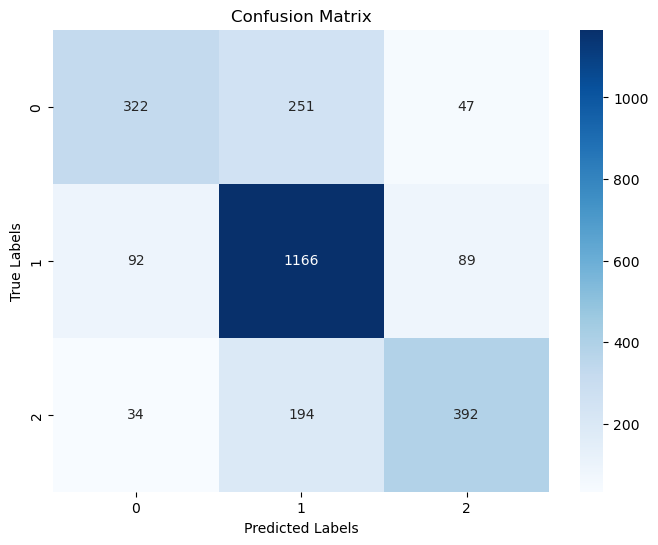

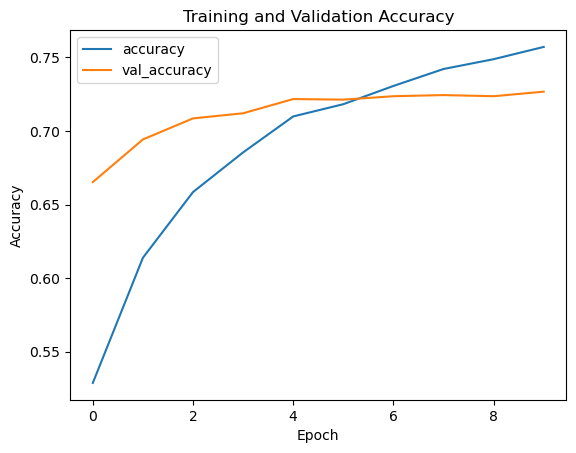

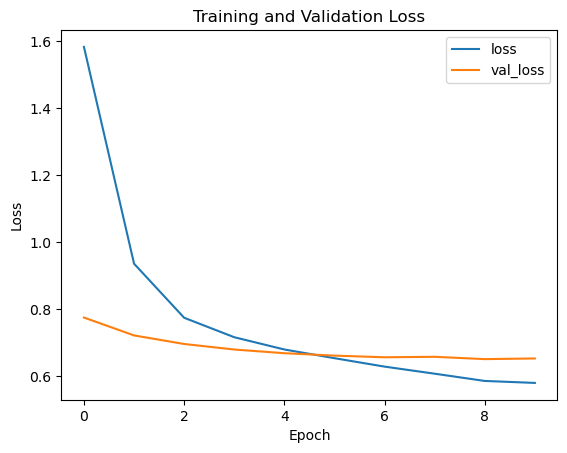

Fold 2
Epoch 1/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5518 - accuracy: 0.7699 - val_loss: 0.6480 - val_accuracy: 0.7325
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5379 - accuracy: 0.7759 - val_loss: 0.6538 - val_accuracy: 0.7271
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5332 - accuracy: 0.7807 - val_loss: 0.6474 - val_accuracy: 0.7244
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5175 - accuracy: 0.7859 - val_loss: 0.6538 - val_accuracy: 0.7306
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5038 - accuracy: 0.7912 - val_loss: 0.6640 - val_accuracy: 0.7217
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4932 - accuracy: 0.7937 - val_loss: 0.6560 - val_accuracy: 0.7356
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4768 - accuracy: 0.8040 - val_loss: 0.6650 - val_accuracy: 0.7263

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7278701198299188, Validation F1 Score: 0.7258697967646311


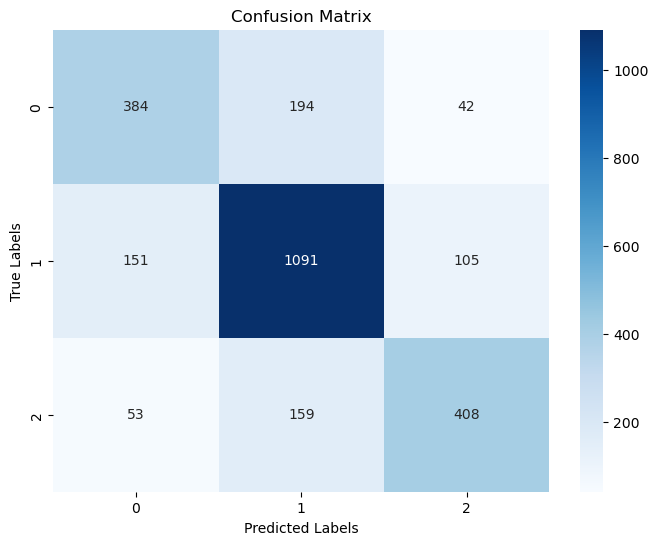

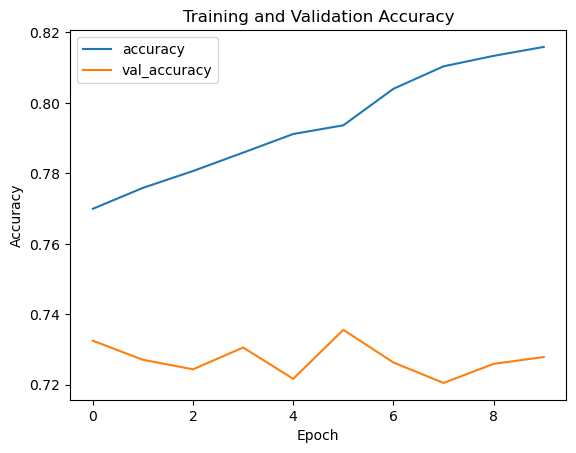

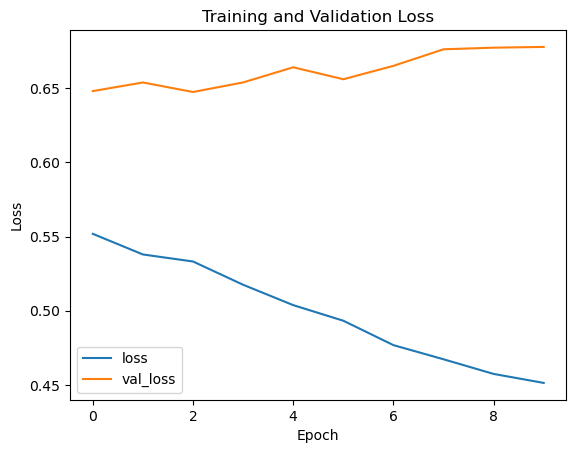

Fold 3
Epoch 1/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4370 - accuracy: 0.8241 - val_loss: 0.6806 - val_accuracy: 0.7286
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4269 - accuracy: 0.8274 - val_loss: 0.6788 - val_accuracy: 0.7275
Epoch 3/10
216/216 [==============================] - 2s 7ms/step - loss: 0.4205 - accuracy: 0.8313 - val_loss: 0.6923 - val_accuracy: 0.7256
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4136 - accuracy: 0.8316 - val_loss: 0.7009 - val_accuracy: 0.7263
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4044 - accuracy: 0.8362 - val_loss: 0.7041 - val_accuracy: 0.7256
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4028 - accuracy: 0.8367 - val_loss: 0.7054 - val_accuracy: 0.7267
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4003 - accuracy: 0.8427 - val_loss: 0.7135 - val_accuracy: 0.7198

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7282566679551604, Validation F1 Score: 0.7253759507899712


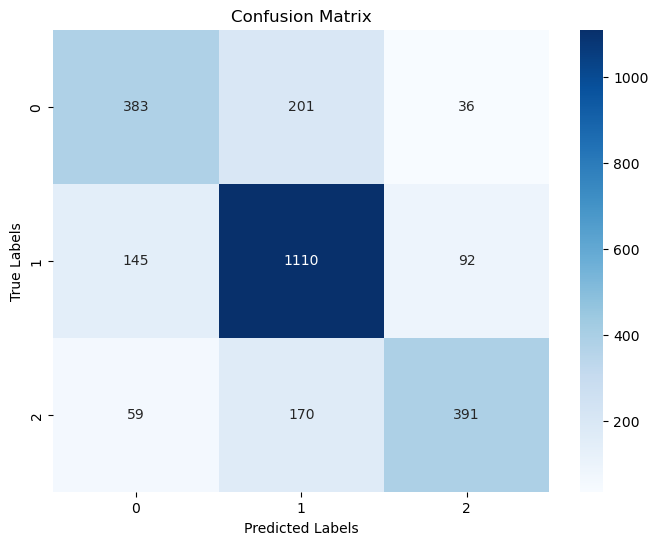

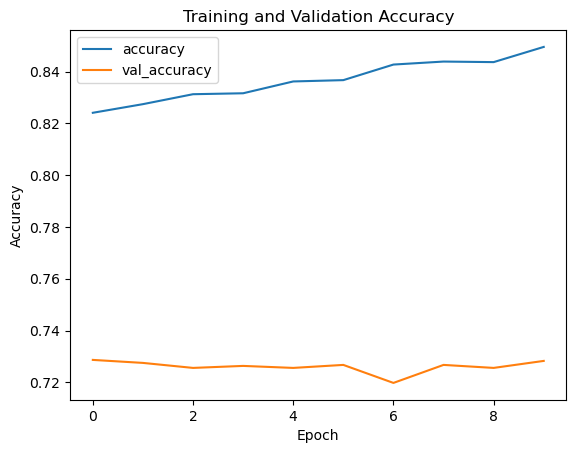

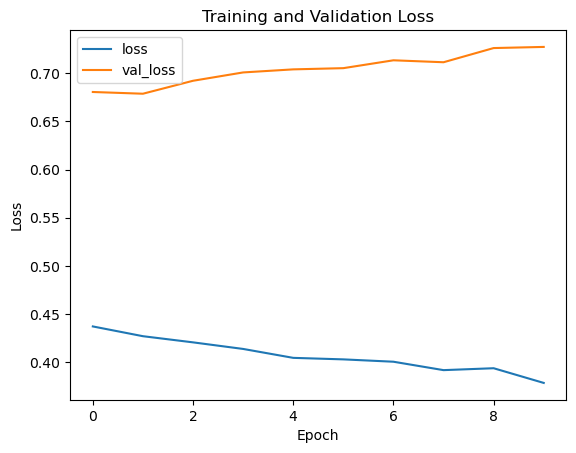

Fold 4
Epoch 1/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3678 - accuracy: 0.8554 - val_loss: 0.7363 - val_accuracy: 0.7147
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3650 - accuracy: 0.8548 - val_loss: 0.7250 - val_accuracy: 0.7271
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3601 - accuracy: 0.8537 - val_loss: 0.7336 - val_accuracy: 0.7283
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3436 - accuracy: 0.8648 - val_loss: 0.7533 - val_accuracy: 0.7143
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3584 - accuracy: 0.8579 - val_loss: 0.7503 - val_accuracy: 0.7209
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3439 - accuracy: 0.8648 - val_loss: 0.7579 - val_accuracy: 0.7248
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3411 - accuracy: 0.8642 - val_loss: 0.7887 - val_accuracy: 0.7198

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7228449942017782, Validation F1 Score: 0.721140470533791


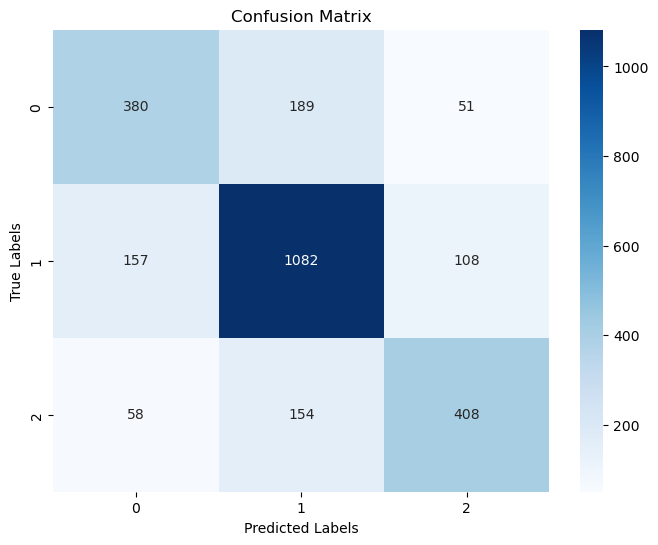

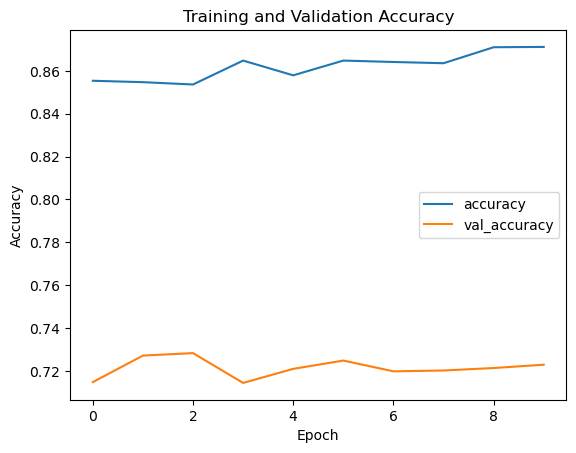

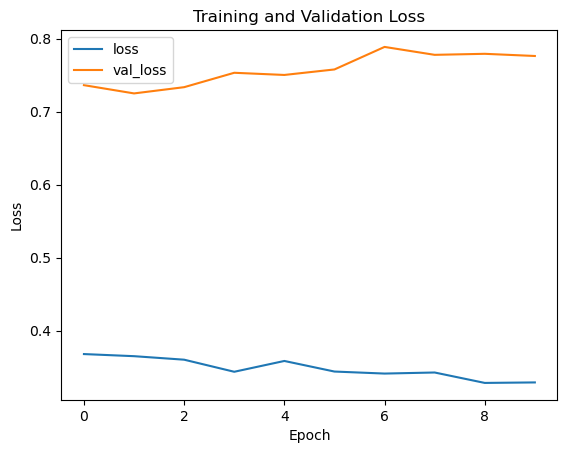

Fold 5
Epoch 1/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3318 - accuracy: 0.8682 - val_loss: 0.7901 - val_accuracy: 0.7140
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3273 - accuracy: 0.8713 - val_loss: 0.7986 - val_accuracy: 0.7252
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3123 - accuracy: 0.8778 - val_loss: 0.7966 - val_accuracy: 0.7147
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3259 - accuracy: 0.8722 - val_loss: 0.7971 - val_accuracy: 0.7252
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3047 - accuracy: 0.8799 - val_loss: 0.8062 - val_accuracy: 0.7325
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3064 - accuracy: 0.8808 - val_loss: 0.8211 - val_accuracy: 0.7228
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3113 - accuracy: 0.8799 - val_loss: 0.8313 - val_accuracy: 0.7194

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7201391573250869, Validation F1 Score: 0.7165776027676726


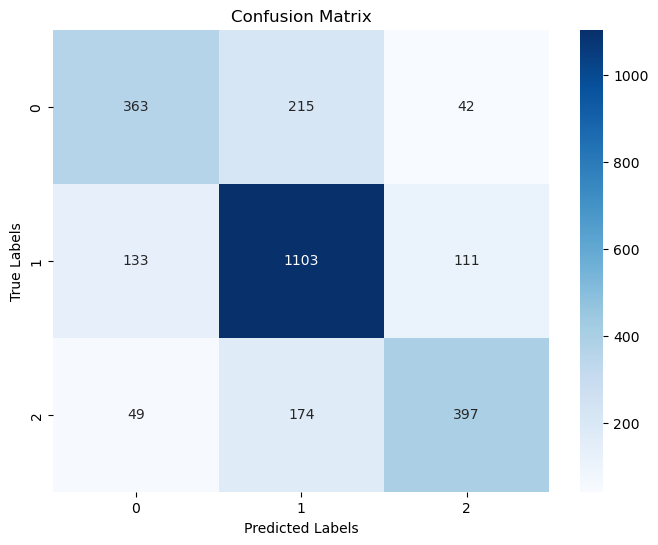

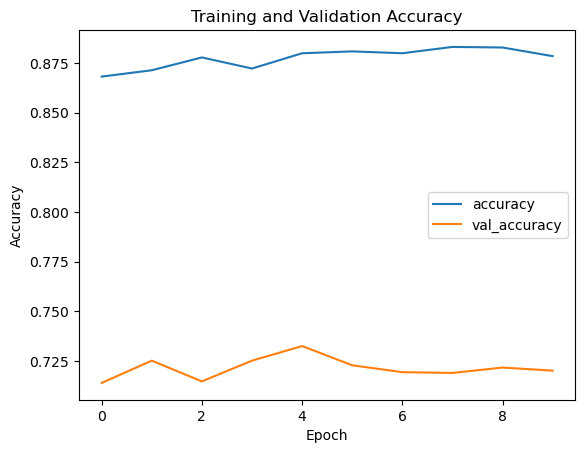

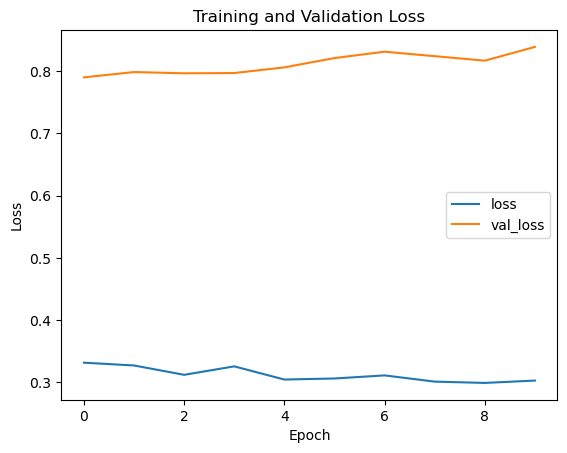

Fold 6
Epoch 1/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2921 - accuracy: 0.8850 - val_loss: 0.8557 - val_accuracy: 0.7155
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2842 - accuracy: 0.8892 - val_loss: 0.8447 - val_accuracy: 0.7263
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2907 - accuracy: 0.8850 - val_loss: 0.8374 - val_accuracy: 0.7167
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2862 - accuracy: 0.8876 - val_loss: 0.8596 - val_accuracy: 0.7178
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2921 - accuracy: 0.8833 - val_loss: 0.8420 - val_accuracy: 0.7201
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2879 - accuracy: 0.8879 - val_loss: 0.8442 - val_accuracy: 0.7213
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2838 - accuracy: 0.8900 - val_loss: 0.8590 - val_accuracy: 0.7155

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7205257054503286, Validation F1 Score: 0.7164590283066659


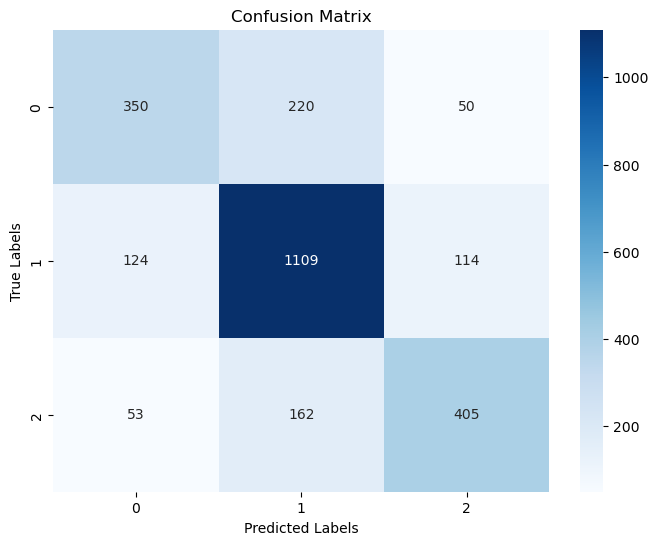

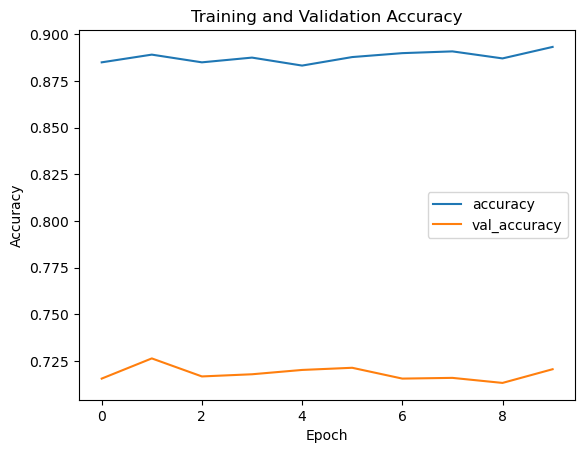

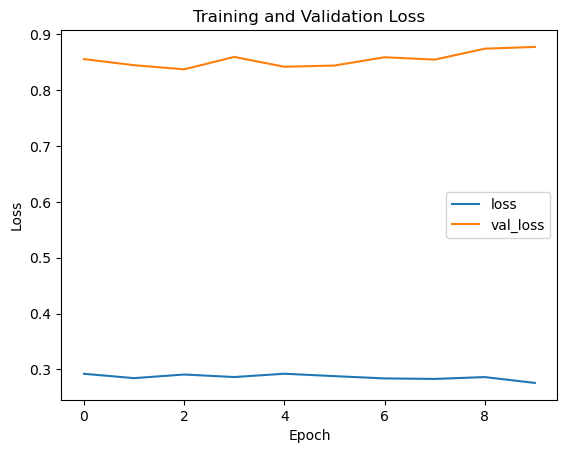

Fold 7
Epoch 1/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2691 - accuracy: 0.8972 - val_loss: 0.8850 - val_accuracy: 0.7174
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2602 - accuracy: 0.8977 - val_loss: 0.8748 - val_accuracy: 0.7163
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2660 - accuracy: 0.8956 - val_loss: 0.9081 - val_accuracy: 0.7244
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2731 - accuracy: 0.8963 - val_loss: 0.8972 - val_accuracy: 0.7163
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2589 - accuracy: 0.8993 - val_loss: 0.9095 - val_accuracy: 0.7186
Epoch 6/10
216/216 [==============================] - 2s 8ms/step - loss: 0.2609 - accuracy: 0.9001 - val_loss: 0.9209 - val_accuracy: 0.7205
Epoch 7/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2532 - accuracy: 0.9012 - val_loss: 0.9067 - val_accuracy: 0.7205

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7127947429454967, Validation F1 Score: 0.7066955407131894


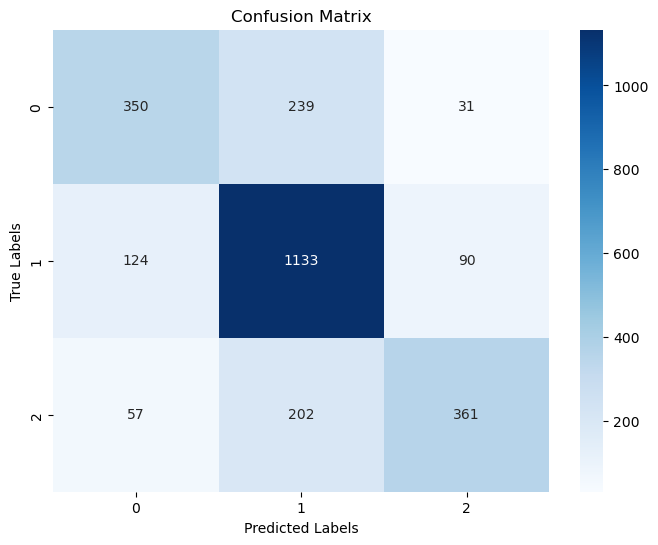

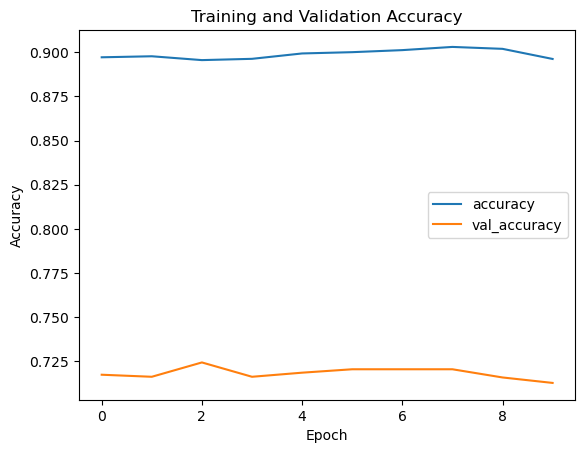

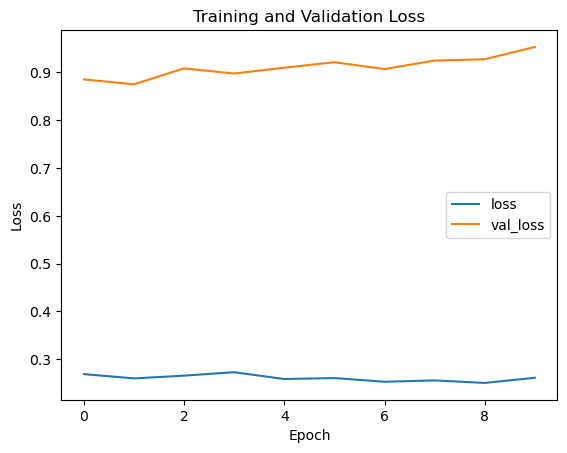

Fold 8
Epoch 1/10
216/216 [==============================] - 2s 8ms/step - loss: 0.2549 - accuracy: 0.9001 - val_loss: 0.9337 - val_accuracy: 0.7201
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2513 - accuracy: 0.9046 - val_loss: 0.9066 - val_accuracy: 0.7182
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2577 - accuracy: 0.9004 - val_loss: 0.9148 - val_accuracy: 0.7244
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2380 - accuracy: 0.9094 - val_loss: 0.9493 - val_accuracy: 0.7198
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2498 - accuracy: 0.9042 - val_loss: 0.9359 - val_accuracy: 0.7147
Epoch 6/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2399 - accuracy: 0.9127 - val_loss: 0.9191 - val_accuracy: 0.7167
Epoch 7/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2531 - accuracy: 0.9045 - val_loss: 0.9209 - val_accuracy: 0.7159

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.714340935446463, Validation F1 Score: 0.7086881815209062


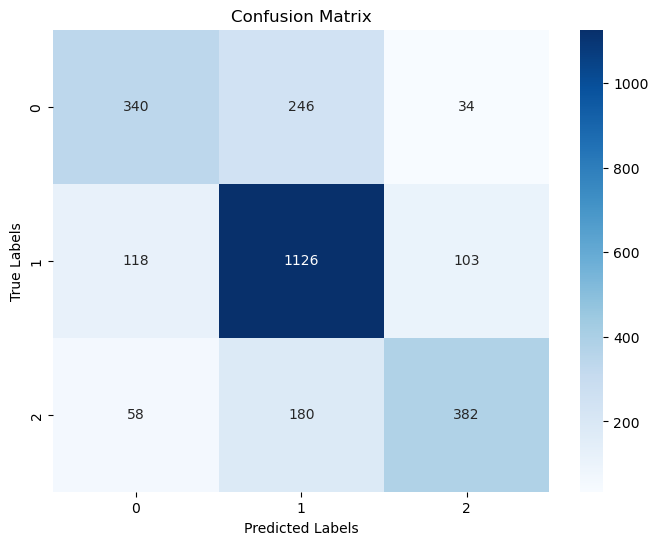

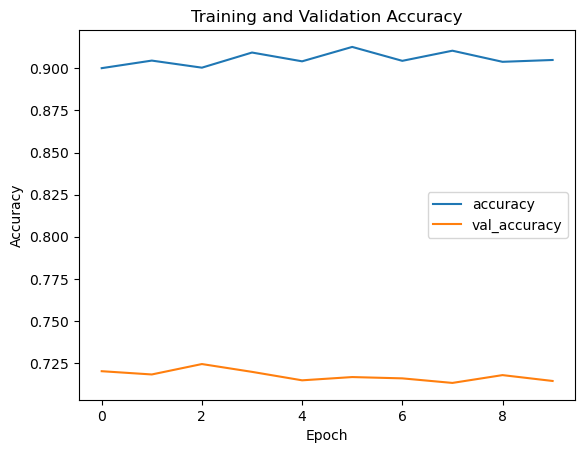

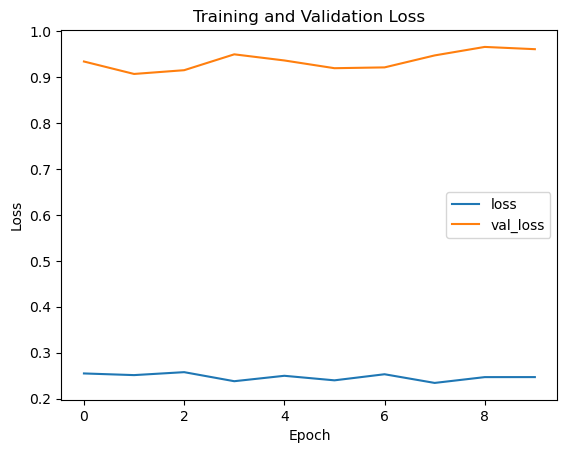

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7216853498260534
Mean F1 Score: 0.717434963448514
Number of Epochs: 10, Test Size: 0.2, Validation Size: 0.25
Fold 1
Epoch 1/10
216/216 [==============================] - 2s 7ms/step - loss: 1.5035 - accuracy: 0.5264 - val_loss: 0.8079 - val_accuracy: 0.6499
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.9039 - accuracy: 0.6168 - val_loss: 0.7419 - val_accuracy: 0.6790
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.7739 - accuracy: 0.6625 - val_loss: 0.7040 - val_accuracy: 0.6963
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.7161 - accuracy: 0.6889 - val_loss: 0.6902 - val_accuracy: 0.7065
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.6771 - accuracy: 0.7070 - val_loss: 0.6749 - val_accuracy: 0.7183
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.6562 - accuracy: 0.7151 - val_loss: 0.6625 - val_accuracy: 0.7208
Epoch 7/10
216

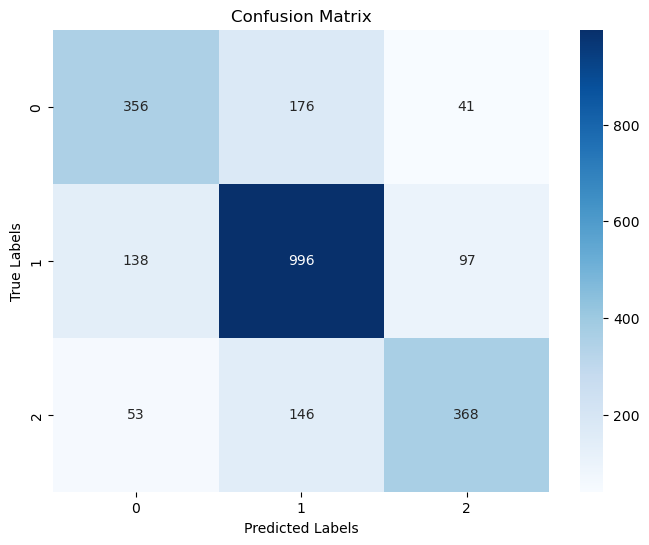

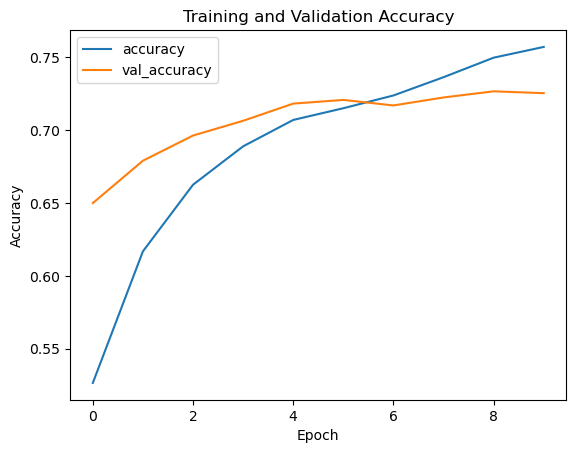

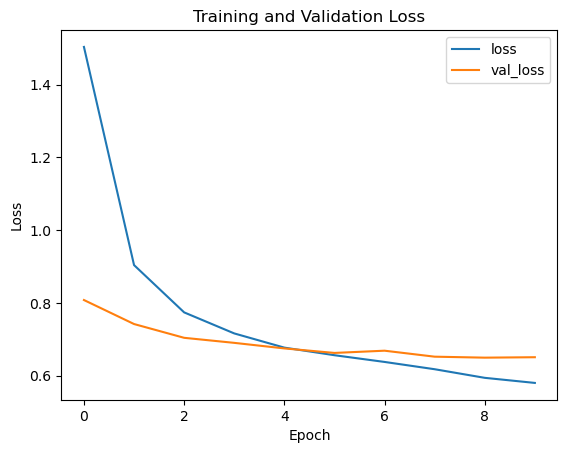

Fold 2
Epoch 1/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5593 - accuracy: 0.7669 - val_loss: 0.6533 - val_accuracy: 0.7284
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5430 - accuracy: 0.7736 - val_loss: 0.6500 - val_accuracy: 0.7263
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5278 - accuracy: 0.7790 - val_loss: 0.6501 - val_accuracy: 0.7296
Epoch 4/10
216/216 [==============================] - 2s 7ms/step - loss: 0.5108 - accuracy: 0.7889 - val_loss: 0.6561 - val_accuracy: 0.7263
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.5083 - accuracy: 0.7889 - val_loss: 0.6556 - val_accuracy: 0.7292
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4880 - accuracy: 0.7992 - val_loss: 0.6596 - val_accuracy: 0.7326
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4782 - accuracy: 0.8043 - val_loss: 0.6759 - val_accuracy: 0.7187

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.724588781105019, Validation F1 Score: 0.7203354721284977


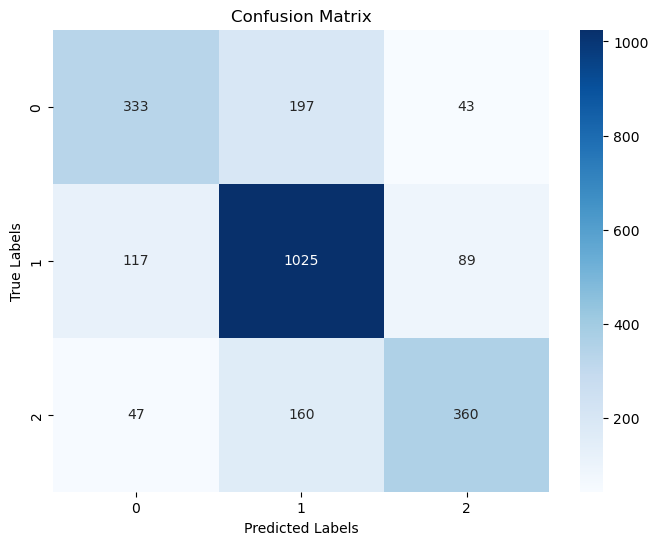

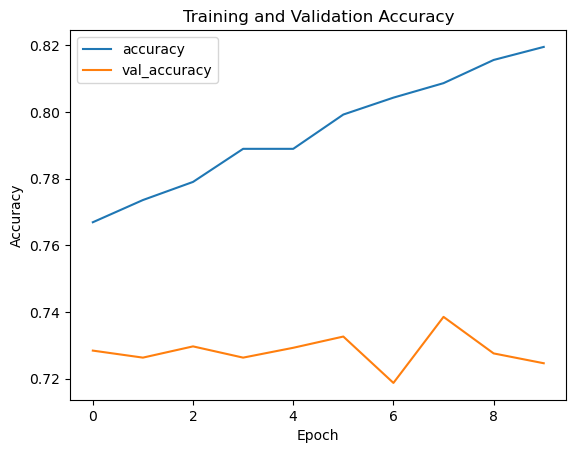

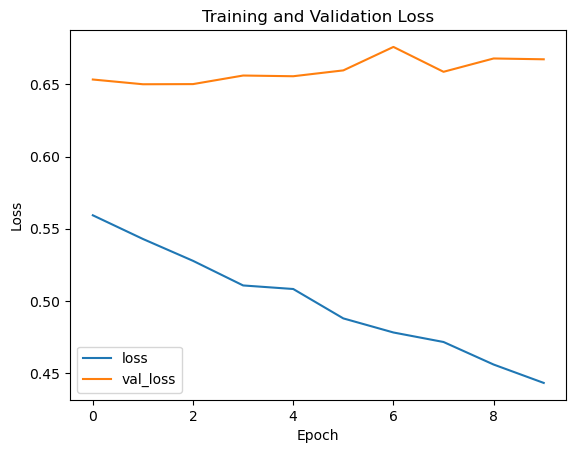

Fold 3
Epoch 1/10
216/216 [==============================] - 2s 7ms/step - loss: 0.4379 - accuracy: 0.8215 - val_loss: 0.6770 - val_accuracy: 0.7351
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4266 - accuracy: 0.8279 - val_loss: 0.6741 - val_accuracy: 0.7326
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4209 - accuracy: 0.8287 - val_loss: 0.6826 - val_accuracy: 0.7334
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4118 - accuracy: 0.8332 - val_loss: 0.6989 - val_accuracy: 0.7229
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.4023 - accuracy: 0.8367 - val_loss: 0.7073 - val_accuracy: 0.7254
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3999 - accuracy: 0.8390 - val_loss: 0.7002 - val_accuracy: 0.7263
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3944 - accuracy: 0.8392 - val_loss: 0.7046 - val_accuracy: 0.7250

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7216364403205399, Validation F1 Score: 0.7179707111294189


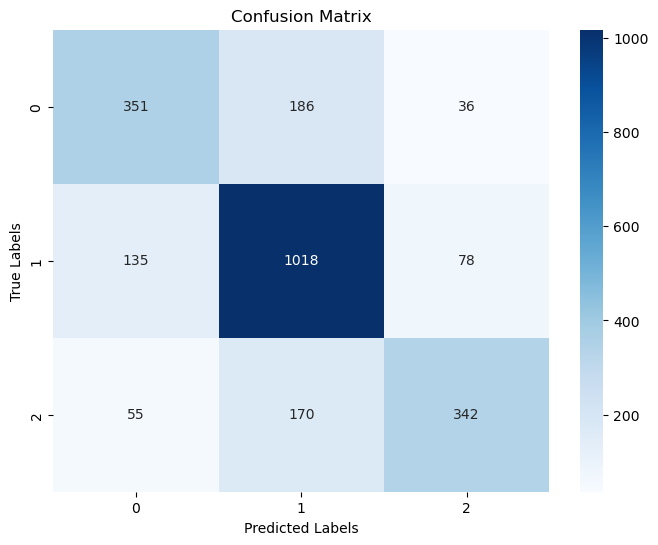

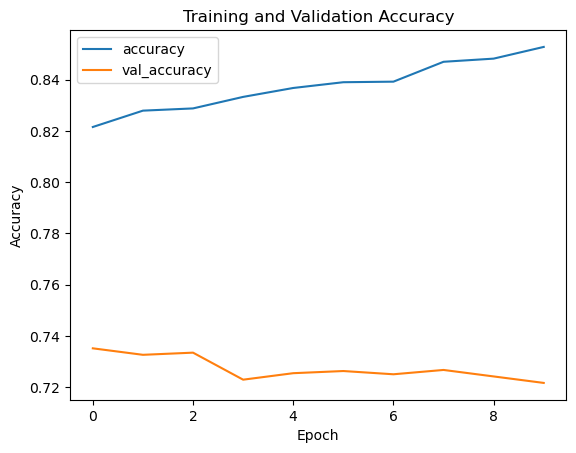

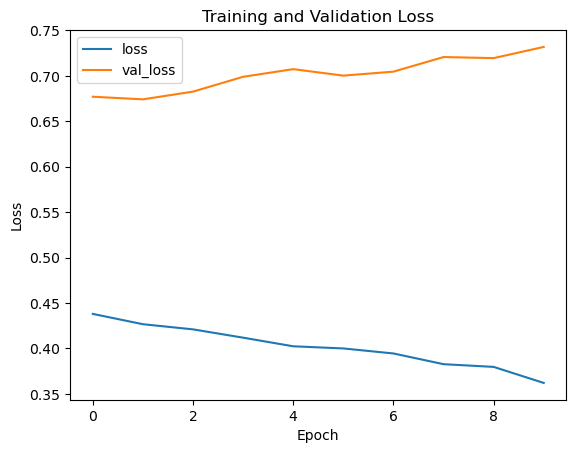

Fold 4
Epoch 1/10
216/216 [==============================] - 2s 7ms/step - loss: 0.3715 - accuracy: 0.8536 - val_loss: 0.7300 - val_accuracy: 0.7296
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3708 - accuracy: 0.8505 - val_loss: 0.7241 - val_accuracy: 0.7292
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3549 - accuracy: 0.8592 - val_loss: 0.7422 - val_accuracy: 0.7216
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3575 - accuracy: 0.8564 - val_loss: 0.7519 - val_accuracy: 0.7267
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3490 - accuracy: 0.8631 - val_loss: 0.7447 - val_accuracy: 0.7284
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3383 - accuracy: 0.8638 - val_loss: 0.7424 - val_accuracy: 0.7216
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3442 - accuracy: 0.8620 - val_loss: 0.7456 - val_accuracy: 0.7153

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.728806410797132, Validation F1 Score: 0.7239528745645533


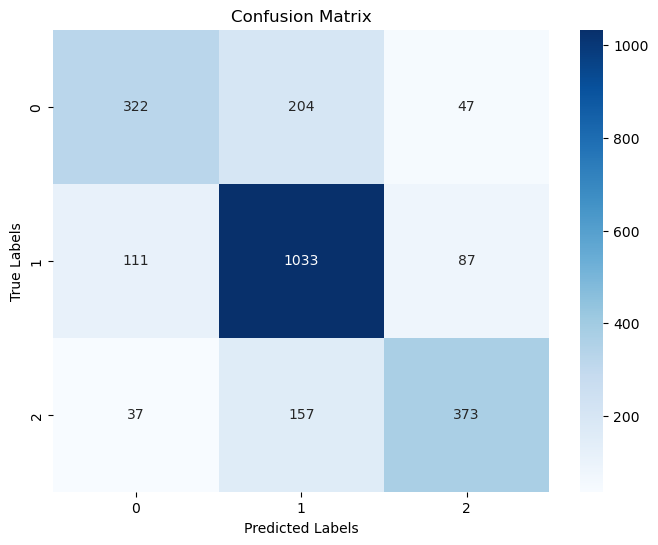

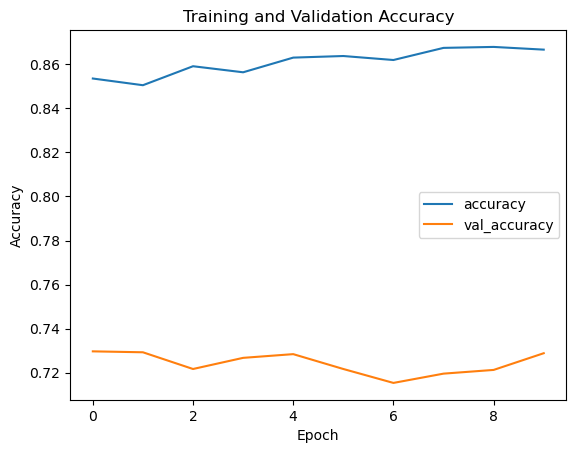

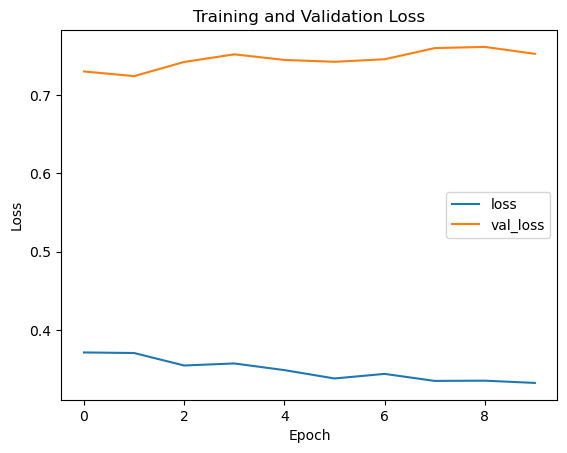

Fold 5
Epoch 1/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3195 - accuracy: 0.8728 - val_loss: 0.7538 - val_accuracy: 0.7259
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3141 - accuracy: 0.8750 - val_loss: 0.7776 - val_accuracy: 0.7208
Epoch 3/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3119 - accuracy: 0.8798 - val_loss: 0.7866 - val_accuracy: 0.7178
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3157 - accuracy: 0.8748 - val_loss: 0.7963 - val_accuracy: 0.7170
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3141 - accuracy: 0.8750 - val_loss: 0.7941 - val_accuracy: 0.7178
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.3075 - accuracy: 0.8777 - val_loss: 0.8041 - val_accuracy: 0.7233
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2996 - accuracy: 0.8823 - val_loss: 0.8242 - val_accuracy: 0.7174

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7174188106284268, Validation F1 Score: 0.7120333535370957


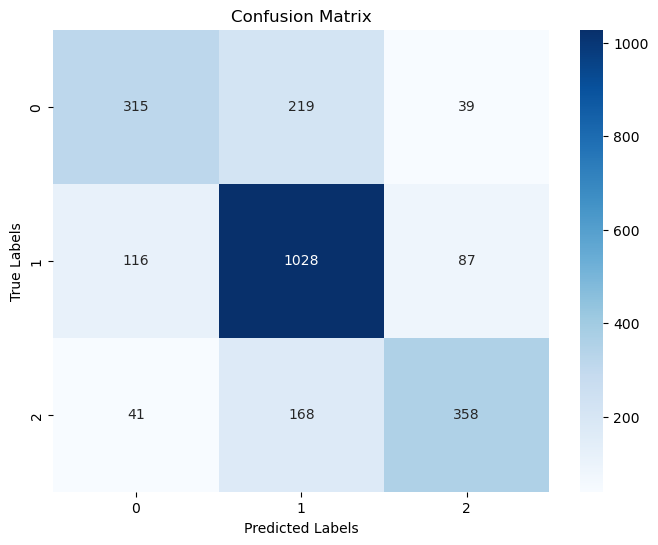

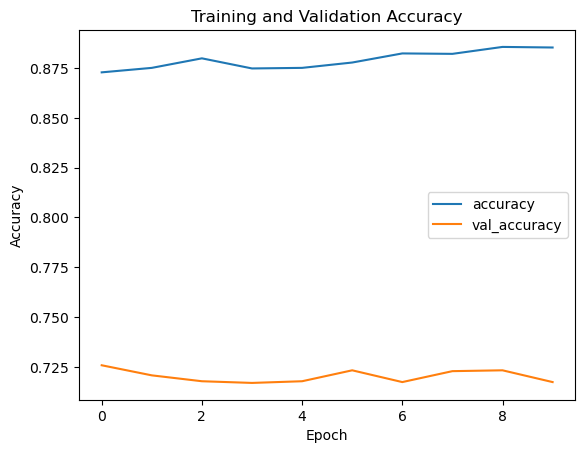

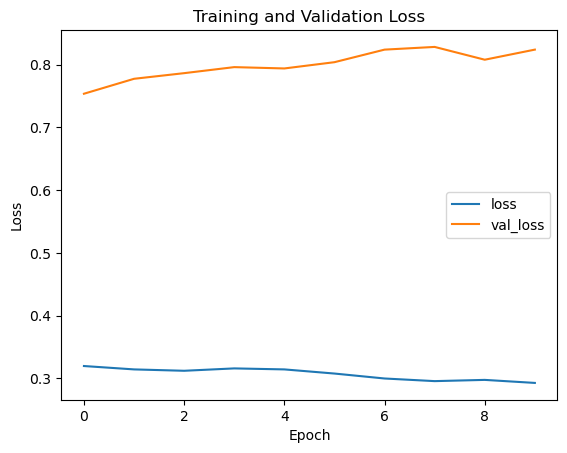

Fold 6
Epoch 1/10
216/216 [==============================] - 2s 8ms/step - loss: 0.2858 - accuracy: 0.8909 - val_loss: 0.8360 - val_accuracy: 0.7221
Epoch 2/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2822 - accuracy: 0.8897 - val_loss: 0.8441 - val_accuracy: 0.7195
Epoch 3/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2796 - accuracy: 0.8879 - val_loss: 0.8404 - val_accuracy: 0.7233
Epoch 4/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2855 - accuracy: 0.8889 - val_loss: 0.8307 - val_accuracy: 0.7259
Epoch 5/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2820 - accuracy: 0.8902 - val_loss: 0.8348 - val_accuracy: 0.7254
Epoch 6/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2743 - accuracy: 0.8939 - val_loss: 0.8405 - val_accuracy: 0.7225
Epoch 7/10
216/216 [==============================] - 2s 8ms/step - loss: 0.2833 - accuracy: 0.8923 - val_loss: 0.8461 - val_accuracy: 0.7212

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7237452551665964, Validation F1 Score: 0.7198777219454428


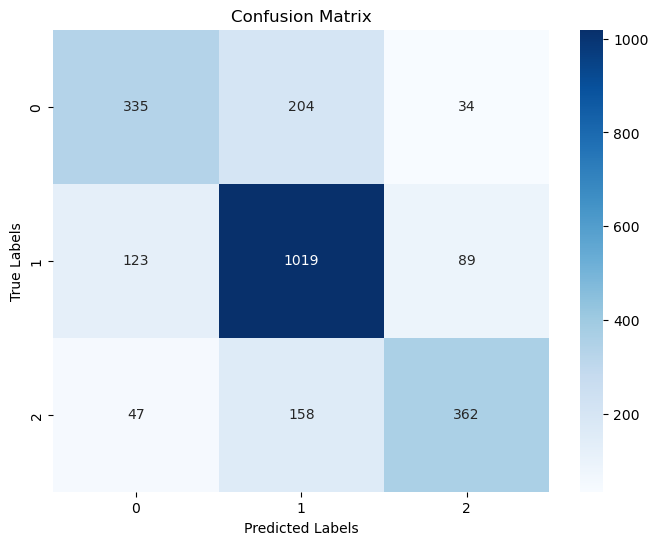

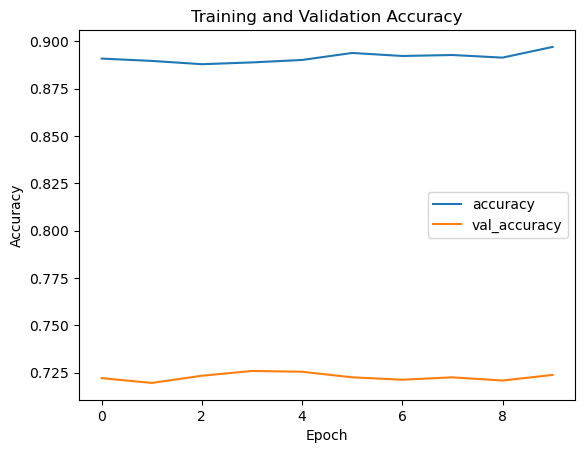

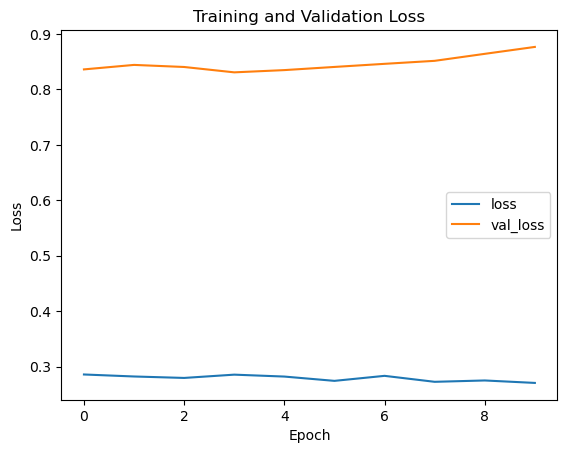

Fold 7
Epoch 1/10
216/216 [==============================] - 2s 8ms/step - loss: 0.2670 - accuracy: 0.8958 - val_loss: 0.8690 - val_accuracy: 0.7237
Epoch 2/10
216/216 [==============================] - 2s 8ms/step - loss: 0.2559 - accuracy: 0.8997 - val_loss: 0.8833 - val_accuracy: 0.7242
Epoch 3/10
216/216 [==============================] - 2s 8ms/step - loss: 0.2641 - accuracy: 0.8970 - val_loss: 0.8688 - val_accuracy: 0.7237
Epoch 4/10
216/216 [==============================] - 2s 8ms/step - loss: 0.2575 - accuracy: 0.9027 - val_loss: 0.8859 - val_accuracy: 0.7237
Epoch 5/10
216/216 [==============================] - 2s 8ms/step - loss: 0.2568 - accuracy: 0.8995 - val_loss: 0.8914 - val_accuracy: 0.7208
Epoch 6/10
216/216 [==============================] - 2s 8ms/step - loss: 0.2627 - accuracy: 0.8989 - val_loss: 0.8855 - val_accuracy: 0.7199
Epoch 7/10
216/216 [==============================] - 2s 9ms/step - loss: 0.2567 - accuracy: 0.9019 - val_loss: 0.8906 - val_accuracy: 0.7166

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 3ms/step
Validation Accuracy: 0.7182623365668495, Validation F1 Score: 0.7162748800411558


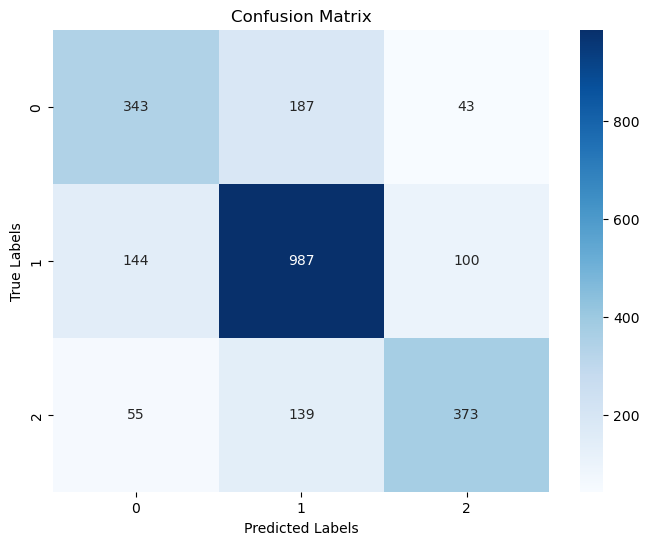

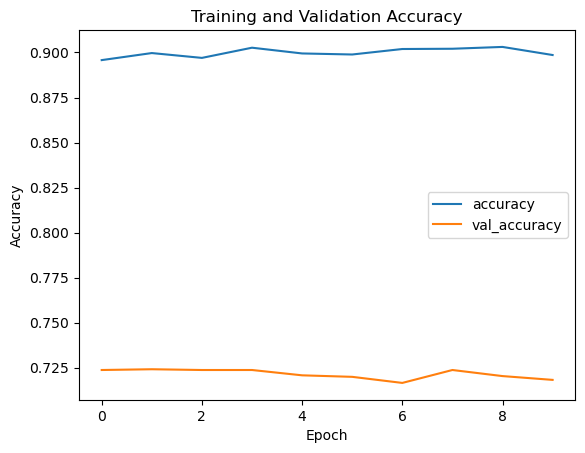

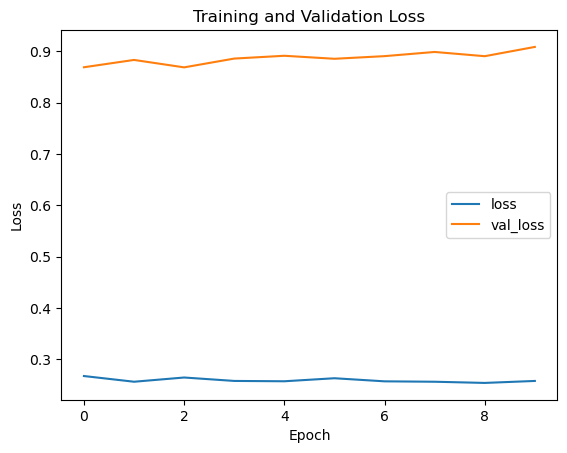

Fold 8
Epoch 1/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2551 - accuracy: 0.9051 - val_loss: 0.9182 - val_accuracy: 0.7187
Epoch 2/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2470 - accuracy: 0.9019 - val_loss: 0.9089 - val_accuracy: 0.7208
Epoch 3/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2475 - accuracy: 0.9048 - val_loss: 0.9368 - val_accuracy: 0.7153
Epoch 4/10
216/216 [==============================] - 2s 7ms/step - loss: 0.2488 - accuracy: 0.9019 - val_loss: 0.9306 - val_accuracy: 0.7140
Epoch 5/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2404 - accuracy: 0.9063 - val_loss: 0.9206 - val_accuracy: 0.7157
Epoch 6/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2416 - accuracy: 0.9091 - val_loss: 0.9520 - val_accuracy: 0.7162
Epoch 7/10
216/216 [==============================] - 1s 7ms/step - loss: 0.2457 - accuracy: 0.9058 - val_loss: 0.9359 - val_accuracy: 0.7221

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.713622943905525, Validation F1 Score: 0.7102651356037509


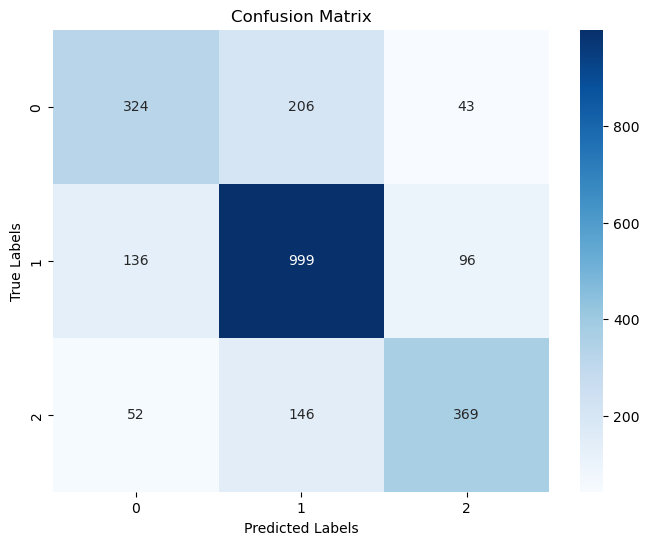

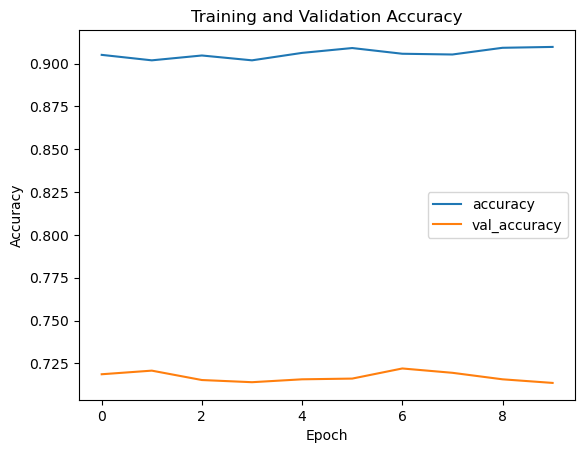

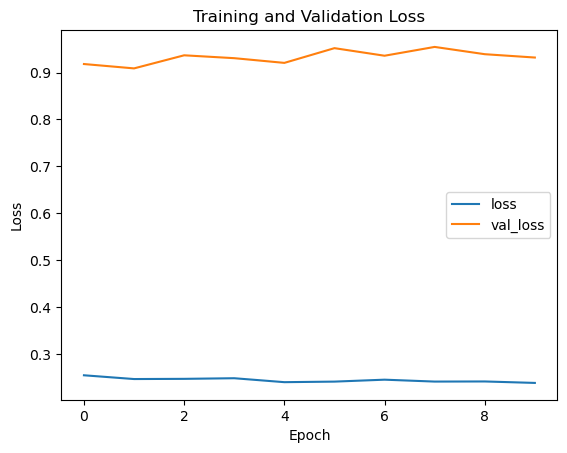

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7216891606916913
Mean F1 Score: 0.7180142515856334
Number of Epochs: 10, Test Size: 0.25, Validation Size: 0.15
Fold 1
Epoch 1/10
203/203 [==============================] - 2s 8ms/step - loss: 1.5275 - accuracy: 0.5215 - val_loss: 0.8402 - val_accuracy: 0.6335
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.9171 - accuracy: 0.6165 - val_loss: 0.7618 - val_accuracy: 0.6677
Epoch 3/10
203/203 [==============================] - 1s 7ms/step - loss: 0.7819 - accuracy: 0.6575 - val_loss: 0.7307 - val_accuracy: 0.6854
Epoch 4/10
203/203 [==============================] - 1s 7ms/step - loss: 0.7158 - accuracy: 0.6876 - val_loss: 0.7195 - val_accuracy: 0.6892
Epoch 5/10
203/203 [==============================] - 1s 7ms/step - loss: 0.6800 - accuracy: 0.7071 - val_loss: 0.7049 - val_accuracy: 0.6964
Epoch 6/10
203/203 [==============================] - 1s 7ms/step - loss: 0.6587 - accuracy: 0.7177 - val_loss: 0.6978 - val_accuracy: 0.6996
Epoch 7/10
2

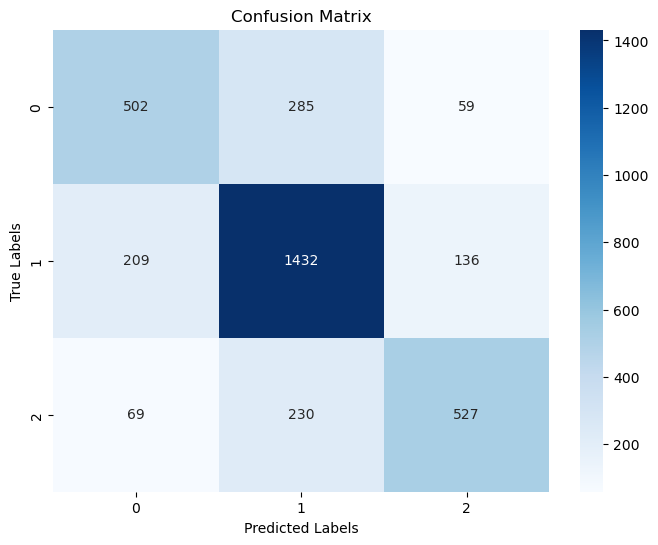

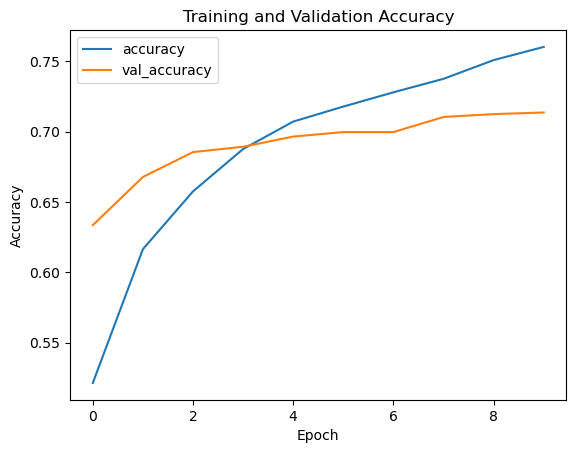

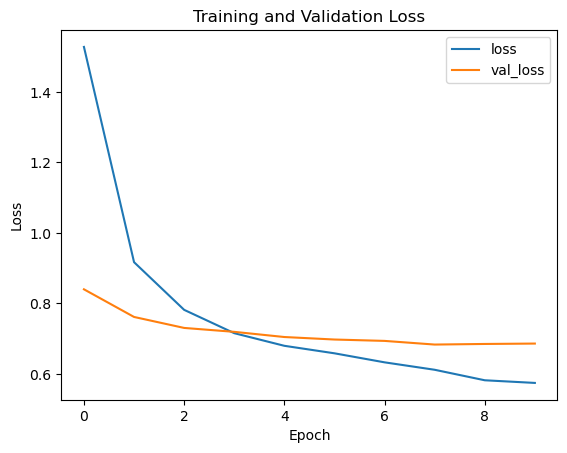

Fold 2
Epoch 1/10
203/203 [==============================] - 1s 7ms/step - loss: 0.5591 - accuracy: 0.7651 - val_loss: 0.6859 - val_accuracy: 0.7086
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.5458 - accuracy: 0.7711 - val_loss: 0.6817 - val_accuracy: 0.7054
Epoch 3/10
203/203 [==============================] - 2s 8ms/step - loss: 0.5265 - accuracy: 0.7811 - val_loss: 0.6960 - val_accuracy: 0.7104
Epoch 4/10
203/203 [==============================] - 1s 7ms/step - loss: 0.5103 - accuracy: 0.7864 - val_loss: 0.6984 - val_accuracy: 0.7040
Epoch 5/10
203/203 [==============================] - 1s 7ms/step - loss: 0.5049 - accuracy: 0.7909 - val_loss: 0.7065 - val_accuracy: 0.7089
Epoch 6/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4895 - accuracy: 0.7965 - val_loss: 0.7000 - val_accuracy: 0.7112
Epoch 7/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4811 - accuracy: 0.8024 - val_loss: 0.6977 - val_accuracy: 0.7095

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7077413743113946, Validation F1 Score: 0.7033603964476404


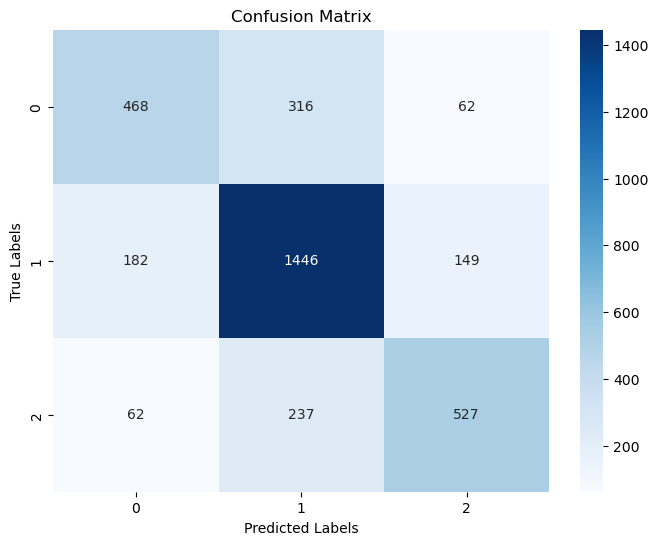

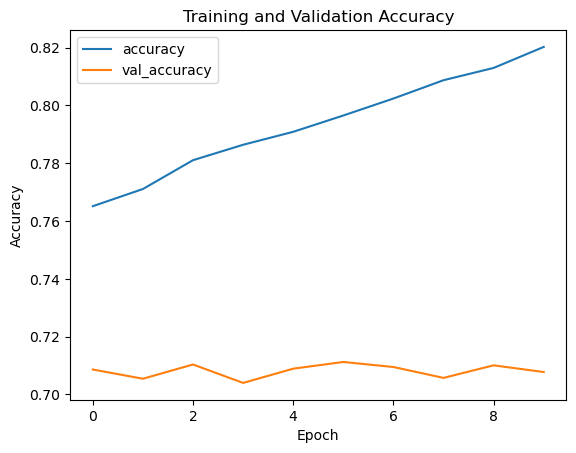

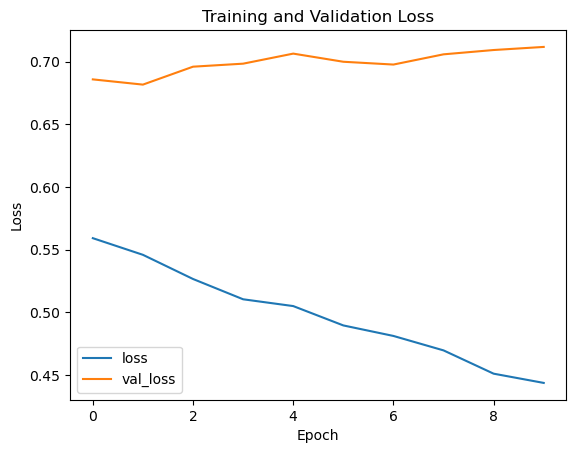

Fold 3
Epoch 1/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4305 - accuracy: 0.8265 - val_loss: 0.7135 - val_accuracy: 0.7063
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4321 - accuracy: 0.8227 - val_loss: 0.7224 - val_accuracy: 0.7060
Epoch 3/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4123 - accuracy: 0.8352 - val_loss: 0.7422 - val_accuracy: 0.7034
Epoch 4/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4179 - accuracy: 0.8309 - val_loss: 0.7345 - val_accuracy: 0.7153
Epoch 5/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3982 - accuracy: 0.8414 - val_loss: 0.7479 - val_accuracy: 0.7156
Epoch 6/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3956 - accuracy: 0.8426 - val_loss: 0.7415 - val_accuracy: 0.7130
Epoch 7/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3910 - accuracy: 0.8430 - val_loss: 0.7539 - val_accuracy: 0.7147

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7115105827776167, Validation F1 Score: 0.7097228668519724


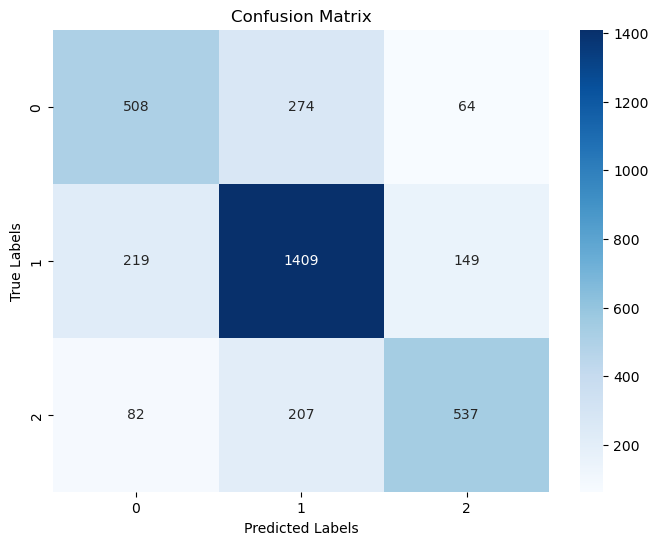

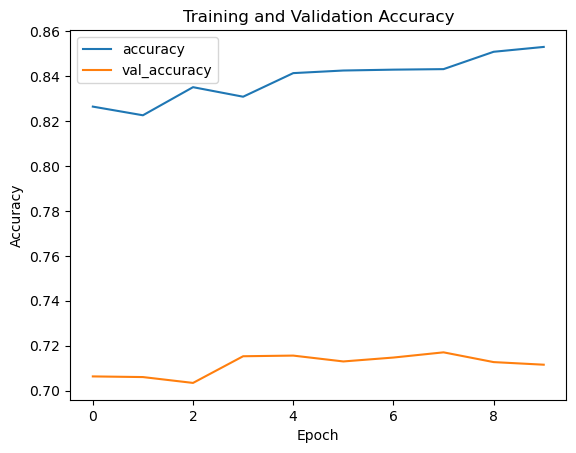

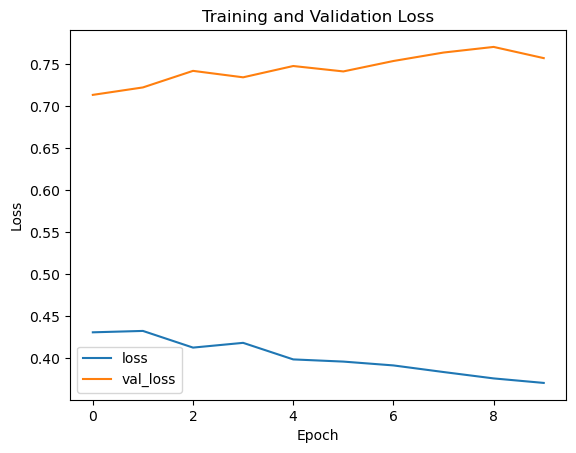

Fold 4
Epoch 1/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3701 - accuracy: 0.8554 - val_loss: 0.7664 - val_accuracy: 0.7089
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3684 - accuracy: 0.8567 - val_loss: 0.7639 - val_accuracy: 0.7115
Epoch 3/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3527 - accuracy: 0.8615 - val_loss: 0.7926 - val_accuracy: 0.7043
Epoch 4/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3470 - accuracy: 0.8628 - val_loss: 0.8154 - val_accuracy: 0.7069
Epoch 5/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3476 - accuracy: 0.8644 - val_loss: 0.8019 - val_accuracy: 0.7109
Epoch 6/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3368 - accuracy: 0.8692 - val_loss: 0.7993 - val_accuracy: 0.7019
Epoch 7/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3374 - accuracy: 0.8654 - val_loss: 0.8081 - val_accuracy: 0.7063

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7033922876195999, Validation F1 Score: 0.6978686250667812


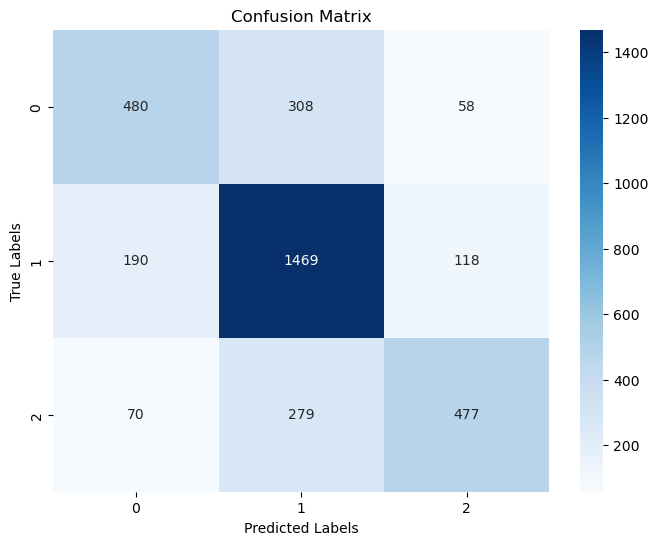

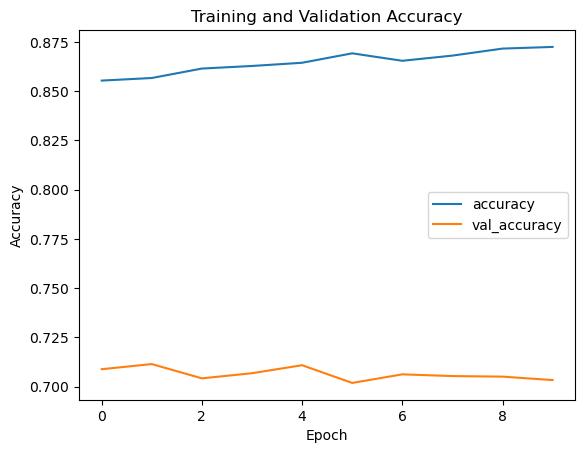

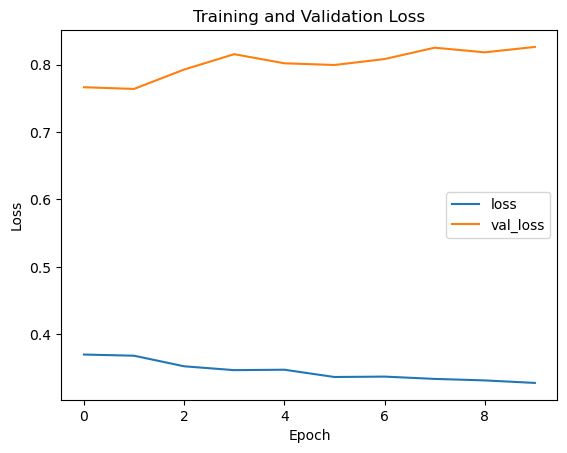

Fold 5
Epoch 1/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3178 - accuracy: 0.8738 - val_loss: 0.8215 - val_accuracy: 0.7115
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3184 - accuracy: 0.8789 - val_loss: 0.8276 - val_accuracy: 0.7083
Epoch 3/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3134 - accuracy: 0.8820 - val_loss: 0.8366 - val_accuracy: 0.7051
Epoch 4/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2996 - accuracy: 0.8823 - val_loss: 0.8352 - val_accuracy: 0.7046
Epoch 5/10
203/203 [==============================] - 2s 8ms/step - loss: 0.2926 - accuracy: 0.8863 - val_loss: 0.8784 - val_accuracy: 0.7083
Epoch 6/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3020 - accuracy: 0.8818 - val_loss: 0.8784 - val_accuracy: 0.7066
Epoch 7/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2990 - accuracy: 0.8812 - val_loss: 0.8776 - val_accuracy: 0.7034

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7060017396346767, Validation F1 Score: 0.7002573734333882


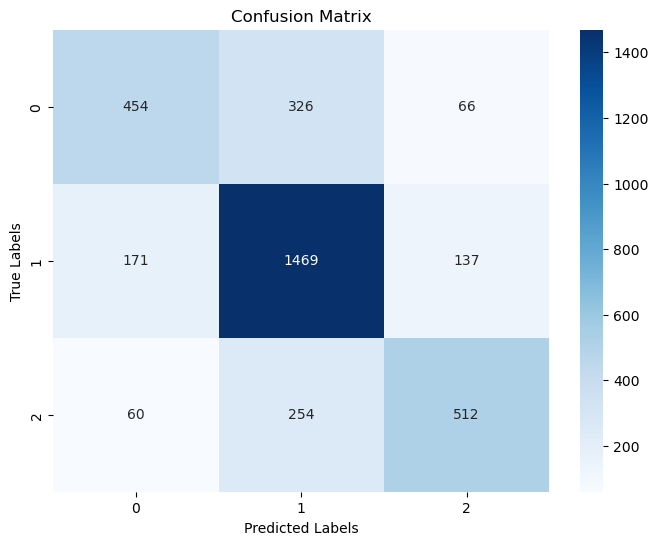

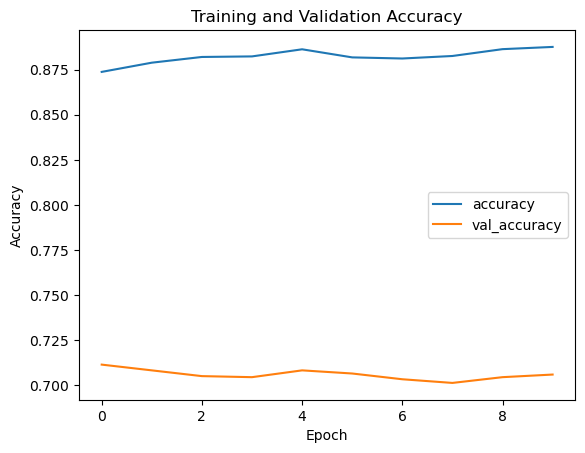

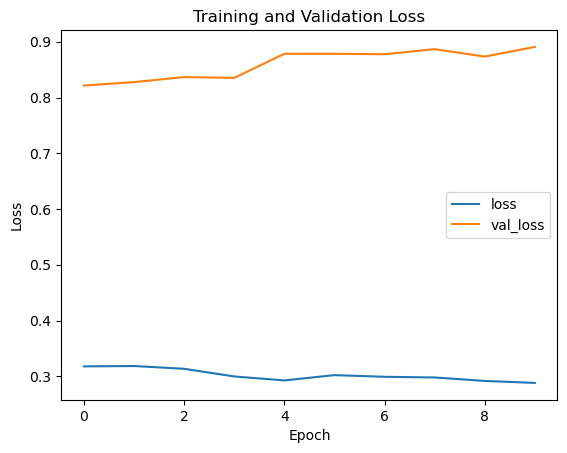

Fold 6
Epoch 1/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2866 - accuracy: 0.8857 - val_loss: 0.8901 - val_accuracy: 0.7048
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2814 - accuracy: 0.8908 - val_loss: 0.8909 - val_accuracy: 0.7043
Epoch 3/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2816 - accuracy: 0.8914 - val_loss: 0.8945 - val_accuracy: 0.7063
Epoch 4/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2846 - accuracy: 0.8908 - val_loss: 0.8953 - val_accuracy: 0.7077
Epoch 5/10
203/203 [==============================] - 2s 7ms/step - loss: 0.2732 - accuracy: 0.8905 - val_loss: 0.9132 - val_accuracy: 0.7025
Epoch 6/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2729 - accuracy: 0.8933 - val_loss: 0.9094 - val_accuracy: 0.7025
Epoch 7/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2816 - accuracy: 0.8915 - val_loss: 0.9371 - val_accuracy: 0.6921

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6941142360104378, Validation F1 Score: 0.6900971147788261


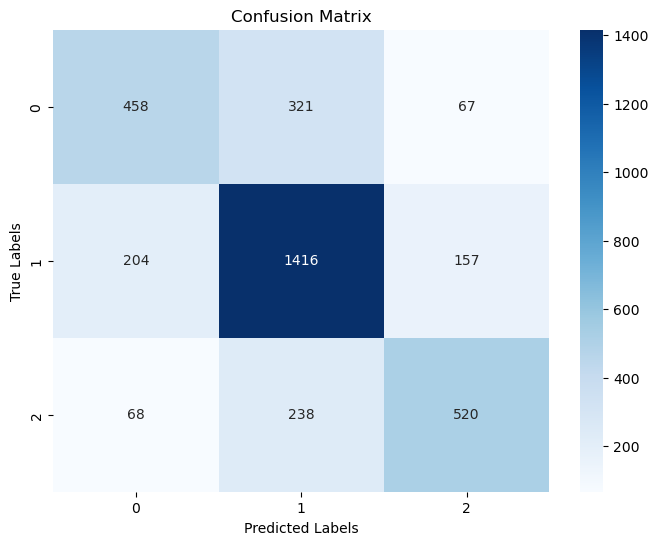

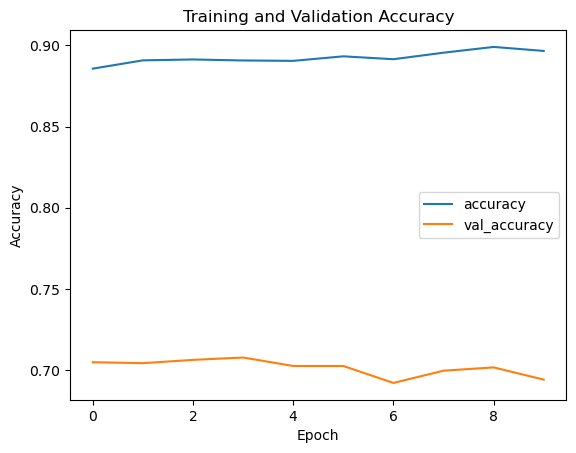

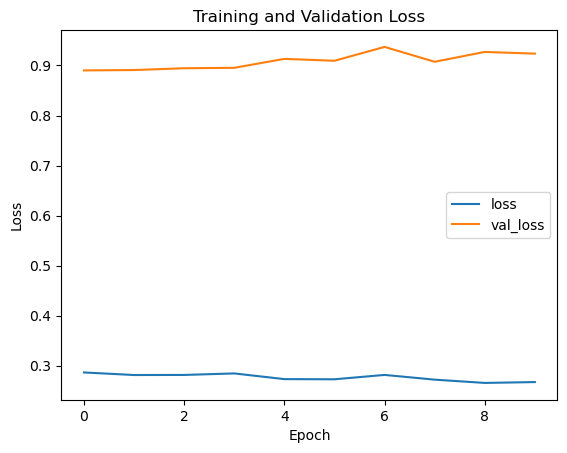

Fold 7
Epoch 1/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2575 - accuracy: 0.9031 - val_loss: 0.9259 - val_accuracy: 0.7040
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2614 - accuracy: 0.8993 - val_loss: 0.9444 - val_accuracy: 0.7054
Epoch 3/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2584 - accuracy: 0.9014 - val_loss: 0.9316 - val_accuracy: 0.7040
Epoch 4/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2579 - accuracy: 0.9051 - val_loss: 0.9566 - val_accuracy: 0.7011
Epoch 5/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2551 - accuracy: 0.9022 - val_loss: 0.9574 - val_accuracy: 0.7022
Epoch 6/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2508 - accuracy: 0.9025 - val_loss: 0.9701 - val_accuracy: 0.7005
Epoch 7/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2541 - accuracy: 0.9001 - val_loss: 0.9585 - val_accuracy: 0.7025

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7068715569730356, Validation F1 Score: 0.702544409846683


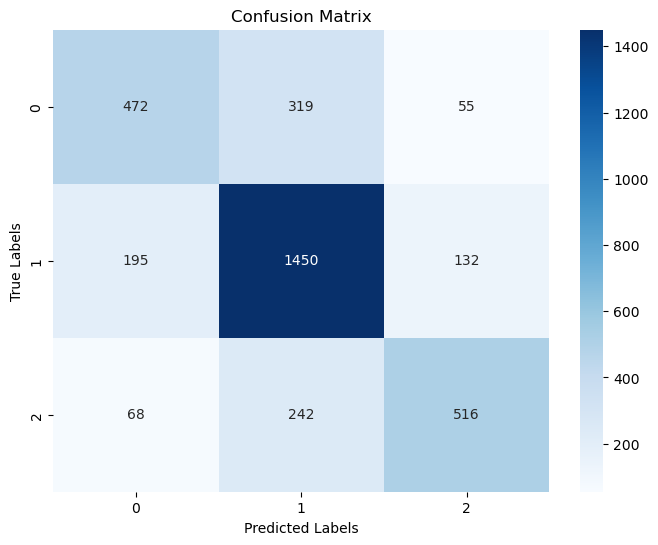

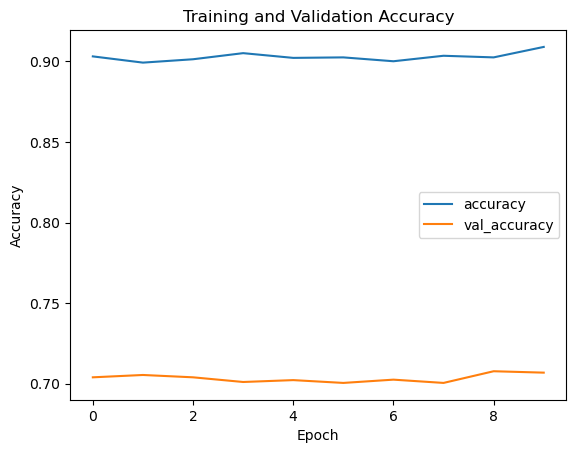

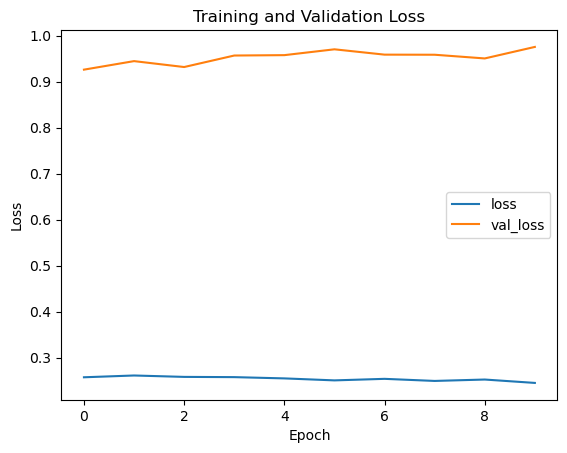

Fold 8
Epoch 1/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2431 - accuracy: 0.9081 - val_loss: 0.9902 - val_accuracy: 0.7089
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2476 - accuracy: 0.9037 - val_loss: 1.0019 - val_accuracy: 0.7028
Epoch 3/10
203/203 [==============================] - 2s 8ms/step - loss: 0.2423 - accuracy: 0.9069 - val_loss: 0.9746 - val_accuracy: 0.7051
Epoch 4/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2450 - accuracy: 0.9088 - val_loss: 0.9875 - val_accuracy: 0.6990
Epoch 5/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2320 - accuracy: 0.9117 - val_loss: 0.9938 - val_accuracy: 0.7008
Epoch 6/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2385 - accuracy: 0.9091 - val_loss: 0.9995 - val_accuracy: 0.7005
Epoch 7/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2299 - accuracy: 0.9125 - val_loss: 1.0117 - val_accuracy: 0.7028

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.700782835604523, Validation F1 Score: 0.6960795691005184


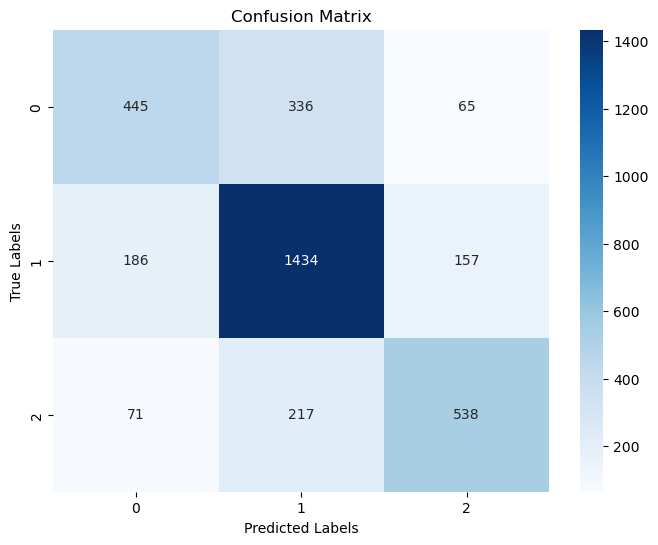

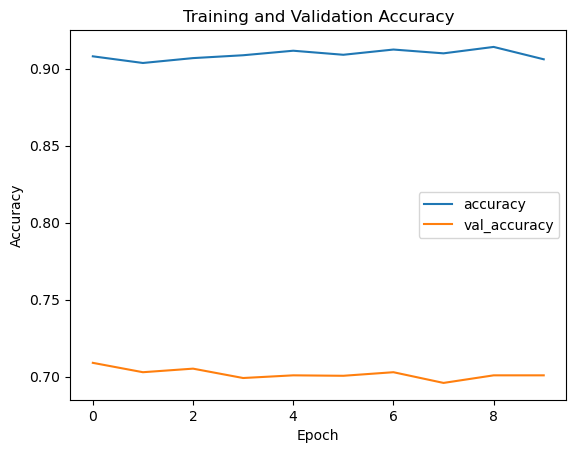

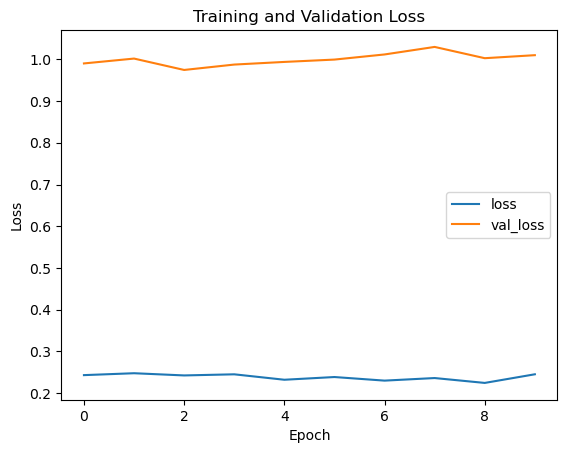

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7054943461873007
Mean F1 Score: 0.7013363038361312
Number of Epochs: 10, Test Size: 0.25, Validation Size: 0.2
Fold 1
Epoch 1/10
203/203 [==============================] - 2s 8ms/step - loss: 1.4293 - accuracy: 0.5245 - val_loss: 0.8020 - val_accuracy: 0.6445
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.8927 - accuracy: 0.6187 - val_loss: 0.7527 - val_accuracy: 0.6701
Epoch 3/10
203/203 [==============================] - 1s 7ms/step - loss: 0.7702 - accuracy: 0.6625 - val_loss: 0.7275 - val_accuracy: 0.6784
Epoch 4/10
203/203 [==============================] - 1s 7ms/step - loss: 0.7209 - accuracy: 0.6845 - val_loss: 0.7192 - val_accuracy: 0.6891
Epoch 5/10
203/203 [==============================] - 1s 7ms/step - loss: 0.6858 - accuracy: 0.7039 - val_loss: 0.7007 - val_accuracy: 0.6970
Epoch 6/10
203/203 [==============================] - 1s 7ms/step - loss: 0.6575 - accuracy: 0.7147 - val_loss: 0.6939 - val_accuracy: 0.6961
Epoch 7/10
20

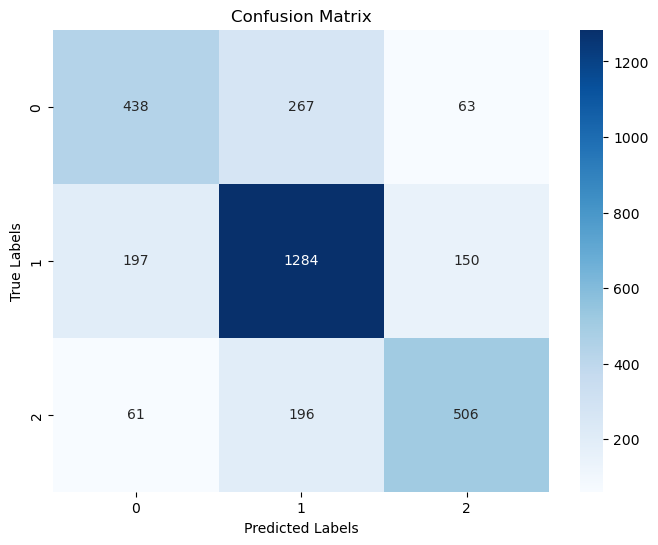

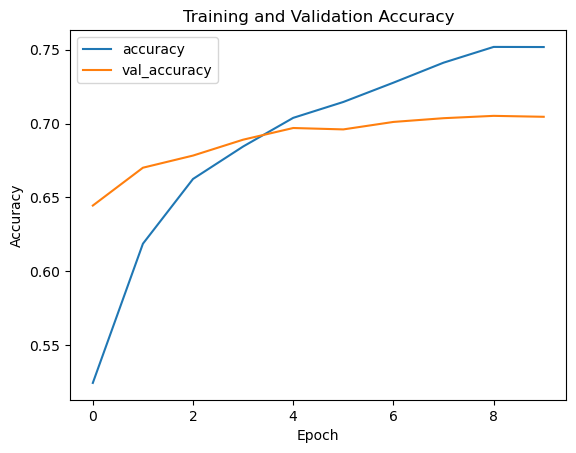

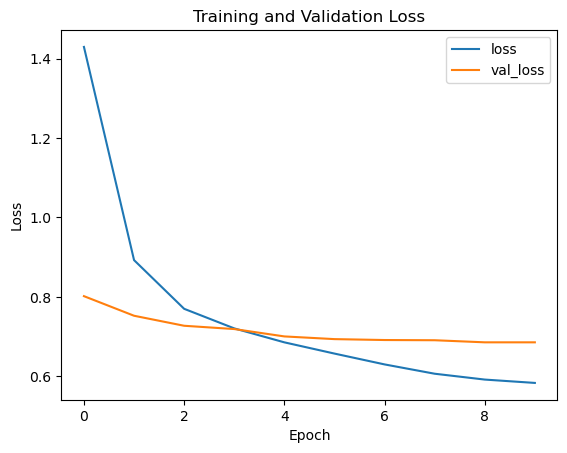

Fold 2
Epoch 1/10
203/203 [==============================] - 2s 7ms/step - loss: 0.5569 - accuracy: 0.7682 - val_loss: 0.6924 - val_accuracy: 0.7087
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.5426 - accuracy: 0.7681 - val_loss: 0.6854 - val_accuracy: 0.7062
Epoch 3/10
203/203 [==============================] - 1s 7ms/step - loss: 0.5268 - accuracy: 0.7840 - val_loss: 0.6896 - val_accuracy: 0.7078
Epoch 4/10
203/203 [==============================] - 2s 8ms/step - loss: 0.5175 - accuracy: 0.7855 - val_loss: 0.6889 - val_accuracy: 0.7100
Epoch 5/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4986 - accuracy: 0.7940 - val_loss: 0.6889 - val_accuracy: 0.7094
Epoch 6/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4962 - accuracy: 0.7969 - val_loss: 0.6998 - val_accuracy: 0.7068
Epoch 7/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4797 - accuracy: 0.8017 - val_loss: 0.7042 - val_accuracy: 0.7037

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.704617330803289, Validation F1 Score: 0.6971722002725279


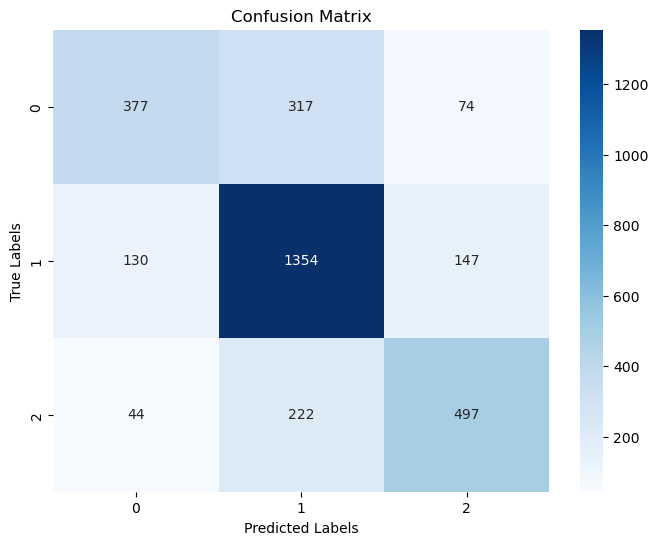

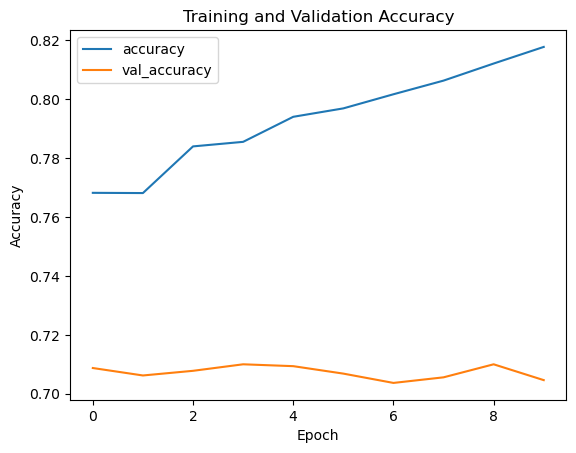

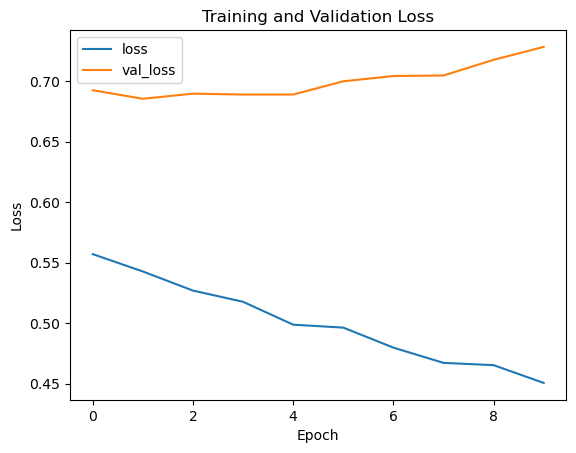

Fold 3
Epoch 1/10
203/203 [==============================] - 2s 8ms/step - loss: 0.4357 - accuracy: 0.8240 - val_loss: 0.7119 - val_accuracy: 0.7106
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4274 - accuracy: 0.8275 - val_loss: 0.7202 - val_accuracy: 0.7157
Epoch 3/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4279 - accuracy: 0.8271 - val_loss: 0.7166 - val_accuracy: 0.7109
Epoch 4/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4075 - accuracy: 0.8400 - val_loss: 0.7261 - val_accuracy: 0.7034
Epoch 5/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4001 - accuracy: 0.8393 - val_loss: 0.7422 - val_accuracy: 0.7068
Epoch 6/10
203/203 [==============================] - 1s 7ms/step - loss: 0.4046 - accuracy: 0.8384 - val_loss: 0.7372 - val_accuracy: 0.7081
Epoch 7/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3878 - accuracy: 0.8435 - val_loss: 0.7510 - val_accuracy: 0.7046

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7017710309930424, Validation F1 Score: 0.7006456906242711


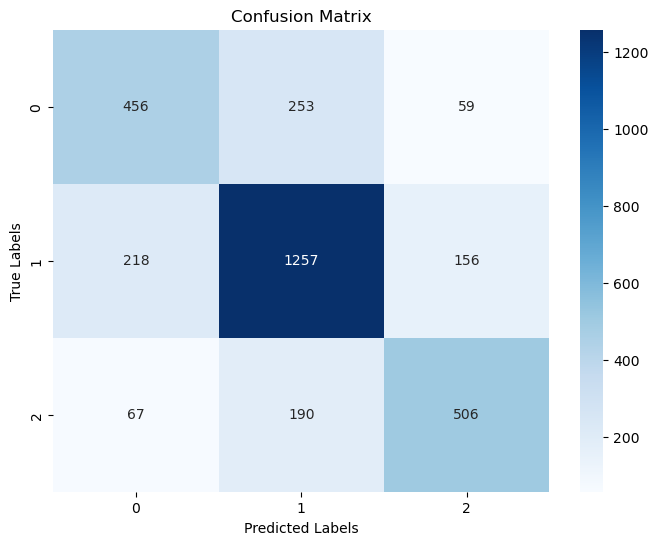

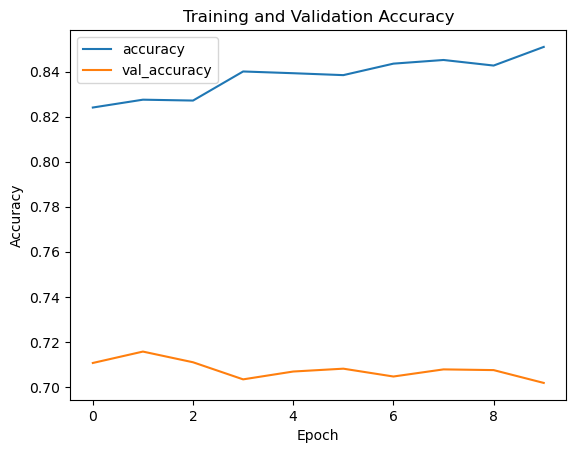

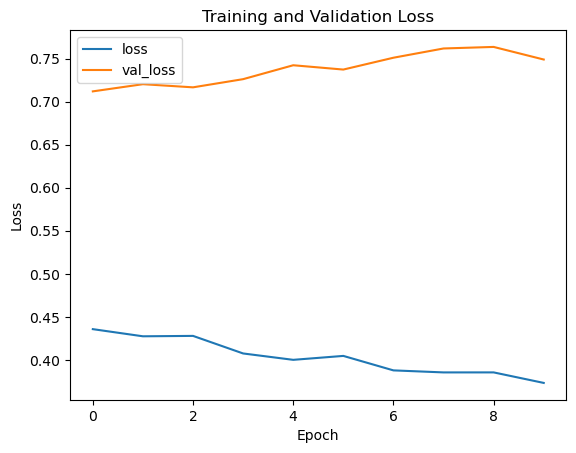

Fold 4
Epoch 1/10
203/203 [==============================] - 2s 8ms/step - loss: 0.3655 - accuracy: 0.8540 - val_loss: 0.7731 - val_accuracy: 0.7125
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3586 - accuracy: 0.8582 - val_loss: 0.7801 - val_accuracy: 0.7109
Epoch 3/10
203/203 [==============================] - 2s 8ms/step - loss: 0.3540 - accuracy: 0.8595 - val_loss: 0.7883 - val_accuracy: 0.7109
Epoch 4/10
203/203 [==============================] - 2s 9ms/step - loss: 0.3409 - accuracy: 0.8635 - val_loss: 0.7919 - val_accuracy: 0.7097
Epoch 5/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3501 - accuracy: 0.8593 - val_loss: 0.7831 - val_accuracy: 0.7141
Epoch 6/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3326 - accuracy: 0.8680 - val_loss: 0.8048 - val_accuracy: 0.7119
Epoch 7/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3329 - accuracy: 0.8684 - val_loss: 0.7928 - val_accuracy: 0.7081

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7128399746995573, Validation F1 Score: 0.7071664964969611


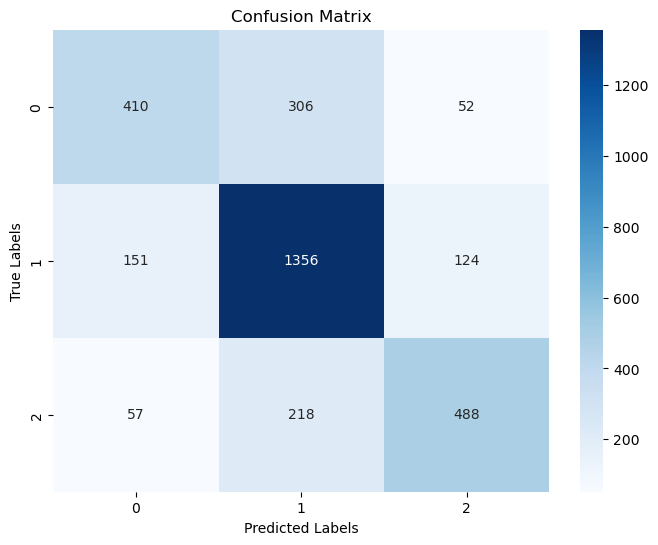

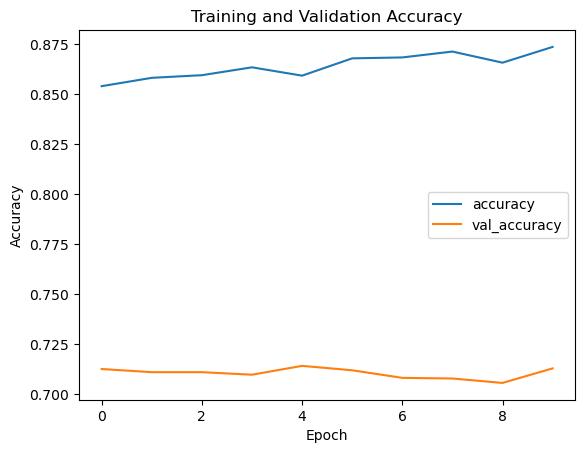

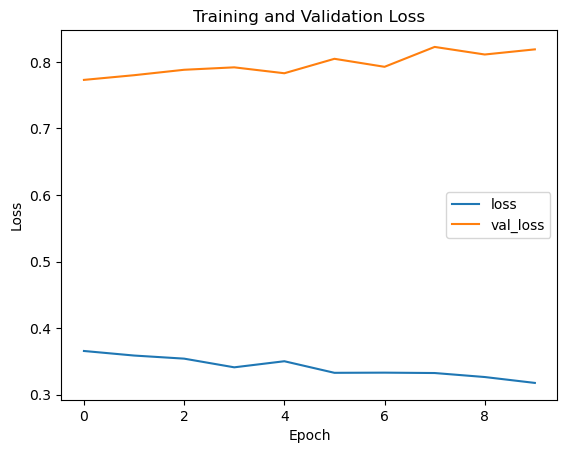

Fold 5
Epoch 1/10
203/203 [==============================] - 2s 8ms/step - loss: 0.3114 - accuracy: 0.8761 - val_loss: 0.8224 - val_accuracy: 0.7046
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3227 - accuracy: 0.8704 - val_loss: 0.8437 - val_accuracy: 0.7008
Epoch 3/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2980 - accuracy: 0.8855 - val_loss: 0.8527 - val_accuracy: 0.7109
Epoch 4/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3026 - accuracy: 0.8849 - val_loss: 0.8582 - val_accuracy: 0.7087
Epoch 5/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3042 - accuracy: 0.8778 - val_loss: 0.8498 - val_accuracy: 0.7119
Epoch 6/10
203/203 [==============================] - 1s 7ms/step - loss: 0.3062 - accuracy: 0.8808 - val_loss: 0.8773 - val_accuracy: 0.7040
Epoch 7/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2838 - accuracy: 0.8886 - val_loss: 0.8726 - val_accuracy: 0.7071

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7103099304237824, Validation F1 Score: 0.7048489518816969


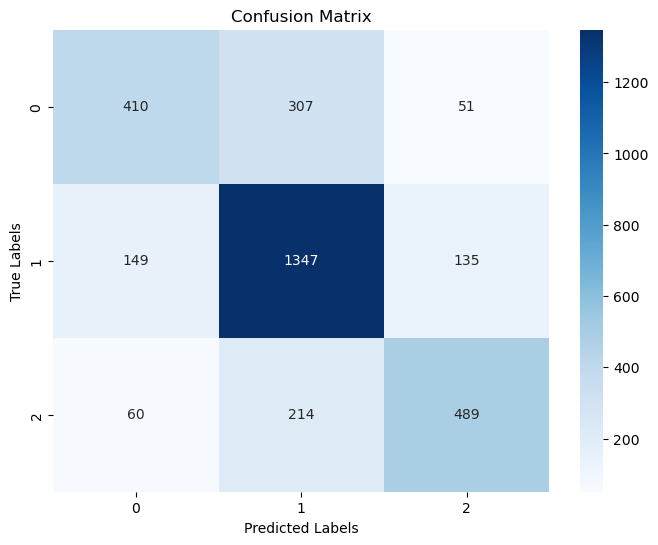

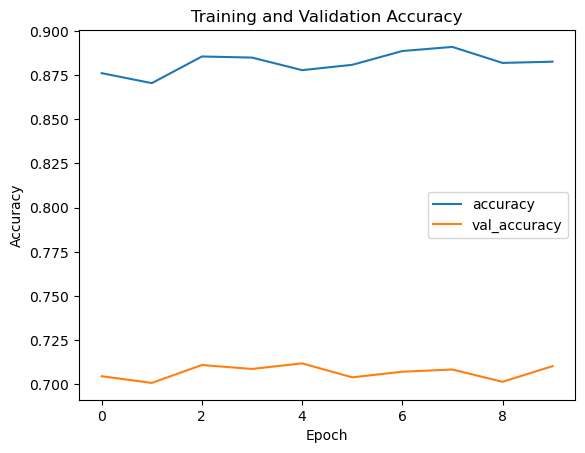

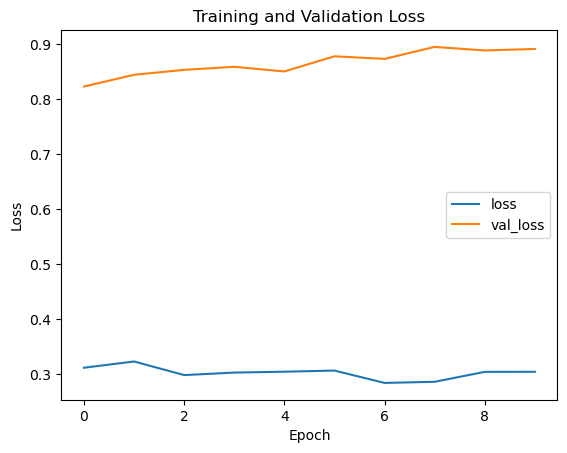

Fold 6
Epoch 1/10
203/203 [==============================] - 2s 9ms/step - loss: 0.2888 - accuracy: 0.8870 - val_loss: 0.8987 - val_accuracy: 0.6980
Epoch 2/10
203/203 [==============================] - 2s 12ms/step - loss: 0.2833 - accuracy: 0.8851 - val_loss: 0.8970 - val_accuracy: 0.7075
Epoch 3/10
203/203 [==============================] - 3s 13ms/step - loss: 0.2873 - accuracy: 0.8893 - val_loss: 0.8873 - val_accuracy: 0.7046
Epoch 4/10
203/203 [==============================] - 2s 9ms/step - loss: 0.2732 - accuracy: 0.8949 - val_loss: 0.9016 - val_accuracy: 0.7065
Epoch 5/10
203/203 [==============================] - 3s 16ms/step - loss: 0.2805 - accuracy: 0.8915 - val_loss: 0.9280 - val_accuracy: 0.7056
Epoch 6/10
203/203 [==============================] - 2s 10ms/step - loss: 0.2801 - accuracy: 0.8910 - val_loss: 0.9015 - val_accuracy: 0.7049
Epoch 7/10
203/203 [==============================] - 2s 10ms/step - loss: 0.2719 - accuracy: 0.8931 - val_loss: 0.9139 - val_accuracy: 0

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 3ms/step
Validation Accuracy: 0.7055660974067046, Validation F1 Score: 0.6985872080181111


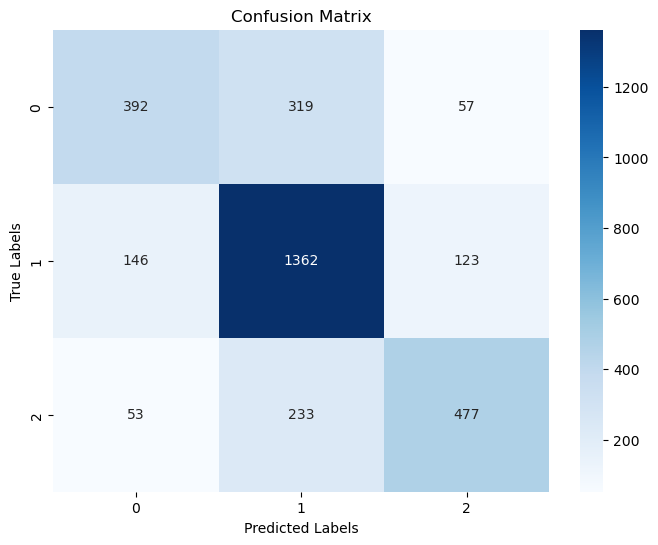

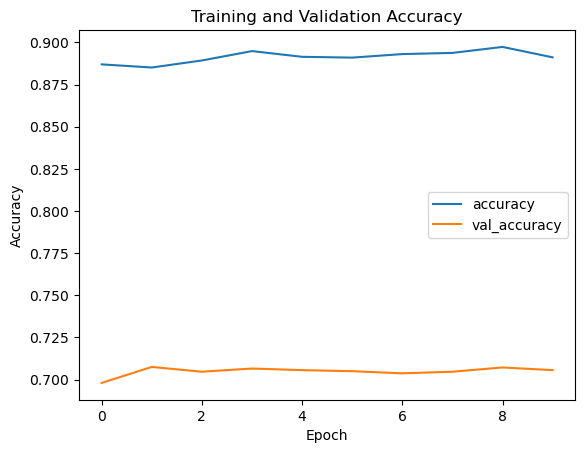

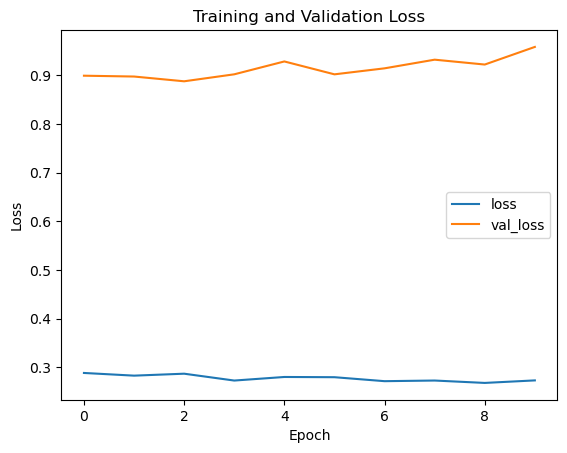

Fold 7
Epoch 1/10
203/203 [==============================] - 3s 13ms/step - loss: 0.2685 - accuracy: 0.8975 - val_loss: 0.9454 - val_accuracy: 0.7062
Epoch 2/10
203/203 [==============================] - 2s 9ms/step - loss: 0.2541 - accuracy: 0.9025 - val_loss: 0.9610 - val_accuracy: 0.7005
Epoch 3/10
203/203 [==============================] - 2s 8ms/step - loss: 0.2564 - accuracy: 0.9033 - val_loss: 0.9672 - val_accuracy: 0.7049
Epoch 4/10
203/203 [==============================] - 2s 11ms/step - loss: 0.2613 - accuracy: 0.9007 - val_loss: 0.9665 - val_accuracy: 0.7094
Epoch 5/10
203/203 [==============================] - 2s 12ms/step - loss: 0.2534 - accuracy: 0.9056 - val_loss: 0.9722 - val_accuracy: 0.7030
Epoch 6/10
203/203 [==============================] - 2s 12ms/step - loss: 0.2503 - accuracy: 0.9034 - val_loss: 1.0005 - val_accuracy: 0.7097
Epoch 7/10
203/203 [==============================] - 3s 14ms/step - loss: 0.2460 - accuracy: 0.9038 - val_loss: 0.9751 - val_accuracy: 0

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.706831119544592, Validation F1 Score: 0.7022931217814269


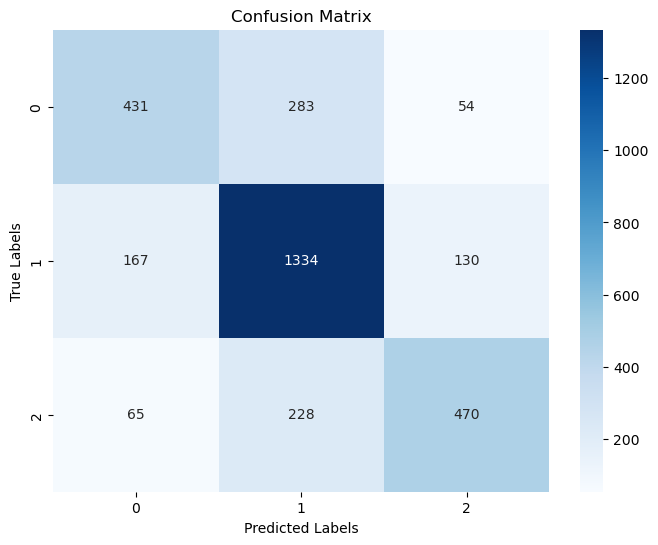

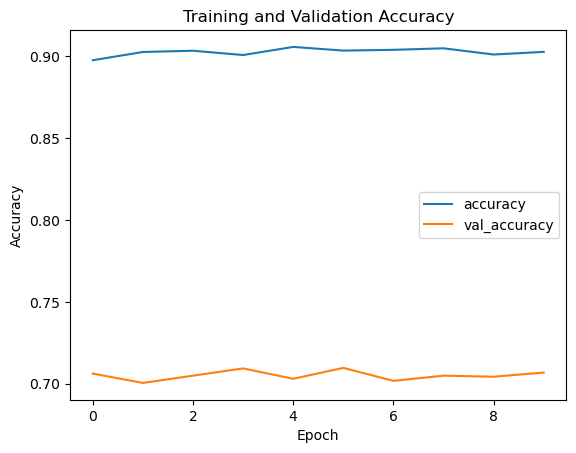

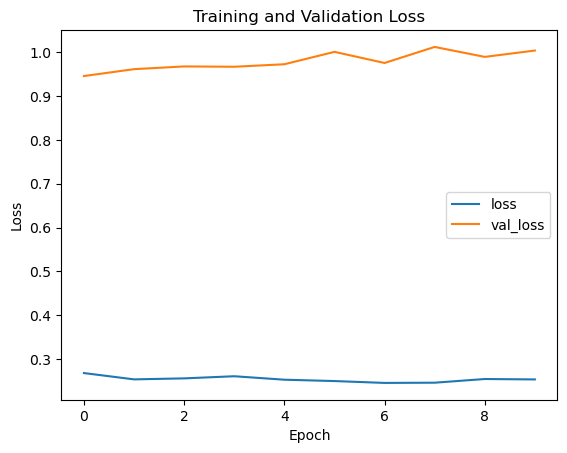

Fold 8
Epoch 1/10
203/203 [==============================] - 2s 8ms/step - loss: 0.2516 - accuracy: 0.9036 - val_loss: 1.0039 - val_accuracy: 0.7068
Epoch 2/10
203/203 [==============================] - 2s 8ms/step - loss: 0.2462 - accuracy: 0.9059 - val_loss: 1.0006 - val_accuracy: 0.6986
Epoch 3/10
203/203 [==============================] - 2s 8ms/step - loss: 0.2418 - accuracy: 0.9087 - val_loss: 1.0126 - val_accuracy: 0.7043
Epoch 4/10
203/203 [==============================] - 2s 12ms/step - loss: 0.2439 - accuracy: 0.9056 - val_loss: 1.0015 - val_accuracy: 0.6992
Epoch 5/10
203/203 [==============================] - 2s 11ms/step - loss: 0.2282 - accuracy: 0.9136 - val_loss: 1.0310 - val_accuracy: 0.7024
Epoch 6/10
203/203 [==============================] - 3s 15ms/step - loss: 0.2295 - accuracy: 0.9122 - val_loss: 1.0252 - val_accuracy: 0.7059
Epoch 7/10
203/203 [==============================] - 3s 13ms/step - loss: 0.2385 - accuracy: 0.9088 - val_loss: 1.0228 - val_accuracy: 0.

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 3ms/step
Validation Accuracy: 0.7122074636306135, Validation F1 Score: 0.7072091901301498


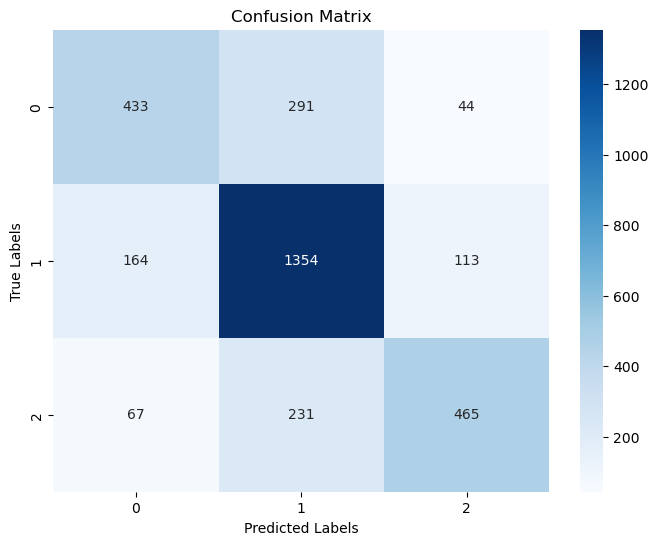

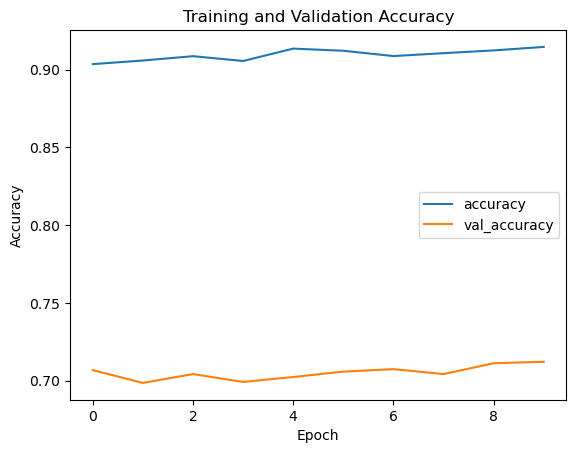

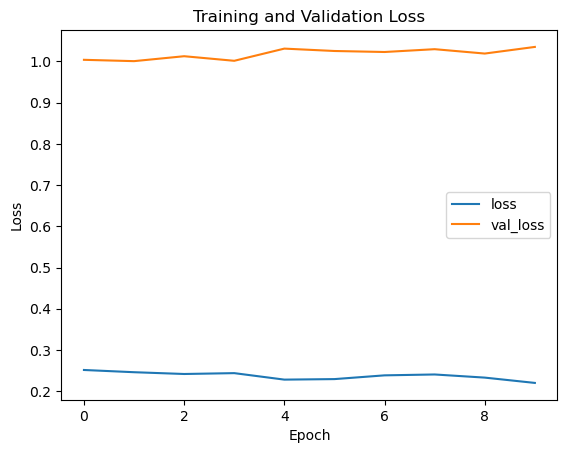

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7073450347881087
Mean F1 Score: 0.7025199100268404
Number of Epochs: 10, Test Size: 0.25, Validation Size: 0.25
Fold 1
Epoch 1/10
203/203 [==============================] - 3s 9ms/step - loss: 1.5095 - accuracy: 0.5181 - val_loss: 0.8133 - val_accuracy: 0.6364
Epoch 2/10
203/203 [==============================] - 2s 8ms/step - loss: 0.9265 - accuracy: 0.6117 - val_loss: 0.7643 - val_accuracy: 0.6635
Epoch 3/10
203/203 [==============================] - 2s 9ms/step - loss: 0.7805 - accuracy: 0.6580 - val_loss: 0.7361 - val_accuracy: 0.6771
Epoch 4/10
203/203 [==============================] - 2s 9ms/step - loss: 0.7271 - accuracy: 0.6843 - val_loss: 0.7174 - val_accuracy: 0.6872
Epoch 5/10
203/203 [==============================] - 2s 11ms/step - loss: 0.6836 - accuracy: 0.7068 - val_loss: 0.7064 - val_accuracy: 0.6917
Epoch 6/10
203/203 [==============================] - 3s 15ms/step - loss: 0.6567 - accuracy: 0.7170 - val_loss: 0.6923 - val_accuracy: 0.6980
Epoch 7/10

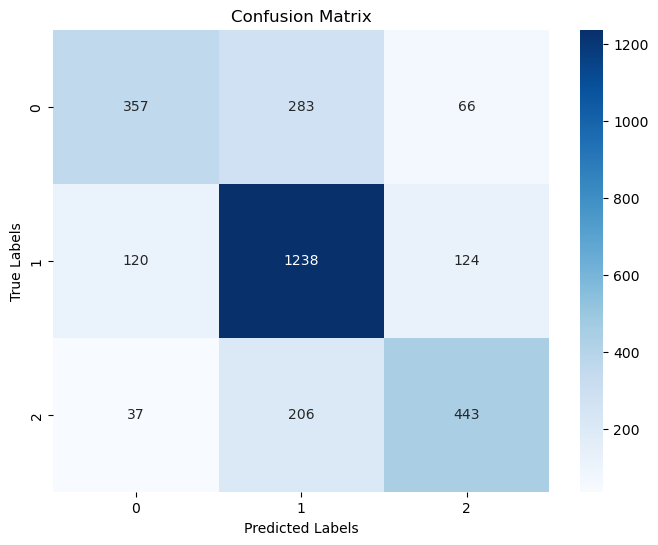

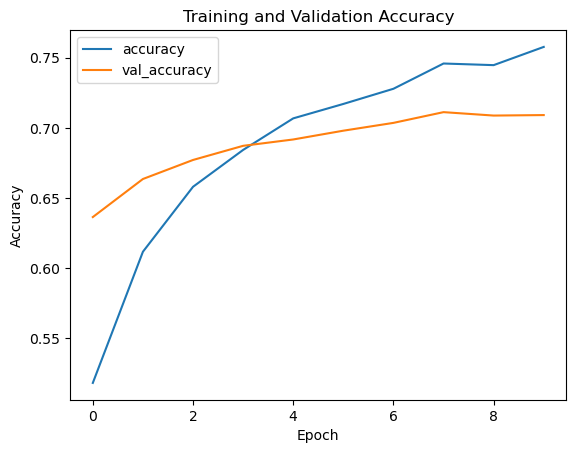

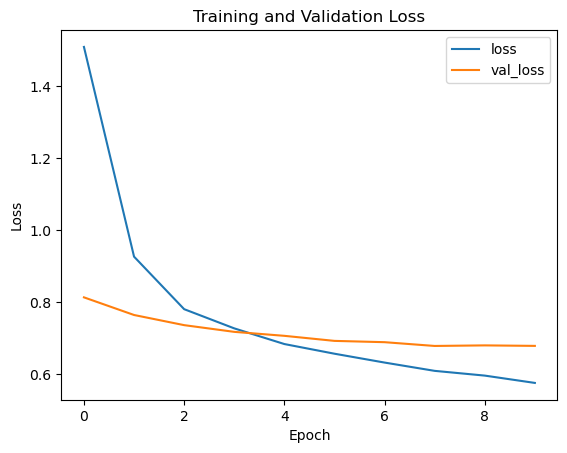

Fold 2
Epoch 1/10
203/203 [==============================] - 2s 8ms/step - loss: 0.5529 - accuracy: 0.7693 - val_loss: 0.6758 - val_accuracy: 0.7157
Epoch 2/10
203/203 [==============================] - 2s 9ms/step - loss: 0.5453 - accuracy: 0.7726 - val_loss: 0.6857 - val_accuracy: 0.7122
Epoch 3/10
203/203 [==============================] - 2s 8ms/step - loss: 0.5321 - accuracy: 0.7803 - val_loss: 0.6828 - val_accuracy: 0.7143
Epoch 4/10
203/203 [==============================] - 2s 8ms/step - loss: 0.5183 - accuracy: 0.7888 - val_loss: 0.6882 - val_accuracy: 0.7136
Epoch 5/10
203/203 [==============================] - 2s 9ms/step - loss: 0.5079 - accuracy: 0.7905 - val_loss: 0.6907 - val_accuracy: 0.7070
Epoch 6/10
203/203 [==============================] - 2s 8ms/step - loss: 0.4998 - accuracy: 0.7952 - val_loss: 0.6896 - val_accuracy: 0.7126
Epoch 7/10
203/203 [==============================] - 2s 9ms/step - loss: 0.4818 - accuracy: 0.8026 - val_loss: 0.6934 - val_accuracy: 0.7070

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7153792623521225, Validation F1 Score: 0.7106924546938476


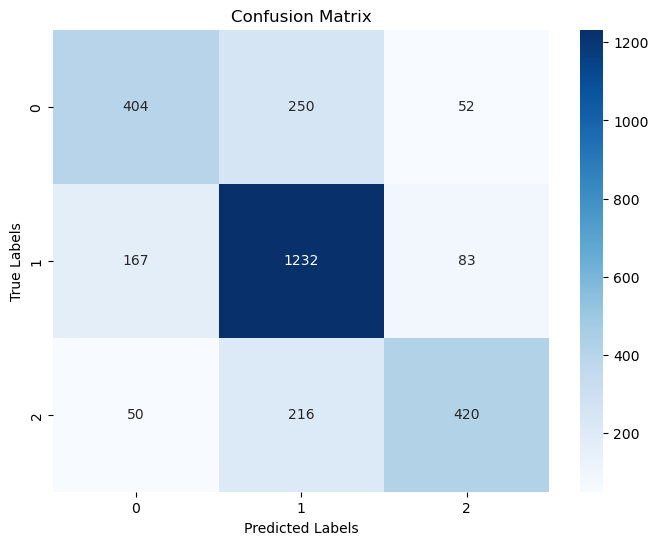

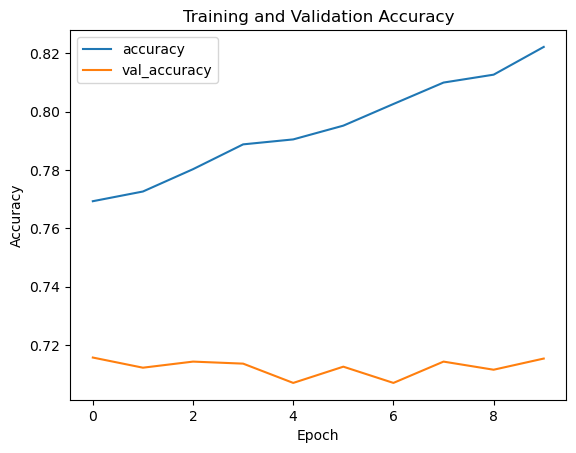

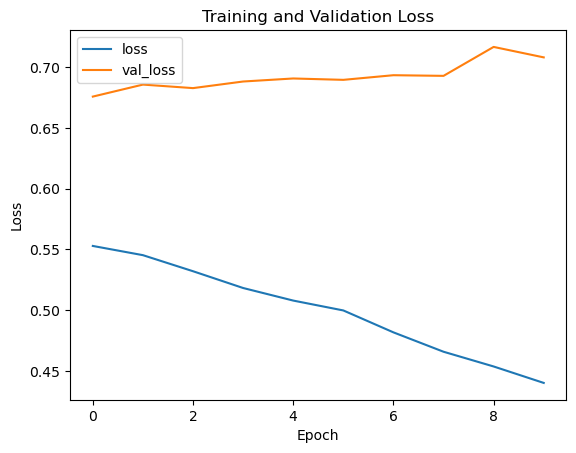

Fold 3
Epoch 1/10
203/203 [==============================] - 2s 8ms/step - loss: 0.4413 - accuracy: 0.8227 - val_loss: 0.7097 - val_accuracy: 0.7081
Epoch 2/10
203/203 [==============================] - 3s 13ms/step - loss: 0.4274 - accuracy: 0.8296 - val_loss: 0.7177 - val_accuracy: 0.7060
Epoch 3/10
203/203 [==============================] - 2s 10ms/step - loss: 0.4227 - accuracy: 0.8302 - val_loss: 0.7146 - val_accuracy: 0.7102
Epoch 4/10
203/203 [==============================] - 2s 9ms/step - loss: 0.4167 - accuracy: 0.8315 - val_loss: 0.7193 - val_accuracy: 0.7143
Epoch 5/10
203/203 [==============================] - 2s 9ms/step - loss: 0.4037 - accuracy: 0.8366 - val_loss: 0.7289 - val_accuracy: 0.7042
Epoch 6/10
203/203 [==============================] - 2s 10ms/step - loss: 0.4042 - accuracy: 0.8380 - val_loss: 0.7361 - val_accuracy: 0.7143
Epoch 7/10
203/203 [==============================] - 3s 12ms/step - loss: 0.3880 - accuracy: 0.8445 - val_loss: 0.7278 - val_accuracy: 0.

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7171189979123174, Validation F1 Score: 0.7134939824358798


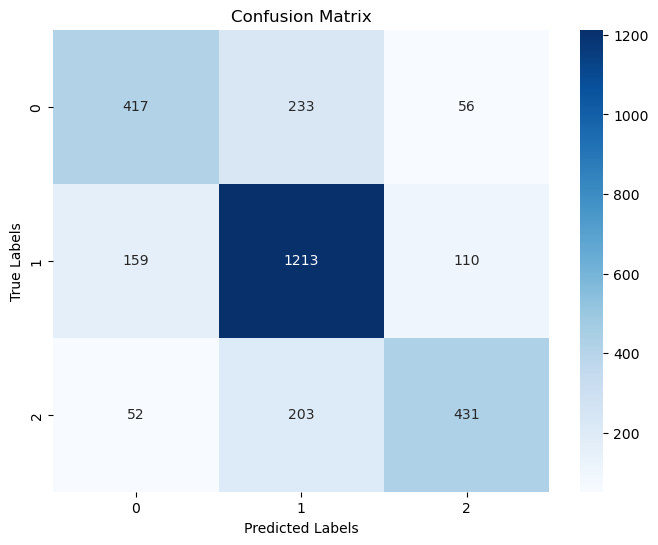

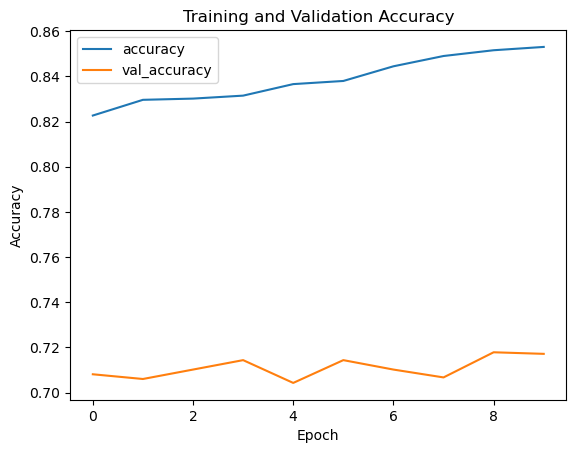

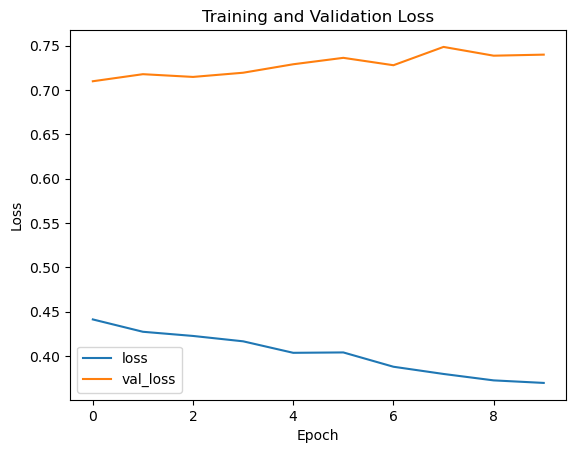

Fold 4
Epoch 1/10
203/203 [==============================] - 2s 8ms/step - loss: 0.3664 - accuracy: 0.8573 - val_loss: 0.7561 - val_accuracy: 0.7136
Epoch 2/10
203/203 [==============================] - 2s 11ms/step - loss: 0.3553 - accuracy: 0.8611 - val_loss: 0.7641 - val_accuracy: 0.7126
Epoch 3/10
203/203 [==============================] - 3s 15ms/step - loss: 0.3462 - accuracy: 0.8637 - val_loss: 0.7648 - val_accuracy: 0.7098
Epoch 4/10
203/203 [==============================] - 2s 12ms/step - loss: 0.3458 - accuracy: 0.8647 - val_loss: 0.7818 - val_accuracy: 0.7178
Epoch 5/10
203/203 [==============================] - 3s 15ms/step - loss: 0.3427 - accuracy: 0.8655 - val_loss: 0.7747 - val_accuracy: 0.7168
Epoch 6/10
203/203 [==============================] - 2s 11ms/step - loss: 0.3393 - accuracy: 0.8654 - val_loss: 0.7744 - val_accuracy: 0.7203
Epoch 7/10
203/203 [==============================] - 2s 7ms/step - loss: 0.3334 - accuracy: 0.8697 - val_loss: 0.7820 - val_accuracy: 0

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7139874739039666, Validation F1 Score: 0.7088880708675767


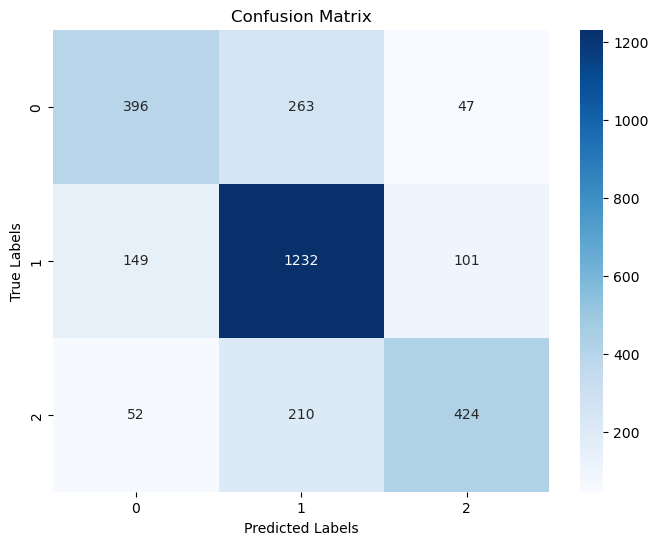

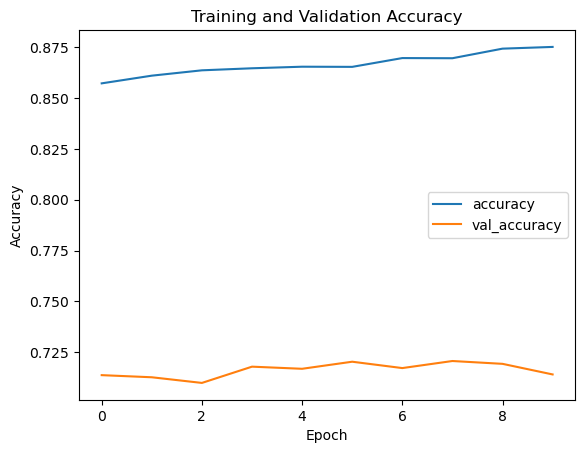

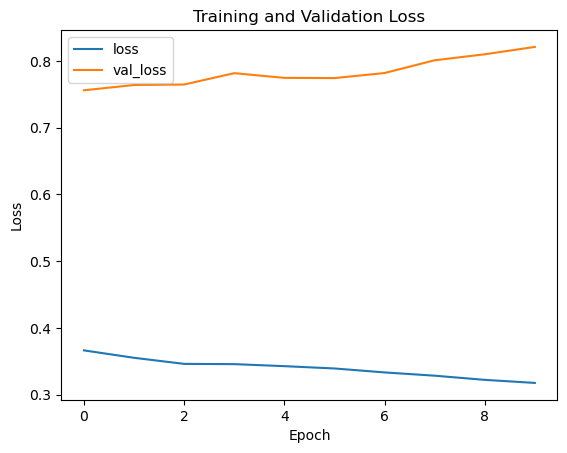

Fold 5
Epoch 1/10
203/203 [==============================] - 2s 8ms/step - loss: 0.3188 - accuracy: 0.8759 - val_loss: 0.8152 - val_accuracy: 0.7168
Epoch 2/10
203/203 [==============================] - 2s 10ms/step - loss: 0.3208 - accuracy: 0.8752 - val_loss: 0.8125 - val_accuracy: 0.7150
Epoch 3/10
203/203 [==============================] - 2s 8ms/step - loss: 0.3060 - accuracy: 0.8772 - val_loss: 0.8319 - val_accuracy: 0.7178
Epoch 4/10
203/203 [==============================] - 2s 8ms/step - loss: 0.3069 - accuracy: 0.8841 - val_loss: 0.8252 - val_accuracy: 0.7088
Epoch 5/10
203/203 [==============================] - 2s 9ms/step - loss: 0.3052 - accuracy: 0.8816 - val_loss: 0.8289 - val_accuracy: 0.7150
Epoch 6/10
203/203 [==============================] - 2s 11ms/step - loss: 0.3017 - accuracy: 0.8822 - val_loss: 0.8439 - val_accuracy: 0.7140
Epoch 7/10
203/203 [==============================] - 2s 12ms/step - loss: 0.2979 - accuracy: 0.8823 - val_loss: 0.8376 - val_accuracy: 0.7

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7167710508002784, Validation F1 Score: 0.7140764140015478


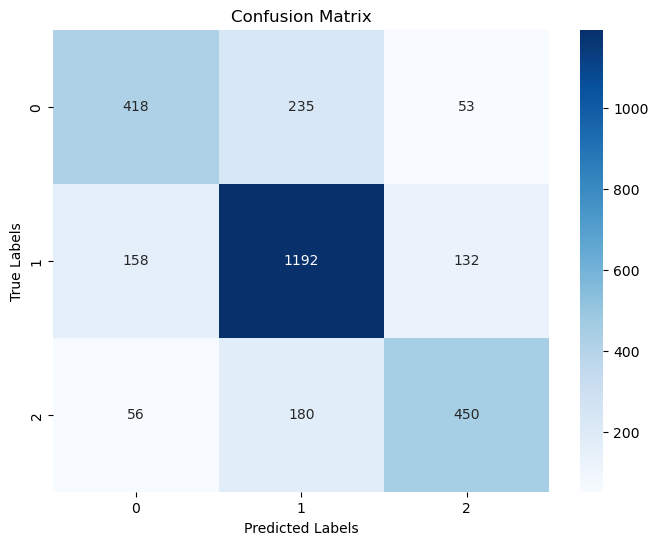

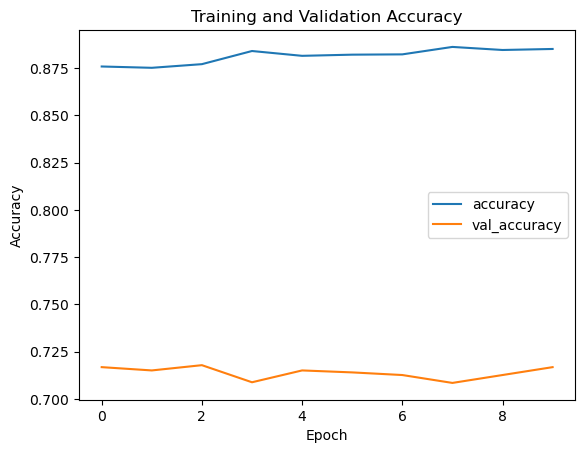

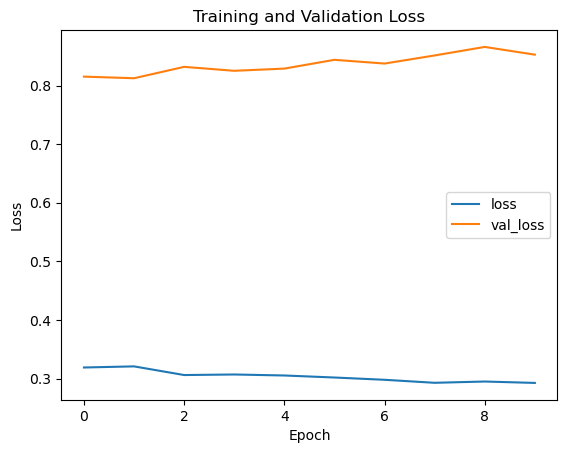

Fold 6
Epoch 1/10
203/203 [==============================] - 2s 8ms/step - loss: 0.2868 - accuracy: 0.8894 - val_loss: 0.8539 - val_accuracy: 0.7157
Epoch 2/10
203/203 [==============================] - 2s 8ms/step - loss: 0.2881 - accuracy: 0.8868 - val_loss: 0.8629 - val_accuracy: 0.7196
Epoch 3/10
203/203 [==============================] - 2s 8ms/step - loss: 0.2844 - accuracy: 0.8877 - val_loss: 0.8790 - val_accuracy: 0.7112
Epoch 4/10
203/203 [==============================] - 2s 8ms/step - loss: 0.2827 - accuracy: 0.8876 - val_loss: 0.8633 - val_accuracy: 0.7091
Epoch 5/10
203/203 [==============================] - 3s 15ms/step - loss: 0.2756 - accuracy: 0.8923 - val_loss: 0.8772 - val_accuracy: 0.7088
Epoch 6/10
203/203 [==============================] - 3s 15ms/step - loss: 0.2734 - accuracy: 0.8951 - val_loss: 0.8898 - val_accuracy: 0.7102
Epoch 7/10
203/203 [==============================] - 3s 14ms/step - loss: 0.2686 - accuracy: 0.8990 - val_loss: 0.8897 - val_accuracy: 0.7

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7112038970076549, Validation F1 Score: 0.7083660774550395


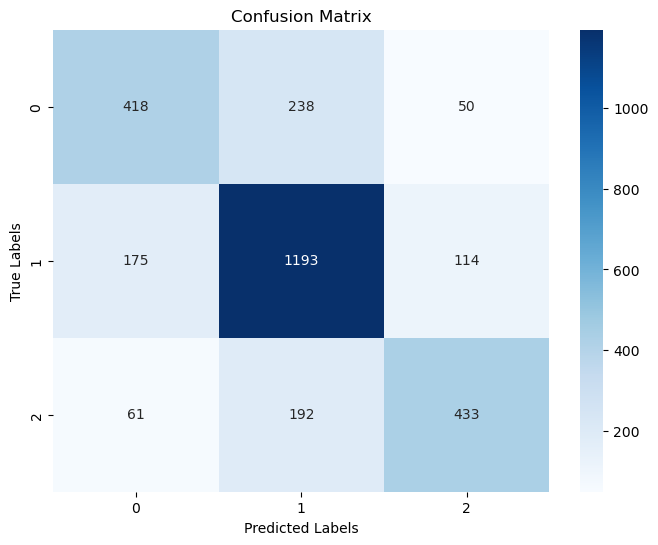

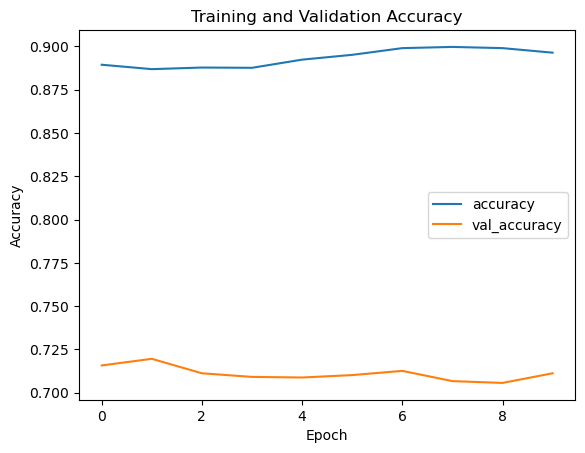

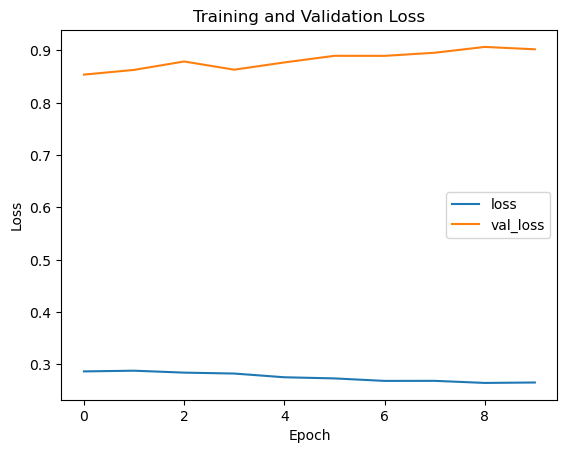

Fold 7
Epoch 1/10
203/203 [==============================] - 2s 12ms/step - loss: 0.2696 - accuracy: 0.8954 - val_loss: 0.9170 - val_accuracy: 0.7105
Epoch 2/10
203/203 [==============================] - 1s 7ms/step - loss: 0.2626 - accuracy: 0.8980 - val_loss: 0.9344 - val_accuracy: 0.7046
Epoch 3/10
203/203 [==============================] - 2s 8ms/step - loss: 0.2661 - accuracy: 0.8949 - val_loss: 0.9239 - val_accuracy: 0.7140
Epoch 4/10
203/203 [==============================] - 2s 8ms/step - loss: 0.2503 - accuracy: 0.9044 - val_loss: 0.9593 - val_accuracy: 0.7105
Epoch 5/10
203/203 [==============================] - 2s 9ms/step - loss: 0.2466 - accuracy: 0.9064 - val_loss: 0.9299 - val_accuracy: 0.7154
Epoch 6/10
203/203 [==============================] - 2s 9ms/step - loss: 0.2565 - accuracy: 0.9016 - val_loss: 0.9622 - val_accuracy: 0.7039
Epoch 7/10
203/203 [==============================] - 2s 10ms/step - loss: 0.2448 - accuracy: 0.9053 - val_loss: 0.9613 - val_accuracy: 0.70

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7108559498956158, Validation F1 Score: 0.7071024647495581


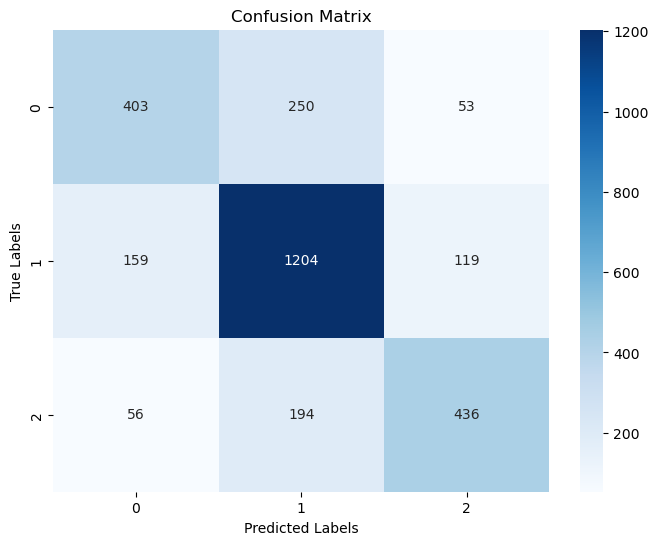

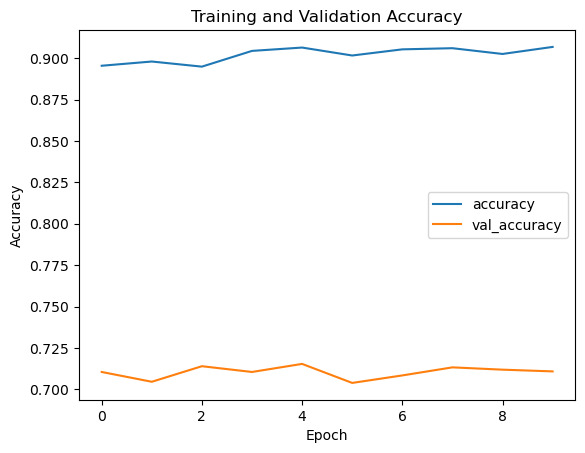

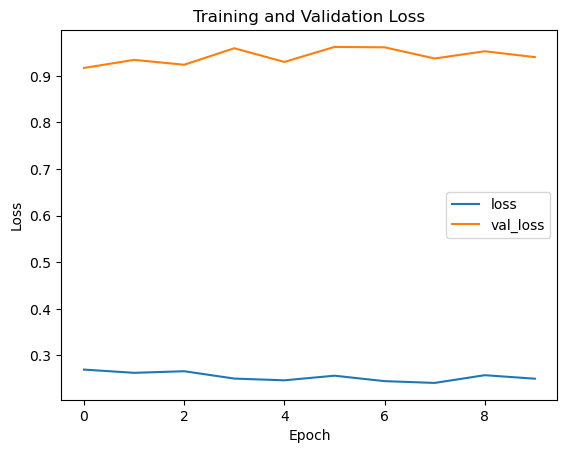

Fold 8
Epoch 1/10
203/203 [==============================] - 2s 9ms/step - loss: 0.2487 - accuracy: 0.9038 - val_loss: 0.9493 - val_accuracy: 0.7129
Epoch 2/10
203/203 [==============================] - 2s 9ms/step - loss: 0.2481 - accuracy: 0.9070 - val_loss: 0.9568 - val_accuracy: 0.7154
Epoch 3/10
203/203 [==============================] - 2s 9ms/step - loss: 0.2448 - accuracy: 0.9051 - val_loss: 0.9622 - val_accuracy: 0.7140
Epoch 4/10
203/203 [==============================] - 2s 9ms/step - loss: 0.2367 - accuracy: 0.9061 - val_loss: 0.9868 - val_accuracy: 0.7178
Epoch 5/10
203/203 [==============================] - 2s 9ms/step - loss: 0.2405 - accuracy: 0.9105 - val_loss: 0.9651 - val_accuracy: 0.7112
Epoch 6/10
203/203 [==============================] - 2s 8ms/step - loss: 0.2328 - accuracy: 0.9116 - val_loss: 0.9990 - val_accuracy: 0.7102
Epoch 7/10
203/203 [==============================] - 2s 9ms/step - loss: 0.2374 - accuracy: 0.9101 - val_loss: 0.9813 - val_accuracy: 0.7091

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 3ms/step
Validation Accuracy: 0.7049408489909533, Validation F1 Score: 0.6993709240370688


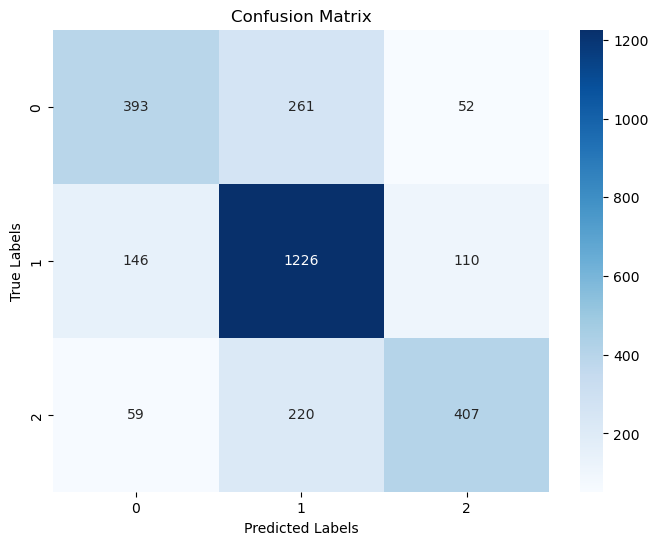

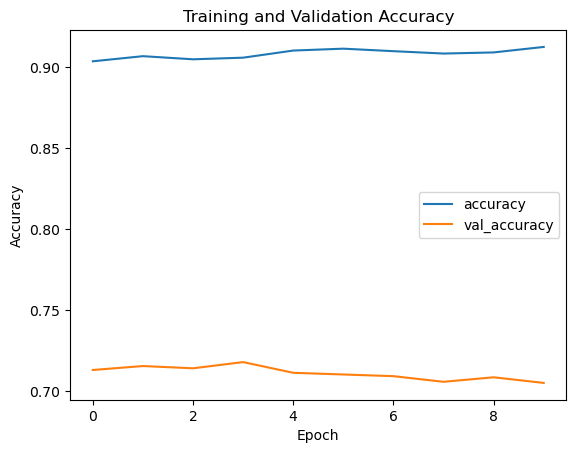

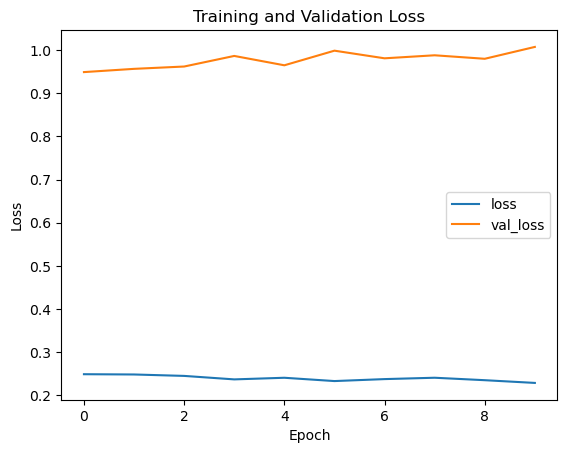

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7124217118997913
Mean F1 Score: 0.7079952177835322
Number of Epochs: 20, Test Size: 0.15, Validation Size: 0.15
Fold 1
Epoch 1/20
230/230 [==============================] - 3s 8ms/step - loss: 1.4572 - accuracy: 0.5319 - val_loss: 0.7756 - val_accuracy: 0.6626
Epoch 2/20
230/230 [==============================] - 2s 7ms/step - loss: 0.8878 - accuracy: 0.6203 - val_loss: 0.7194 - val_accuracy: 0.6936
Epoch 3/20
230/230 [==============================] - 2s 7ms/step - loss: 0.7688 - accuracy: 0.6599 - val_loss: 0.6978 - val_accuracy: 0.7109
Epoch 4/20
230/230 [==============================] - 2s 7ms/step - loss: 0.7162 - accuracy: 0.6867 - val_loss: 0.6766 - val_accuracy: 0.7288
Epoch 5/20
230/230 [==============================] - 2s 8ms/step - loss: 0.6830 - accuracy: 0.7084 - val_loss: 0.6623 - val_accuracy: 0.7222
Epoch 6/20
230/230 [==============================] - 2s 10ms/step - loss: 0.6523 - accuracy: 0.7198 - val_loss: 0.6632 - val_accuracy: 0.7213
Epoch 7/20


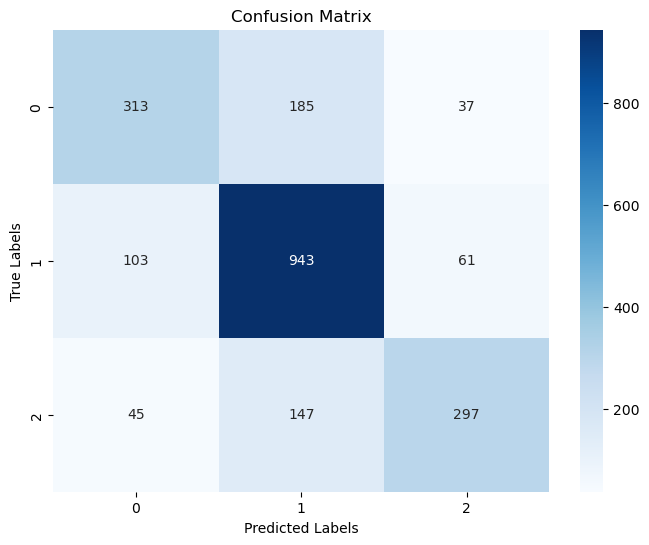

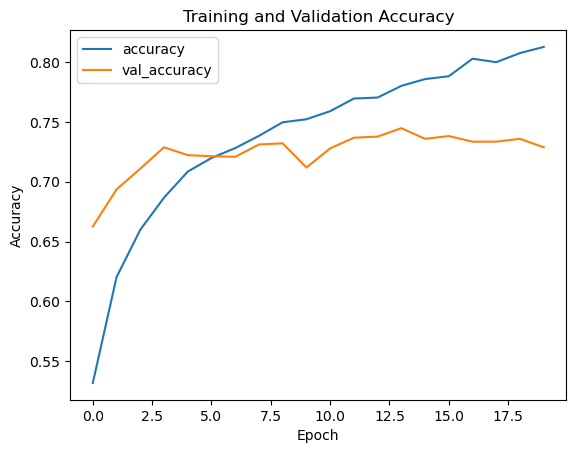

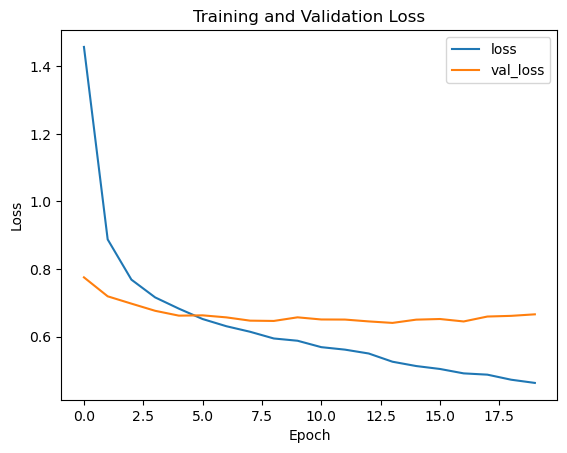

Fold 2
Epoch 1/20
230/230 [==============================] - 3s 12ms/step - loss: 0.4538 - accuracy: 0.8155 - val_loss: 0.6615 - val_accuracy: 0.7358
Epoch 2/20
230/230 [==============================] - 2s 7ms/step - loss: 0.4541 - accuracy: 0.8216 - val_loss: 0.6759 - val_accuracy: 0.7311
Epoch 3/20
230/230 [==============================] - 2s 8ms/step - loss: 0.4470 - accuracy: 0.8194 - val_loss: 0.6678 - val_accuracy: 0.7339
Epoch 4/20
230/230 [==============================] - 3s 14ms/step - loss: 0.4373 - accuracy: 0.8249 - val_loss: 0.6689 - val_accuracy: 0.7349
Epoch 5/20
230/230 [==============================] - 2s 8ms/step - loss: 0.4282 - accuracy: 0.8267 - val_loss: 0.6803 - val_accuracy: 0.7377
Epoch 6/20
230/230 [==============================] - 2s 9ms/step - loss: 0.4202 - accuracy: 0.8304 - val_loss: 0.6852 - val_accuracy: 0.7321
Epoch 7/20
230/230 [==============================] - 3s 14ms/step - loss: 0.4116 - accuracy: 0.8370 - val_loss: 0.6887 - val_accuracy: 0.7

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7367433129985922, Validation F1 Score: 0.7346416797559903


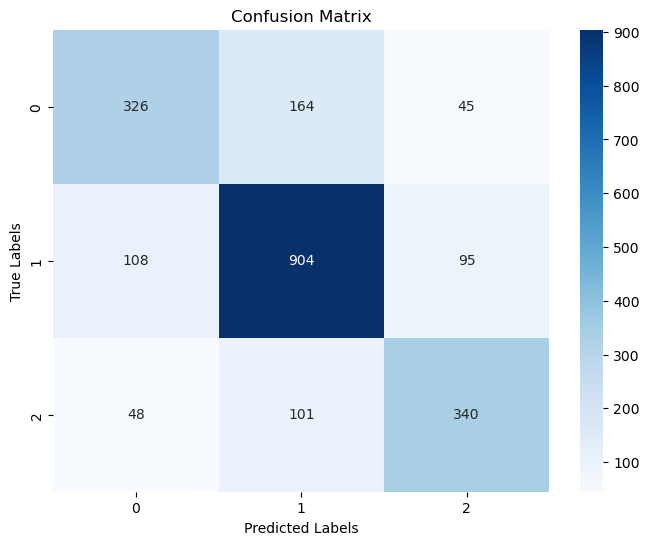

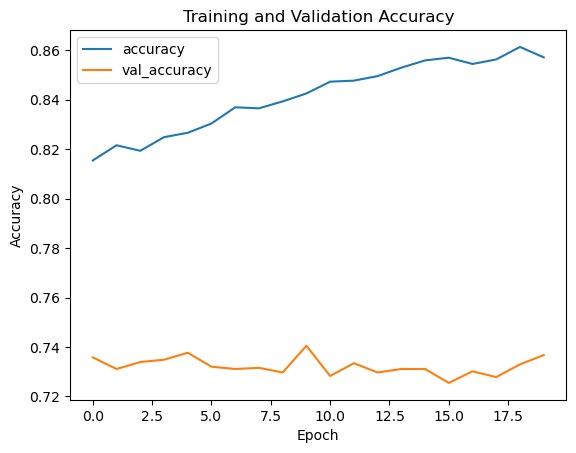

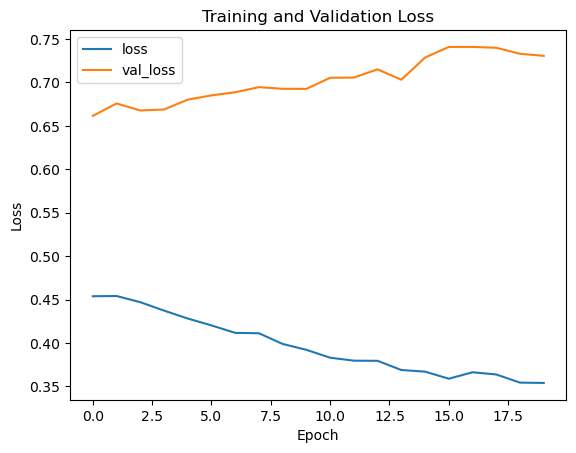

Fold 3
Epoch 1/20
230/230 [==============================] - 3s 12ms/step - loss: 0.3385 - accuracy: 0.8690 - val_loss: 0.7249 - val_accuracy: 0.7358
Epoch 2/20
230/230 [==============================] - 2s 9ms/step - loss: 0.3325 - accuracy: 0.8686 - val_loss: 0.7325 - val_accuracy: 0.7386
Epoch 3/20
230/230 [==============================] - 3s 13ms/step - loss: 0.3318 - accuracy: 0.8673 - val_loss: 0.7418 - val_accuracy: 0.7278
Epoch 4/20
230/230 [==============================] - 3s 13ms/step - loss: 0.3346 - accuracy: 0.8649 - val_loss: 0.7383 - val_accuracy: 0.7358
Epoch 5/20
230/230 [==============================] - 3s 14ms/step - loss: 0.3248 - accuracy: 0.8709 - val_loss: 0.7631 - val_accuracy: 0.7339
Epoch 6/20
230/230 [==============================] - 2s 10ms/step - loss: 0.3185 - accuracy: 0.8775 - val_loss: 0.7591 - val_accuracy: 0.7325
Epoch 7/20
230/230 [==============================] - 2s 7ms/step - loss: 0.3235 - accuracy: 0.8752 - val_loss: 0.7597 - val_accuracy: 0

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7311121539183482, Validation F1 Score: 0.7247745618993507


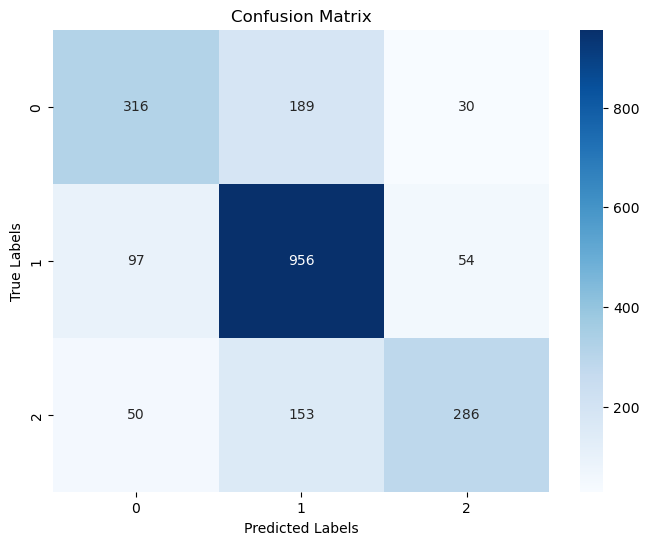

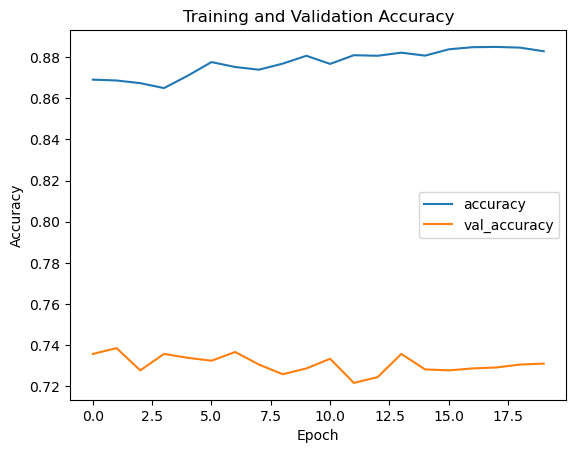

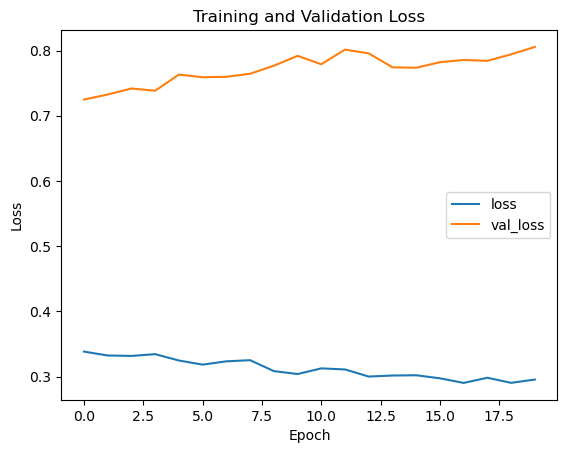

Fold 4
Epoch 1/20
230/230 [==============================] - 3s 13ms/step - loss: 0.2925 - accuracy: 0.8863 - val_loss: 0.8105 - val_accuracy: 0.7213
Epoch 2/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2874 - accuracy: 0.8863 - val_loss: 0.8359 - val_accuracy: 0.7255
Epoch 3/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2819 - accuracy: 0.8902 - val_loss: 0.8026 - val_accuracy: 0.7344
Epoch 4/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2732 - accuracy: 0.8924 - val_loss: 0.8142 - val_accuracy: 0.7349
Epoch 5/20
230/230 [==============================] - 3s 13ms/step - loss: 0.2867 - accuracy: 0.8891 - val_loss: 0.7964 - val_accuracy: 0.7288
Epoch 6/20
230/230 [==============================] - 3s 13ms/step - loss: 0.2919 - accuracy: 0.8866 - val_loss: 0.8162 - val_accuracy: 0.7372
Epoch 7/20
230/230 [==============================] - 3s 12ms/step - loss: 0.2733 - accuracy: 0.8958 - val_loss: 0.8198 - val_accuracy: 0.

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7292351008916002, Validation F1 Score: 0.725377490892877


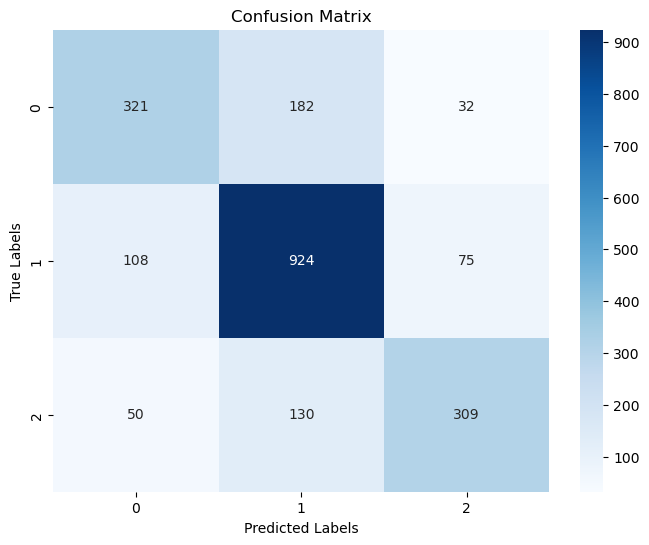

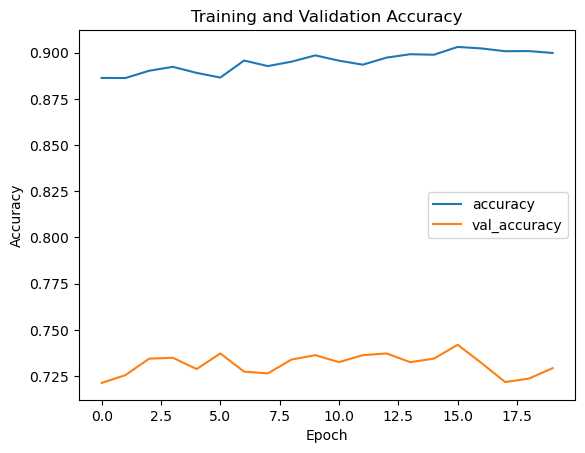

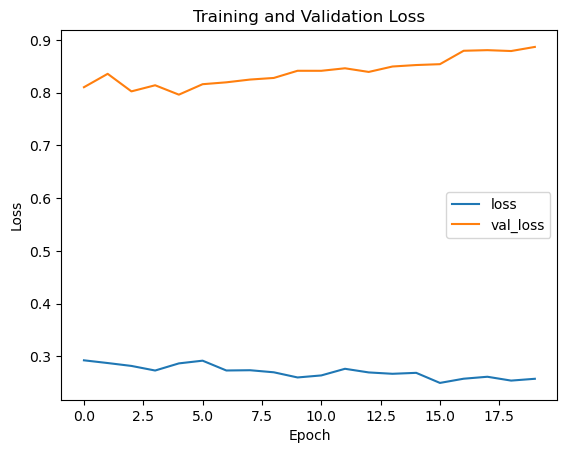

Fold 5
Epoch 1/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2647 - accuracy: 0.8989 - val_loss: 0.8771 - val_accuracy: 0.7198
Epoch 2/20
230/230 [==============================] - 2s 8ms/step - loss: 0.2473 - accuracy: 0.9035 - val_loss: 0.8949 - val_accuracy: 0.7236
Epoch 3/20
230/230 [==============================] - 3s 13ms/step - loss: 0.2492 - accuracy: 0.9050 - val_loss: 0.8884 - val_accuracy: 0.7292
Epoch 4/20
230/230 [==============================] - 3s 13ms/step - loss: 0.2444 - accuracy: 0.9035 - val_loss: 0.8873 - val_accuracy: 0.7260
Epoch 5/20
230/230 [==============================] - 3s 14ms/step - loss: 0.2405 - accuracy: 0.9081 - val_loss: 0.9073 - val_accuracy: 0.7302
Epoch 6/20
230/230 [==============================] - 3s 11ms/step - loss: 0.2327 - accuracy: 0.9095 - val_loss: 0.8944 - val_accuracy: 0.7306
Epoch 7/20
230/230 [==============================] - 3s 11ms/step - loss: 0.2388 - accuracy: 0.9080 - val_loss: 0.9210 - val_accuracy: 0

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7273580478648521, Validation F1 Score: 0.7217076172824395


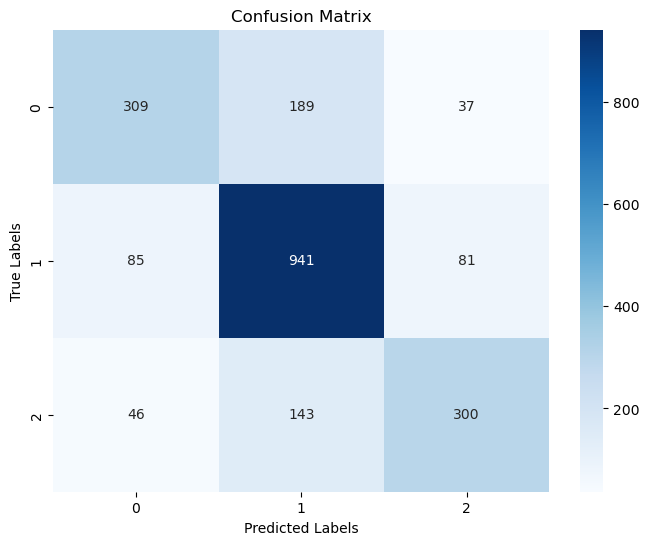

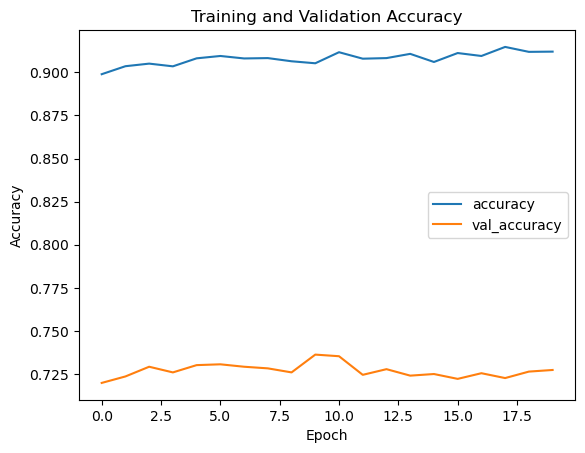

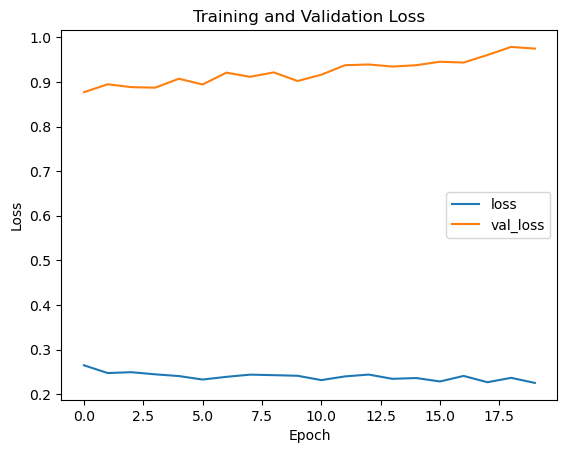

Fold 6
Epoch 1/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2193 - accuracy: 0.9174 - val_loss: 0.9438 - val_accuracy: 0.7180
Epoch 2/20
230/230 [==============================] - 2s 8ms/step - loss: 0.2310 - accuracy: 0.9129 - val_loss: 0.9533 - val_accuracy: 0.7198
Epoch 3/20
230/230 [==============================] - 3s 13ms/step - loss: 0.2248 - accuracy: 0.9170 - val_loss: 0.9476 - val_accuracy: 0.7316
Epoch 4/20
230/230 [==============================] - 3s 14ms/step - loss: 0.2302 - accuracy: 0.9113 - val_loss: 0.9508 - val_accuracy: 0.7321
Epoch 5/20
230/230 [==============================] - 3s 14ms/step - loss: 0.2270 - accuracy: 0.9124 - val_loss: 0.9530 - val_accuracy: 0.7213
Epoch 6/20
230/230 [==============================] - 3s 14ms/step - loss: 0.2216 - accuracy: 0.9149 - val_loss: 0.9641 - val_accuracy: 0.7236
Epoch 7/20
230/230 [==============================] - 3s 12ms/step - loss: 0.2261 - accuracy: 0.9137 - val_loss: 0.9769 - val_accuracy: 0

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7268887846081652, Validation F1 Score: 0.7247614356755515


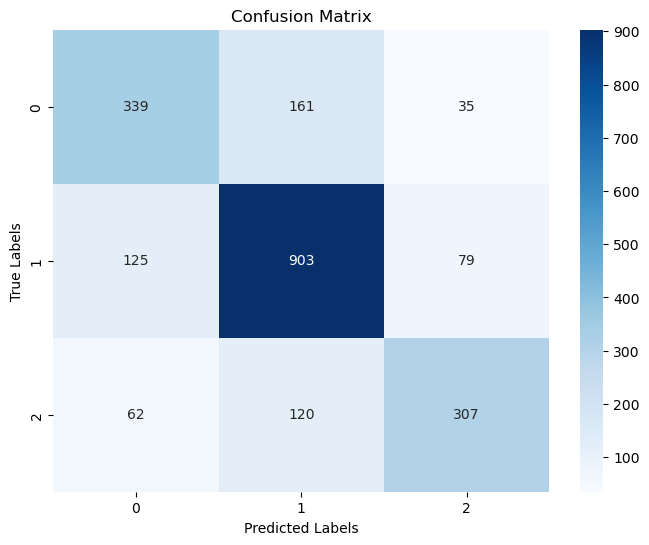

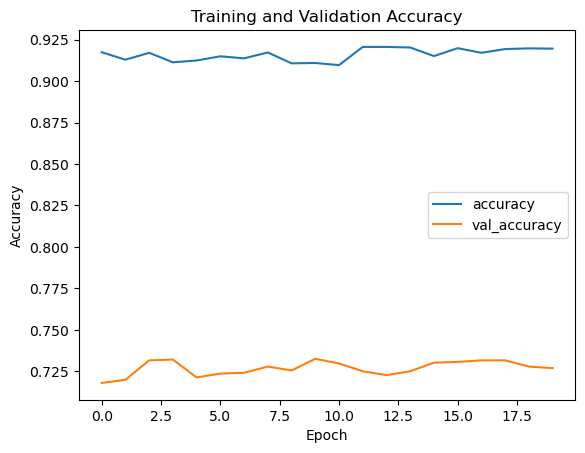

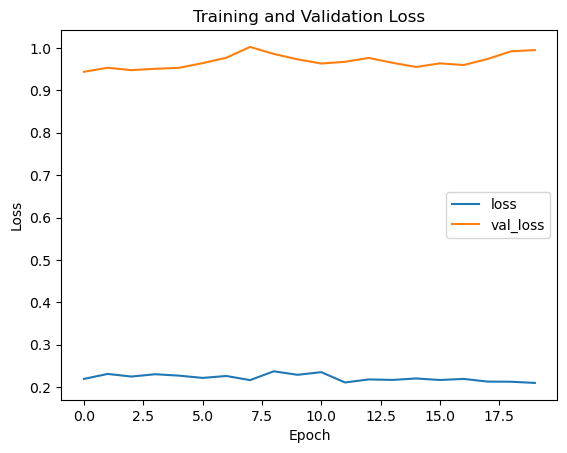

Fold 7
Epoch 1/20
230/230 [==============================] - 2s 10ms/step - loss: 0.2065 - accuracy: 0.9206 - val_loss: 0.9852 - val_accuracy: 0.7316
Epoch 2/20
230/230 [==============================] - 2s 8ms/step - loss: 0.2080 - accuracy: 0.9208 - val_loss: 0.9954 - val_accuracy: 0.7297
Epoch 3/20
230/230 [==============================] - 2s 8ms/step - loss: 0.2191 - accuracy: 0.9189 - val_loss: 1.0078 - val_accuracy: 0.7283
Epoch 4/20
230/230 [==============================] - 2s 8ms/step - loss: 0.2188 - accuracy: 0.9161 - val_loss: 1.0006 - val_accuracy: 0.7278
Epoch 5/20
230/230 [==============================] - 2s 10ms/step - loss: 0.2100 - accuracy: 0.9196 - val_loss: 0.9868 - val_accuracy: 0.7339
Epoch 6/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2062 - accuracy: 0.9224 - val_loss: 1.0191 - val_accuracy: 0.7217
Epoch 7/20
230/230 [==============================] - 2s 8ms/step - loss: 0.2094 - accuracy: 0.9211 - val_loss: 1.0020 - val_accuracy: 0.72

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7212576255279212, Validation F1 Score: 0.7154257968208593


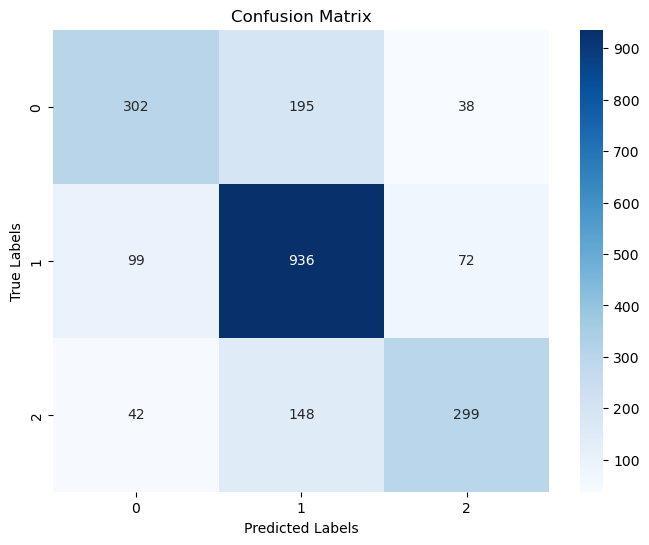

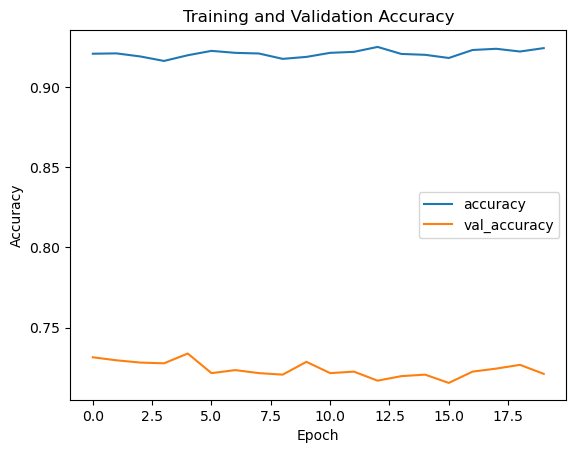

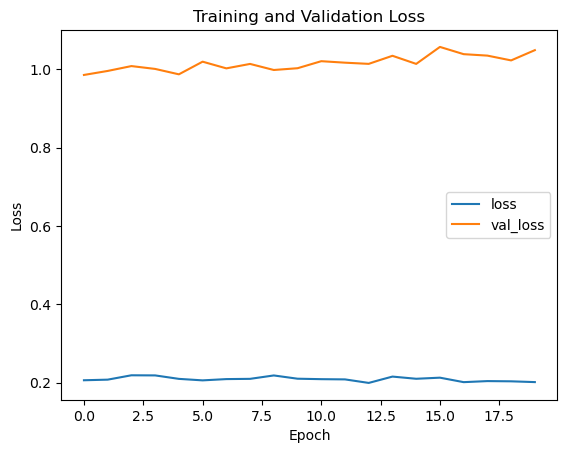

Fold 8
Epoch 1/20
230/230 [==============================] - 2s 10ms/step - loss: 0.2077 - accuracy: 0.9226 - val_loss: 1.0221 - val_accuracy: 0.7260
Epoch 2/20
230/230 [==============================] - 2s 9ms/step - loss: 0.1966 - accuracy: 0.9264 - val_loss: 1.0293 - val_accuracy: 0.7269
Epoch 3/20
230/230 [==============================] - 3s 13ms/step - loss: 0.1978 - accuracy: 0.9258 - val_loss: 1.0276 - val_accuracy: 0.7236
Epoch 4/20
230/230 [==============================] - 3s 12ms/step - loss: 0.1878 - accuracy: 0.9294 - val_loss: 1.0355 - val_accuracy: 0.7302
Epoch 5/20
230/230 [==============================] - 2s 11ms/step - loss: 0.1966 - accuracy: 0.9252 - val_loss: 1.0599 - val_accuracy: 0.7278
Epoch 6/20
230/230 [==============================] - 2s 9ms/step - loss: 0.1967 - accuracy: 0.9280 - val_loss: 1.0666 - val_accuracy: 0.7227
Epoch 7/20
230/230 [==============================] - 2s 10ms/step - loss: 0.1918 - accuracy: 0.9285 - val_loss: 1.0600 - val_accuracy: 0

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7175035194744251, Validation F1 Score: 0.7143326063374373


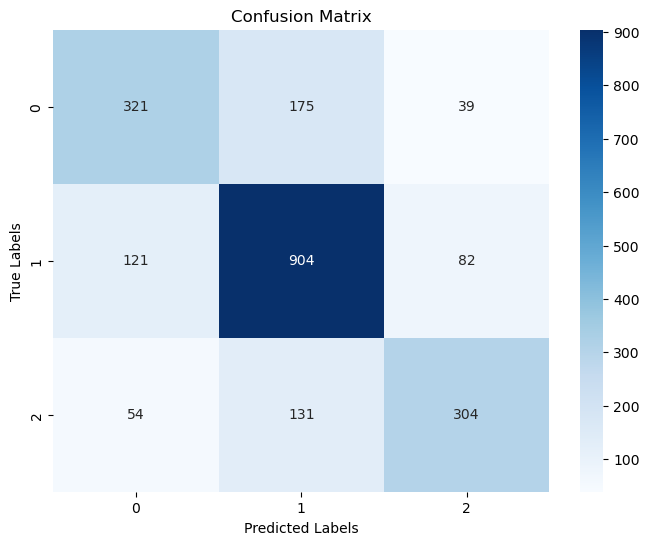

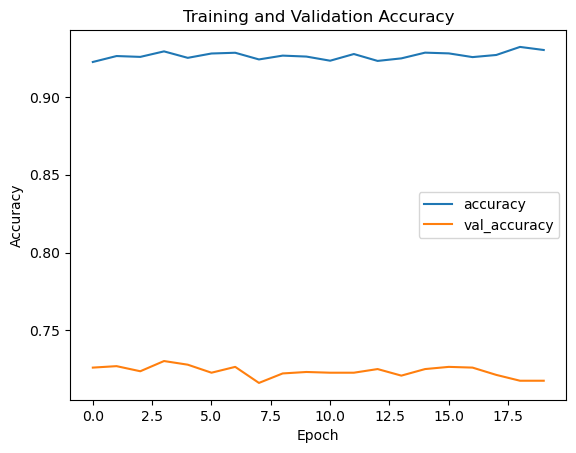

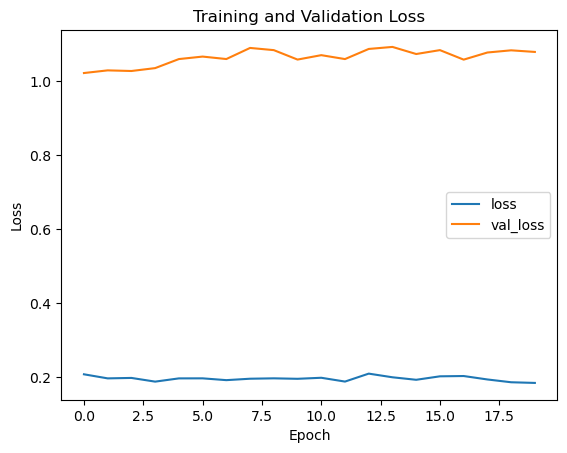

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7273580478648521
Mean F1 Score: 0.7230387027784653
Number of Epochs: 20, Test Size: 0.15, Validation Size: 0.2
Fold 1
Epoch 1/20
230/230 [==============================] - 3s 9ms/step - loss: 1.4527 - accuracy: 0.5304 - val_loss: 0.7694 - val_accuracy: 0.6766
Epoch 2/20
230/230 [==============================] - 3s 12ms/step - loss: 0.9021 - accuracy: 0.6143 - val_loss: 0.7150 - val_accuracy: 0.7004
Epoch 3/20
230/230 [==============================] - 3s 11ms/step - loss: 0.7686 - accuracy: 0.6629 - val_loss: 0.7017 - val_accuracy: 0.7074
Epoch 4/20
230/230 [==============================] - 3s 11ms/step - loss: 0.7122 - accuracy: 0.6863 - val_loss: 0.6762 - val_accuracy: 0.7231
Epoch 5/20
230/230 [==============================] - 3s 11ms/step - loss: 0.6775 - accuracy: 0.7091 - val_loss: 0.6658 - val_accuracy: 0.7302
Epoch 6/20
230/230 [==============================] - 3s 14ms/step - loss: 0.6535 - accuracy: 0.7200 - val_loss: 0.6745 - val_accuracy: 0.7115
Epoch 7/

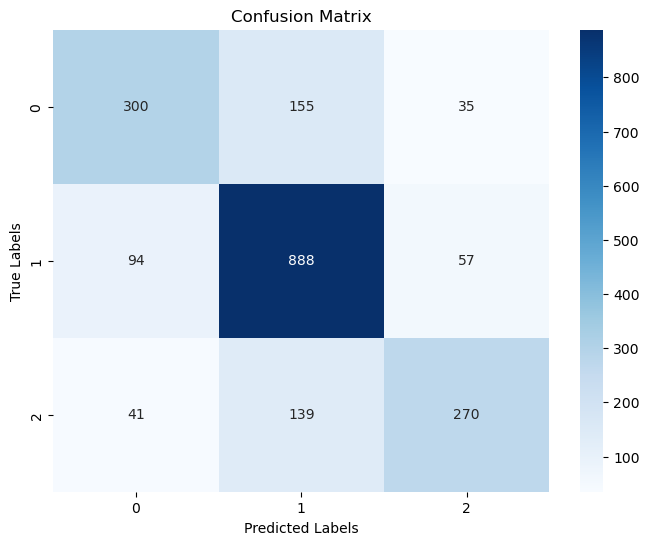

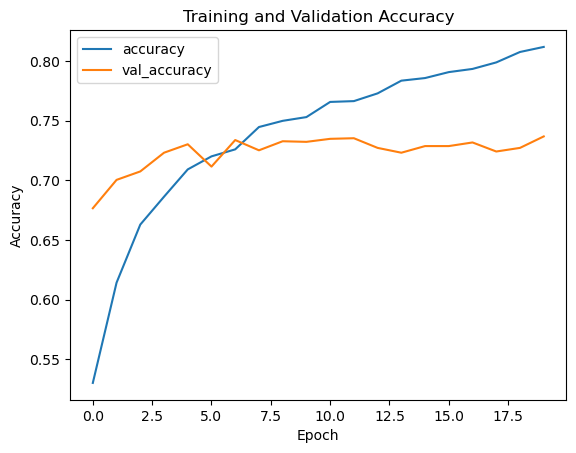

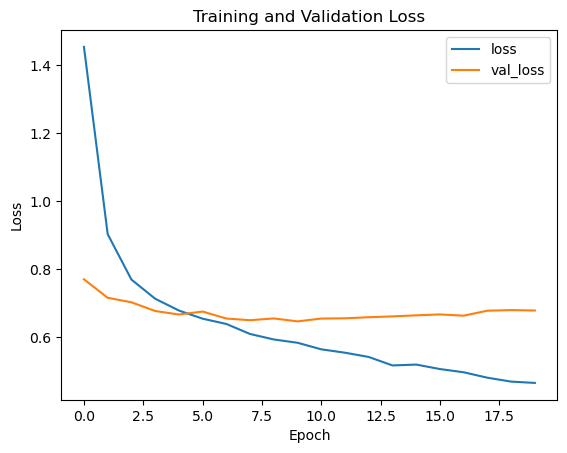

Fold 2
Epoch 1/20
230/230 [==============================] - 2s 8ms/step - loss: 0.4488 - accuracy: 0.8173 - val_loss: 0.6858 - val_accuracy: 0.7362
Epoch 2/20
230/230 [==============================] - 2s 7ms/step - loss: 0.4486 - accuracy: 0.8197 - val_loss: 0.6787 - val_accuracy: 0.7312
Epoch 3/20
230/230 [==============================] - 2s 7ms/step - loss: 0.4388 - accuracy: 0.8231 - val_loss: 0.6869 - val_accuracy: 0.7347
Epoch 4/20
230/230 [==============================] - 2s 7ms/step - loss: 0.4358 - accuracy: 0.8241 - val_loss: 0.6868 - val_accuracy: 0.7372
Epoch 5/20
230/230 [==============================] - 2s 7ms/step - loss: 0.4128 - accuracy: 0.8364 - val_loss: 0.6991 - val_accuracy: 0.7307
Epoch 6/20
230/230 [==============================] - 2s 7ms/step - loss: 0.4194 - accuracy: 0.8316 - val_loss: 0.7028 - val_accuracy: 0.7307
Epoch 7/20
230/230 [==============================] - 2s 8ms/step - loss: 0.4082 - accuracy: 0.8383 - val_loss: 0.7001 - val_accuracy: 0.7287

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7261243052046488, Validation F1 Score: 0.7236513293163424


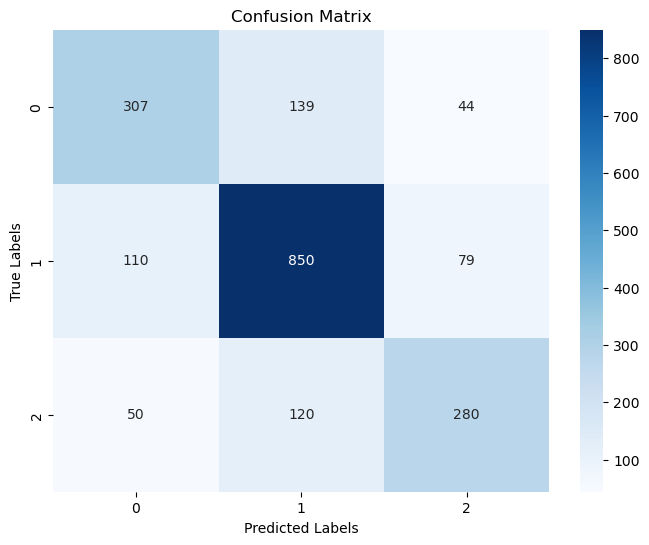

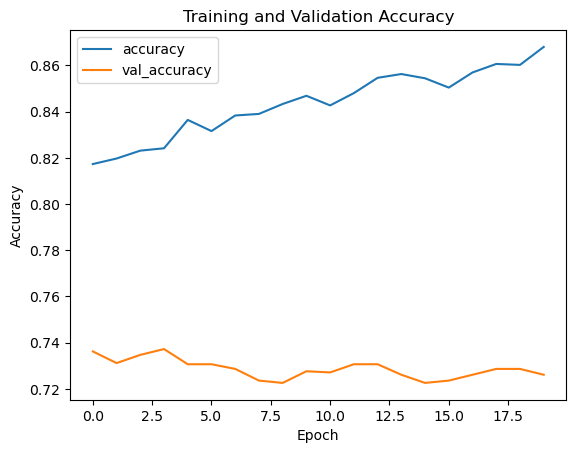

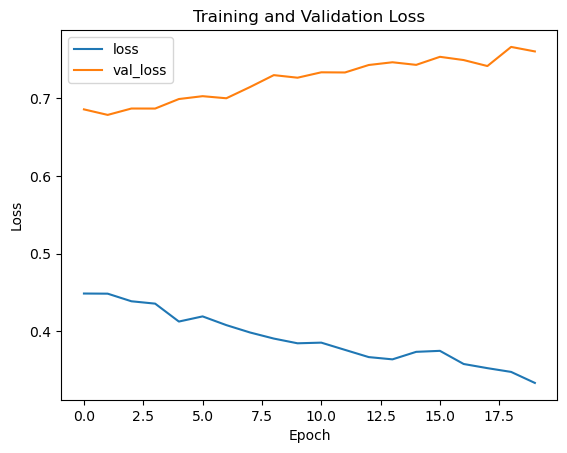

Fold 3
Epoch 1/20
230/230 [==============================] - 2s 11ms/step - loss: 0.3332 - accuracy: 0.8667 - val_loss: 0.7811 - val_accuracy: 0.7196
Epoch 2/20
230/230 [==============================] - 2s 7ms/step - loss: 0.3344 - accuracy: 0.8670 - val_loss: 0.7588 - val_accuracy: 0.7281
Epoch 3/20
230/230 [==============================] - 3s 13ms/step - loss: 0.3506 - accuracy: 0.8612 - val_loss: 0.7863 - val_accuracy: 0.7271
Epoch 4/20
230/230 [==============================] - 3s 14ms/step - loss: 0.3361 - accuracy: 0.8675 - val_loss: 0.7729 - val_accuracy: 0.7261
Epoch 5/20
230/230 [==============================] - 2s 9ms/step - loss: 0.3184 - accuracy: 0.8765 - val_loss: 0.7799 - val_accuracy: 0.7165
Epoch 6/20
230/230 [==============================] - 3s 11ms/step - loss: 0.3274 - accuracy: 0.8690 - val_loss: 0.8142 - val_accuracy: 0.7145
Epoch 7/20
230/230 [==============================] - 3s 13ms/step - loss: 0.3249 - accuracy: 0.8721 - val_loss: 0.8083 - val_accuracy: 0

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7225871652349671, Validation F1 Score: 0.7222278501941121


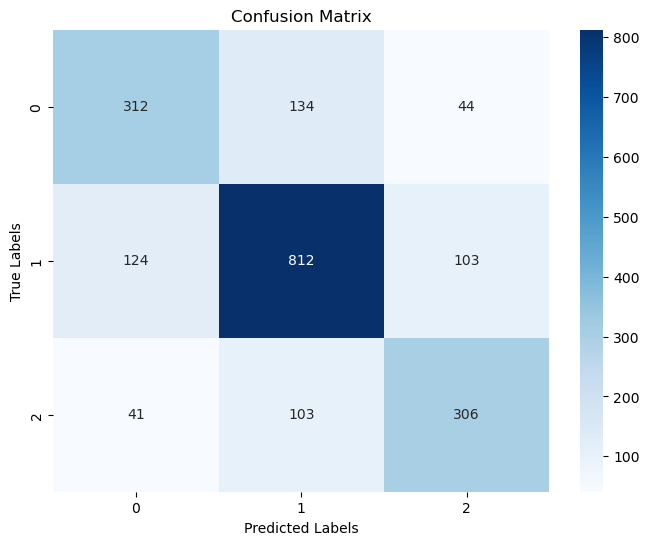

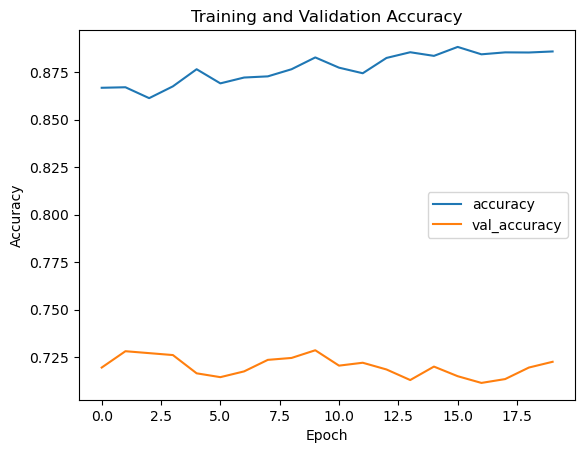

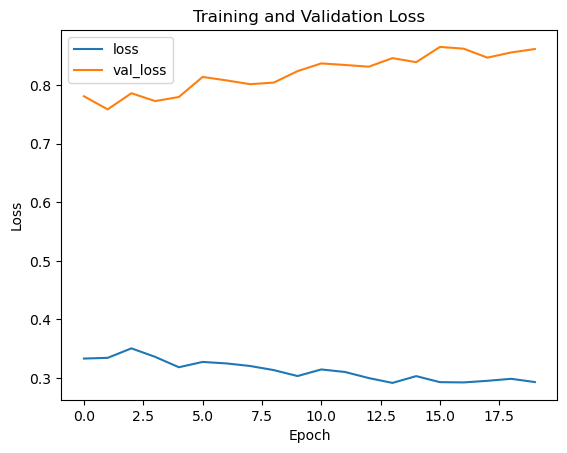

Fold 4
Epoch 1/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2824 - accuracy: 0.8909 - val_loss: 0.8691 - val_accuracy: 0.7180
Epoch 2/20
230/230 [==============================] - 3s 14ms/step - loss: 0.2918 - accuracy: 0.8883 - val_loss: 0.8738 - val_accuracy: 0.7125
Epoch 3/20
230/230 [==============================] - 2s 8ms/step - loss: 0.2855 - accuracy: 0.8901 - val_loss: 0.8871 - val_accuracy: 0.7120
Epoch 4/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2789 - accuracy: 0.8890 - val_loss: 0.8749 - val_accuracy: 0.7150
Epoch 5/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2851 - accuracy: 0.8889 - val_loss: 0.8781 - val_accuracy: 0.7221
Epoch 6/20
230/230 [==============================] - 2s 8ms/step - loss: 0.2668 - accuracy: 0.8954 - val_loss: 0.8772 - val_accuracy: 0.7165
Epoch 7/20
230/230 [==============================] - 2s 8ms/step - loss: 0.2757 - accuracy: 0.8930 - val_loss: 0.8923 - val_accuracy: 0.719

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7134916624557858, Validation F1 Score: 0.7127149256854031


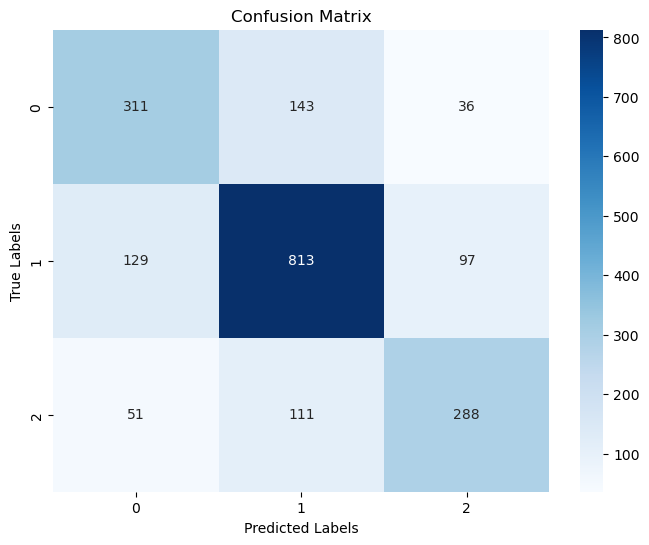

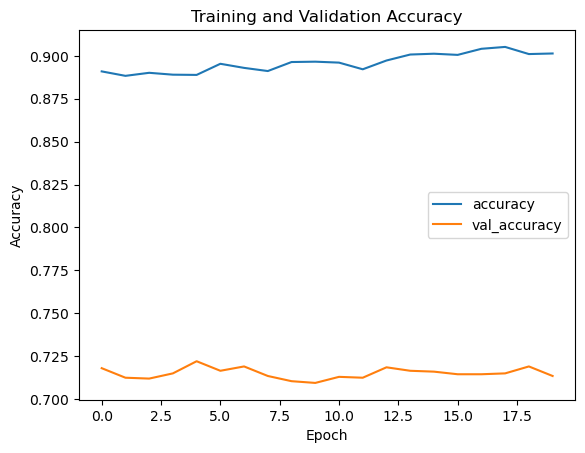

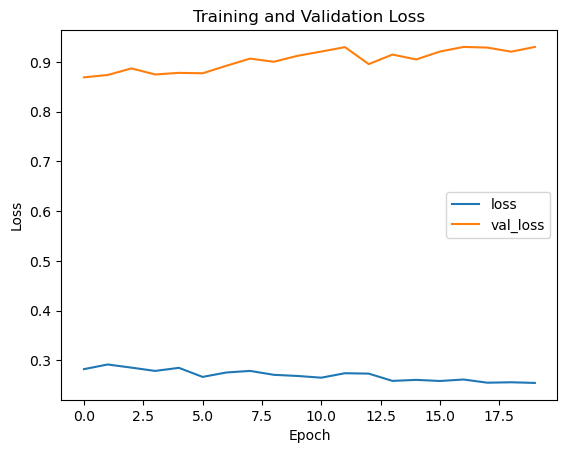

Fold 5
Epoch 1/20
230/230 [==============================] - 2s 8ms/step - loss: 0.2421 - accuracy: 0.9072 - val_loss: 0.9278 - val_accuracy: 0.7196
Epoch 2/20
230/230 [==============================] - 2s 10ms/step - loss: 0.2572 - accuracy: 0.9012 - val_loss: 0.9345 - val_accuracy: 0.7150
Epoch 3/20
230/230 [==============================] - 3s 13ms/step - loss: 0.2549 - accuracy: 0.9038 - val_loss: 0.9323 - val_accuracy: 0.7165
Epoch 4/20
230/230 [==============================] - 3s 15ms/step - loss: 0.2427 - accuracy: 0.9082 - val_loss: 0.9643 - val_accuracy: 0.7120
Epoch 5/20
230/230 [==============================] - 3s 14ms/step - loss: 0.2460 - accuracy: 0.9055 - val_loss: 0.9522 - val_accuracy: 0.7160
Epoch 6/20
230/230 [==============================] - 3s 14ms/step - loss: 0.2468 - accuracy: 0.9048 - val_loss: 0.9301 - val_accuracy: 0.7221
Epoch 7/20
230/230 [==============================] - 2s 9ms/step - loss: 0.2380 - accuracy: 0.9065 - val_loss: 0.9360 - val_accuracy: 0

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7170288024254674, Validation F1 Score: 0.7139914691313013


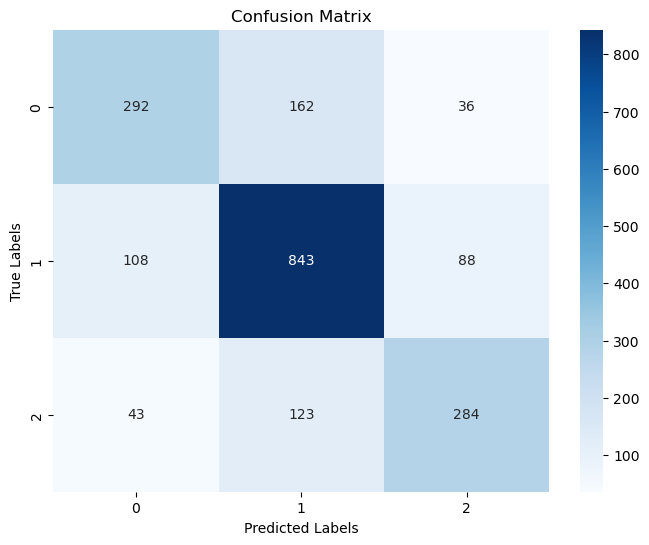

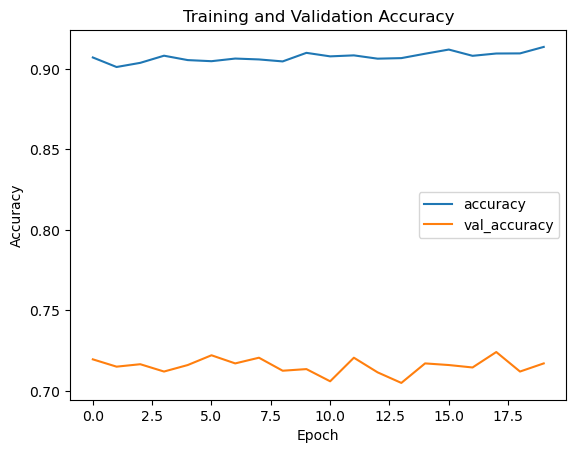

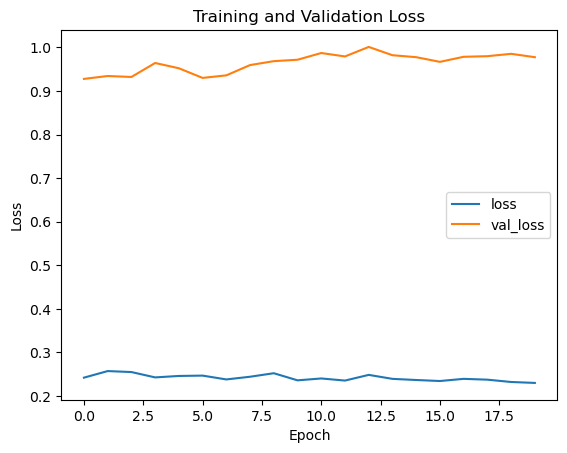

Fold 6
Epoch 1/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2366 - accuracy: 0.9101 - val_loss: 0.9873 - val_accuracy: 0.7206
Epoch 2/20
230/230 [==============================] - 2s 10ms/step - loss: 0.2284 - accuracy: 0.9153 - val_loss: 0.9900 - val_accuracy: 0.7201
Epoch 3/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2228 - accuracy: 0.9142 - val_loss: 1.0025 - val_accuracy: 0.7120
Epoch 4/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2223 - accuracy: 0.9175 - val_loss: 1.0065 - val_accuracy: 0.7175
Epoch 5/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2208 - accuracy: 0.9158 - val_loss: 1.0077 - val_accuracy: 0.7236
Epoch 6/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2213 - accuracy: 0.9143 - val_loss: 1.0069 - val_accuracy: 0.7201
Epoch 7/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2289 - accuracy: 0.9120 - val_loss: 1.0120 - val_accuracy: 0.706

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.717534108135422, Validation F1 Score: 0.7142199732974607


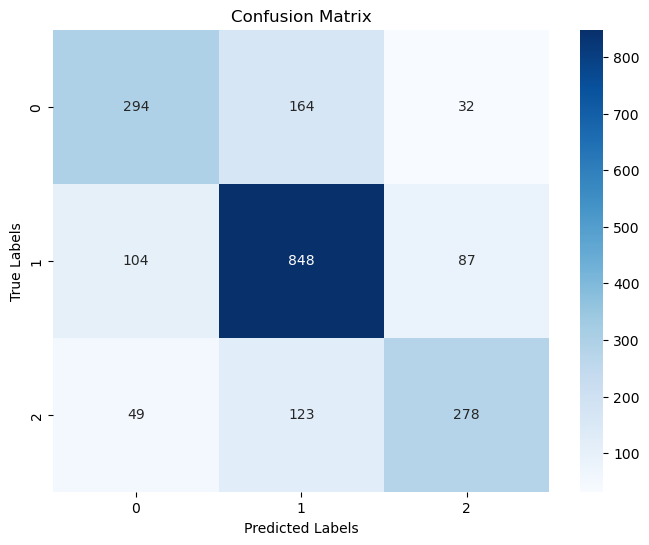

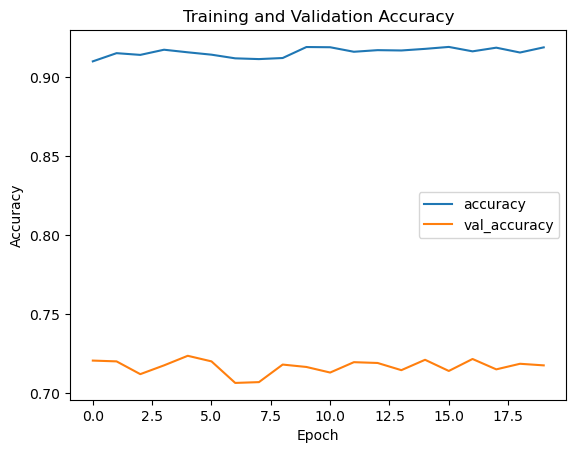

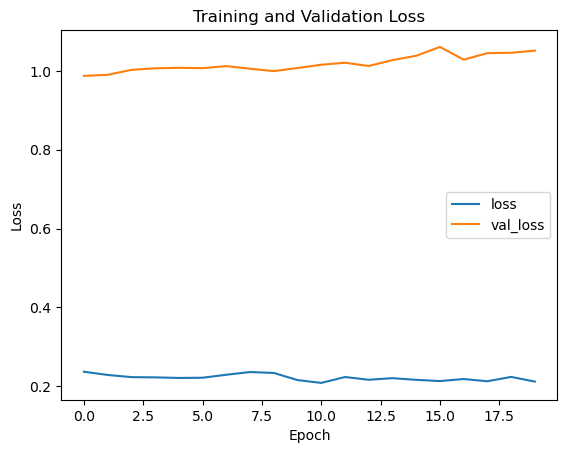

Fold 7
Epoch 1/20
230/230 [==============================] - 3s 12ms/step - loss: 0.2052 - accuracy: 0.9209 - val_loss: 1.0436 - val_accuracy: 0.7155
Epoch 2/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2145 - accuracy: 0.9177 - val_loss: 1.0617 - val_accuracy: 0.7155
Epoch 3/20
230/230 [==============================] - 2s 8ms/step - loss: 0.2116 - accuracy: 0.9221 - val_loss: 1.0308 - val_accuracy: 0.7180
Epoch 4/20
230/230 [==============================] - 2s 11ms/step - loss: 0.2129 - accuracy: 0.9196 - val_loss: 1.0250 - val_accuracy: 0.7251
Epoch 5/20
230/230 [==============================] - 2s 8ms/step - loss: 0.2110 - accuracy: 0.9207 - val_loss: 1.0327 - val_accuracy: 0.7211
Epoch 6/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2247 - accuracy: 0.9154 - val_loss: 1.0320 - val_accuracy: 0.7185
Epoch 7/20
230/230 [==============================] - 2s 10ms/step - loss: 0.2291 - accuracy: 0.9142 - val_loss: 1.0544 - val_accuracy: 0.7

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7155128852956039, Validation F1 Score: 0.7121603413828538


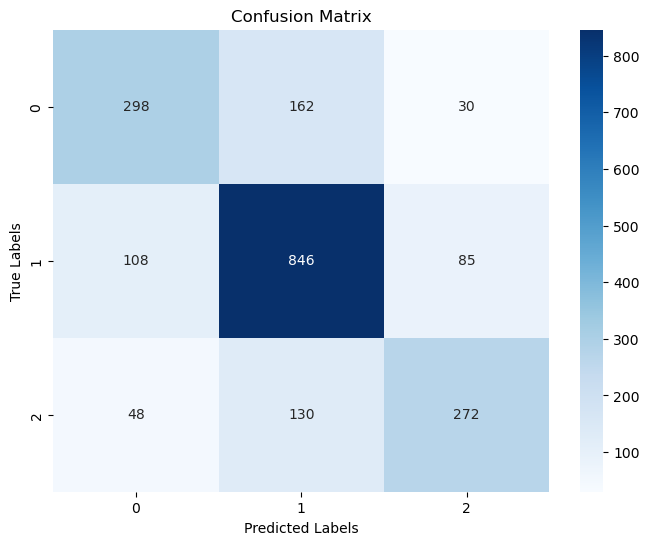

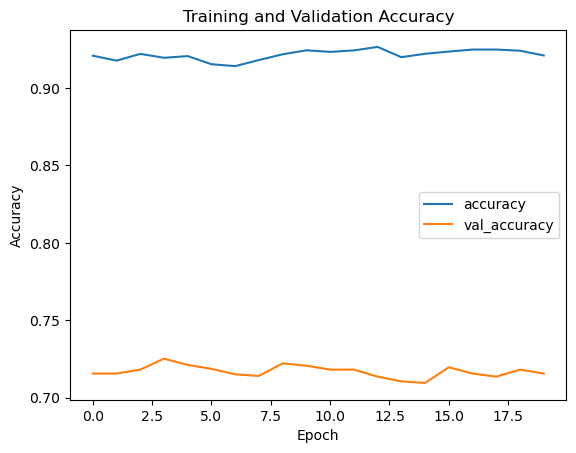

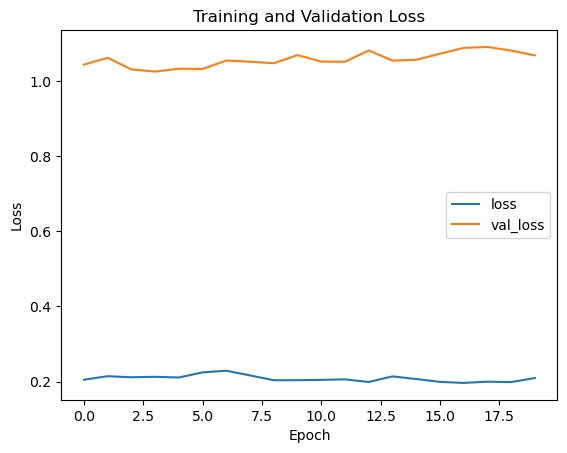

Fold 8
Epoch 1/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2006 - accuracy: 0.9237 - val_loss: 1.0754 - val_accuracy: 0.7074
Epoch 2/20
230/230 [==============================] - 3s 13ms/step - loss: 0.1958 - accuracy: 0.9269 - val_loss: 1.0812 - val_accuracy: 0.7175
Epoch 3/20
230/230 [==============================] - 3s 14ms/step - loss: 0.1968 - accuracy: 0.9292 - val_loss: 1.0883 - val_accuracy: 0.7069
Epoch 4/20
230/230 [==============================] - 2s 8ms/step - loss: 0.1942 - accuracy: 0.9271 - val_loss: 1.0959 - val_accuracy: 0.7196
Epoch 5/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2061 - accuracy: 0.9228 - val_loss: 1.0775 - val_accuracy: 0.7206
Epoch 6/20
230/230 [==============================] - 2s 7ms/step - loss: 0.1951 - accuracy: 0.9263 - val_loss: 1.0785 - val_accuracy: 0.7170
Epoch 7/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2067 - accuracy: 0.9206 - val_loss: 1.0886 - val_accuracy: 0.71

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7180394138453765, Validation F1 Score: 0.7147813210176909


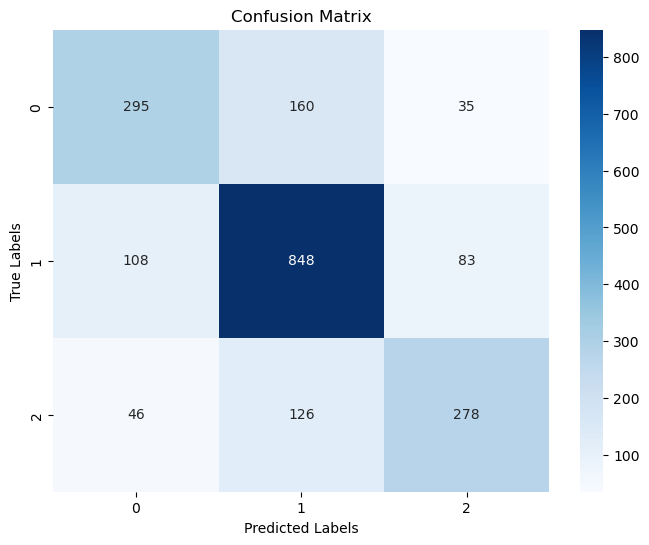

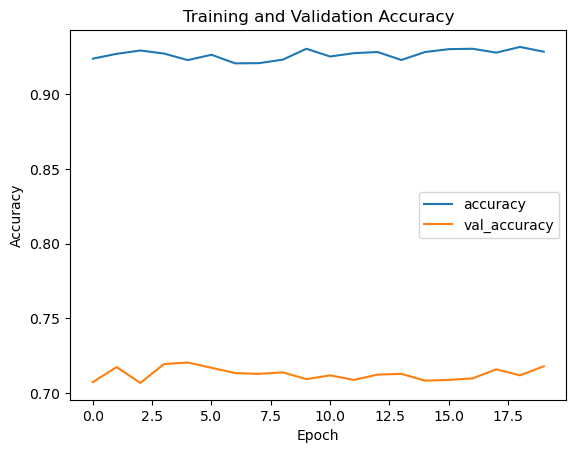

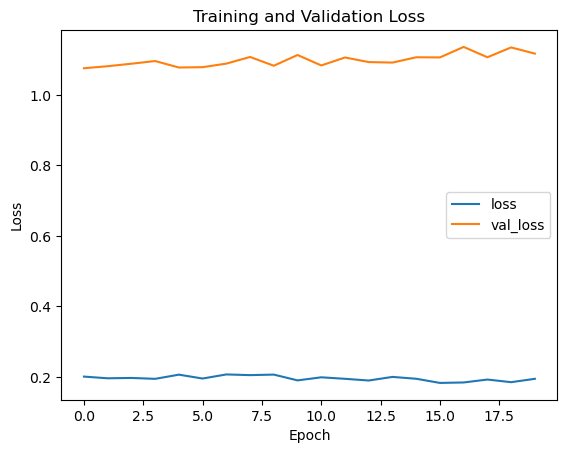

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7208817584638707
Mean F1 Score: 0.7181739770329882
Number of Epochs: 20, Test Size: 0.15, Validation Size: 0.25
Fold 1
Epoch 1/20
230/230 [==============================] - 3s 9ms/step - loss: 1.4907 - accuracy: 0.5266 - val_loss: 0.7772 - val_accuracy: 0.6780
Epoch 2/20
230/230 [==============================] - 2s 7ms/step - loss: 0.9102 - accuracy: 0.6178 - val_loss: 0.7225 - val_accuracy: 0.6933
Epoch 3/20
230/230 [==============================] - 3s 11ms/step - loss: 0.7780 - accuracy: 0.6582 - val_loss: 0.6987 - val_accuracy: 0.7114
Epoch 4/20
230/230 [==============================] - 2s 11ms/step - loss: 0.7249 - accuracy: 0.6792 - val_loss: 0.6979 - val_accuracy: 0.7076
Epoch 5/20
230/230 [==============================] - 3s 13ms/step - loss: 0.6842 - accuracy: 0.7007 - val_loss: 0.6751 - val_accuracy: 0.7141
Epoch 6/20
230/230 [==============================] - 2s 10ms/step - loss: 0.6527 - accuracy: 0.7153 - val_loss: 0.6539 - val_accuracy: 0.7273
Epoch 7/

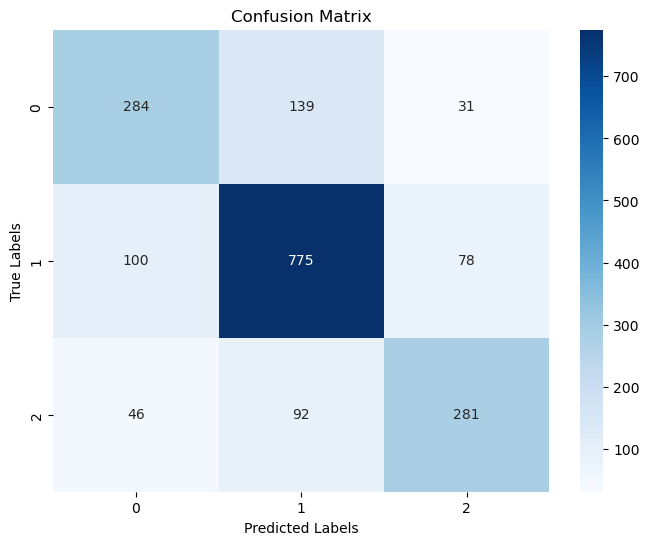

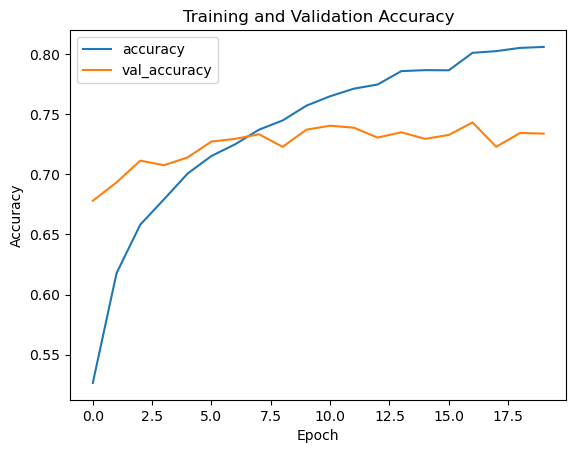

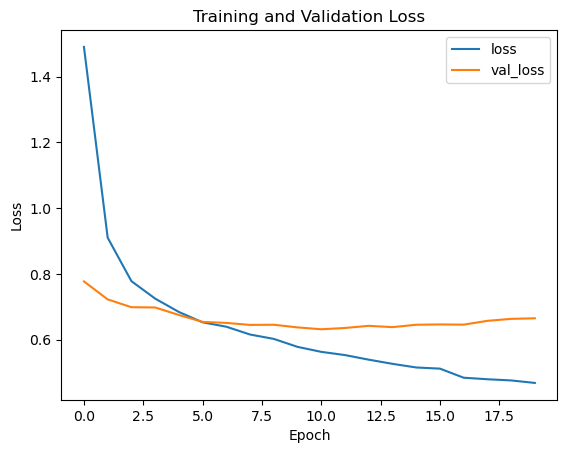

Fold 2
Epoch 1/20
230/230 [==============================] - 2s 7ms/step - loss: 0.4685 - accuracy: 0.8082 - val_loss: 0.6639 - val_accuracy: 0.7349
Epoch 2/20
230/230 [==============================] - 2s 10ms/step - loss: 0.4557 - accuracy: 0.8147 - val_loss: 0.6694 - val_accuracy: 0.7317
Epoch 3/20
230/230 [==============================] - 3s 11ms/step - loss: 0.4390 - accuracy: 0.8202 - val_loss: 0.6757 - val_accuracy: 0.7333
Epoch 4/20
230/230 [==============================] - 2s 7ms/step - loss: 0.4298 - accuracy: 0.8278 - val_loss: 0.6765 - val_accuracy: 0.7393
Epoch 5/20
230/230 [==============================] - 2s 7ms/step - loss: 0.4151 - accuracy: 0.8327 - val_loss: 0.6658 - val_accuracy: 0.7366
Epoch 6/20
230/230 [==============================] - 3s 13ms/step - loss: 0.4143 - accuracy: 0.8350 - val_loss: 0.6892 - val_accuracy: 0.7311
Epoch 7/20
230/230 [==============================] - 3s 14ms/step - loss: 0.4136 - accuracy: 0.8365 - val_loss: 0.6825 - val_accuracy: 0.

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7316538882803943, Validation F1 Score: 0.73196803722931


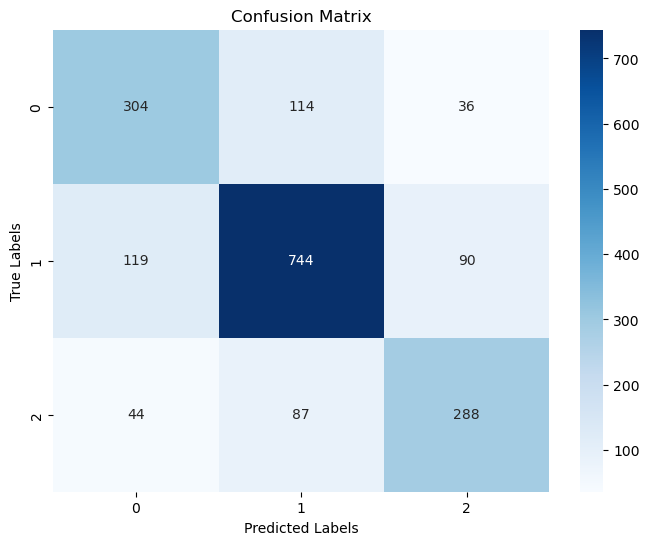

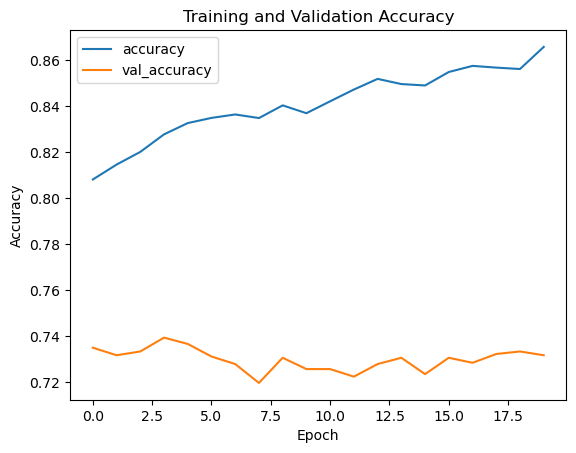

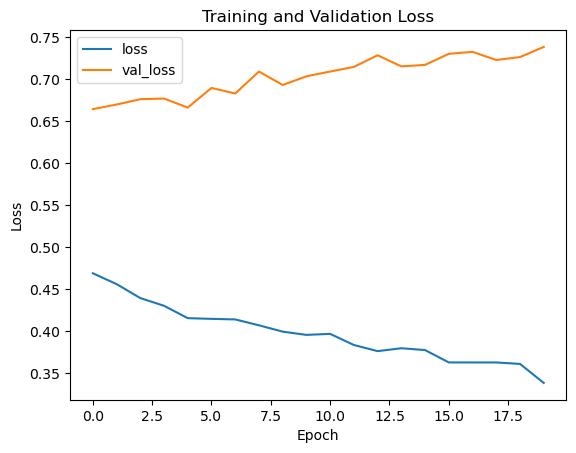

Fold 3
Epoch 1/20
230/230 [==============================] - 2s 7ms/step - loss: 0.3385 - accuracy: 0.8660 - val_loss: 0.7351 - val_accuracy: 0.7245
Epoch 2/20
230/230 [==============================] - 3s 14ms/step - loss: 0.3357 - accuracy: 0.8660 - val_loss: 0.7461 - val_accuracy: 0.7267
Epoch 3/20
230/230 [==============================] - 2s 8ms/step - loss: 0.3413 - accuracy: 0.8649 - val_loss: 0.7541 - val_accuracy: 0.7267
Epoch 4/20
230/230 [==============================] - 3s 11ms/step - loss: 0.3334 - accuracy: 0.8689 - val_loss: 0.7479 - val_accuracy: 0.7256
Epoch 5/20
230/230 [==============================] - 2s 10ms/step - loss: 0.3300 - accuracy: 0.8696 - val_loss: 0.7504 - val_accuracy: 0.7202
Epoch 6/20
230/230 [==============================] - 3s 12ms/step - loss: 0.3220 - accuracy: 0.8707 - val_loss: 0.7823 - val_accuracy: 0.7207
Epoch 7/20
230/230 [==============================] - 3s 14ms/step - loss: 0.3229 - accuracy: 0.8722 - val_loss: 0.7764 - val_accuracy: 0

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7185104052573932, Validation F1 Score: 0.7157382800791043


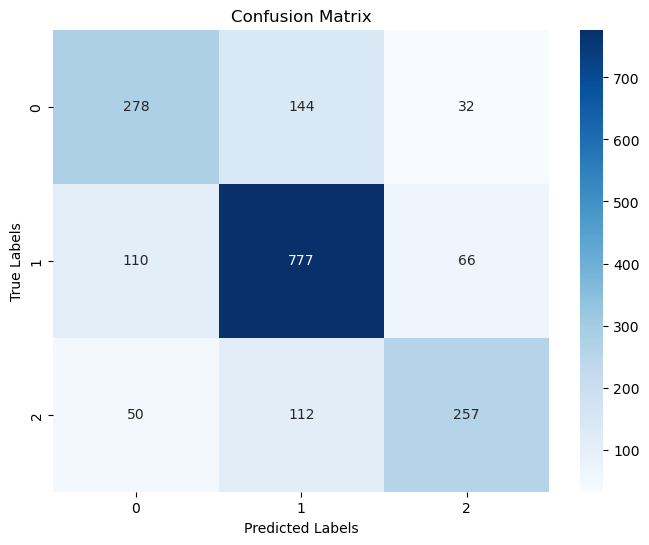

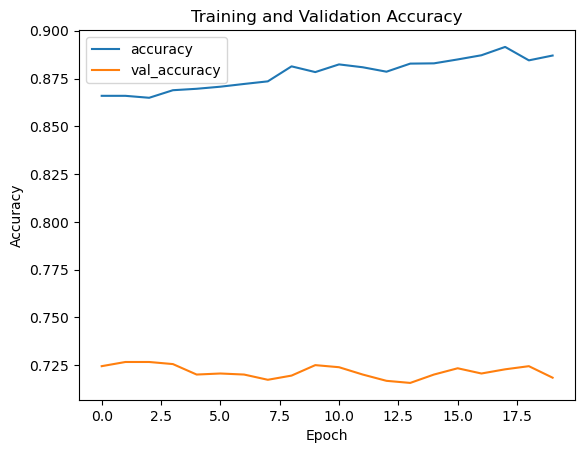

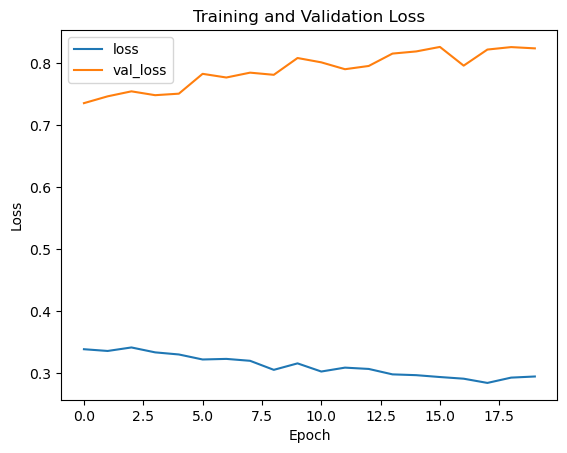

Fold 4
Epoch 1/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2923 - accuracy: 0.8894 - val_loss: 0.8278 - val_accuracy: 0.7262
Epoch 2/20
230/230 [==============================] - 2s 10ms/step - loss: 0.2948 - accuracy: 0.8851 - val_loss: 0.8224 - val_accuracy: 0.7262
Epoch 3/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2875 - accuracy: 0.8891 - val_loss: 0.8235 - val_accuracy: 0.7278
Epoch 4/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2827 - accuracy: 0.8910 - val_loss: 0.8313 - val_accuracy: 0.7174
Epoch 5/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2823 - accuracy: 0.8899 - val_loss: 0.8445 - val_accuracy: 0.7202
Epoch 6/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2704 - accuracy: 0.8973 - val_loss: 0.8550 - val_accuracy: 0.7212
Epoch 7/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2744 - accuracy: 0.8923 - val_loss: 0.8493 - val_accuracy: 0.721

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7217962760131434, Validation F1 Score: 0.7178249436435042


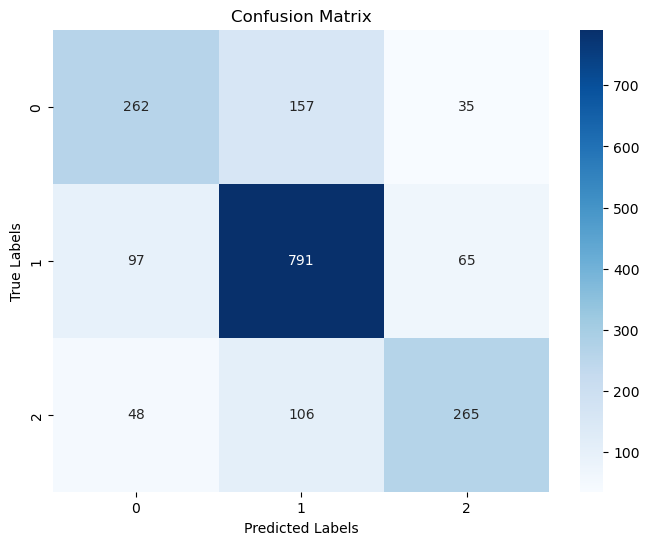

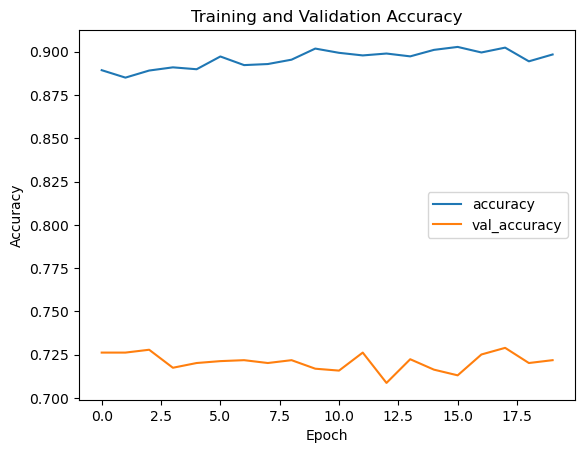

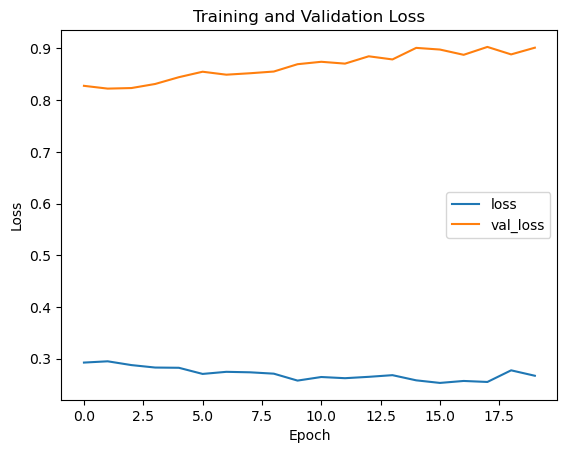

Fold 5
Epoch 1/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2515 - accuracy: 0.9042 - val_loss: 0.8907 - val_accuracy: 0.7229
Epoch 2/20
230/230 [==============================] - 2s 11ms/step - loss: 0.2515 - accuracy: 0.9024 - val_loss: 0.9075 - val_accuracy: 0.7191
Epoch 3/20
230/230 [==============================] - 2s 10ms/step - loss: 0.2522 - accuracy: 0.9042 - val_loss: 0.9275 - val_accuracy: 0.7251
Epoch 4/20
230/230 [==============================] - 3s 12ms/step - loss: 0.2374 - accuracy: 0.9110 - val_loss: 0.9140 - val_accuracy: 0.7202
Epoch 5/20
230/230 [==============================] - 3s 14ms/step - loss: 0.2452 - accuracy: 0.9039 - val_loss: 0.9348 - val_accuracy: 0.7180
Epoch 6/20
230/230 [==============================] - 2s 9ms/step - loss: 0.2412 - accuracy: 0.9120 - val_loss: 0.9321 - val_accuracy: 0.7147
Epoch 7/20
230/230 [==============================] - 3s 11ms/step - loss: 0.2533 - accuracy: 0.9052 - val_loss: 0.9114 - val_accuracy: 0

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7130339539978094, Validation F1 Score: 0.7114349005063605


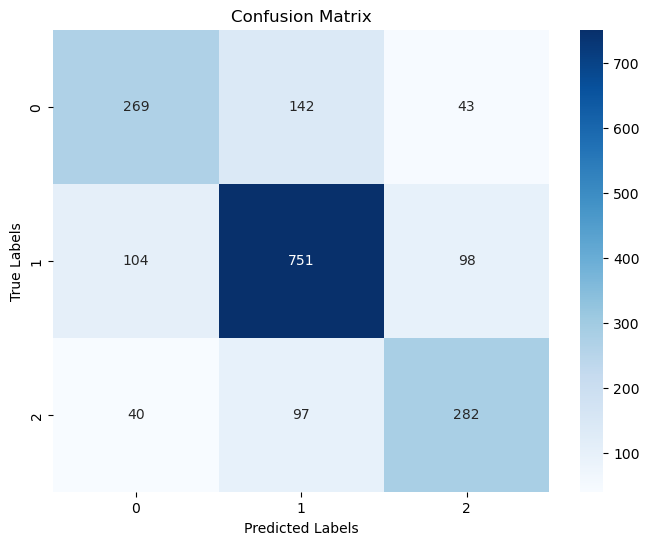

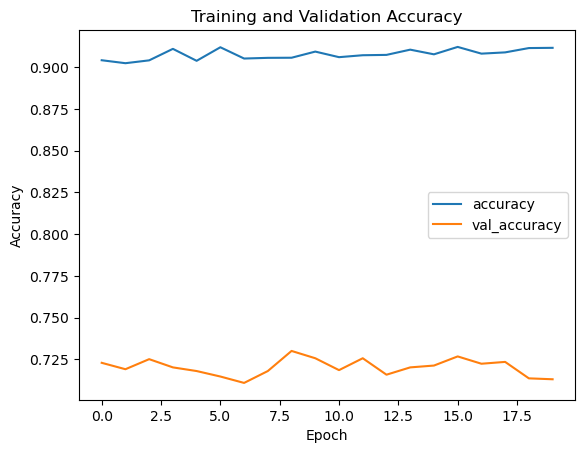

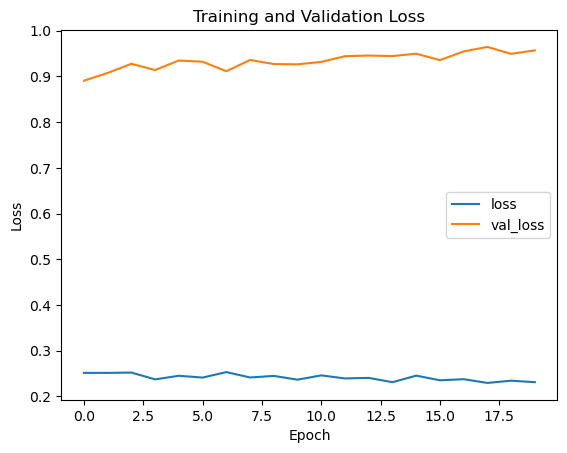

Fold 6
Epoch 1/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2237 - accuracy: 0.9144 - val_loss: 0.9668 - val_accuracy: 0.7185
Epoch 2/20
230/230 [==============================] - 3s 12ms/step - loss: 0.2190 - accuracy: 0.9188 - val_loss: 0.9805 - val_accuracy: 0.7262
Epoch 3/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2362 - accuracy: 0.9096 - val_loss: 0.9658 - val_accuracy: 0.7191
Epoch 4/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2350 - accuracy: 0.9097 - val_loss: 0.9798 - val_accuracy: 0.7245
Epoch 5/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2325 - accuracy: 0.9128 - val_loss: 0.9744 - val_accuracy: 0.7306
Epoch 6/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2296 - accuracy: 0.9119 - val_loss: 0.9676 - val_accuracy: 0.7223
Epoch 7/20
230/230 [==============================] - 2s 10ms/step - loss: 0.2231 - accuracy: 0.9151 - val_loss: 0.9806 - val_accuracy: 0.72

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.723986856516977, Validation F1 Score: 0.7200416344717918


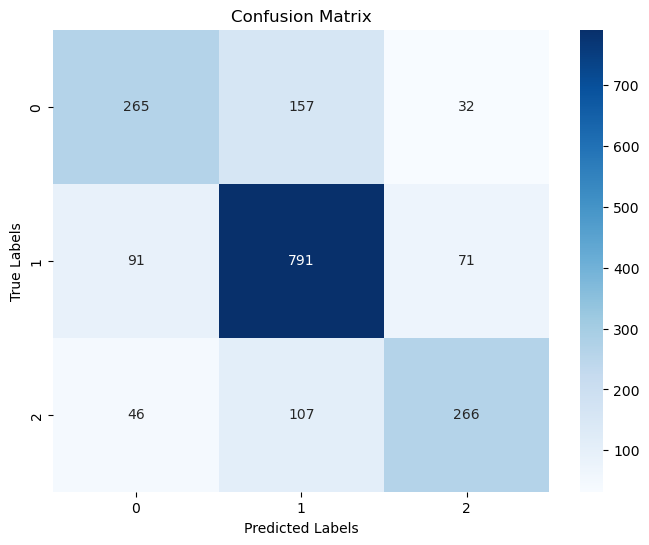

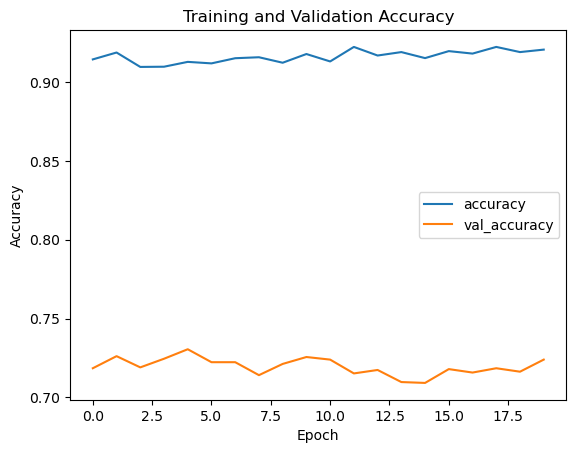

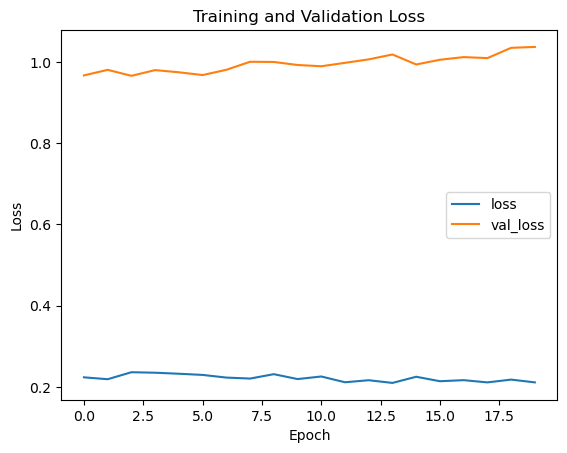

Fold 7
Epoch 1/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2088 - accuracy: 0.9222 - val_loss: 1.0196 - val_accuracy: 0.7174
Epoch 2/20
230/230 [==============================] - 3s 13ms/step - loss: 0.2035 - accuracy: 0.9241 - val_loss: 1.0313 - val_accuracy: 0.7152
Epoch 3/20
230/230 [==============================] - 3s 13ms/step - loss: 0.2086 - accuracy: 0.9200 - val_loss: 1.0464 - val_accuracy: 0.7218
Epoch 4/20
230/230 [==============================] - 3s 11ms/step - loss: 0.2061 - accuracy: 0.9228 - val_loss: 1.0295 - val_accuracy: 0.7141
Epoch 5/20
230/230 [==============================] - 3s 14ms/step - loss: 0.2051 - accuracy: 0.9237 - val_loss: 1.0645 - val_accuracy: 0.7207
Epoch 6/20
230/230 [==============================] - 2s 8ms/step - loss: 0.2036 - accuracy: 0.9238 - val_loss: 1.0703 - val_accuracy: 0.7163
Epoch 7/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2156 - accuracy: 0.9182 - val_loss: 1.0582 - val_accuracy: 0.

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7141292442497261, Validation F1 Score: 0.7094634917474023


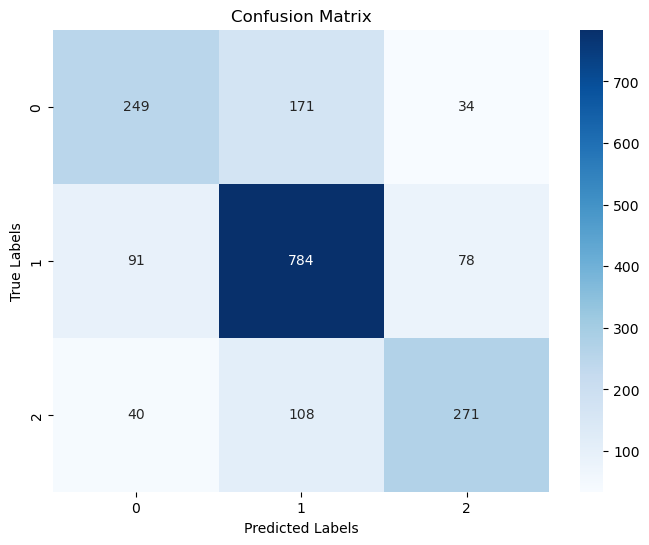

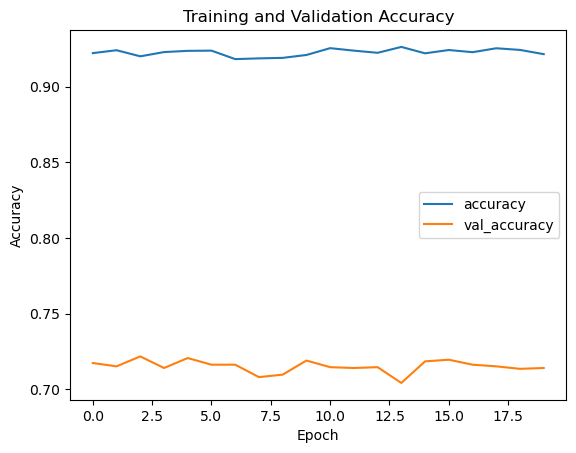

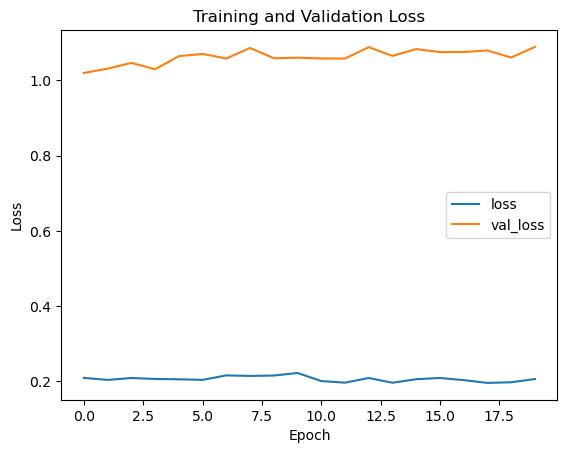

Fold 8
Epoch 1/20
230/230 [==============================] - 2s 7ms/step - loss: 0.1973 - accuracy: 0.9263 - val_loss: 1.1074 - val_accuracy: 0.7087
Epoch 2/20
230/230 [==============================] - 2s 7ms/step - loss: 0.1930 - accuracy: 0.9263 - val_loss: 1.0992 - val_accuracy: 0.7180
Epoch 3/20
230/230 [==============================] - 2s 7ms/step - loss: 0.2032 - accuracy: 0.9238 - val_loss: 1.0946 - val_accuracy: 0.7114
Epoch 4/20
230/230 [==============================] - 3s 11ms/step - loss: 0.1984 - accuracy: 0.9221 - val_loss: 1.1184 - val_accuracy: 0.7081
Epoch 5/20
230/230 [==============================] - 3s 12ms/step - loss: 0.2082 - accuracy: 0.9237 - val_loss: 1.1078 - val_accuracy: 0.7125
Epoch 6/20
230/230 [==============================] - 3s 14ms/step - loss: 0.1944 - accuracy: 0.9282 - val_loss: 1.1058 - val_accuracy: 0.7152
Epoch 7/20
230/230 [==============================] - 3s 12ms/step - loss: 0.1983 - accuracy: 0.9246 - val_loss: 1.1168 - val_accuracy: 0.

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7157721796276013, Validation F1 Score: 0.7102369866913234


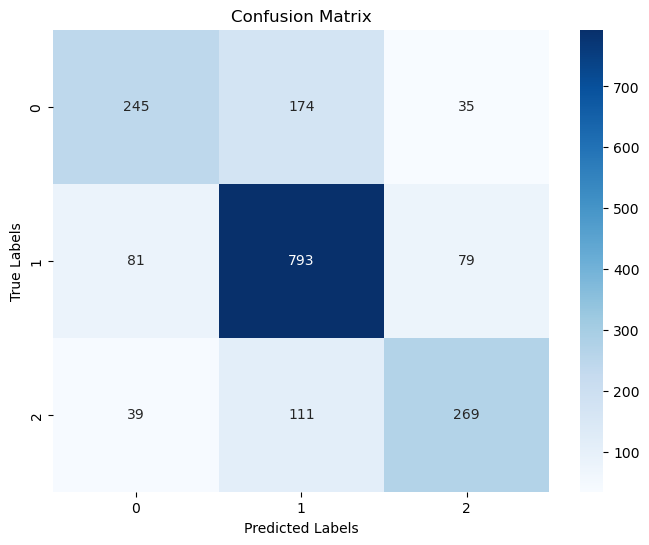

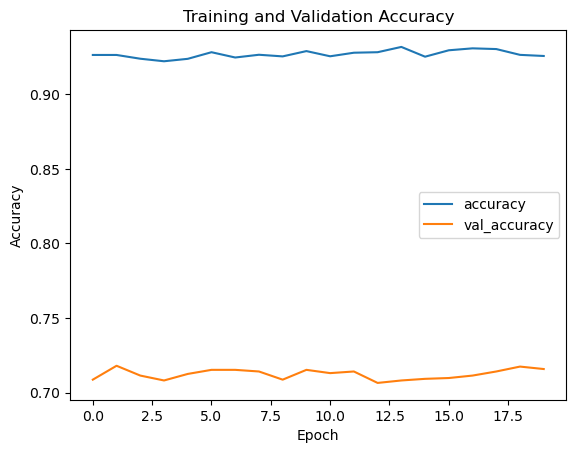

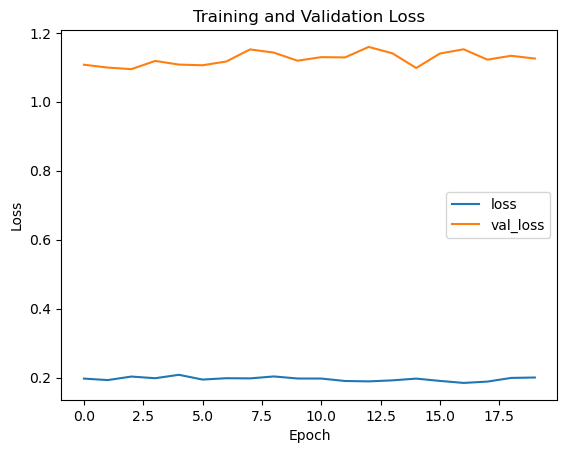

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7215909090909091
Mean F1 Score: 0.7186011305797741
Number of Epochs: 20, Test Size: 0.2, Validation Size: 0.15
Fold 1
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 1.3847 - accuracy: 0.5303 - val_loss: 0.7746 - val_accuracy: 0.6711
Epoch 2/20
216/216 [==============================] - 2s 9ms/step - loss: 0.8787 - accuracy: 0.6243 - val_loss: 0.7183 - val_accuracy: 0.6910
Epoch 3/20
216/216 [==============================] - 2s 10ms/step - loss: 0.7598 - accuracy: 0.6591 - val_loss: 0.7036 - val_accuracy: 0.6971
Epoch 4/20
216/216 [==============================] - 2s 11ms/step - loss: 0.7062 - accuracy: 0.6974 - val_loss: 0.6715 - val_accuracy: 0.7103
Epoch 5/20
216/216 [==============================] - 2s 9ms/step - loss: 0.6801 - accuracy: 0.7057 - val_loss: 0.6639 - val_accuracy: 0.7174
Epoch 6/20
216/216 [==============================] - 2s 8ms/step - loss: 0.6464 - accuracy: 0.7224 - val_loss: 0.6525 - val_accuracy: 0.7196
Epoch 7/20


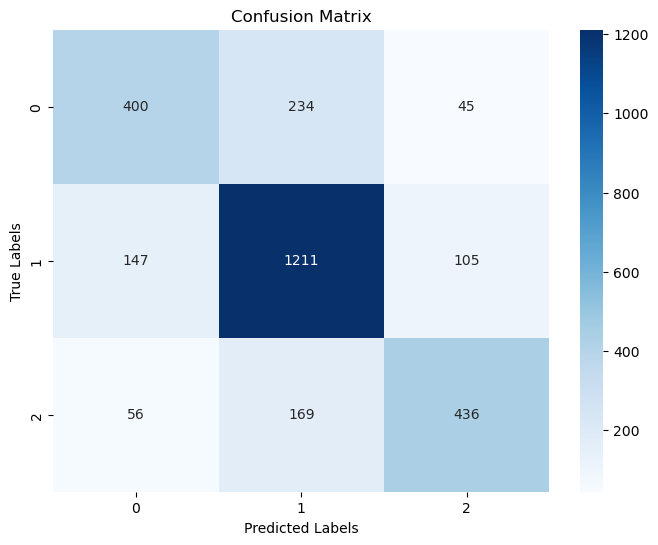

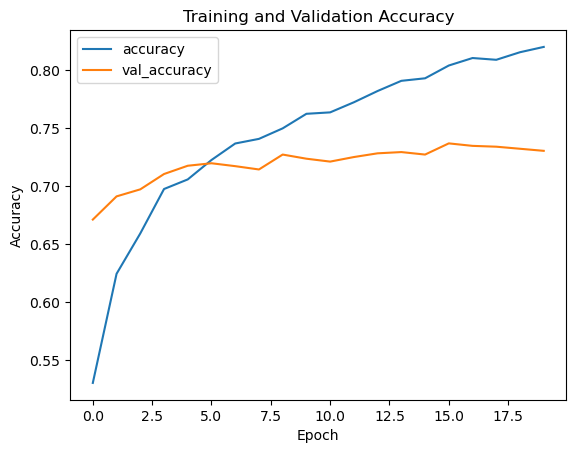

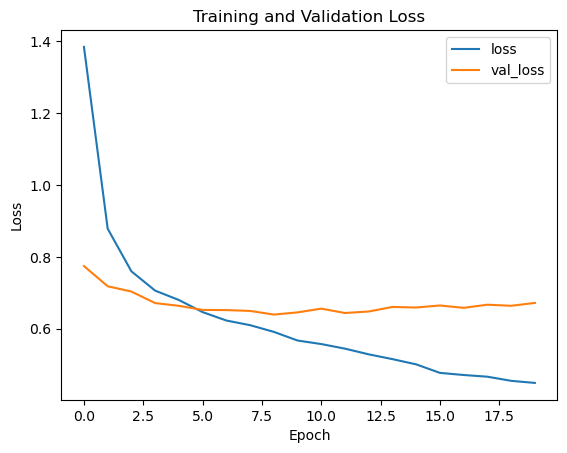

Fold 2
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 0.4359 - accuracy: 0.8230 - val_loss: 0.6820 - val_accuracy: 0.7274
Epoch 2/20
216/216 [==============================] - 2s 8ms/step - loss: 0.4265 - accuracy: 0.8271 - val_loss: 0.6889 - val_accuracy: 0.7324
Epoch 3/20
216/216 [==============================] - 3s 14ms/step - loss: 0.4277 - accuracy: 0.8280 - val_loss: 0.6819 - val_accuracy: 0.7264
Epoch 4/20
216/216 [==============================] - 2s 7ms/step - loss: 0.4088 - accuracy: 0.8358 - val_loss: 0.7013 - val_accuracy: 0.7207
Epoch 5/20
216/216 [==============================] - 2s 8ms/step - loss: 0.4055 - accuracy: 0.8375 - val_loss: 0.7003 - val_accuracy: 0.7235
Epoch 6/20
216/216 [==============================] - 2s 8ms/step - loss: 0.3921 - accuracy: 0.8397 - val_loss: 0.7083 - val_accuracy: 0.7257
Epoch 7/20
216/216 [==============================] - 2s 8ms/step - loss: 0.3984 - accuracy: 0.8404 - val_loss: 0.7212 - val_accuracy: 0.722

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.720656439529076, Validation F1 Score: 0.7173837757007733


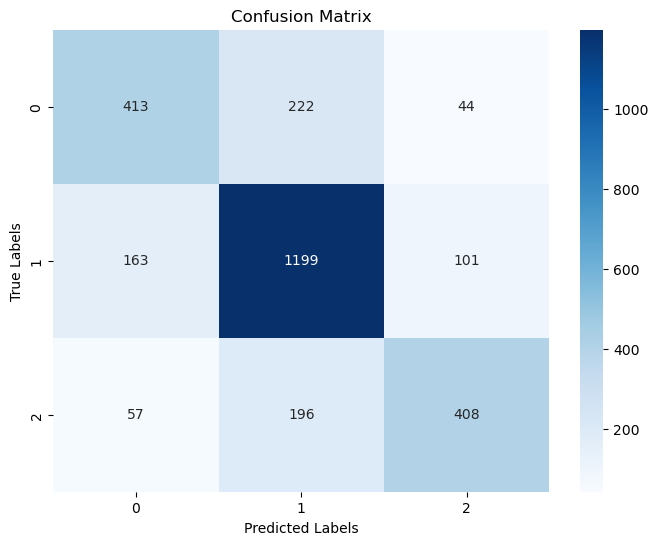

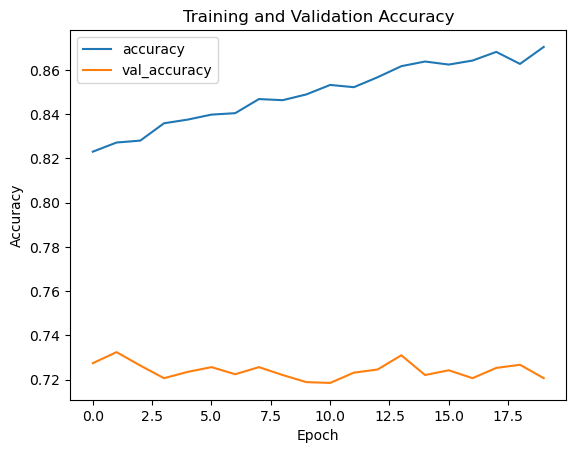

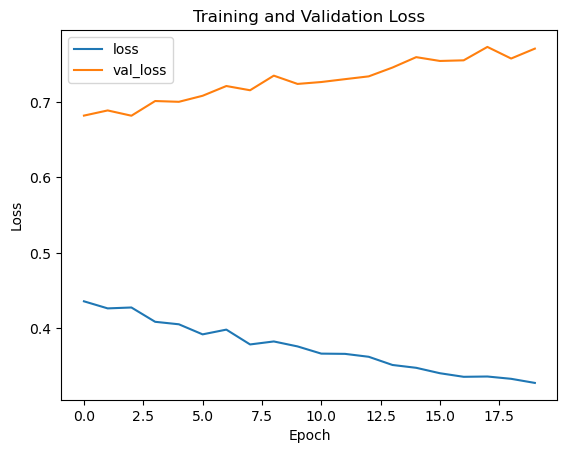

Fold 3
Epoch 1/20
216/216 [==============================] - 2s 7ms/step - loss: 0.3271 - accuracy: 0.8694 - val_loss: 0.7942 - val_accuracy: 0.7210
Epoch 2/20
216/216 [==============================] - 2s 8ms/step - loss: 0.3212 - accuracy: 0.8753 - val_loss: 0.7886 - val_accuracy: 0.7196
Epoch 3/20
216/216 [==============================] - 2s 8ms/step - loss: 0.3173 - accuracy: 0.8736 - val_loss: 0.7742 - val_accuracy: 0.7174
Epoch 4/20
216/216 [==============================] - 2s 10ms/step - loss: 0.3053 - accuracy: 0.8777 - val_loss: 0.7977 - val_accuracy: 0.7228
Epoch 5/20
216/216 [==============================] - 2s 10ms/step - loss: 0.3086 - accuracy: 0.8791 - val_loss: 0.8024 - val_accuracy: 0.7235
Epoch 6/20
216/216 [==============================] - 2s 11ms/step - loss: 0.3022 - accuracy: 0.8832 - val_loss: 0.8068 - val_accuracy: 0.7224
Epoch 7/20
216/216 [==============================] - 3s 15ms/step - loss: 0.2937 - accuracy: 0.8849 - val_loss: 0.8145 - val_accuracy: 0.

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7217267213699607, Validation F1 Score: 0.7186970117544439


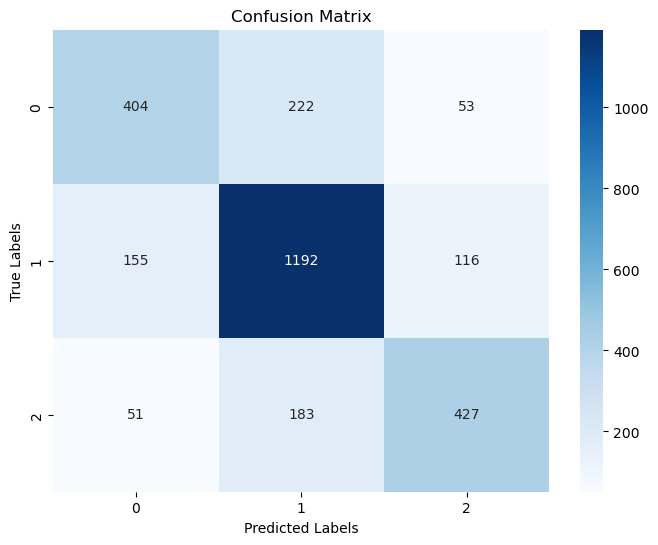

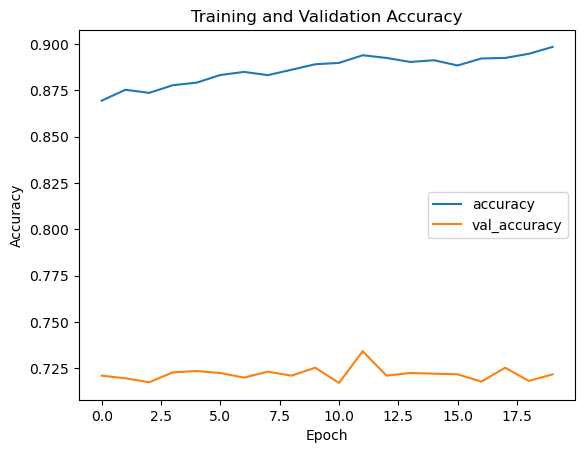

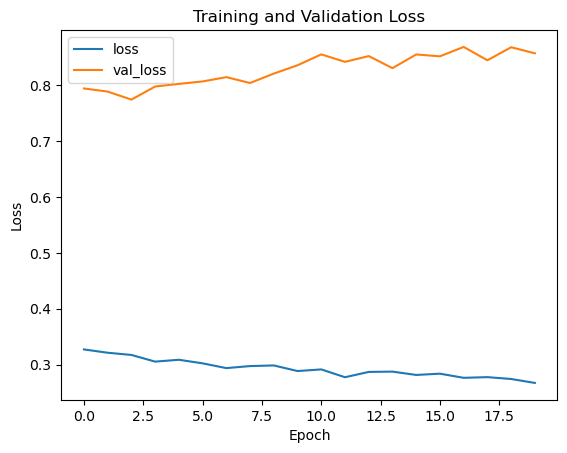

Fold 4
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2639 - accuracy: 0.8969 - val_loss: 0.8805 - val_accuracy: 0.7214
Epoch 2/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2664 - accuracy: 0.8987 - val_loss: 0.8737 - val_accuracy: 0.7164
Epoch 3/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2698 - accuracy: 0.8975 - val_loss: 0.8693 - val_accuracy: 0.7167
Epoch 4/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2706 - accuracy: 0.8948 - val_loss: 0.8838 - val_accuracy: 0.7228
Epoch 5/20
216/216 [==============================] - 2s 10ms/step - loss: 0.2616 - accuracy: 0.9006 - val_loss: 0.8608 - val_accuracy: 0.7285
Epoch 6/20
216/216 [==============================] - 2s 9ms/step - loss: 0.2610 - accuracy: 0.9001 - val_loss: 0.8766 - val_accuracy: 0.7214
Epoch 7/20
216/216 [==============================] - 2s 9ms/step - loss: 0.2583 - accuracy: 0.9016 - val_loss: 0.8857 - val_accuracy: 0.724

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7185158758473065, Validation F1 Score: 0.7159897776303437


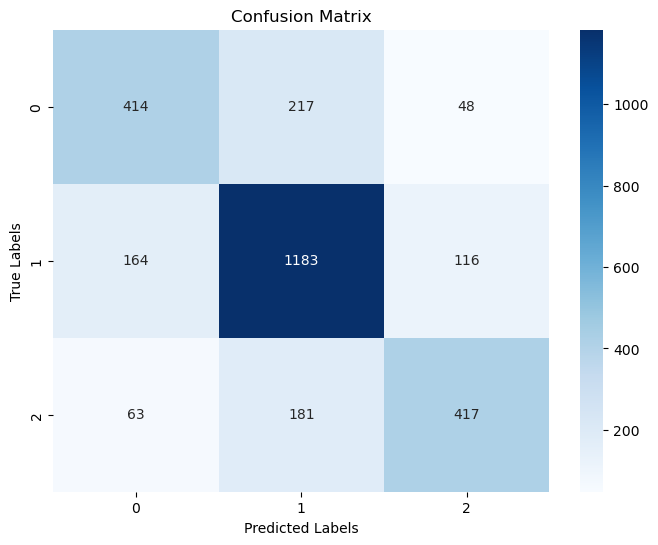

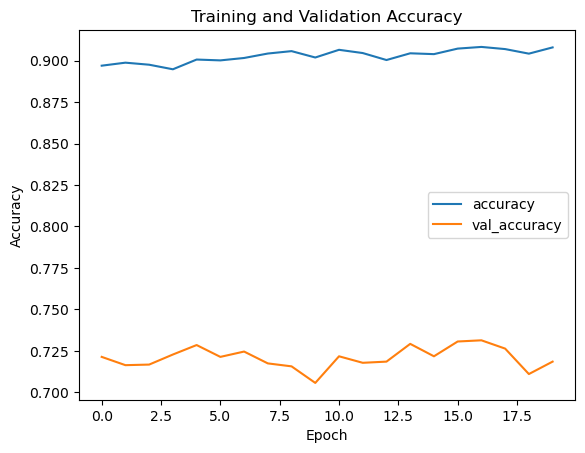

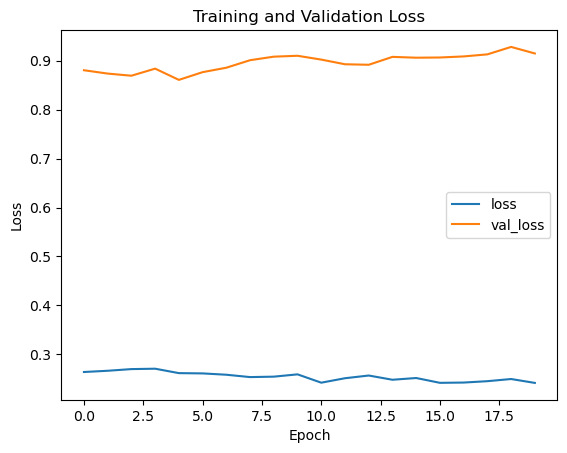

Fold 5
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2406 - accuracy: 0.9091 - val_loss: 0.9207 - val_accuracy: 0.7164
Epoch 2/20
216/216 [==============================] - 2s 11ms/step - loss: 0.2402 - accuracy: 0.9052 - val_loss: 0.9342 - val_accuracy: 0.7182
Epoch 3/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2291 - accuracy: 0.9124 - val_loss: 0.9302 - val_accuracy: 0.7178
Epoch 4/20
216/216 [==============================] - 2s 9ms/step - loss: 0.2277 - accuracy: 0.9108 - val_loss: 0.9596 - val_accuracy: 0.7146
Epoch 5/20
216/216 [==============================] - 2s 9ms/step - loss: 0.2230 - accuracy: 0.9143 - val_loss: 0.9385 - val_accuracy: 0.7192
Epoch 6/20
216/216 [==============================] - 2s 11ms/step - loss: 0.2303 - accuracy: 0.9095 - val_loss: 0.9495 - val_accuracy: 0.7210
Epoch 7/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2323 - accuracy: 0.9116 - val_loss: 0.9664 - val_accuracy: 0.71

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7124509454156261, Validation F1 Score: 0.708645949660346


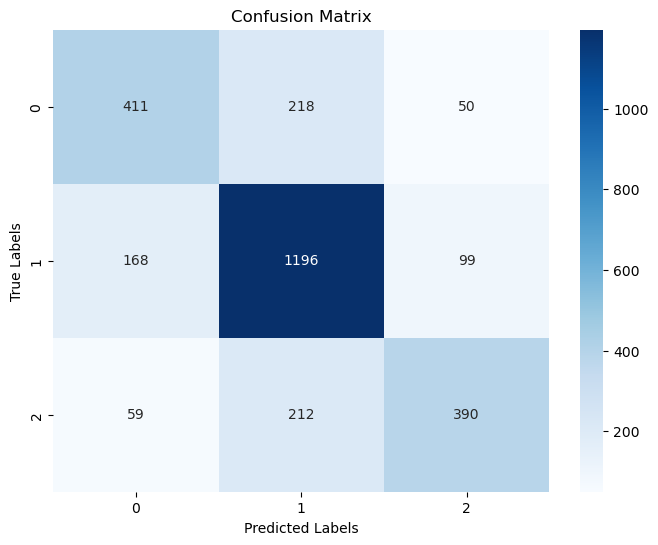

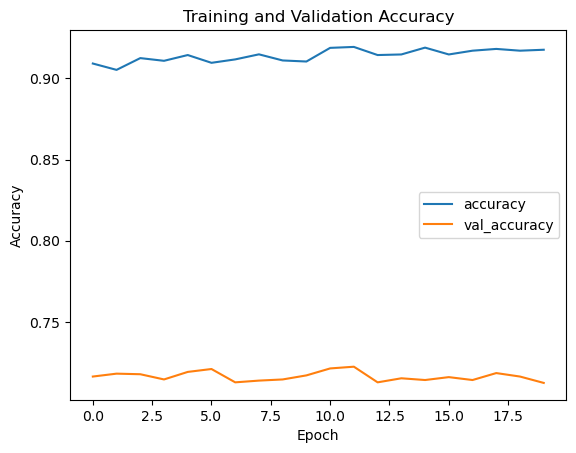

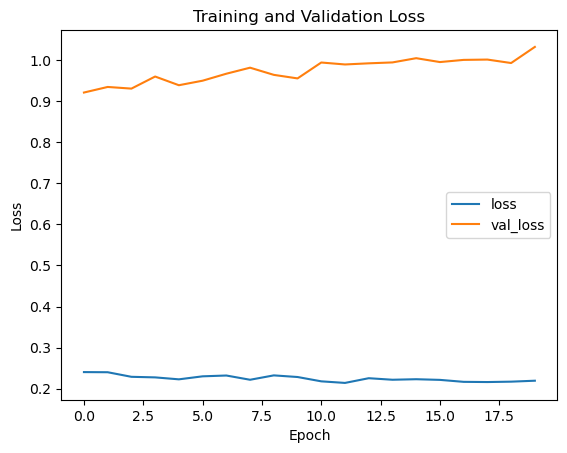

Fold 6
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2128 - accuracy: 0.9207 - val_loss: 1.0280 - val_accuracy: 0.7149
Epoch 2/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2146 - accuracy: 0.9177 - val_loss: 1.0275 - val_accuracy: 0.7092
Epoch 3/20
216/216 [==============================] - 3s 13ms/step - loss: 0.2197 - accuracy: 0.9169 - val_loss: 1.0268 - val_accuracy: 0.7107
Epoch 4/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2167 - accuracy: 0.9170 - val_loss: 1.0297 - val_accuracy: 0.7092
Epoch 5/20
216/216 [==============================] - 3s 12ms/step - loss: 0.2187 - accuracy: 0.9168 - val_loss: 1.0270 - val_accuracy: 0.7121
Epoch 6/20
216/216 [==============================] - 3s 15ms/step - loss: 0.2146 - accuracy: 0.9189 - val_loss: 1.0323 - val_accuracy: 0.7121
Epoch 7/20
216/216 [==============================] - 3s 12ms/step - loss: 0.2073 - accuracy: 0.9213 - val_loss: 1.0419 - val_accuracy: 0.

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7188726364609347, Validation F1 Score: 0.7164445611100864


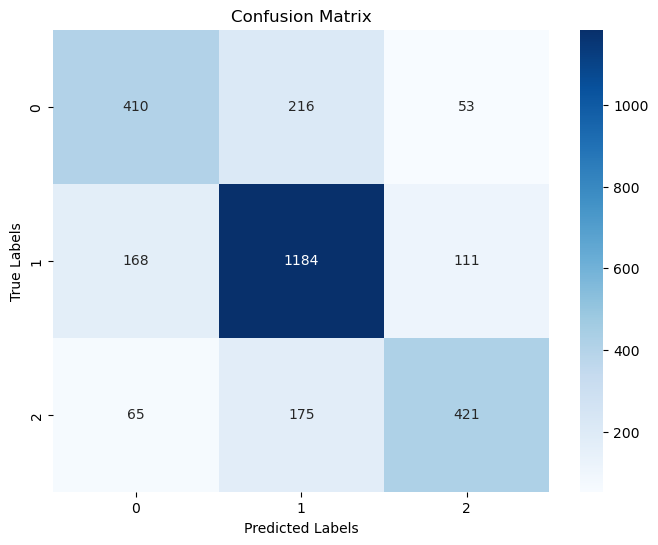

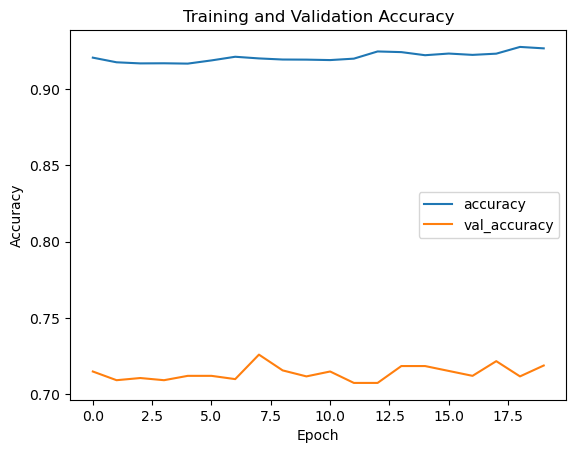

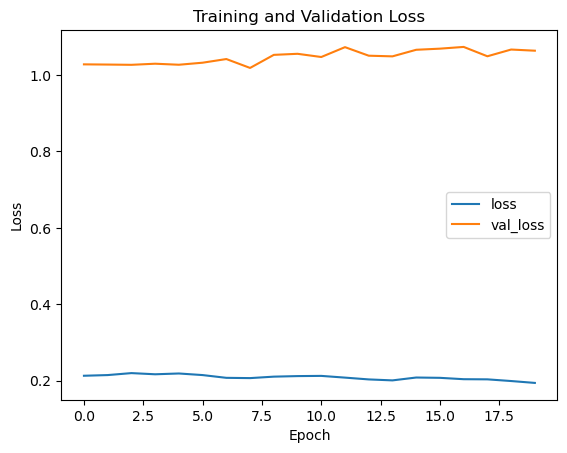

Fold 7
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2001 - accuracy: 0.9258 - val_loss: 1.0501 - val_accuracy: 0.7157
Epoch 2/20
216/216 [==============================] - 2s 7ms/step - loss: 0.1988 - accuracy: 0.9266 - val_loss: 1.0780 - val_accuracy: 0.7171
Epoch 3/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2032 - accuracy: 0.9239 - val_loss: 1.0557 - val_accuracy: 0.7149
Epoch 4/20
216/216 [==============================] - 2s 10ms/step - loss: 0.2002 - accuracy: 0.9271 - val_loss: 1.0683 - val_accuracy: 0.7210
Epoch 5/20
216/216 [==============================] - 2s 9ms/step - loss: 0.2055 - accuracy: 0.9252 - val_loss: 1.0684 - val_accuracy: 0.7157
Epoch 6/20
216/216 [==============================] - 2s 7ms/step - loss: 0.1955 - accuracy: 0.9283 - val_loss: 1.0620 - val_accuracy: 0.7196
Epoch 7/20
216/216 [==============================] - 2s 8ms/step - loss: 0.1988 - accuracy: 0.9245 - val_loss: 1.0846 - val_accuracy: 0.713

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7160185515519086, Validation F1 Score: 0.7127611332319641


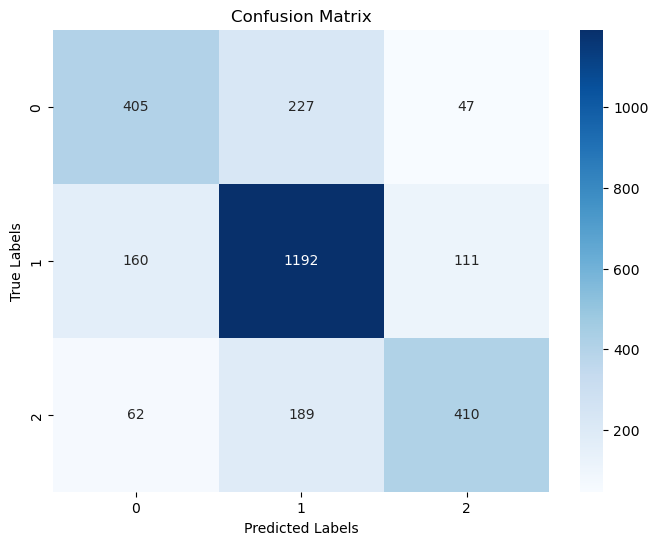

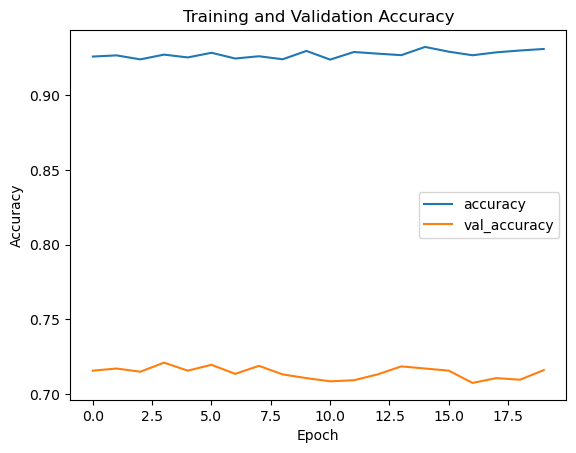

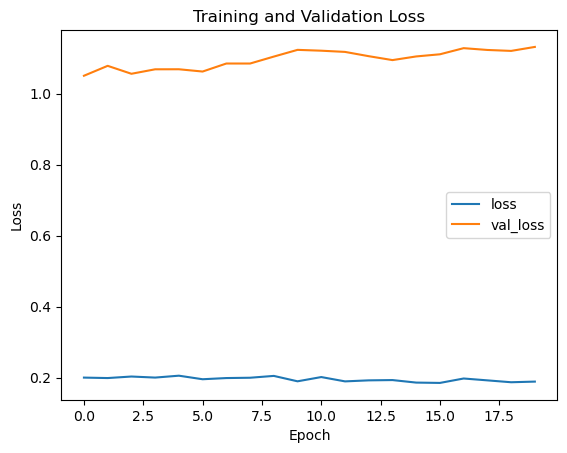

Fold 8
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 0.1920 - accuracy: 0.9293 - val_loss: 1.1341 - val_accuracy: 0.7132
Epoch 2/20
216/216 [==============================] - 2s 7ms/step - loss: 0.1808 - accuracy: 0.9335 - val_loss: 1.1508 - val_accuracy: 0.7096
Epoch 3/20
216/216 [==============================] - 2s 7ms/step - loss: 0.1895 - accuracy: 0.9303 - val_loss: 1.1506 - val_accuracy: 0.7103
Epoch 4/20
216/216 [==============================] - 2s 7ms/step - loss: 0.1848 - accuracy: 0.9288 - val_loss: 1.1331 - val_accuracy: 0.7089
Epoch 5/20
216/216 [==============================] - 2s 7ms/step - loss: 0.1770 - accuracy: 0.9329 - val_loss: 1.1298 - val_accuracy: 0.7196
Epoch 6/20
216/216 [==============================] - 2s 7ms/step - loss: 0.1860 - accuracy: 0.9308 - val_loss: 1.1297 - val_accuracy: 0.7128
Epoch 7/20
216/216 [==============================] - 2s 7ms/step - loss: 0.1851 - accuracy: 0.9305 - val_loss: 1.1457 - val_accuracy: 0.7053

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 3ms/step
Validation Accuracy: 0.7078130574384588, Validation F1 Score: 0.7065890319413194


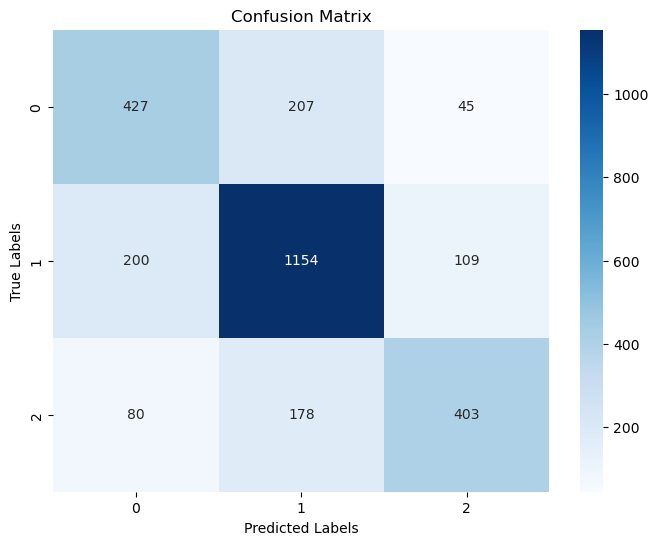

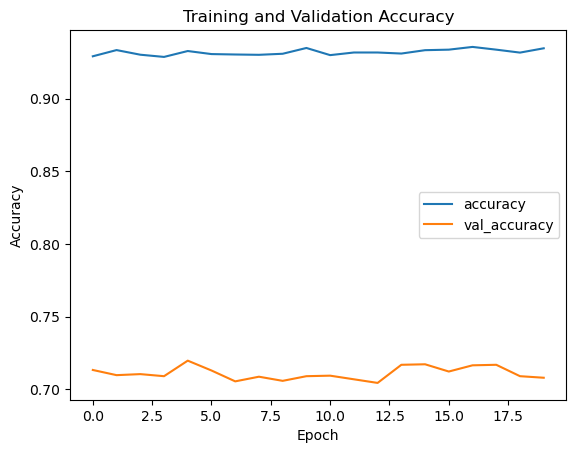

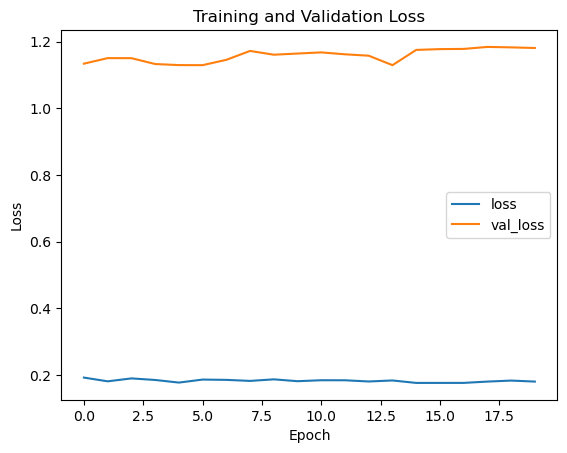

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7182929004637888
Mean F1 Score: 0.7154267103494287
Number of Epochs: 20, Test Size: 0.2, Validation Size: 0.2
Fold 1
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 1.4613 - accuracy: 0.5195 - val_loss: 0.7816 - val_accuracy: 0.6641
Epoch 2/20
216/216 [==============================] - 2s 7ms/step - loss: 0.8968 - accuracy: 0.6133 - val_loss: 0.7246 - val_accuracy: 0.6873
Epoch 3/20
216/216 [==============================] - 2s 7ms/step - loss: 0.7746 - accuracy: 0.6570 - val_loss: 0.6987 - val_accuracy: 0.7031
Epoch 4/20
216/216 [==============================] - 2s 7ms/step - loss: 0.7126 - accuracy: 0.6922 - val_loss: 0.6748 - val_accuracy: 0.7112
Epoch 5/20
216/216 [==============================] - 2s 7ms/step - loss: 0.6875 - accuracy: 0.7038 - val_loss: 0.6636 - val_accuracy: 0.7136
Epoch 6/20
216/216 [==============================] - 2s 7ms/step - loss: 0.6541 - accuracy: 0.7175 - val_loss: 0.6583 - val_accuracy: 0.7221
Epoch 7/20
216

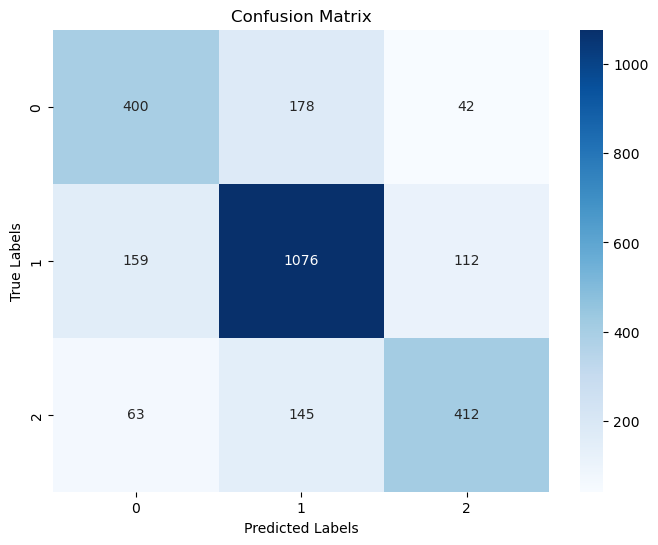

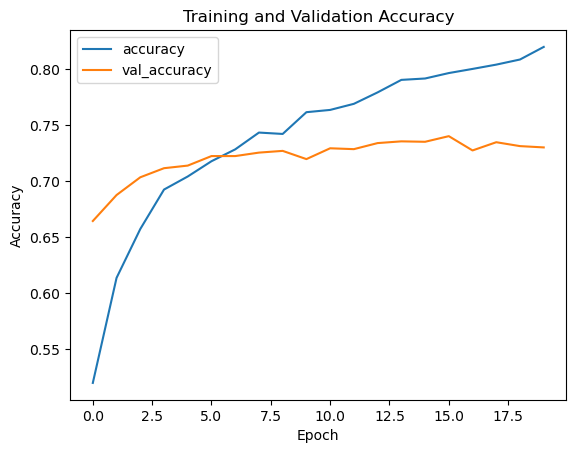

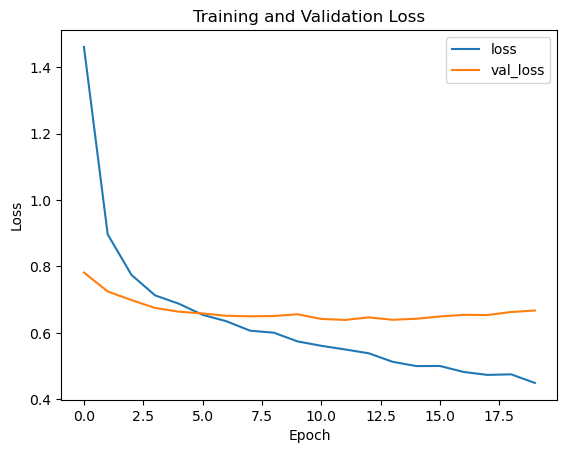

Fold 2
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 0.4474 - accuracy: 0.8178 - val_loss: 0.6708 - val_accuracy: 0.7310
Epoch 2/20
216/216 [==============================] - 2s 7ms/step - loss: 0.4392 - accuracy: 0.8208 - val_loss: 0.6756 - val_accuracy: 0.7283
Epoch 3/20
216/216 [==============================] - 2s 7ms/step - loss: 0.4245 - accuracy: 0.8313 - val_loss: 0.6873 - val_accuracy: 0.7228
Epoch 4/20
216/216 [==============================] - 2s 7ms/step - loss: 0.4151 - accuracy: 0.8318 - val_loss: 0.7001 - val_accuracy: 0.7294
Epoch 5/20
216/216 [==============================] - 2s 7ms/step - loss: 0.4188 - accuracy: 0.8305 - val_loss: 0.6982 - val_accuracy: 0.7275
Epoch 6/20
216/216 [==============================] - 2s 7ms/step - loss: 0.4052 - accuracy: 0.8371 - val_loss: 0.7016 - val_accuracy: 0.7232
Epoch 7/20
216/216 [==============================] - 2s 7ms/step - loss: 0.3962 - accuracy: 0.8408 - val_loss: 0.7029 - val_accuracy: 0.7228

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7282566679551604, Validation F1 Score: 0.7241582690387951


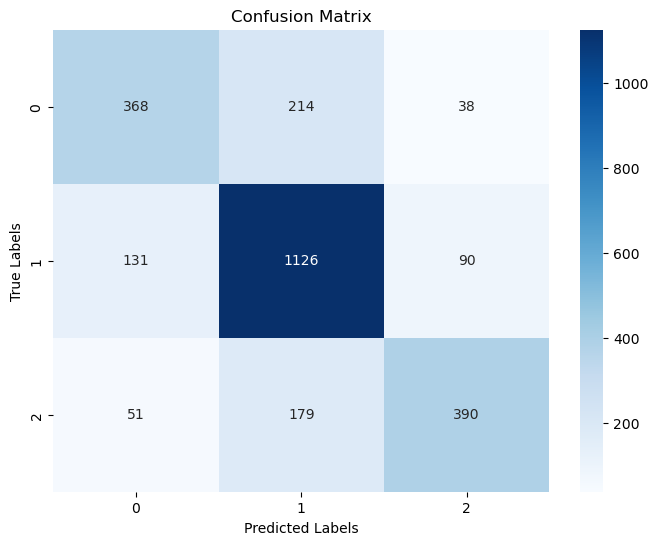

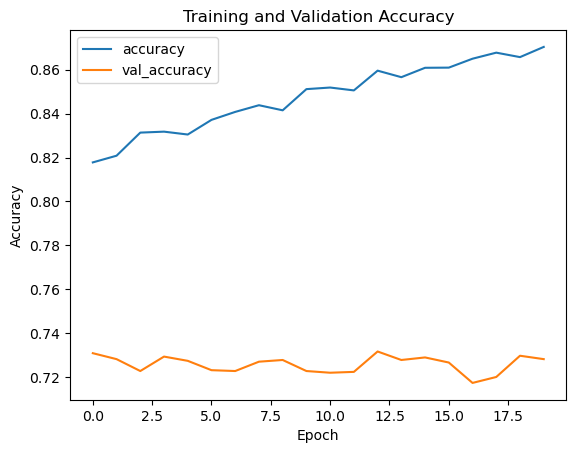

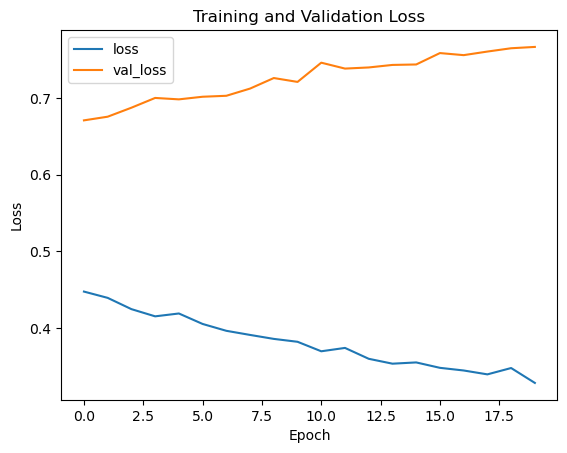

Fold 3
Epoch 1/20
216/216 [==============================] - 2s 7ms/step - loss: 0.3191 - accuracy: 0.8748 - val_loss: 0.7738 - val_accuracy: 0.7248
Epoch 2/20
216/216 [==============================] - 2s 10ms/step - loss: 0.3225 - accuracy: 0.8742 - val_loss: 0.7862 - val_accuracy: 0.7302
Epoch 3/20
216/216 [==============================] - 3s 14ms/step - loss: 0.3252 - accuracy: 0.8711 - val_loss: 0.7607 - val_accuracy: 0.7329
Epoch 4/20
216/216 [==============================] - 2s 10ms/step - loss: 0.3173 - accuracy: 0.8769 - val_loss: 0.7876 - val_accuracy: 0.7259
Epoch 5/20
216/216 [==============================] - 2s 7ms/step - loss: 0.3154 - accuracy: 0.8777 - val_loss: 0.7959 - val_accuracy: 0.7298
Epoch 6/20
216/216 [==============================] - 2s 7ms/step - loss: 0.3171 - accuracy: 0.8776 - val_loss: 0.7900 - val_accuracy: 0.7263
Epoch 7/20
216/216 [==============================] - 3s 14ms/step - loss: 0.3047 - accuracy: 0.8816 - val_loss: 0.7994 - val_accuracy: 0.

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.732508697332818, Validation F1 Score: 0.728620645899347


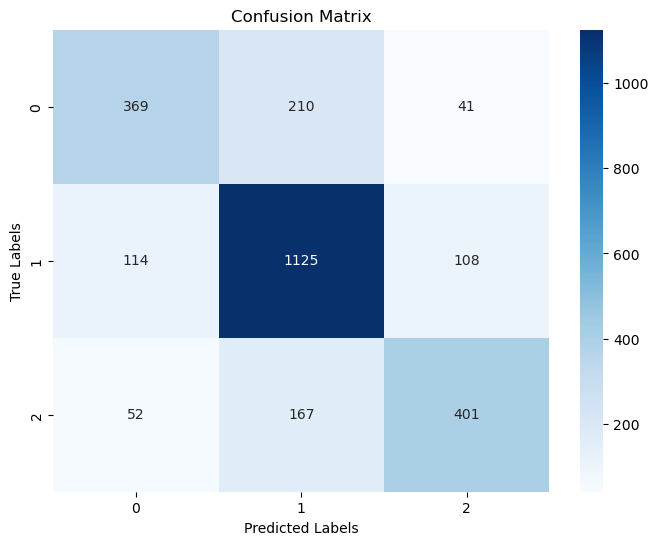

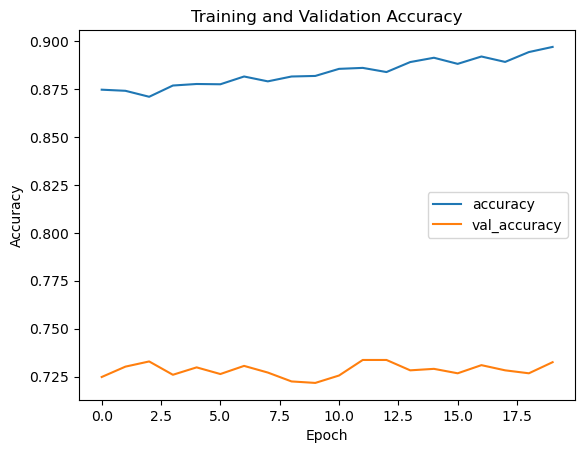

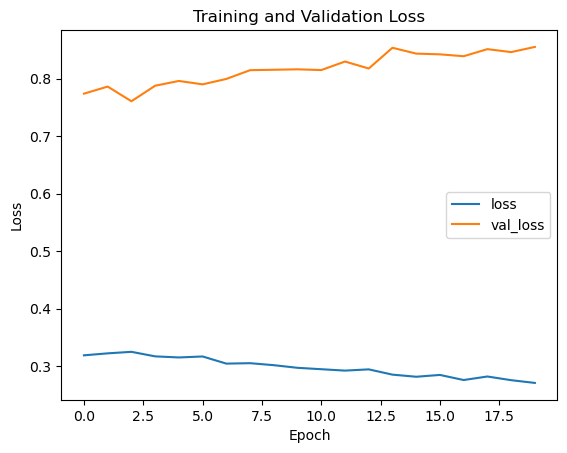

Fold 4
Epoch 1/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2767 - accuracy: 0.8911 - val_loss: 0.8695 - val_accuracy: 0.7244
Epoch 2/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2766 - accuracy: 0.8935 - val_loss: 0.8769 - val_accuracy: 0.7259
Epoch 3/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2606 - accuracy: 0.8986 - val_loss: 0.8854 - val_accuracy: 0.7275
Epoch 4/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2652 - accuracy: 0.8986 - val_loss: 0.8741 - val_accuracy: 0.7232
Epoch 5/20
216/216 [==============================] - 3s 12ms/step - loss: 0.2648 - accuracy: 0.8977 - val_loss: 0.8718 - val_accuracy: 0.7310
Epoch 6/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2675 - accuracy: 0.8965 - val_loss: 0.8860 - val_accuracy: 0.7325
Epoch 7/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2602 - accuracy: 0.9017 - val_loss: 0.8831 - val_accuracy: 0.725

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7267104754541941, Validation F1 Score: 0.7218413715696269


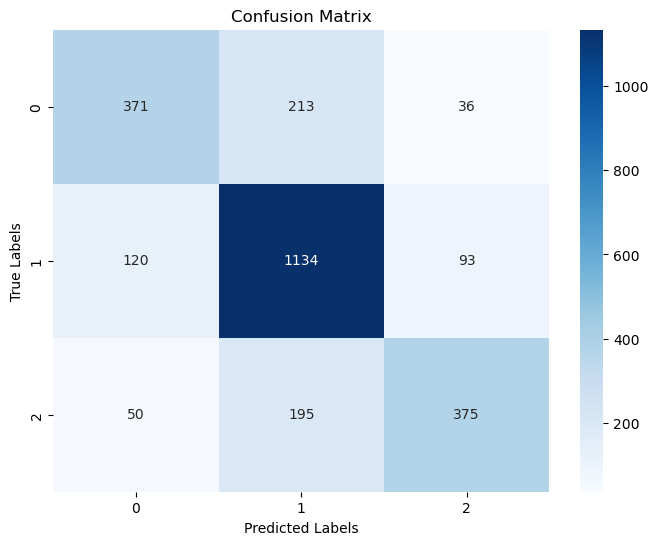

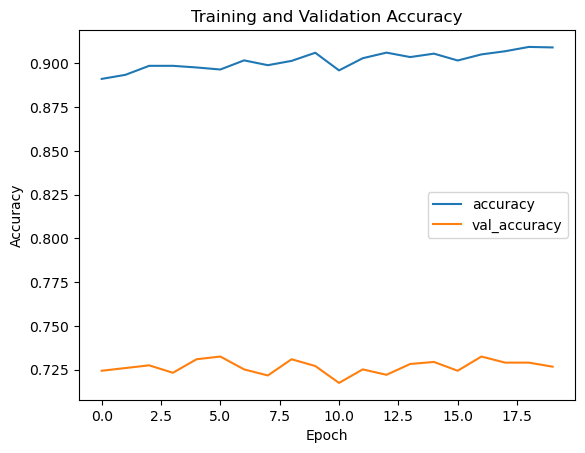

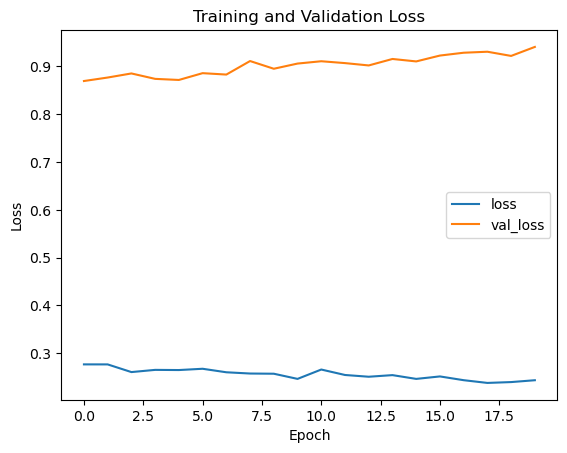

Fold 5
Epoch 1/20
216/216 [==============================] - 3s 12ms/step - loss: 0.2499 - accuracy: 0.9043 - val_loss: 0.9129 - val_accuracy: 0.7236
Epoch 2/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2360 - accuracy: 0.9101 - val_loss: 0.9312 - val_accuracy: 0.7205
Epoch 3/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2352 - accuracy: 0.9100 - val_loss: 0.9516 - val_accuracy: 0.7178
Epoch 4/20
216/216 [==============================] - 3s 14ms/step - loss: 0.2302 - accuracy: 0.9124 - val_loss: 0.9600 - val_accuracy: 0.7240
Epoch 5/20
216/216 [==============================] - 2s 10ms/step - loss: 0.2358 - accuracy: 0.9113 - val_loss: 0.9279 - val_accuracy: 0.7252
Epoch 6/20
216/216 [==============================] - 2s 10ms/step - loss: 0.2342 - accuracy: 0.9122 - val_loss: 0.9285 - val_accuracy: 0.7240
Epoch 7/20
216/216 [==============================] - 3s 15ms/step - loss: 0.2360 - accuracy: 0.9083 - val_loss: 0.9337 - val_accuracy: 0

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7220718979512949, Validation F1 Score: 0.7178455351309149


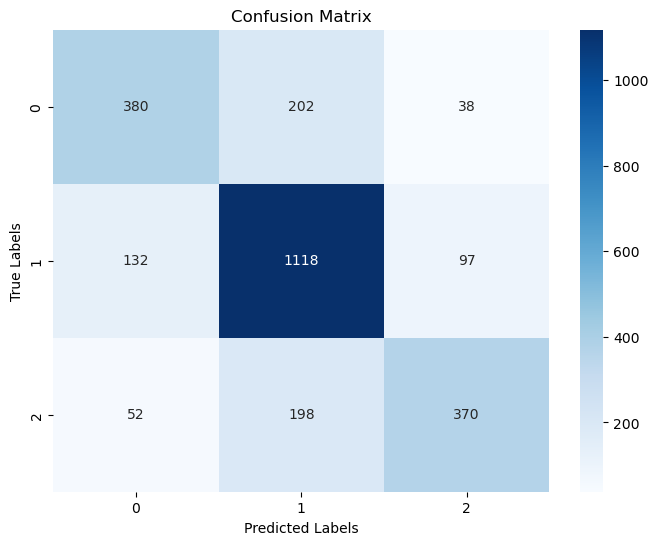

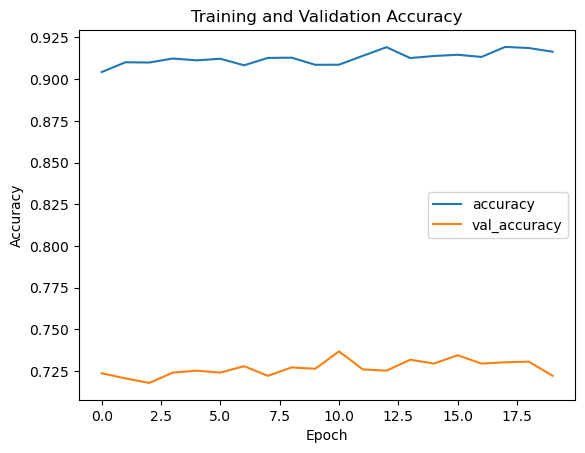

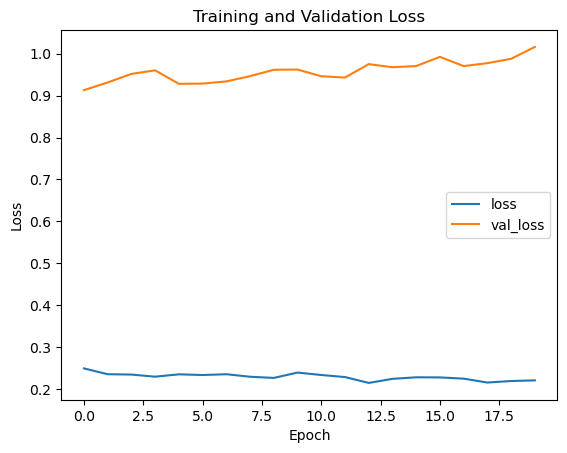

Fold 6
Epoch 1/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2146 - accuracy: 0.9177 - val_loss: 1.0004 - val_accuracy: 0.7236
Epoch 2/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2060 - accuracy: 0.9228 - val_loss: 1.0127 - val_accuracy: 0.7167
Epoch 3/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2165 - accuracy: 0.9160 - val_loss: 1.0108 - val_accuracy: 0.7186
Epoch 4/20
216/216 [==============================] - 3s 13ms/step - loss: 0.2073 - accuracy: 0.9213 - val_loss: 1.0469 - val_accuracy: 0.7244
Epoch 5/20
216/216 [==============================] - 3s 14ms/step - loss: 0.2159 - accuracy: 0.9214 - val_loss: 1.0294 - val_accuracy: 0.7310
Epoch 6/20
216/216 [==============================] - 2s 10ms/step - loss: 0.2084 - accuracy: 0.9209 - val_loss: 1.0452 - val_accuracy: 0.7256
Epoch 7/20
216/216 [==============================] - 3s 13ms/step - loss: 0.2039 - accuracy: 0.9224 - val_loss: 1.0577 - val_accuracy: 0.

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7259373792037108, Validation F1 Score: 0.7216689482409331


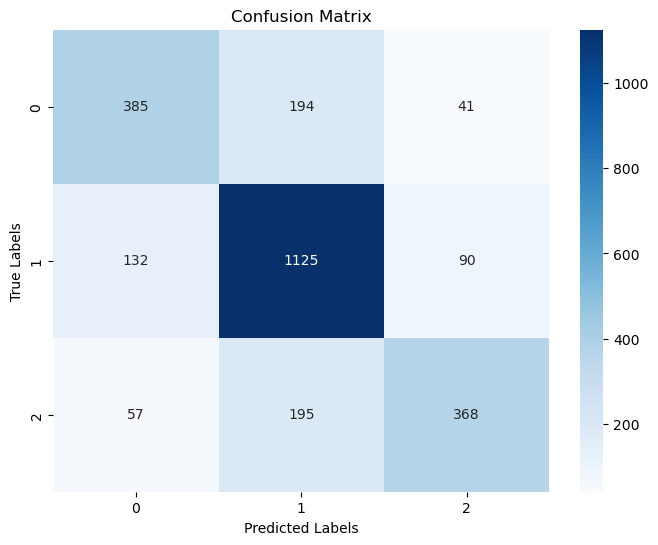

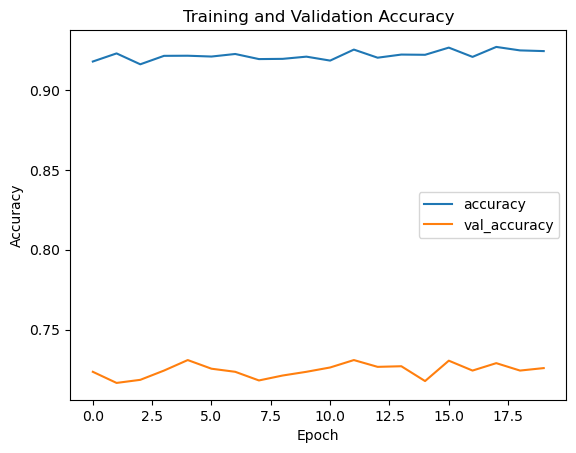

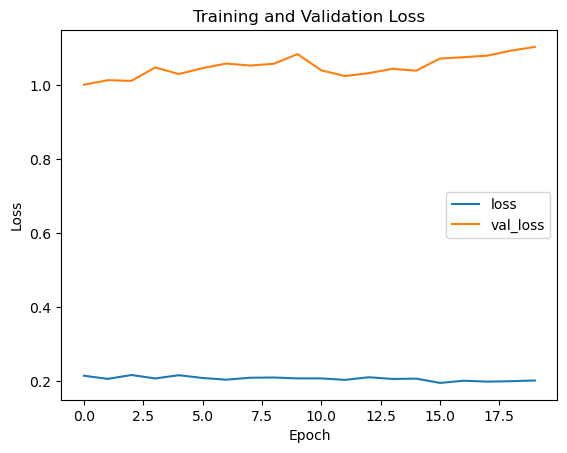

Fold 7
Epoch 1/20
216/216 [==============================] - 2s 11ms/step - loss: 0.2068 - accuracy: 0.9225 - val_loss: 1.0928 - val_accuracy: 0.7294
Epoch 2/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2055 - accuracy: 0.9253 - val_loss: 1.0878 - val_accuracy: 0.7294
Epoch 3/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2046 - accuracy: 0.9218 - val_loss: 1.0825 - val_accuracy: 0.7201
Epoch 4/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2018 - accuracy: 0.9246 - val_loss: 1.0702 - val_accuracy: 0.7205
Epoch 5/20
216/216 [==============================] - 2s 9ms/step - loss: 0.2006 - accuracy: 0.9243 - val_loss: 1.1110 - val_accuracy: 0.7256
Epoch 6/20
216/216 [==============================] - 3s 13ms/step - loss: 0.1961 - accuracy: 0.9262 - val_loss: 1.1214 - val_accuracy: 0.7182
Epoch 7/20
216/216 [==============================] - 3s 13ms/step - loss: 0.1893 - accuracy: 0.9325 - val_loss: 1.1067 - val_accuracy: 0.7

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7201391573250869, Validation F1 Score: 0.7149414872399483


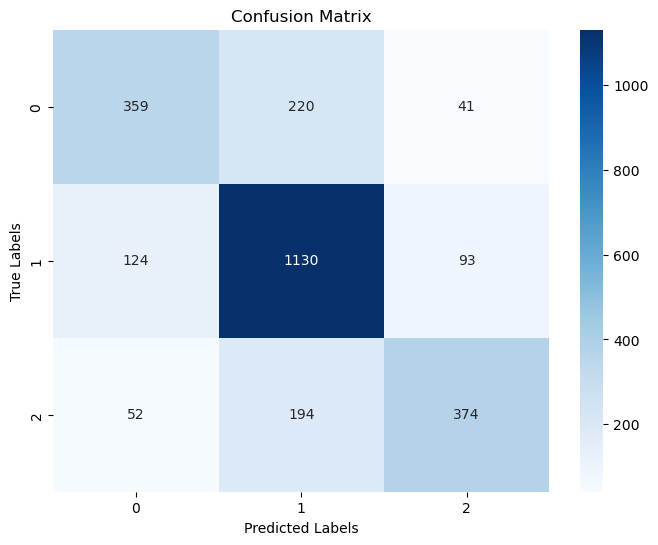

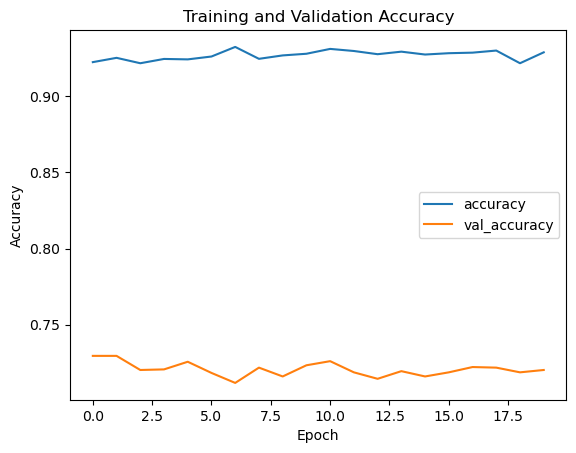

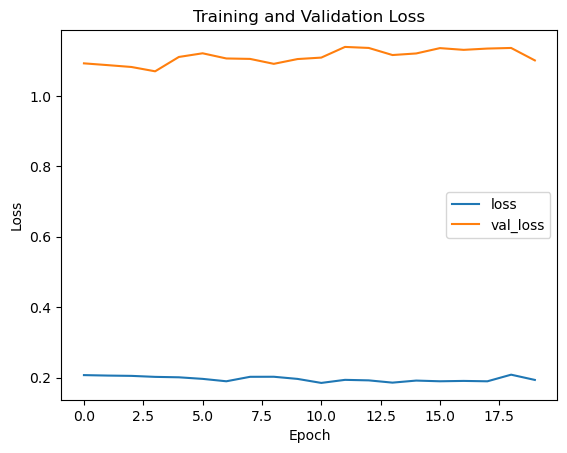

Fold 8
Epoch 1/20
216/216 [==============================] - 2s 10ms/step - loss: 0.1900 - accuracy: 0.9292 - val_loss: 1.1531 - val_accuracy: 0.7147
Epoch 2/20
216/216 [==============================] - 2s 7ms/step - loss: 0.1863 - accuracy: 0.9298 - val_loss: 1.1382 - val_accuracy: 0.7170
Epoch 3/20
216/216 [==============================] - 2s 9ms/step - loss: 0.1875 - accuracy: 0.9316 - val_loss: 1.1574 - val_accuracy: 0.7213
Epoch 4/20
216/216 [==============================] - 2s 7ms/step - loss: 0.1810 - accuracy: 0.9313 - val_loss: 1.1443 - val_accuracy: 0.7209
Epoch 5/20
216/216 [==============================] - 2s 8ms/step - loss: 0.1927 - accuracy: 0.9261 - val_loss: 1.1576 - val_accuracy: 0.7186
Epoch 6/20
216/216 [==============================] - 2s 9ms/step - loss: 0.1792 - accuracy: 0.9348 - val_loss: 1.1542 - val_accuracy: 0.7178
Epoch 7/20
216/216 [==============================] - 2s 10ms/step - loss: 0.1822 - accuracy: 0.9324 - val_loss: 1.1828 - val_accuracy: 0.72

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7263239273289525, Validation F1 Score: 0.7236632445508311


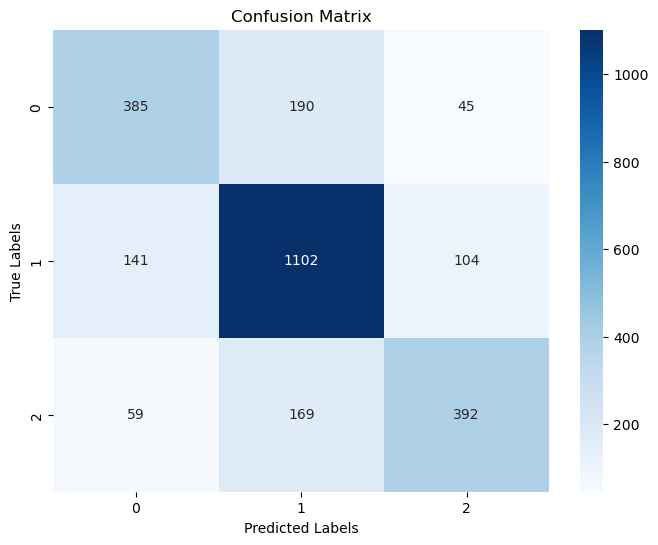

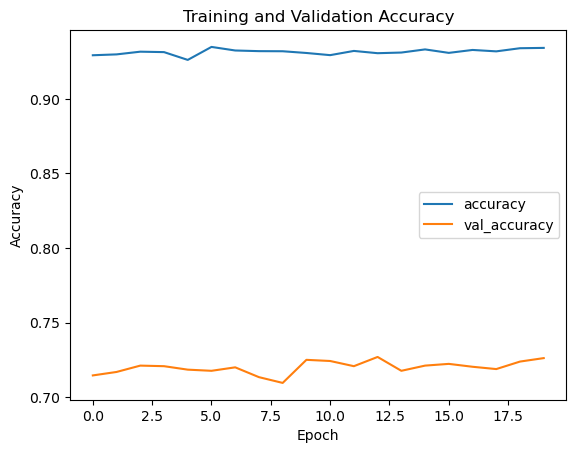

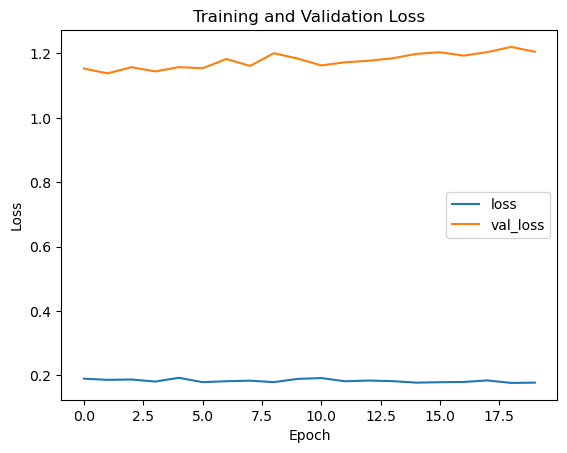

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.726468882875918
Mean F1 Score: 0.7227085428272513
Number of Epochs: 20, Test Size: 0.2, Validation Size: 0.25
Fold 1
Epoch 1/20
216/216 [==============================] - 2s 7ms/step - loss: 1.4558 - accuracy: 0.5224 - val_loss: 0.7831 - val_accuracy: 0.6664
Epoch 2/20
216/216 [==============================] - 2s 7ms/step - loss: 0.8897 - accuracy: 0.6238 - val_loss: 0.7375 - val_accuracy: 0.6908
Epoch 3/20
216/216 [==============================] - 2s 8ms/step - loss: 0.7707 - accuracy: 0.6597 - val_loss: 0.7102 - val_accuracy: 0.6968
Epoch 4/20
216/216 [==============================] - 2s 7ms/step - loss: 0.7136 - accuracy: 0.6894 - val_loss: 0.6862 - val_accuracy: 0.7119
Epoch 5/20
216/216 [==============================] - 2s 7ms/step - loss: 0.6817 - accuracy: 0.7014 - val_loss: 0.6753 - val_accuracy: 0.7098
Epoch 6/20
216/216 [==============================] - 2s 7ms/step - loss: 0.6539 - accuracy: 0.7217 - val_loss: 0.6700 - val_accuracy: 0.7052
Epoch 7/20
216

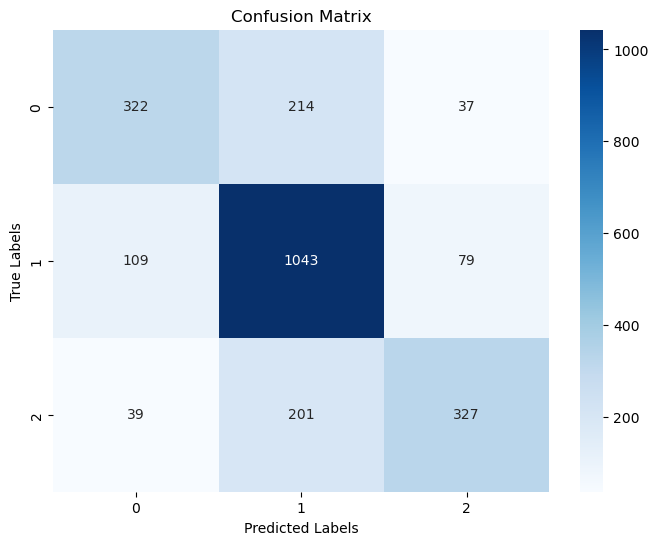

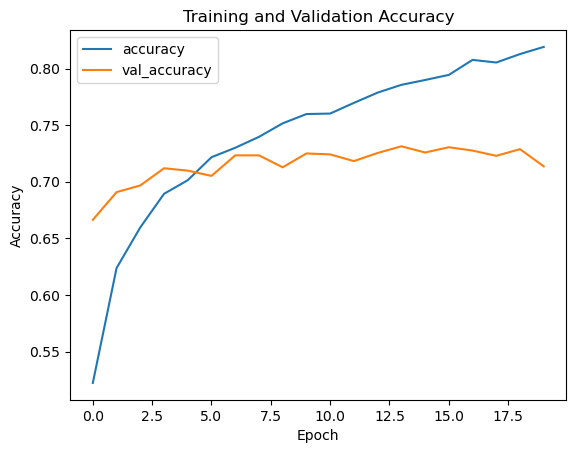

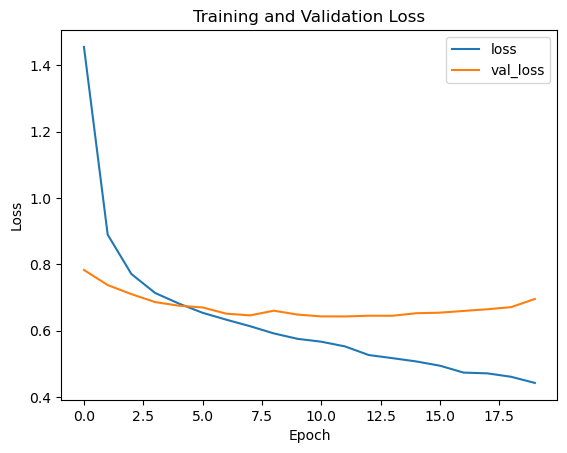

Fold 2
Epoch 1/20
216/216 [==============================] - 2s 7ms/step - loss: 0.4450 - accuracy: 0.8179 - val_loss: 0.6871 - val_accuracy: 0.7153
Epoch 2/20
216/216 [==============================] - 2s 7ms/step - loss: 0.4283 - accuracy: 0.8274 - val_loss: 0.6830 - val_accuracy: 0.7280
Epoch 3/20
216/216 [==============================] - 3s 14ms/step - loss: 0.4220 - accuracy: 0.8287 - val_loss: 0.6956 - val_accuracy: 0.7162
Epoch 4/20
216/216 [==============================] - 3s 13ms/step - loss: 0.4057 - accuracy: 0.8345 - val_loss: 0.6911 - val_accuracy: 0.7263
Epoch 5/20
216/216 [==============================] - 2s 11ms/step - loss: 0.4044 - accuracy: 0.8392 - val_loss: 0.7047 - val_accuracy: 0.7162
Epoch 6/20
216/216 [==============================] - 2s 8ms/step - loss: 0.4012 - accuracy: 0.8395 - val_loss: 0.7032 - val_accuracy: 0.7208
Epoch 7/20
216/216 [==============================] - 3s 12ms/step - loss: 0.3963 - accuracy: 0.8405 - val_loss: 0.7008 - val_accuracy: 0.

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7191058625052721, Validation F1 Score: 0.7149662184122252


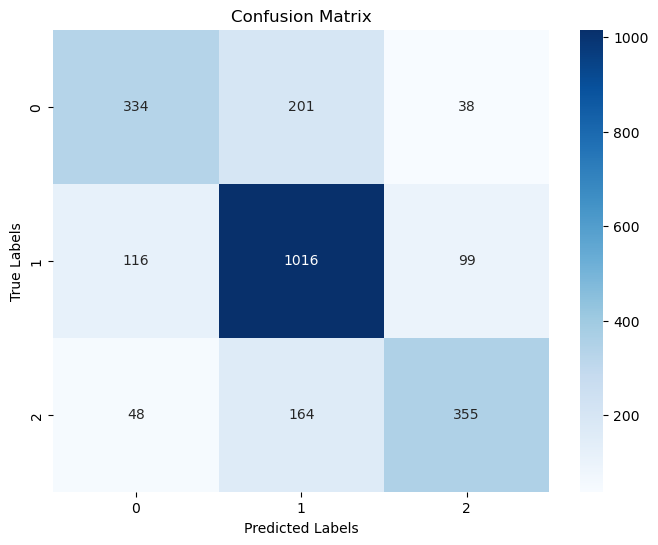

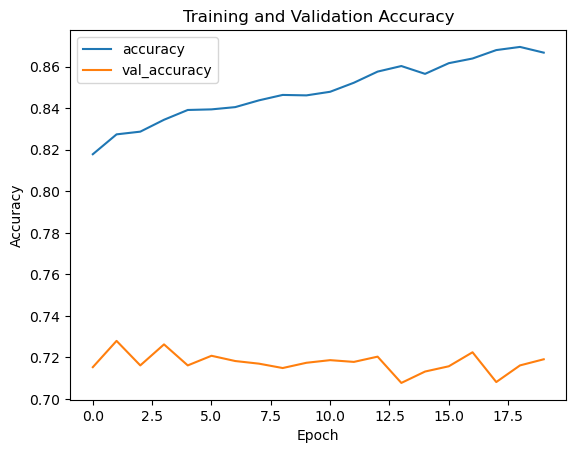

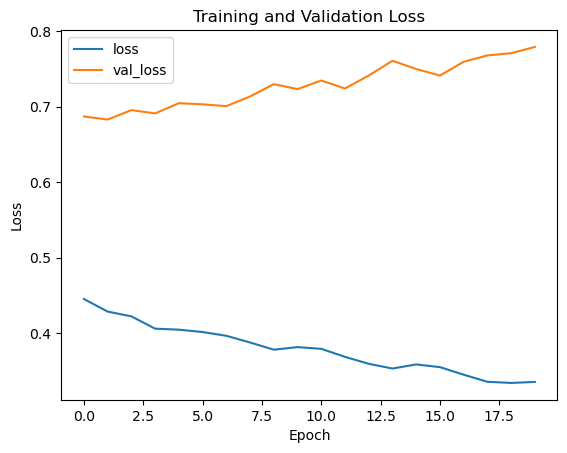

Fold 3
Epoch 1/20
216/216 [==============================] - 2s 7ms/step - loss: 0.3274 - accuracy: 0.8725 - val_loss: 0.7840 - val_accuracy: 0.7174
Epoch 2/20
216/216 [==============================] - 2s 7ms/step - loss: 0.3168 - accuracy: 0.8749 - val_loss: 0.7978 - val_accuracy: 0.7111
Epoch 3/20
216/216 [==============================] - 2s 9ms/step - loss: 0.3207 - accuracy: 0.8765 - val_loss: 0.8173 - val_accuracy: 0.7140
Epoch 4/20
216/216 [==============================] - 2s 11ms/step - loss: 0.3116 - accuracy: 0.8760 - val_loss: 0.8077 - val_accuracy: 0.7136
Epoch 5/20
216/216 [==============================] - 2s 7ms/step - loss: 0.3107 - accuracy: 0.8784 - val_loss: 0.7980 - val_accuracy: 0.7098
Epoch 6/20
216/216 [==============================] - 2s 11ms/step - loss: 0.3066 - accuracy: 0.8803 - val_loss: 0.8270 - val_accuracy: 0.7115
Epoch 7/20
216/216 [==============================] - 3s 13ms/step - loss: 0.3128 - accuracy: 0.8769 - val_loss: 0.7919 - val_accuracy: 0.7

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7207929143821172, Validation F1 Score: 0.7167580410326871


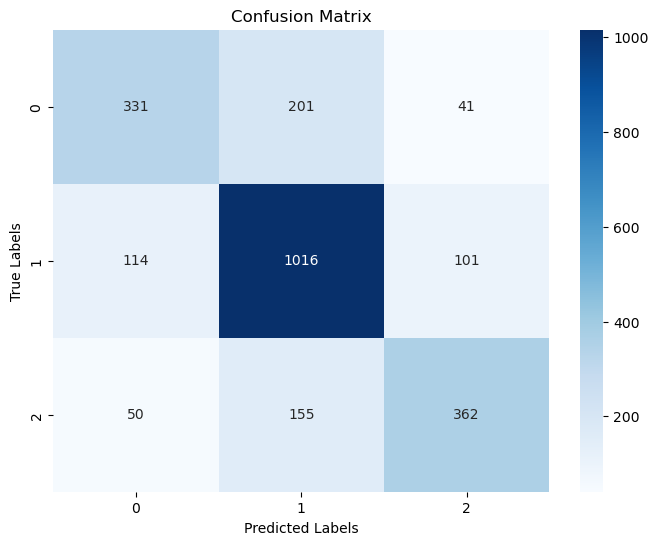

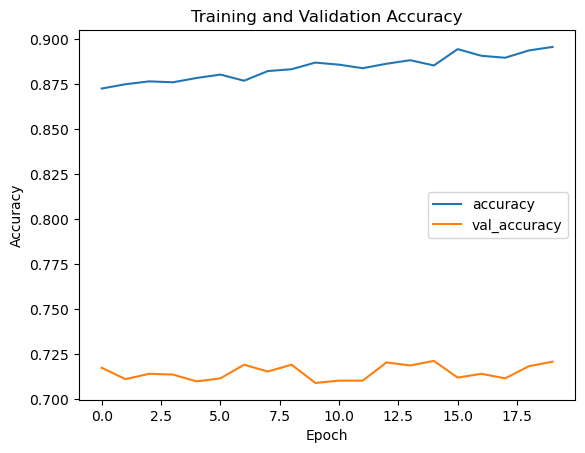

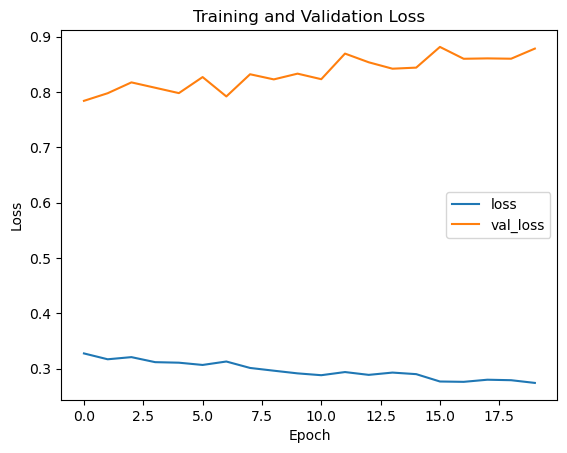

Fold 4
Epoch 1/20
216/216 [==============================] - 1s 7ms/step - loss: 0.2749 - accuracy: 0.8920 - val_loss: 0.8736 - val_accuracy: 0.7140
Epoch 2/20
216/216 [==============================] - 1s 6ms/step - loss: 0.2709 - accuracy: 0.8948 - val_loss: 0.8681 - val_accuracy: 0.7187
Epoch 3/20
216/216 [==============================] - 1s 6ms/step - loss: 0.2706 - accuracy: 0.8958 - val_loss: 0.8853 - val_accuracy: 0.7136
Epoch 4/20
216/216 [==============================] - 1s 6ms/step - loss: 0.2619 - accuracy: 0.9004 - val_loss: 0.8897 - val_accuracy: 0.7136
Epoch 5/20
216/216 [==============================] - 1s 6ms/step - loss: 0.2616 - accuracy: 0.9017 - val_loss: 0.8892 - val_accuracy: 0.7031
Epoch 6/20
216/216 [==============================] - 1s 6ms/step - loss: 0.2684 - accuracy: 0.8953 - val_loss: 0.9038 - val_accuracy: 0.7140
Epoch 7/20
216/216 [==============================] - 1s 6ms/step - loss: 0.2660 - accuracy: 0.8950 - val_loss: 0.8880 - val_accuracy: 0.7229

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7102488401518346, Validation F1 Score: 0.708196733677116


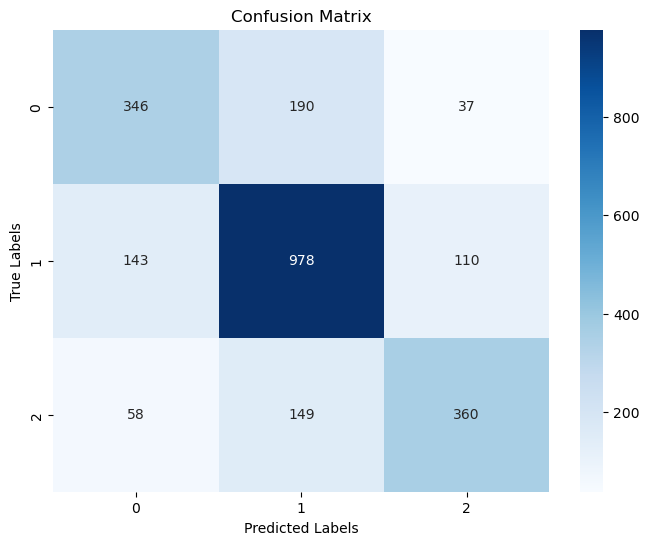

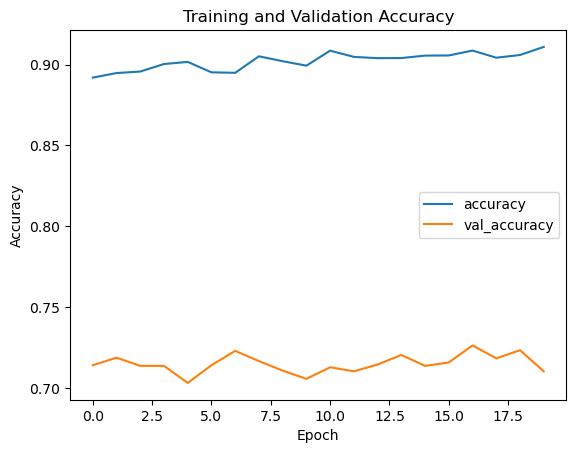

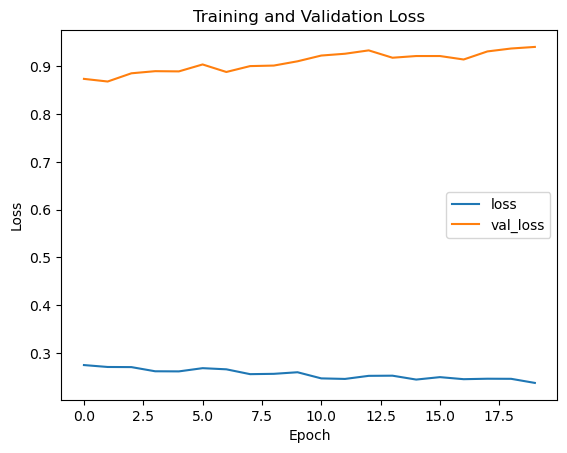

Fold 5
Epoch 1/20
216/216 [==============================] - 1s 7ms/step - loss: 0.2381 - accuracy: 0.9123 - val_loss: 0.9412 - val_accuracy: 0.7128
Epoch 2/20
216/216 [==============================] - 1s 6ms/step - loss: 0.2440 - accuracy: 0.9061 - val_loss: 0.9611 - val_accuracy: 0.7124
Epoch 3/20
216/216 [==============================] - 1s 6ms/step - loss: 0.2358 - accuracy: 0.9109 - val_loss: 0.9619 - val_accuracy: 0.7136
Epoch 4/20
216/216 [==============================] - 1s 6ms/step - loss: 0.2270 - accuracy: 0.9131 - val_loss: 0.9304 - val_accuracy: 0.7086
Epoch 5/20
216/216 [==============================] - 1s 6ms/step - loss: 0.2297 - accuracy: 0.9113 - val_loss: 0.9698 - val_accuracy: 0.7090
Epoch 6/20
216/216 [==============================] - 1s 7ms/step - loss: 0.2230 - accuracy: 0.9156 - val_loss: 0.9821 - val_accuracy: 0.7145
Epoch 7/20
216/216 [==============================] - 1s 7ms/step - loss: 0.2268 - accuracy: 0.9143 - val_loss: 0.9972 - val_accuracy: 0.7145

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7191058625052721, Validation F1 Score: 0.7156010805258382


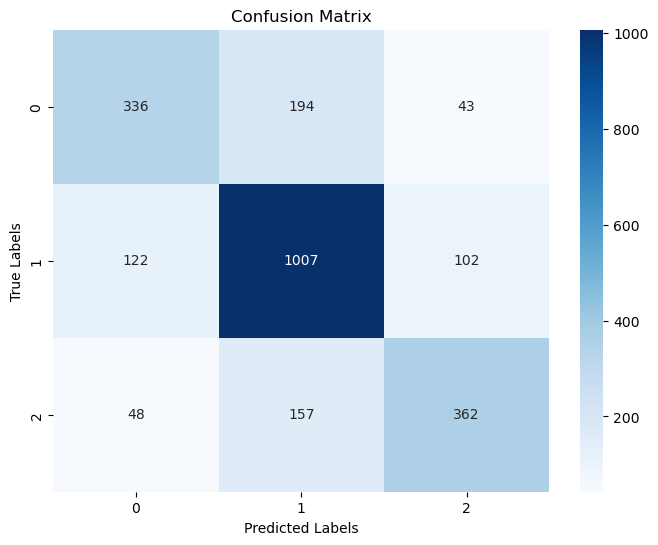

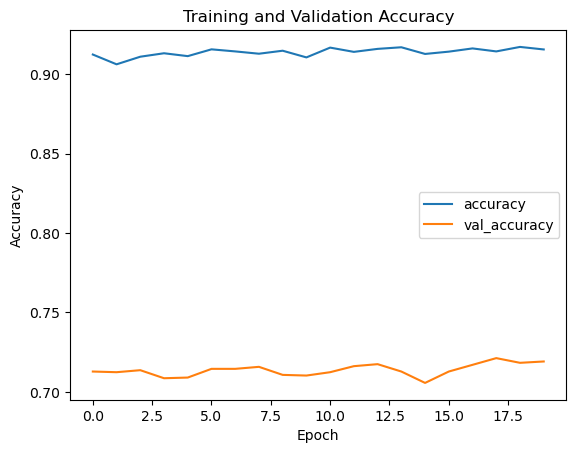

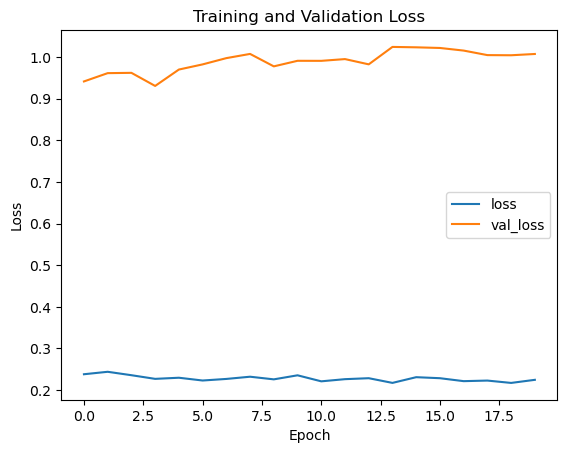

Fold 6
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2226 - accuracy: 0.9159 - val_loss: 1.0148 - val_accuracy: 0.7107
Epoch 2/20
216/216 [==============================] - 2s 9ms/step - loss: 0.2214 - accuracy: 0.9159 - val_loss: 1.0285 - val_accuracy: 0.7119
Epoch 3/20
216/216 [==============================] - 2s 10ms/step - loss: 0.2192 - accuracy: 0.9190 - val_loss: 1.0482 - val_accuracy: 0.7107
Epoch 4/20
216/216 [==============================] - 2s 9ms/step - loss: 0.2188 - accuracy: 0.9176 - val_loss: 1.0078 - val_accuracy: 0.7128
Epoch 5/20
216/216 [==============================] - 2s 8ms/step - loss: 0.2100 - accuracy: 0.9209 - val_loss: 1.0117 - val_accuracy: 0.7128
Epoch 6/20
216/216 [==============================] - 2s 9ms/step - loss: 0.2169 - accuracy: 0.9202 - val_loss: 1.0125 - val_accuracy: 0.7153
Epoch 7/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2101 - accuracy: 0.9201 - val_loss: 1.0285 - val_accuracy: 0.718

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 3ms/step
Validation Accuracy: 0.7115141290594685, Validation F1 Score: 0.7076649645350768


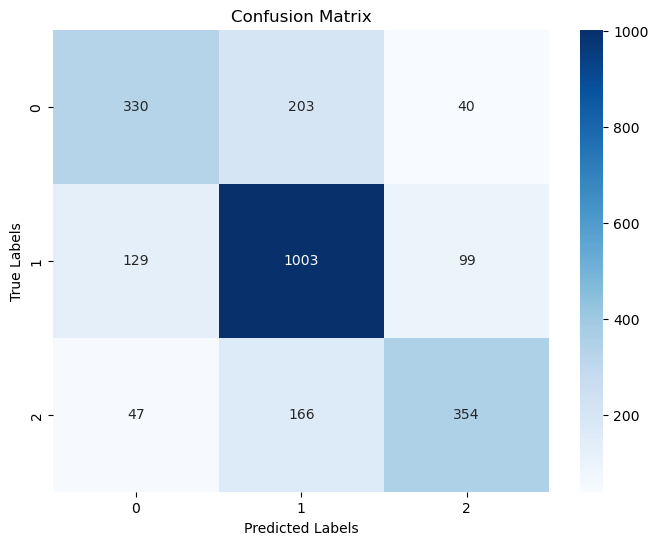

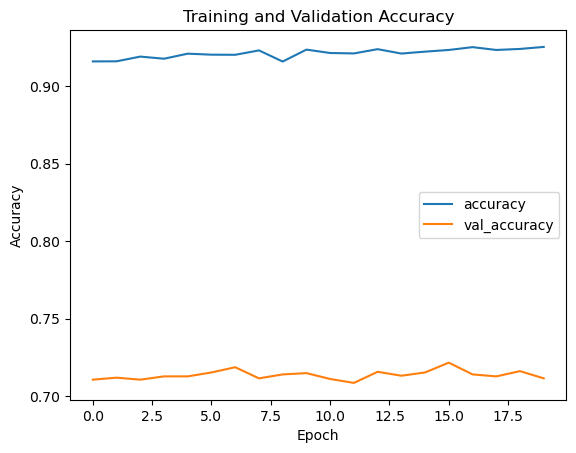

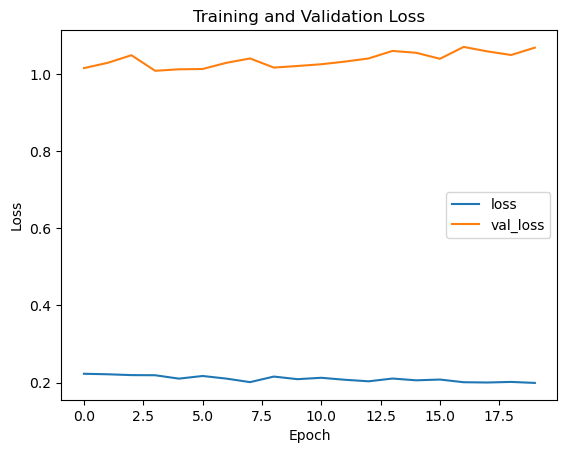

Fold 7
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 0.1980 - accuracy: 0.9239 - val_loss: 1.0838 - val_accuracy: 0.7183
Epoch 2/20
216/216 [==============================] - 2s 7ms/step - loss: 0.1986 - accuracy: 0.9267 - val_loss: 1.0265 - val_accuracy: 0.7149
Epoch 3/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2034 - accuracy: 0.9254 - val_loss: 1.0421 - val_accuracy: 0.7132
Epoch 4/20
216/216 [==============================] - 1s 7ms/step - loss: 0.2091 - accuracy: 0.9218 - val_loss: 1.0450 - val_accuracy: 0.7157
Epoch 5/20
216/216 [==============================] - 2s 7ms/step - loss: 0.1988 - accuracy: 0.9246 - val_loss: 1.0536 - val_accuracy: 0.7098
Epoch 6/20
216/216 [==============================] - 1s 7ms/step - loss: 0.1960 - accuracy: 0.9274 - val_loss: 1.0563 - val_accuracy: 0.7128
Epoch 7/20
216/216 [==============================] - 2s 7ms/step - loss: 0.2023 - accuracy: 0.9243 - val_loss: 1.0676 - val_accuracy: 0.7111

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7123576549978912, Validation F1 Score: 0.7083674853192007


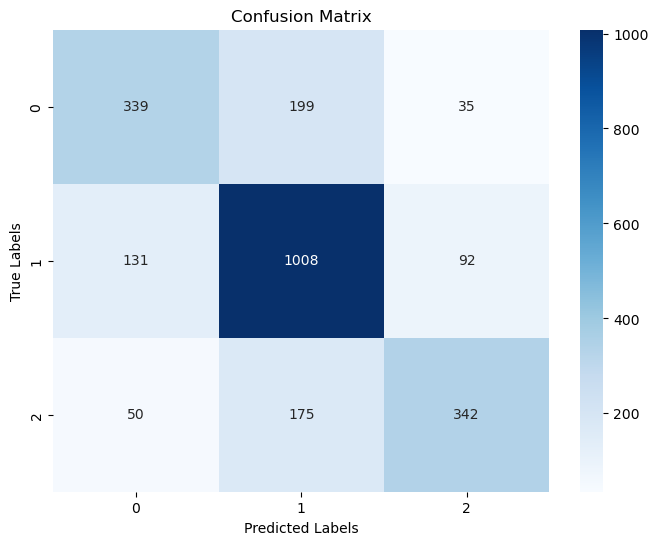

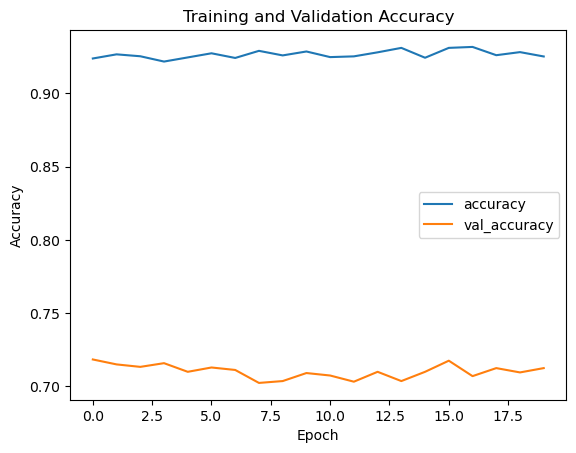

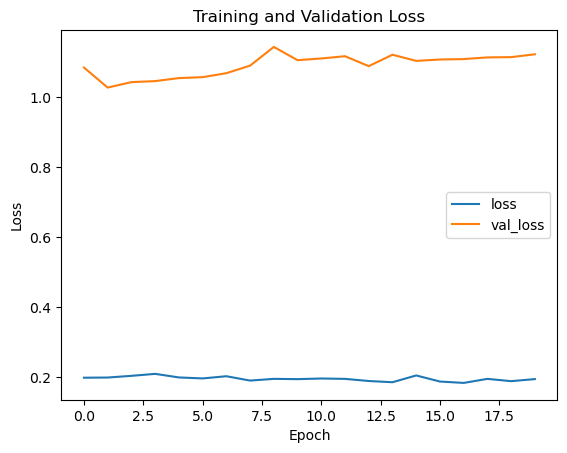

Fold 8
Epoch 1/20
216/216 [==============================] - 1s 7ms/step - loss: 0.1910 - accuracy: 0.9293 - val_loss: 1.0868 - val_accuracy: 0.7081
Epoch 2/20
216/216 [==============================] - 1s 7ms/step - loss: 0.1858 - accuracy: 0.9282 - val_loss: 1.0979 - val_accuracy: 0.7191
Epoch 3/20
216/216 [==============================] - 1s 7ms/step - loss: 0.1873 - accuracy: 0.9268 - val_loss: 1.0849 - val_accuracy: 0.7145
Epoch 4/20
216/216 [==============================] - 1s 7ms/step - loss: 0.1834 - accuracy: 0.9313 - val_loss: 1.1016 - val_accuracy: 0.7128
Epoch 5/20
216/216 [==============================] - 1s 7ms/step - loss: 0.1929 - accuracy: 0.9283 - val_loss: 1.1000 - val_accuracy: 0.7208
Epoch 6/20
216/216 [==============================] - 1s 7ms/step - loss: 0.1904 - accuracy: 0.9290 - val_loss: 1.0924 - val_accuracy: 0.7187
Epoch 7/20
216/216 [==============================] - 2s 7ms/step - loss: 0.1885 - accuracy: 0.9272 - val_loss: 1.1017 - val_accuracy: 0.7170

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.714888232813159, Validation F1 Score: 0.7109286612933037


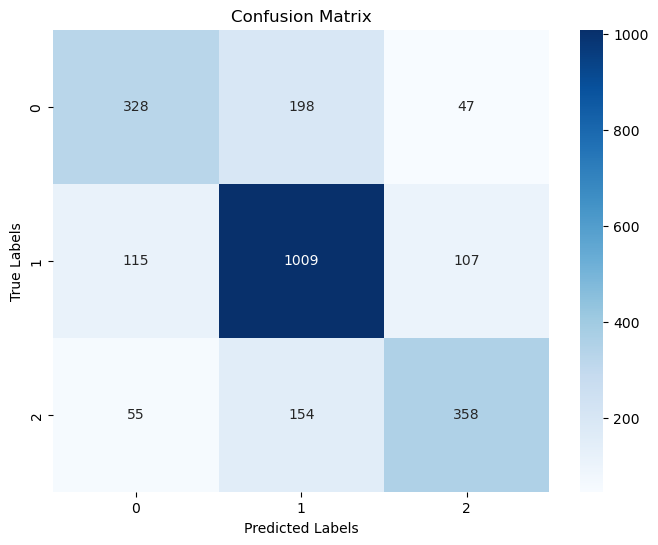

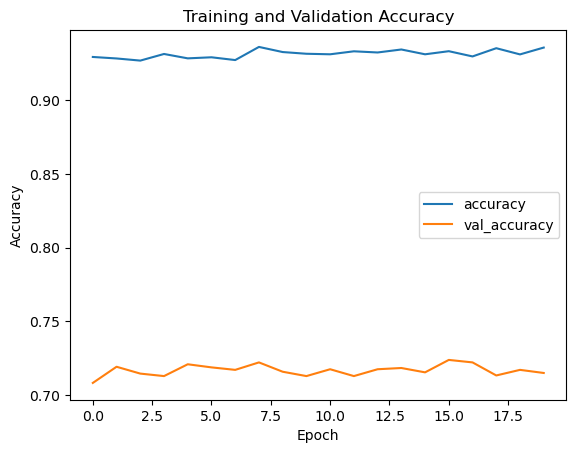

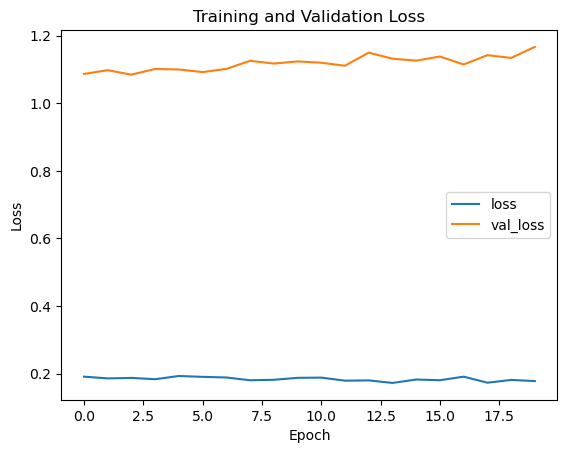

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7152045550400674
Mean F1 Score: 0.7111643215044995
Number of Epochs: 20, Test Size: 0.25, Validation Size: 0.15
Fold 1
Epoch 1/20
203/203 [==============================] - 2s 8ms/step - loss: 1.4533 - accuracy: 0.5184 - val_loss: 0.8374 - val_accuracy: 0.6408
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.9068 - accuracy: 0.6109 - val_loss: 0.7714 - val_accuracy: 0.6608
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.7791 - accuracy: 0.6581 - val_loss: 0.7307 - val_accuracy: 0.6796
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.7249 - accuracy: 0.6807 - val_loss: 0.7135 - val_accuracy: 0.6912
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.6896 - accuracy: 0.7025 - val_loss: 0.6995 - val_accuracy: 0.6999
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.6581 - accuracy: 0.7162 - val_loss: 0.6945 - val_accuracy: 0.6993
Epoch 7/20
2

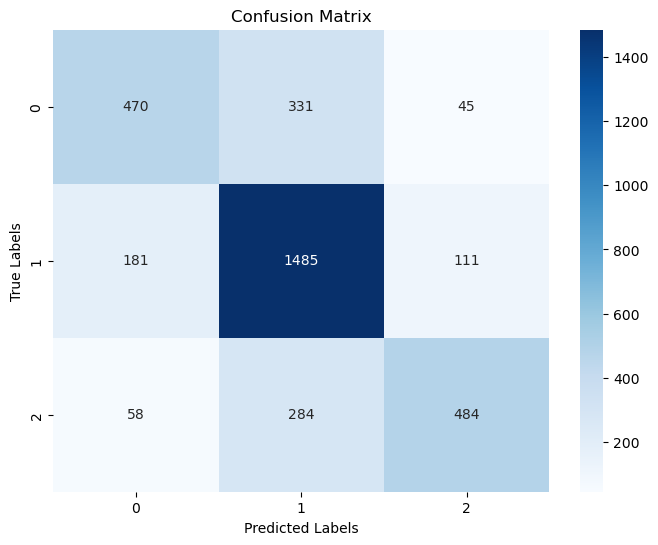

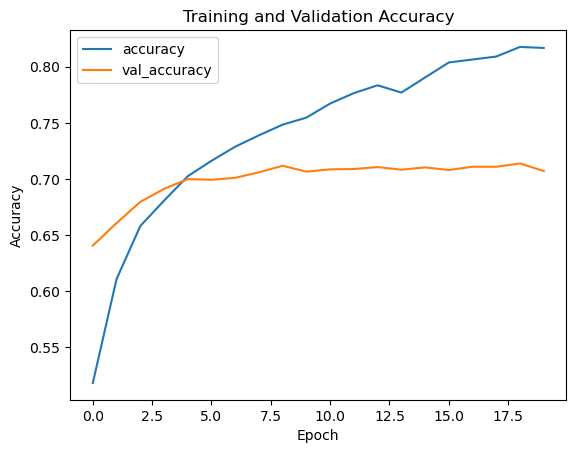

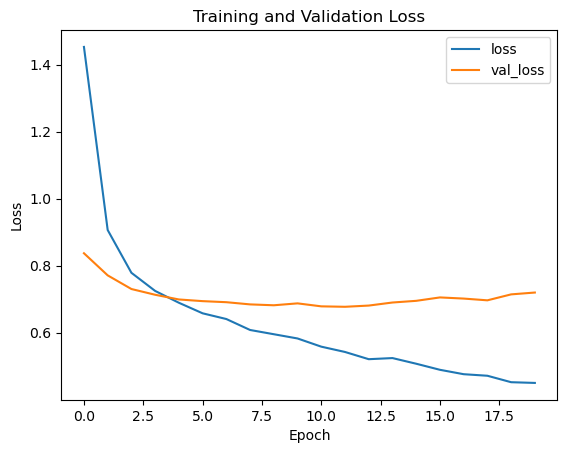

Fold 2
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4408 - accuracy: 0.8199 - val_loss: 0.7186 - val_accuracy: 0.7083
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4360 - accuracy: 0.8260 - val_loss: 0.7232 - val_accuracy: 0.7075
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4098 - accuracy: 0.8346 - val_loss: 0.7421 - val_accuracy: 0.7115
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4164 - accuracy: 0.8309 - val_loss: 0.7373 - val_accuracy: 0.7089
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4046 - accuracy: 0.8414 - val_loss: 0.7550 - val_accuracy: 0.7095
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3918 - accuracy: 0.8451 - val_loss: 0.7493 - val_accuracy: 0.7167
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3968 - accuracy: 0.8361 - val_loss: 0.7480 - val_accuracy: 0.7077

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.706291678747463, Validation F1 Score: 0.700302398618846


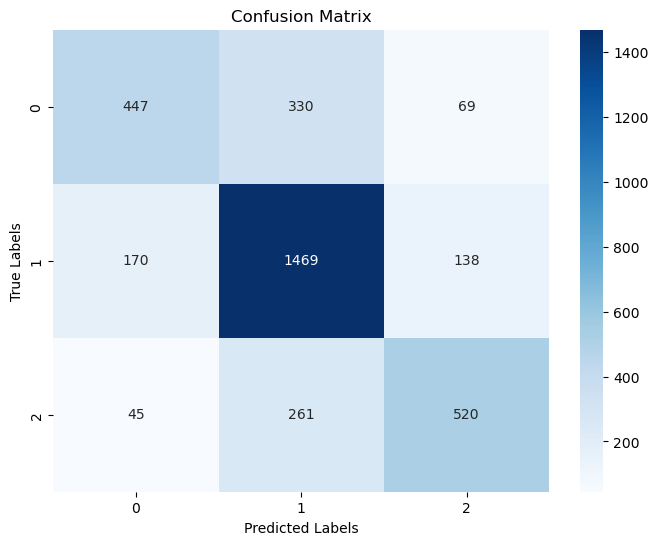

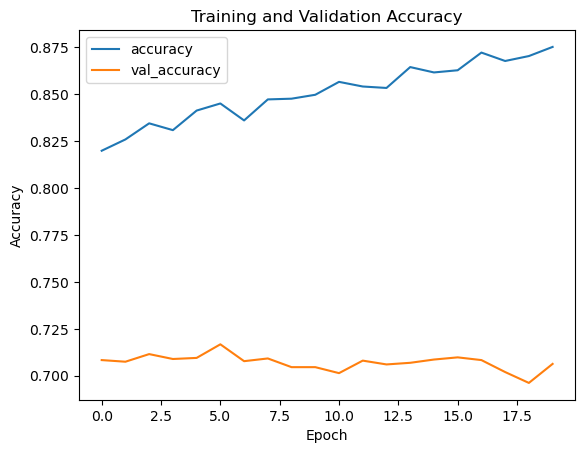

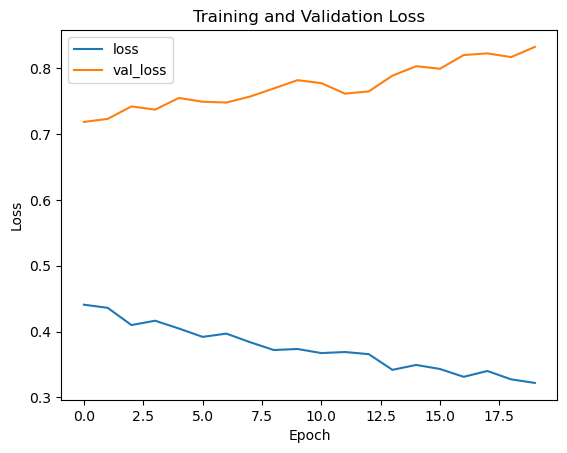

Fold 3
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3201 - accuracy: 0.8751 - val_loss: 0.8484 - val_accuracy: 0.7089
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3127 - accuracy: 0.8754 - val_loss: 0.8397 - val_accuracy: 0.7092
Epoch 3/20
203/203 [==============================] - 2s 8ms/step - loss: 0.3185 - accuracy: 0.8745 - val_loss: 0.8228 - val_accuracy: 0.7051
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3124 - accuracy: 0.8745 - val_loss: 0.8510 - val_accuracy: 0.7075
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3055 - accuracy: 0.8783 - val_loss: 0.8415 - val_accuracy: 0.7072
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2971 - accuracy: 0.8799 - val_loss: 0.8626 - val_accuracy: 0.7031
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2904 - accuracy: 0.8851 - val_loss: 0.8795 - val_accuracy: 0.7051

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.701652652942882, Validation F1 Score: 0.6980825711959773


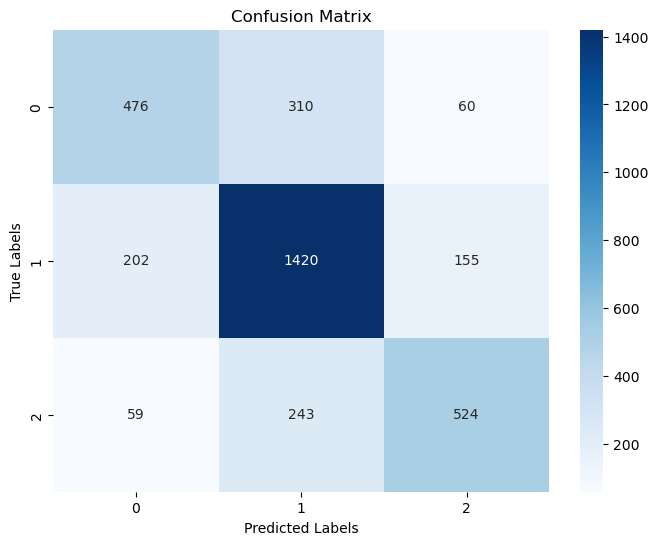

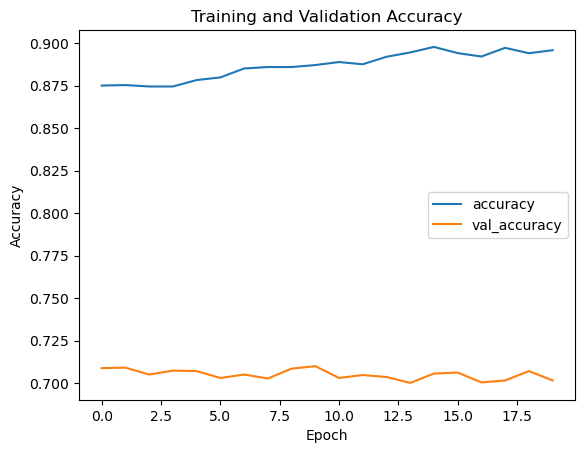

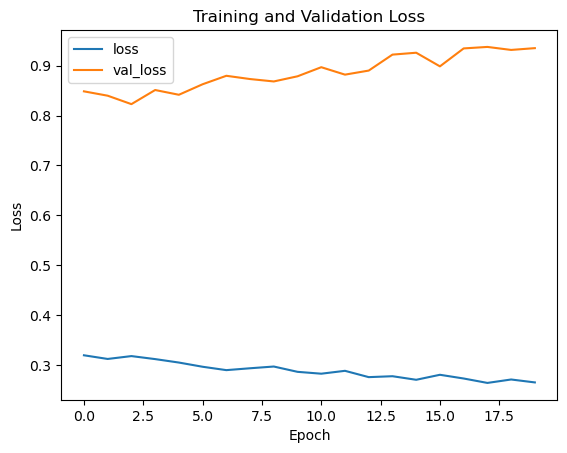

Fold 4
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2744 - accuracy: 0.8917 - val_loss: 0.9308 - val_accuracy: 0.7092
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2739 - accuracy: 0.8959 - val_loss: 0.9535 - val_accuracy: 0.7034
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2623 - accuracy: 0.9004 - val_loss: 0.9620 - val_accuracy: 0.7037
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2529 - accuracy: 0.9029 - val_loss: 0.9566 - val_accuracy: 0.7057
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2580 - accuracy: 0.9017 - val_loss: 0.9686 - val_accuracy: 0.7051
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2486 - accuracy: 0.9048 - val_loss: 0.9799 - val_accuracy: 0.7066
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2496 - accuracy: 0.9029 - val_loss: 0.9910 - val_accuracy: 0.7014

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6984633227022325, Validation F1 Score: 0.6943256514074627


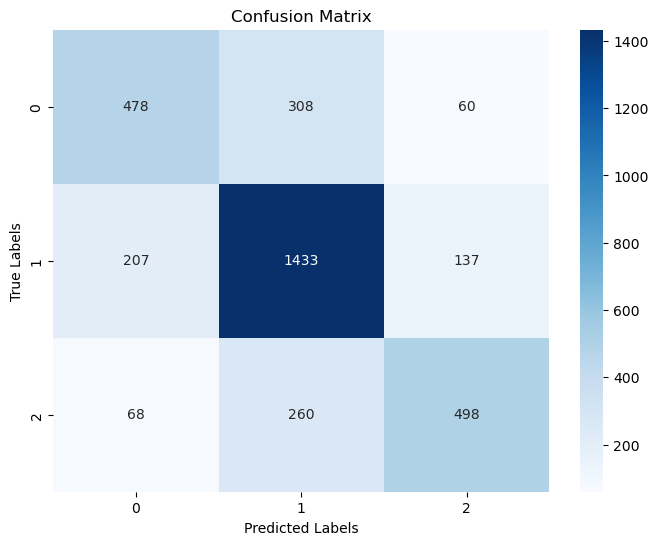

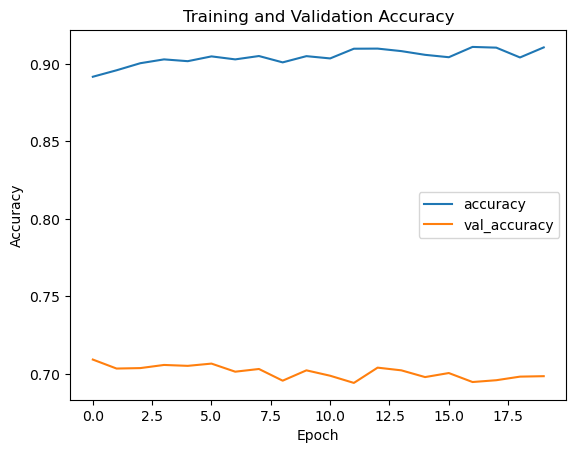

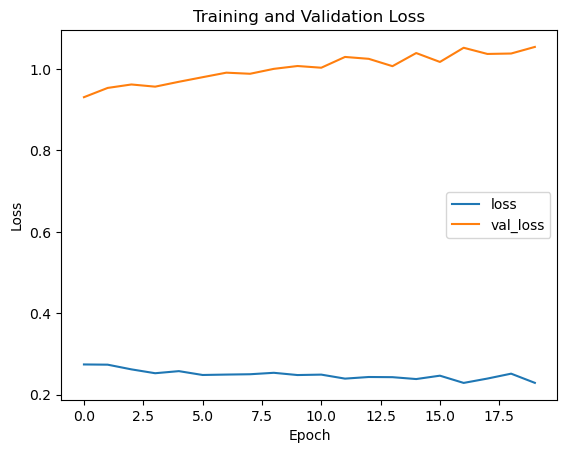

Fold 5
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2366 - accuracy: 0.9089 - val_loss: 1.0749 - val_accuracy: 0.6930
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2339 - accuracy: 0.9094 - val_loss: 1.0612 - val_accuracy: 0.6996
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2315 - accuracy: 0.9125 - val_loss: 1.0470 - val_accuracy: 0.6976
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2260 - accuracy: 0.9147 - val_loss: 1.0714 - val_accuracy: 0.7075
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2128 - accuracy: 0.9188 - val_loss: 1.0704 - val_accuracy: 0.7022
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2223 - accuracy: 0.9154 - val_loss: 1.0904 - val_accuracy: 0.7060
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2246 - accuracy: 0.9157 - val_loss: 1.0644 - val_accuracy: 0.7077

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7100608872136851, Validation F1 Score: 0.7067499281661165


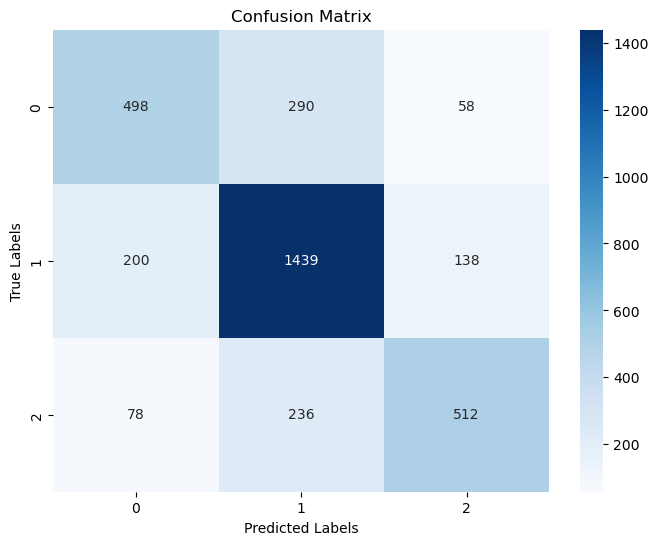

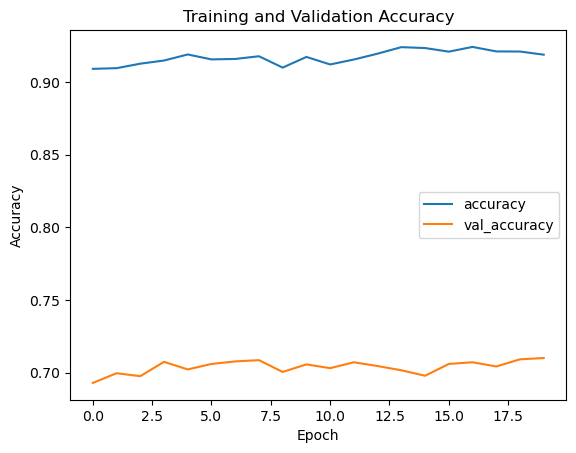

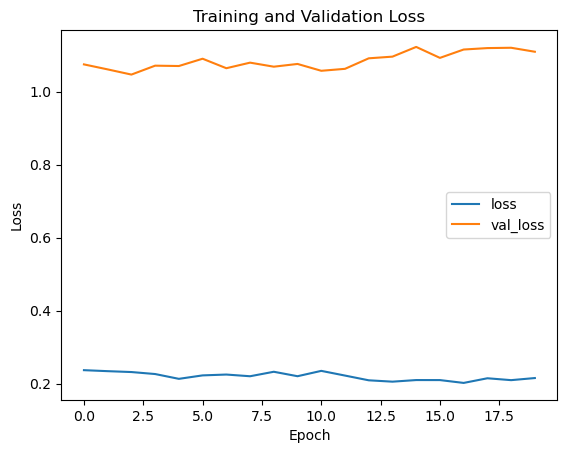

Fold 6
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2132 - accuracy: 0.9183 - val_loss: 1.1150 - val_accuracy: 0.7051
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2045 - accuracy: 0.9246 - val_loss: 1.1112 - val_accuracy: 0.7092
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2084 - accuracy: 0.9201 - val_loss: 1.1384 - val_accuracy: 0.7057
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2005 - accuracy: 0.9242 - val_loss: 1.1635 - val_accuracy: 0.7008
Epoch 5/20
203/203 [==============================] - 2s 8ms/step - loss: 0.2119 - accuracy: 0.9214 - val_loss: 1.1324 - val_accuracy: 0.7031
Epoch 6/20
203/203 [==============================] - 2s 8ms/step - loss: 0.2008 - accuracy: 0.9219 - val_loss: 1.1374 - val_accuracy: 0.7011
Epoch 7/20
203/203 [==============================] - 2s 8ms/step - loss: 0.1993 - accuracy: 0.9247 - val_loss: 1.1262 - val_accuracy: 0.6941

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.706291678747463, Validation F1 Score: 0.7005609816617798


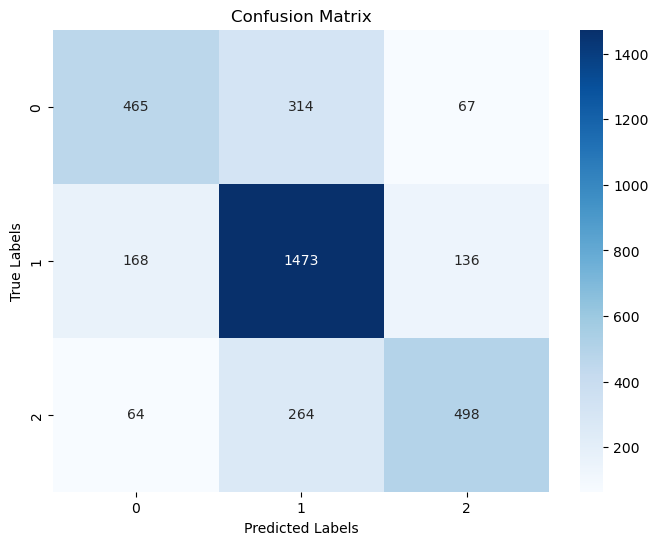

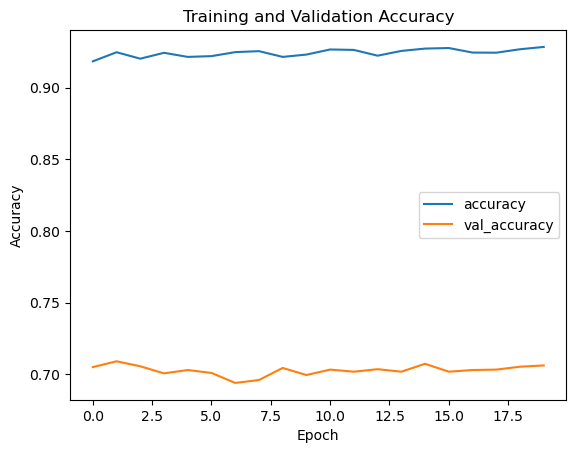

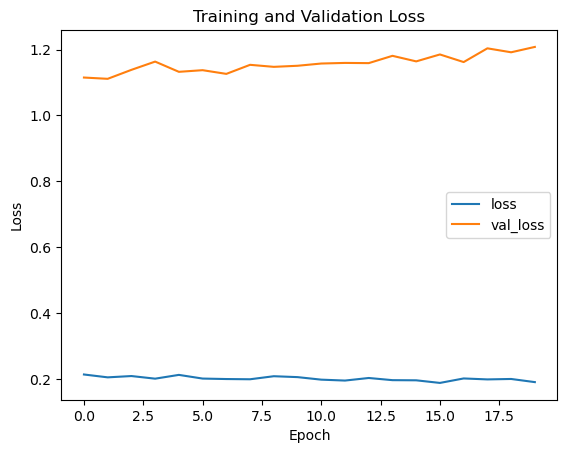

Fold 7
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2035 - accuracy: 0.9235 - val_loss: 1.1923 - val_accuracy: 0.7025
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2001 - accuracy: 0.9265 - val_loss: 1.2122 - val_accuracy: 0.7002
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1935 - accuracy: 0.9259 - val_loss: 1.2159 - val_accuracy: 0.7005
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1870 - accuracy: 0.9273 - val_loss: 1.2034 - val_accuracy: 0.7104
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1891 - accuracy: 0.9313 - val_loss: 1.2153 - val_accuracy: 0.7092
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1892 - accuracy: 0.9296 - val_loss: 1.1902 - val_accuracy: 0.7072
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1875 - accuracy: 0.9296 - val_loss: 1.2131 - val_accuracy: 0.7025

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.697013627138301, Validation F1 Score: 0.6917980166140125


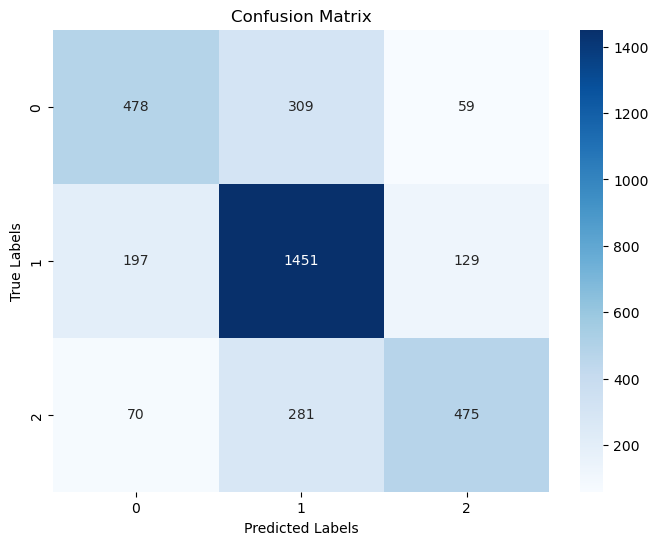

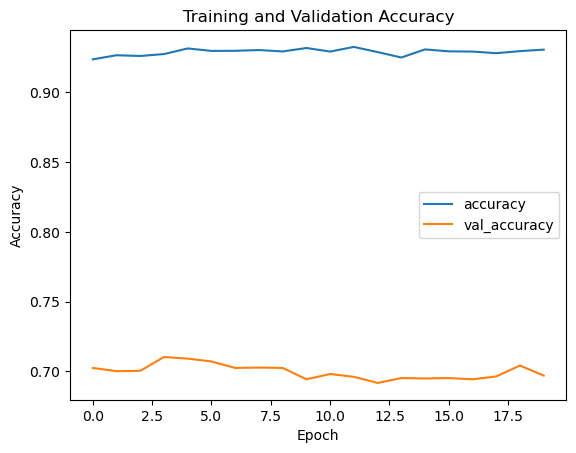

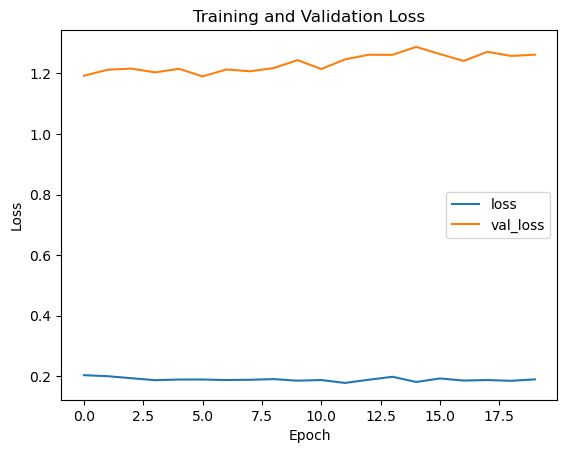

Fold 8
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1786 - accuracy: 0.9360 - val_loss: 1.2624 - val_accuracy: 0.6979
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1774 - accuracy: 0.9367 - val_loss: 1.2488 - val_accuracy: 0.6982
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1774 - accuracy: 0.9325 - val_loss: 1.2661 - val_accuracy: 0.6961
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1812 - accuracy: 0.9321 - val_loss: 1.2708 - val_accuracy: 0.6932
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1984 - accuracy: 0.9267 - val_loss: 1.2585 - val_accuracy: 0.6985
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1858 - accuracy: 0.9281 - val_loss: 1.2747 - val_accuracy: 0.6912
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1750 - accuracy: 0.9341 - val_loss: 1.2783 - val_accuracy: 0.6938

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6958538706871557, Validation F1 Score: 0.6918383270000815


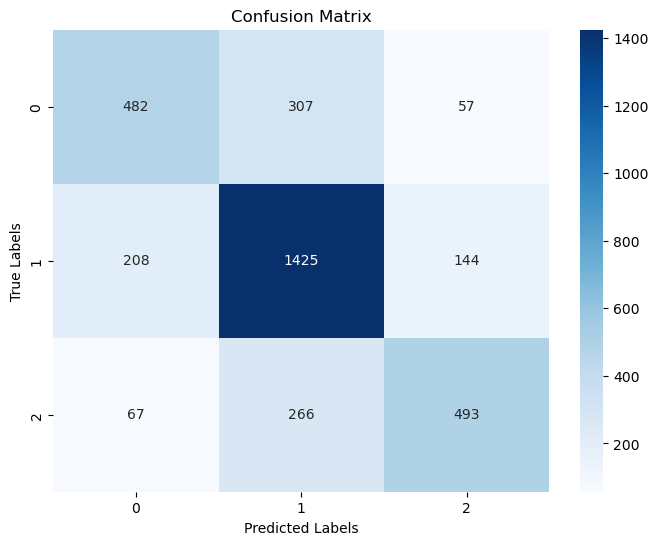

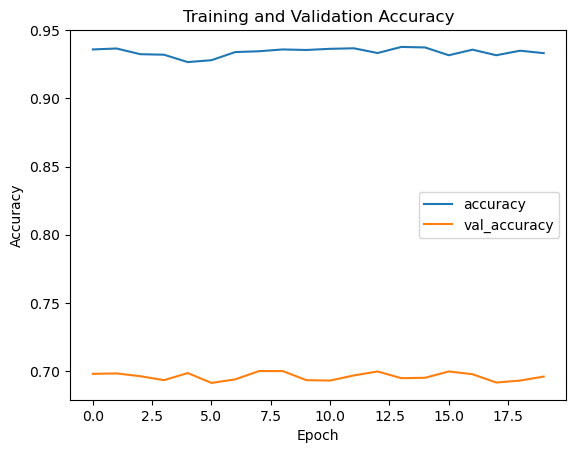

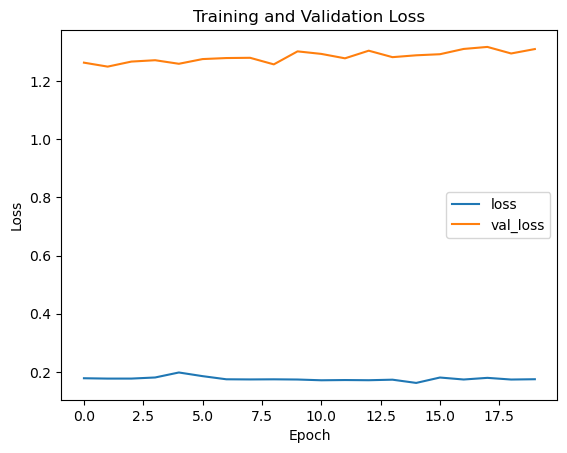

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7028486517831256
Mean F1 Score: 0.6980948898790532
Number of Epochs: 20, Test Size: 0.25, Validation Size: 0.2
Fold 1
Epoch 1/20
203/203 [==============================] - 2s 8ms/step - loss: 1.4759 - accuracy: 0.5245 - val_loss: 0.7897 - val_accuracy: 0.6578
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.9118 - accuracy: 0.6136 - val_loss: 0.7438 - val_accuracy: 0.6771
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.7786 - accuracy: 0.6556 - val_loss: 0.7193 - val_accuracy: 0.6888
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.7208 - accuracy: 0.6827 - val_loss: 0.7272 - val_accuracy: 0.6755
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.6925 - accuracy: 0.6975 - val_loss: 0.6951 - val_accuracy: 0.7002
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.6574 - accuracy: 0.7129 - val_loss: 0.6824 - val_accuracy: 0.7043
Epoch 7/20
20

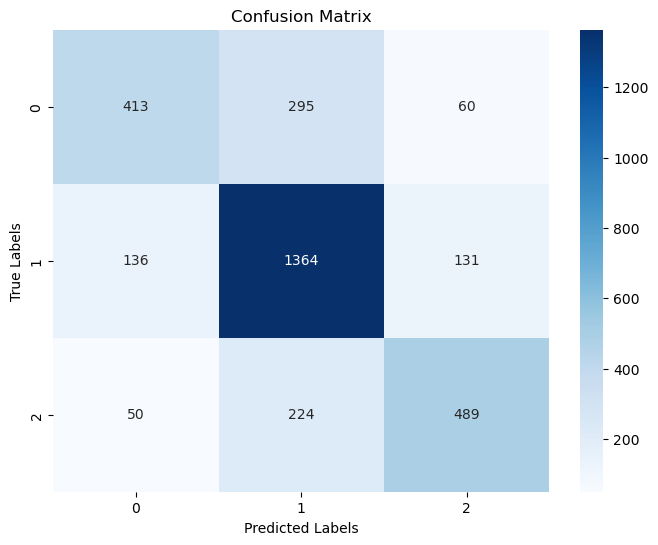

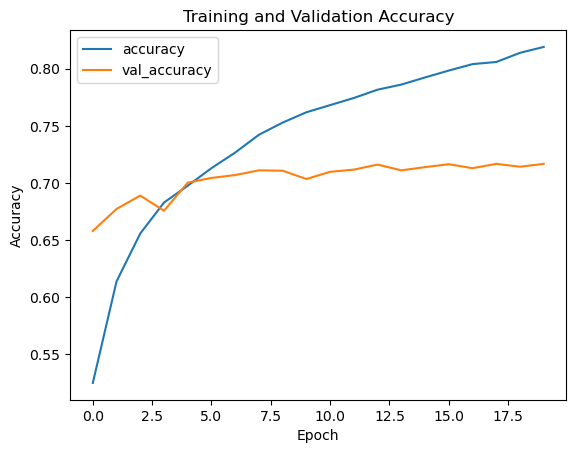

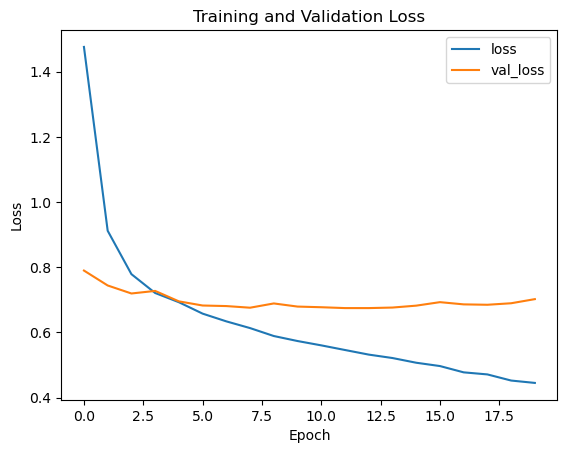

Fold 2
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4273 - accuracy: 0.8269 - val_loss: 0.7143 - val_accuracy: 0.7109
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4333 - accuracy: 0.8215 - val_loss: 0.7088 - val_accuracy: 0.7090
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4228 - accuracy: 0.8291 - val_loss: 0.7105 - val_accuracy: 0.7106
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4154 - accuracy: 0.8311 - val_loss: 0.7235 - val_accuracy: 0.7081
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4018 - accuracy: 0.8343 - val_loss: 0.7231 - val_accuracy: 0.7144
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3919 - accuracy: 0.8433 - val_loss: 0.7347 - val_accuracy: 0.7109
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3825 - accuracy: 0.8493 - val_loss: 0.7367 - val_accuracy: 0.7141

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7093611638203668, Validation F1 Score: 0.703590159212813


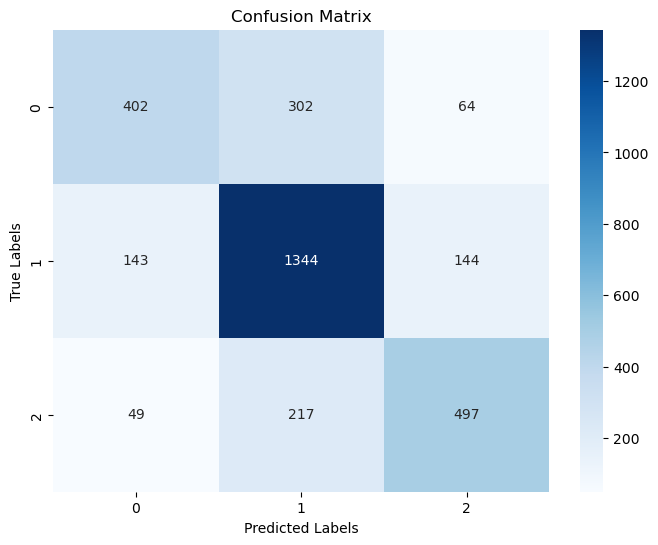

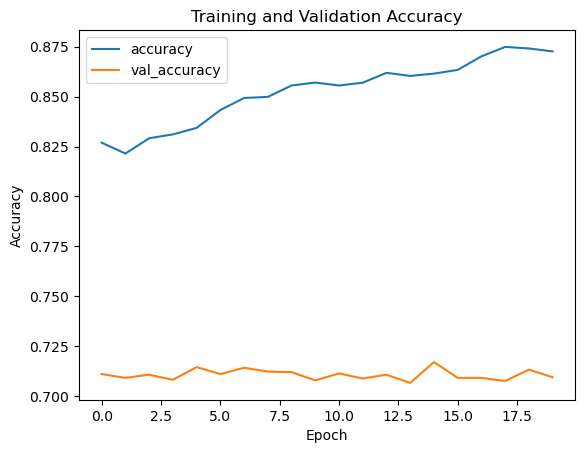

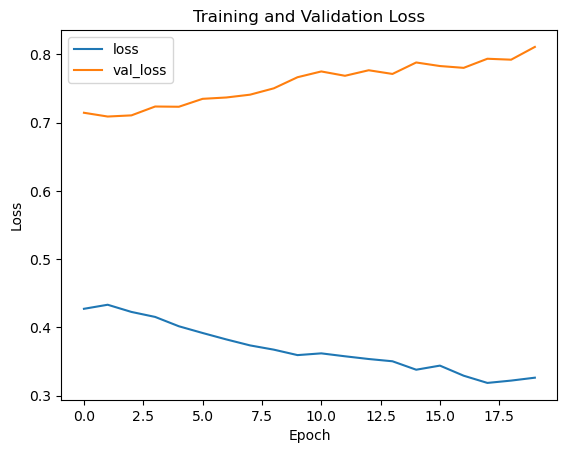

Fold 3
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3114 - accuracy: 0.8748 - val_loss: 0.8064 - val_accuracy: 0.7125
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3121 - accuracy: 0.8760 - val_loss: 0.8187 - val_accuracy: 0.7043
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3094 - accuracy: 0.8761 - val_loss: 0.8431 - val_accuracy: 0.7052
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3015 - accuracy: 0.8823 - val_loss: 0.8368 - val_accuracy: 0.7062
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3050 - accuracy: 0.8795 - val_loss: 0.8482 - val_accuracy: 0.7119
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2997 - accuracy: 0.8812 - val_loss: 0.8569 - val_accuracy: 0.7068
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2881 - accuracy: 0.8864 - val_loss: 0.8573 - val_accuracy: 0.7056

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7033523086654017, Validation F1 Score: 0.7018226848477591


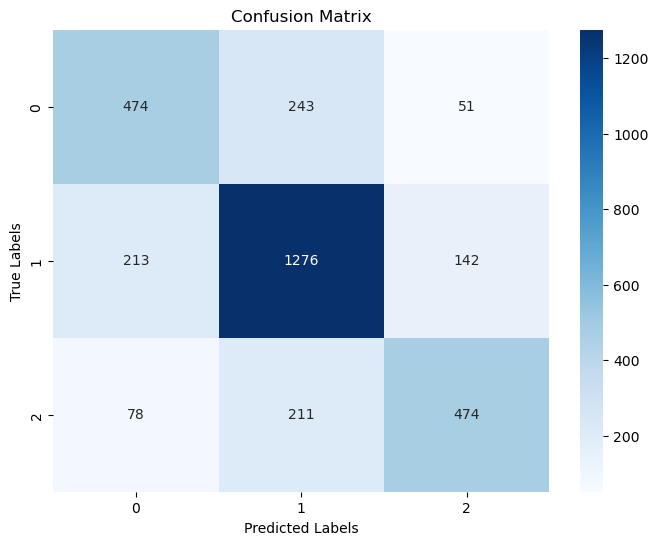

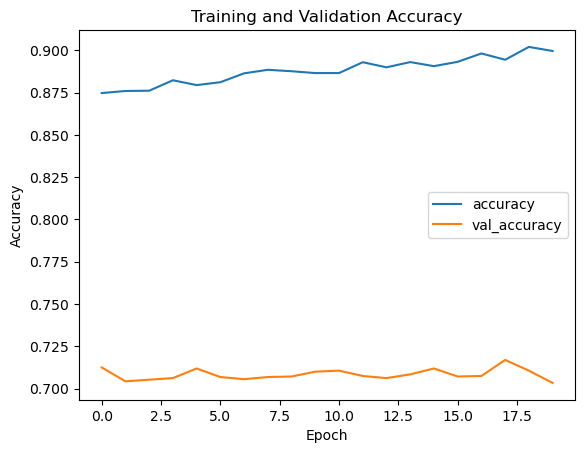

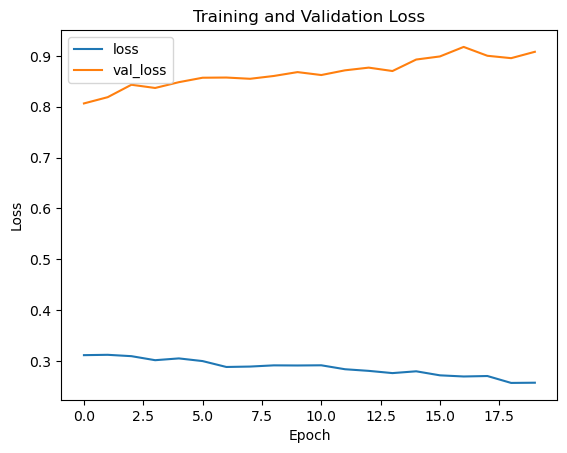

Fold 4
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2609 - accuracy: 0.9010 - val_loss: 0.9148 - val_accuracy: 0.7094
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2550 - accuracy: 0.9014 - val_loss: 0.9272 - val_accuracy: 0.7122
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2641 - accuracy: 0.8996 - val_loss: 0.9189 - val_accuracy: 0.7078
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2599 - accuracy: 0.9022 - val_loss: 0.9273 - val_accuracy: 0.7144
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2586 - accuracy: 0.9021 - val_loss: 0.9271 - val_accuracy: 0.7040
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2550 - accuracy: 0.9035 - val_loss: 0.9496 - val_accuracy: 0.7018
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2562 - accuracy: 0.9000 - val_loss: 0.9405 - val_accuracy: 0.7125

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7030360531309298, Validation F1 Score: 0.7003832104869654


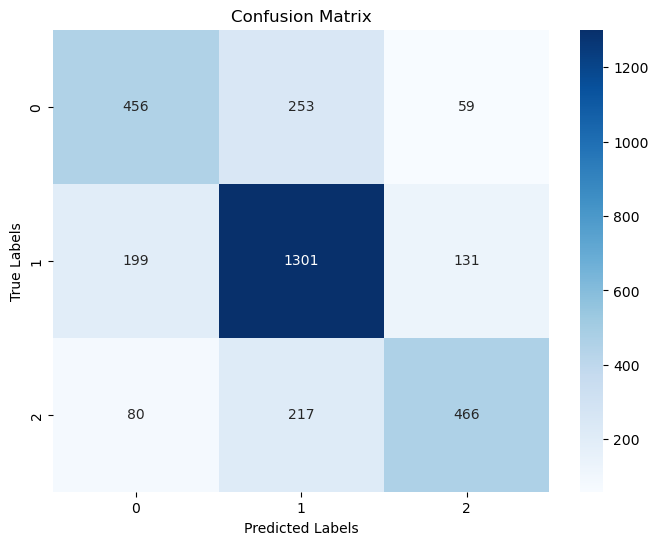

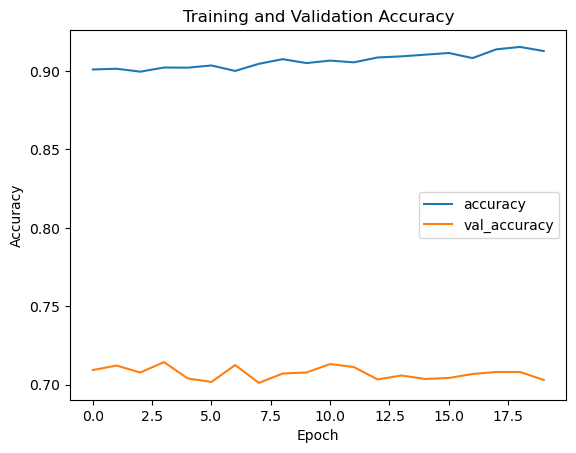

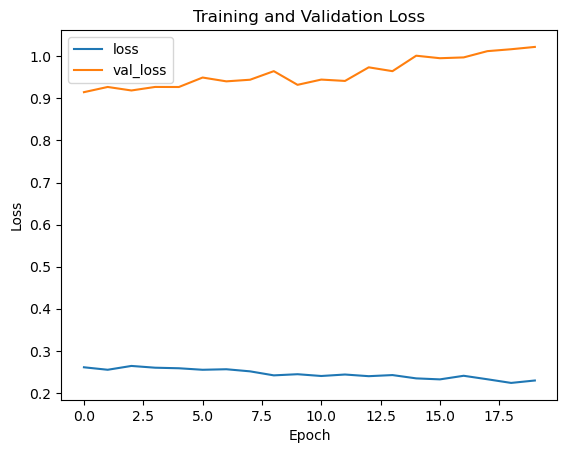

Fold 5
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2254 - accuracy: 0.9131 - val_loss: 1.0096 - val_accuracy: 0.7059
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2242 - accuracy: 0.9160 - val_loss: 1.0187 - val_accuracy: 0.7021
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2215 - accuracy: 0.9140 - val_loss: 1.0440 - val_accuracy: 0.6989
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2302 - accuracy: 0.9126 - val_loss: 1.0567 - val_accuracy: 0.6977
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2259 - accuracy: 0.9108 - val_loss: 1.0469 - val_accuracy: 0.7030
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2253 - accuracy: 0.9131 - val_loss: 1.0436 - val_accuracy: 0.6961
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2222 - accuracy: 0.9174 - val_loss: 1.0493 - val_accuracy: 0.7034

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7017710309930424, Validation F1 Score: 0.696762927890984


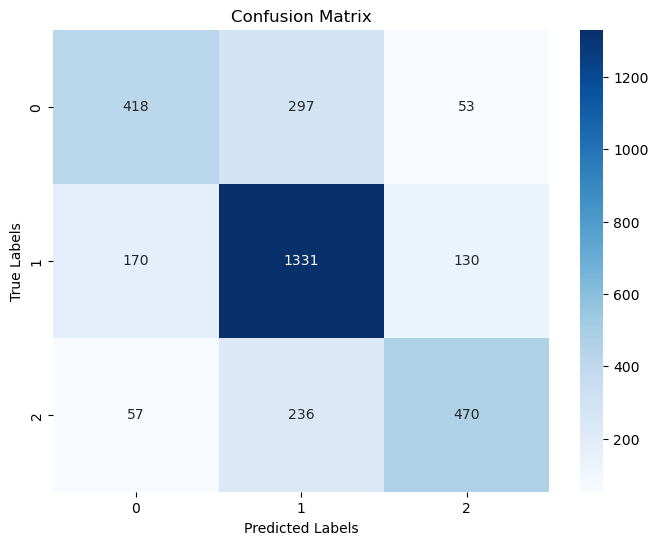

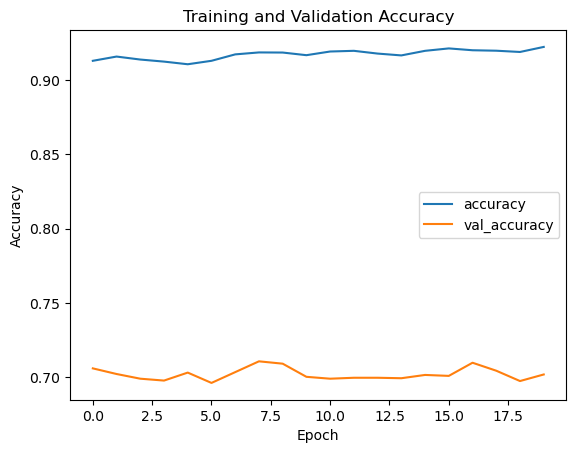

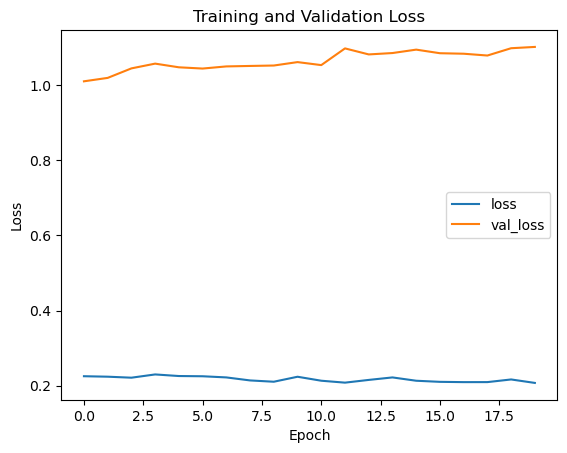

Fold 6
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2088 - accuracy: 0.9228 - val_loss: 1.0862 - val_accuracy: 0.7062
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2088 - accuracy: 0.9181 - val_loss: 1.1052 - val_accuracy: 0.7084
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2011 - accuracy: 0.9232 - val_loss: 1.1043 - val_accuracy: 0.7018
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2079 - accuracy: 0.9234 - val_loss: 1.1163 - val_accuracy: 0.7015
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2050 - accuracy: 0.9244 - val_loss: 1.1158 - val_accuracy: 0.7062
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2132 - accuracy: 0.9189 - val_loss: 1.0928 - val_accuracy: 0.7046
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2028 - accuracy: 0.9215 - val_loss: 1.1084 - val_accuracy: 0.7075

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7058823529411765, Validation F1 Score: 0.7002377473251432


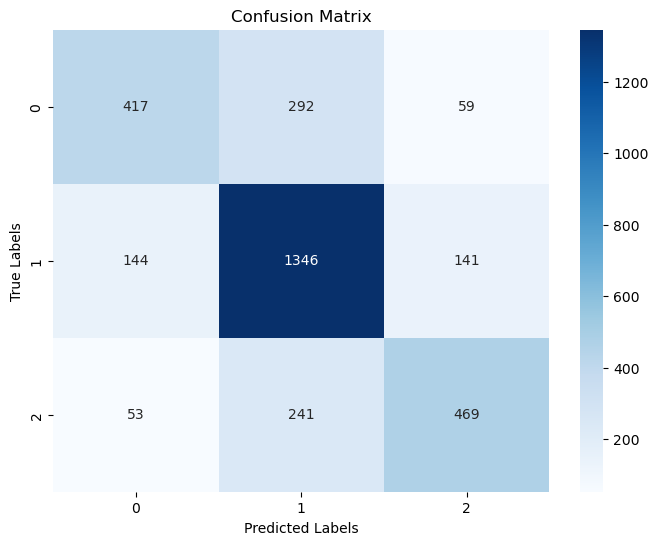

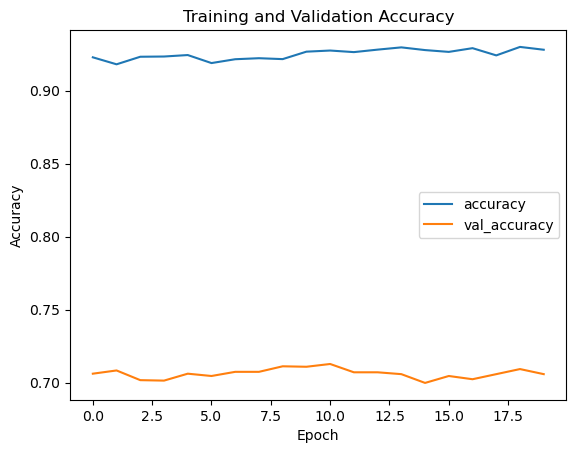

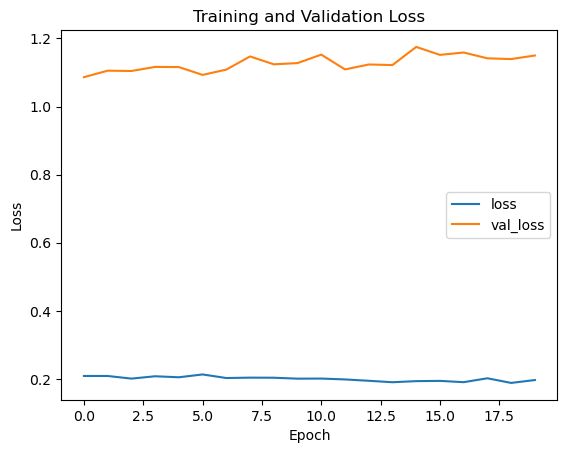

Fold 7
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1900 - accuracy: 0.9305 - val_loss: 1.1586 - val_accuracy: 0.7081
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1910 - accuracy: 0.9300 - val_loss: 1.1756 - val_accuracy: 0.7005
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1834 - accuracy: 0.9303 - val_loss: 1.1801 - val_accuracy: 0.7030
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1805 - accuracy: 0.9313 - val_loss: 1.1715 - val_accuracy: 0.7015
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1895 - accuracy: 0.9314 - val_loss: 1.1671 - val_accuracy: 0.7021
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1949 - accuracy: 0.9258 - val_loss: 1.1621 - val_accuracy: 0.7024
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1856 - accuracy: 0.9314 - val_loss: 1.1719 - val_accuracy: 0.7068

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7001897533206831, Validation F1 Score: 0.6976028844816187


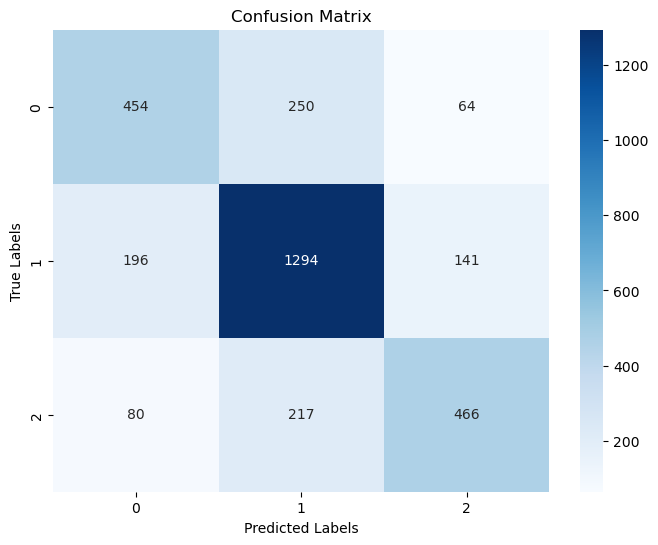

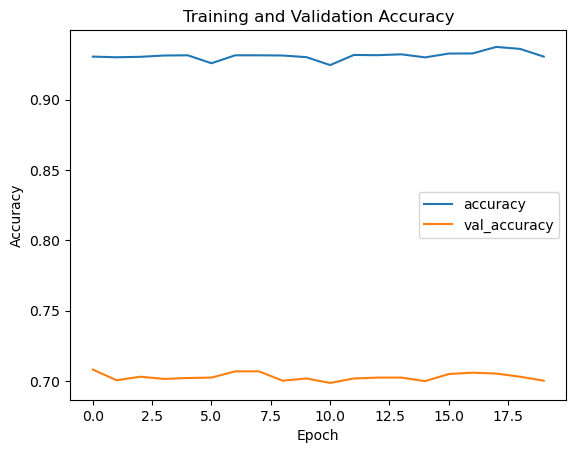

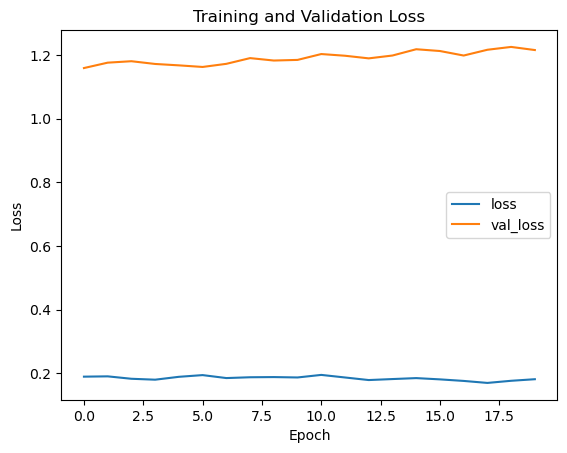

Fold 8
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1698 - accuracy: 0.9356 - val_loss: 1.2246 - val_accuracy: 0.7097
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1816 - accuracy: 0.9358 - val_loss: 1.2074 - val_accuracy: 0.7084
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1838 - accuracy: 0.9324 - val_loss: 1.2001 - val_accuracy: 0.7056
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1806 - accuracy: 0.9337 - val_loss: 1.2215 - val_accuracy: 0.7030
Epoch 5/20
203/203 [==============================] - 2s 8ms/step - loss: 0.1747 - accuracy: 0.9349 - val_loss: 1.2181 - val_accuracy: 0.7068
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1741 - accuracy: 0.9361 - val_loss: 1.2421 - val_accuracy: 0.7090
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1803 - accuracy: 0.9336 - val_loss: 1.2340 - val_accuracy: 0.7056

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7017710309930424, Validation F1 Score: 0.6980673539835914


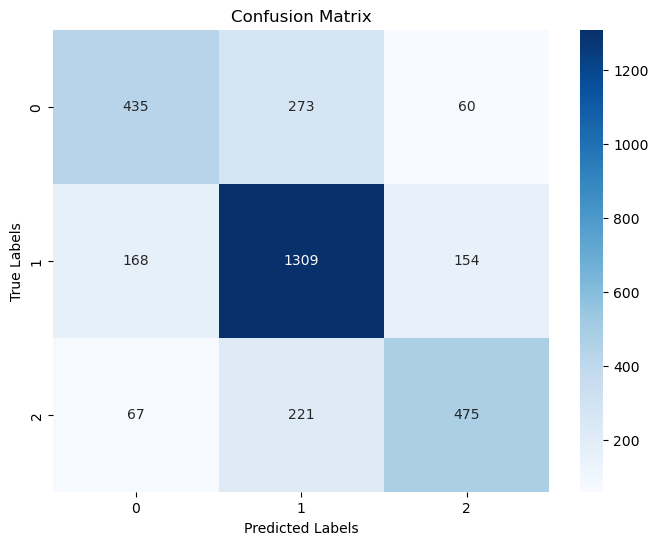

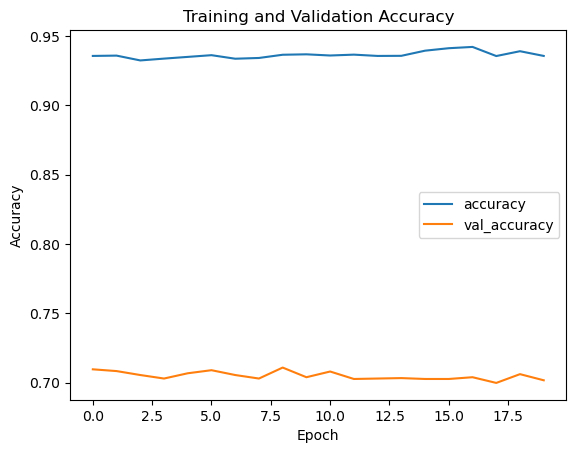

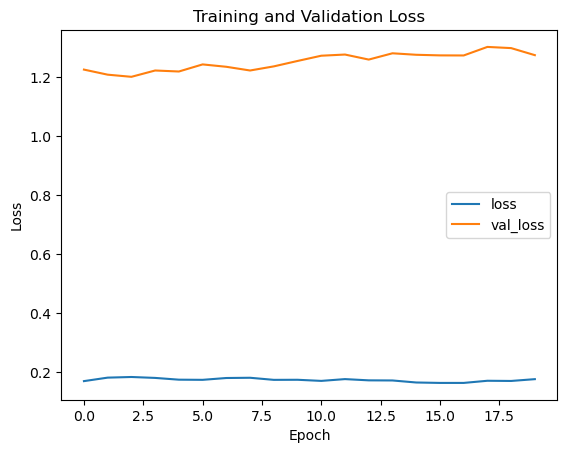

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7052498418722327
Mean F1 Score: 0.7011512160780529
Number of Epochs: 20, Test Size: 0.25, Validation Size: 0.25
Fold 1
Epoch 1/20
203/203 [==============================] - 2s 8ms/step - loss: 1.4776 - accuracy: 0.5210 - val_loss: 0.8260 - val_accuracy: 0.6444
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.9071 - accuracy: 0.6106 - val_loss: 0.7502 - val_accuracy: 0.6663
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.7739 - accuracy: 0.6639 - val_loss: 0.7236 - val_accuracy: 0.6865
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.7239 - accuracy: 0.6808 - val_loss: 0.7019 - val_accuracy: 0.6955
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.6937 - accuracy: 0.6952 - val_loss: 0.6953 - val_accuracy: 0.6942
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.6580 - accuracy: 0.7155 - val_loss: 0.6900 - val_accuracy: 0.6949
Epoch 7/20
2

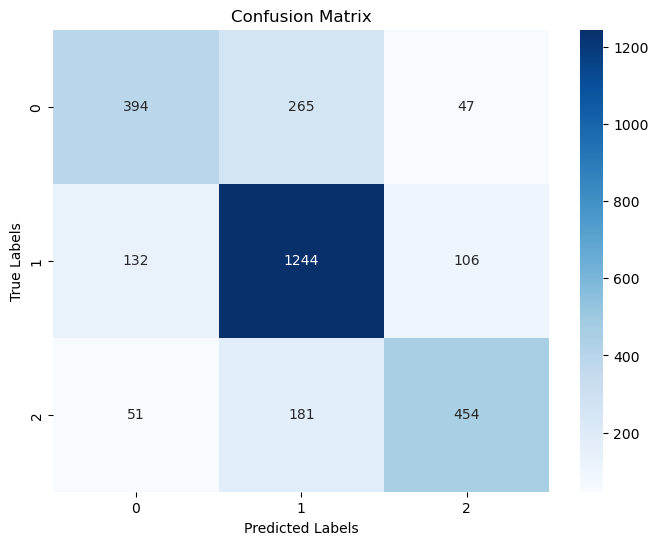

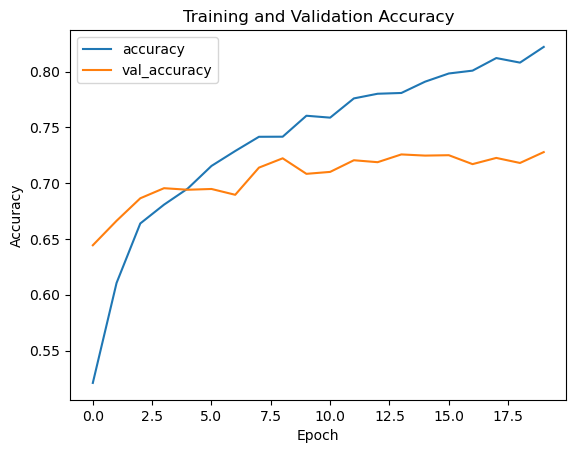

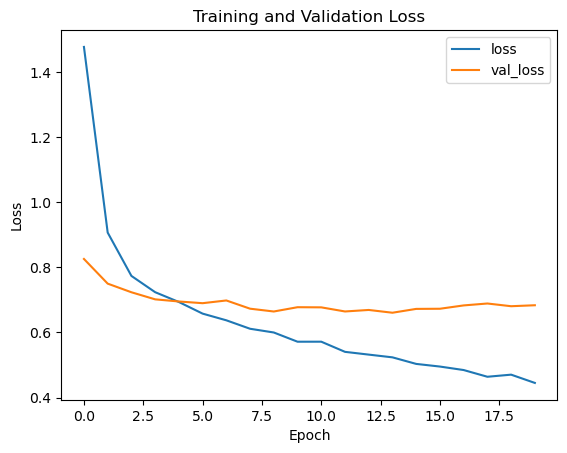

Fold 2
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4451 - accuracy: 0.8179 - val_loss: 0.6893 - val_accuracy: 0.7164
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4193 - accuracy: 0.8286 - val_loss: 0.6998 - val_accuracy: 0.7279
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4237 - accuracy: 0.8290 - val_loss: 0.7037 - val_accuracy: 0.7189
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4171 - accuracy: 0.8319 - val_loss: 0.7006 - val_accuracy: 0.7150
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4031 - accuracy: 0.8401 - val_loss: 0.7018 - val_accuracy: 0.7206
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.4009 - accuracy: 0.8380 - val_loss: 0.7219 - val_accuracy: 0.7203
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3866 - accuracy: 0.8434 - val_loss: 0.7308 - val_accuracy: 0.7203

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7098121085594989, Validation F1 Score: 0.706506834957983


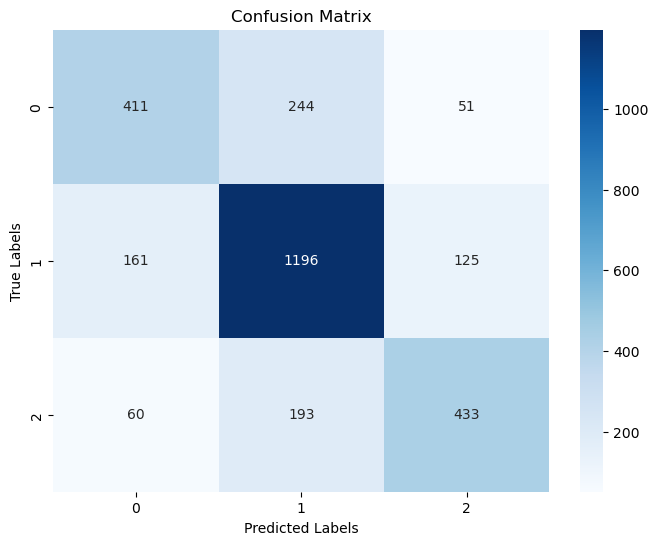

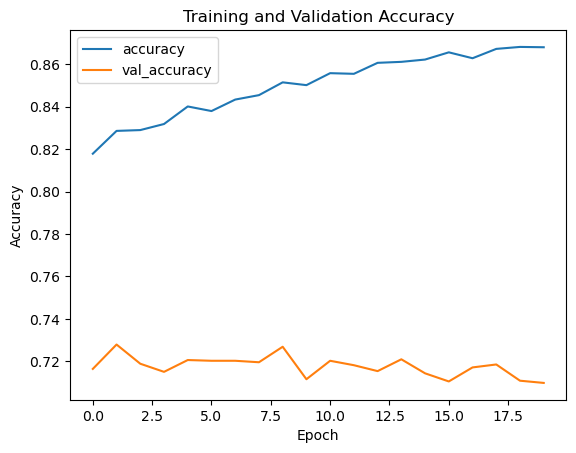

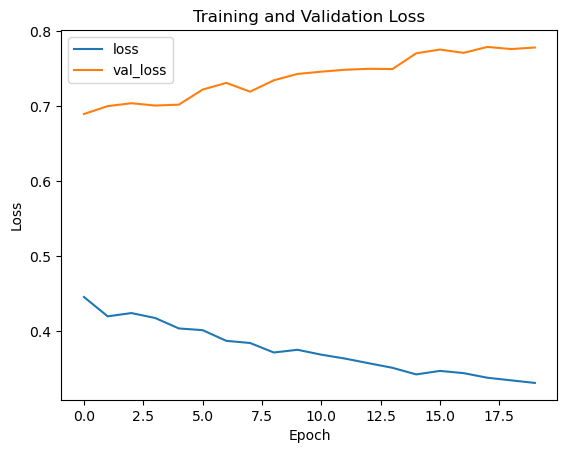

Fold 3
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3143 - accuracy: 0.8748 - val_loss: 0.8064 - val_accuracy: 0.7133
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3163 - accuracy: 0.8755 - val_loss: 0.8069 - val_accuracy: 0.7192
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3184 - accuracy: 0.8762 - val_loss: 0.8081 - val_accuracy: 0.7112
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3097 - accuracy: 0.8782 - val_loss: 0.8146 - val_accuracy: 0.7053
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3051 - accuracy: 0.8828 - val_loss: 0.8096 - val_accuracy: 0.7116
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3004 - accuracy: 0.8807 - val_loss: 0.8262 - val_accuracy: 0.7074
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.3079 - accuracy: 0.8802 - val_loss: 0.8206 - val_accuracy: 0.6983

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7115518441196939, Validation F1 Score: 0.7085934906305057


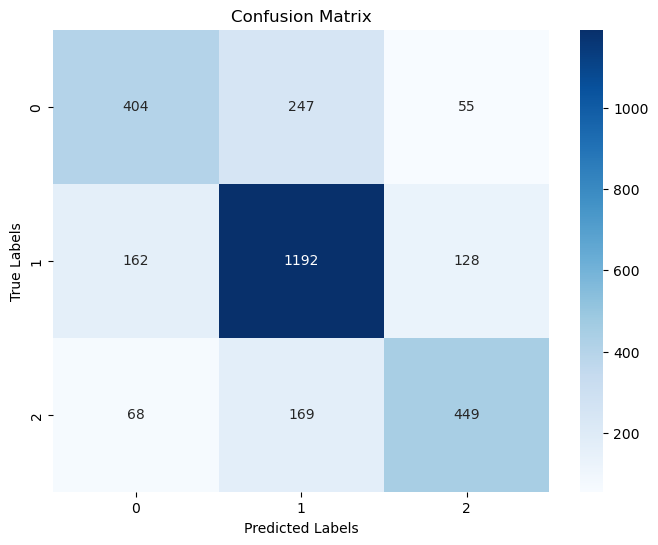

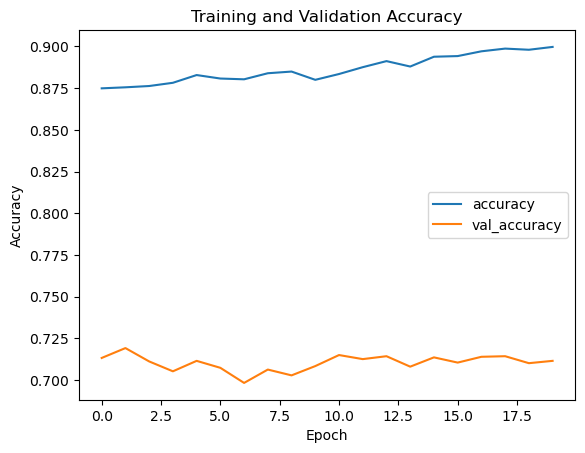

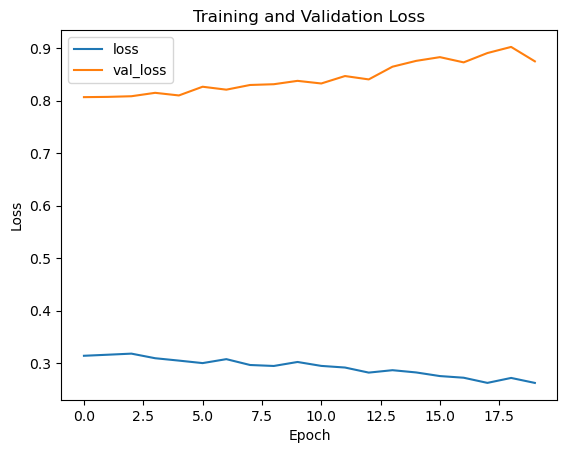

Fold 4
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2568 - accuracy: 0.9019 - val_loss: 0.8738 - val_accuracy: 0.7119
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2611 - accuracy: 0.8993 - val_loss: 0.8938 - val_accuracy: 0.7112
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2682 - accuracy: 0.8956 - val_loss: 0.8862 - val_accuracy: 0.7112
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2651 - accuracy: 0.8952 - val_loss: 0.9084 - val_accuracy: 0.7171
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2526 - accuracy: 0.9026 - val_loss: 0.8946 - val_accuracy: 0.7046
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2496 - accuracy: 0.9051 - val_loss: 0.9102 - val_accuracy: 0.7088
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2600 - accuracy: 0.8992 - val_loss: 0.9066 - val_accuracy: 0.7088

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.708768267223382, Validation F1 Score: 0.7047827923402807


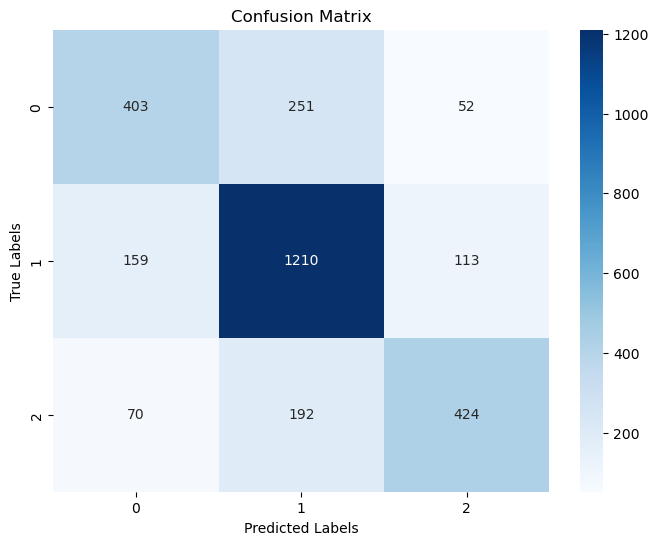

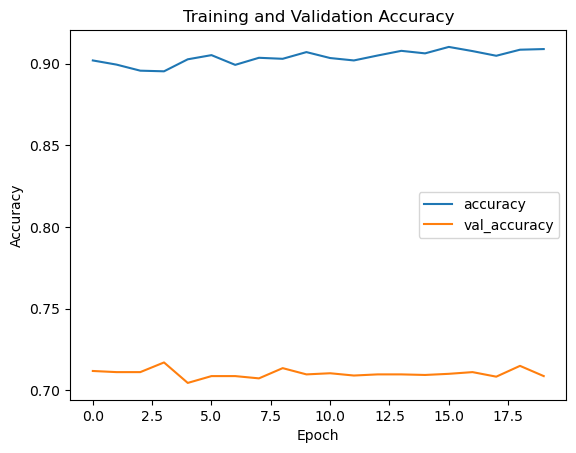

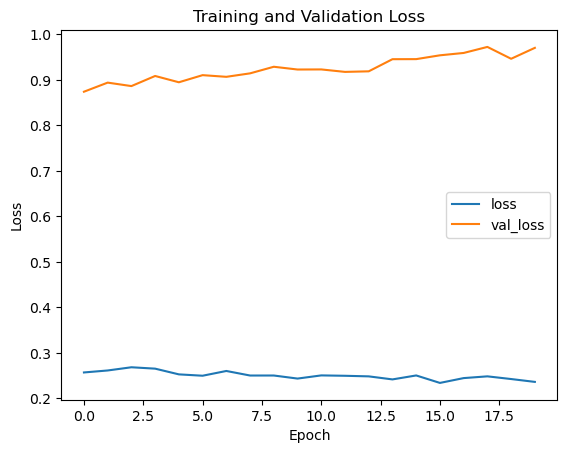

Fold 5
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2399 - accuracy: 0.9054 - val_loss: 0.9575 - val_accuracy: 0.7154
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2214 - accuracy: 0.9152 - val_loss: 0.9832 - val_accuracy: 0.7081
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2291 - accuracy: 0.9103 - val_loss: 0.9797 - val_accuracy: 0.7070
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2249 - accuracy: 0.9131 - val_loss: 0.9824 - val_accuracy: 0.7070
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2250 - accuracy: 0.9112 - val_loss: 1.0150 - val_accuracy: 0.7077
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2238 - accuracy: 0.9146 - val_loss: 0.9946 - val_accuracy: 0.7015
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2424 - accuracy: 0.9085 - val_loss: 0.9925 - val_accuracy: 0.7039

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7129436325678496, Validation F1 Score: 0.707542999276159


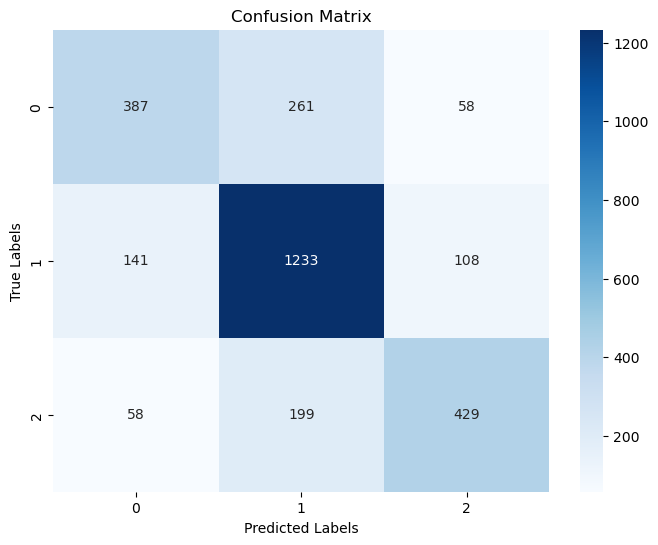

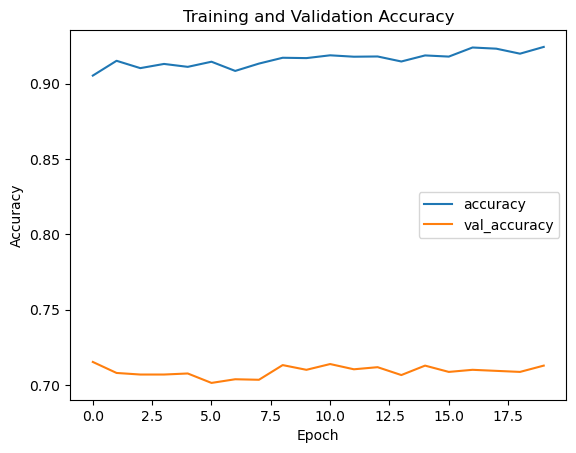

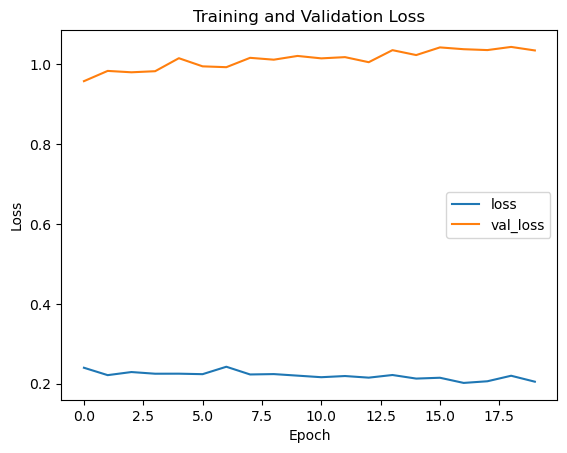

Fold 6
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2065 - accuracy: 0.9228 - val_loss: 1.0367 - val_accuracy: 0.7154
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2061 - accuracy: 0.9204 - val_loss: 1.0729 - val_accuracy: 0.7084
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2111 - accuracy: 0.9210 - val_loss: 1.0588 - val_accuracy: 0.7077
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2058 - accuracy: 0.9204 - val_loss: 1.0652 - val_accuracy: 0.7098
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1994 - accuracy: 0.9242 - val_loss: 1.0538 - val_accuracy: 0.7116
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2121 - accuracy: 0.9194 - val_loss: 1.0673 - val_accuracy: 0.7098
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.2111 - accuracy: 0.9215 - val_loss: 1.0827 - val_accuracy: 0.7063

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7052887961029923, Validation F1 Score: 0.7007789492583344


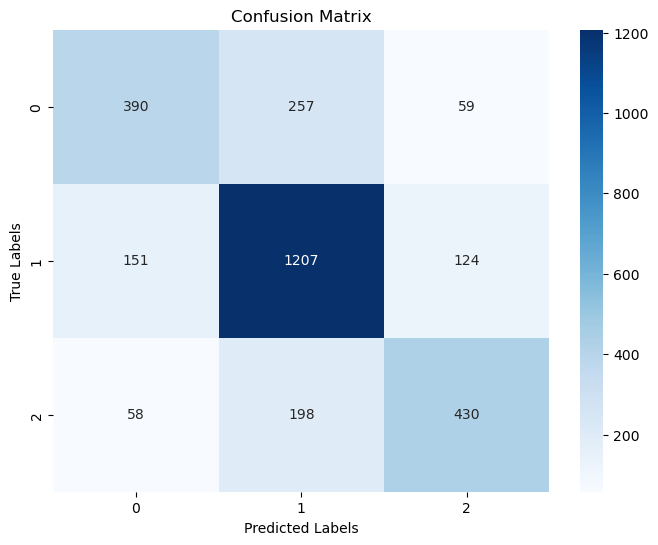

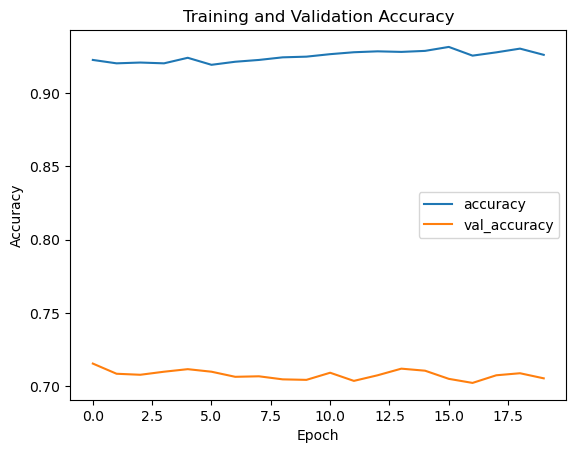

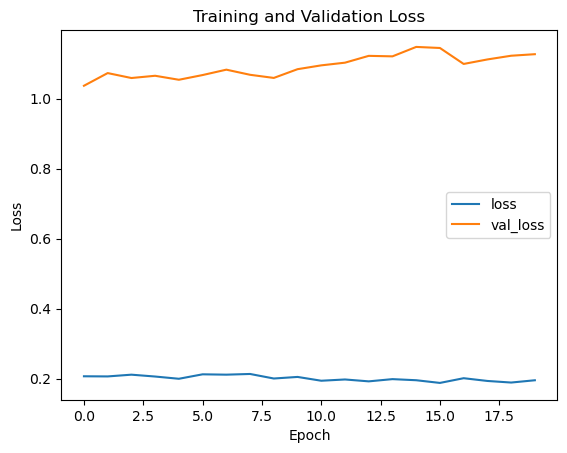

Fold 7
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1933 - accuracy: 0.9279 - val_loss: 1.1149 - val_accuracy: 0.7147
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1893 - accuracy: 0.9296 - val_loss: 1.1314 - val_accuracy: 0.7056
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1934 - accuracy: 0.9290 - val_loss: 1.1239 - val_accuracy: 0.7154
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1893 - accuracy: 0.9313 - val_loss: 1.1461 - val_accuracy: 0.7077
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1914 - accuracy: 0.9273 - val_loss: 1.1450 - val_accuracy: 0.7042
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1943 - accuracy: 0.9268 - val_loss: 1.1588 - val_accuracy: 0.7049
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1915 - accuracy: 0.9283 - val_loss: 1.1513 - val_accuracy: 0.7126

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7052887961029923, Validation F1 Score: 0.6994712683168798


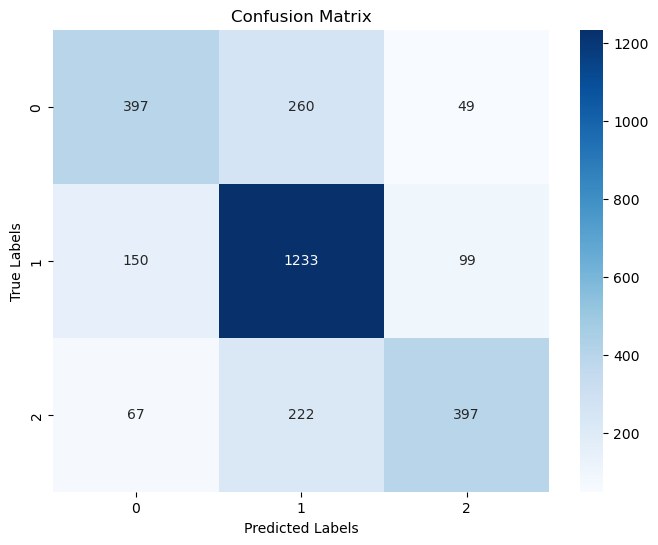

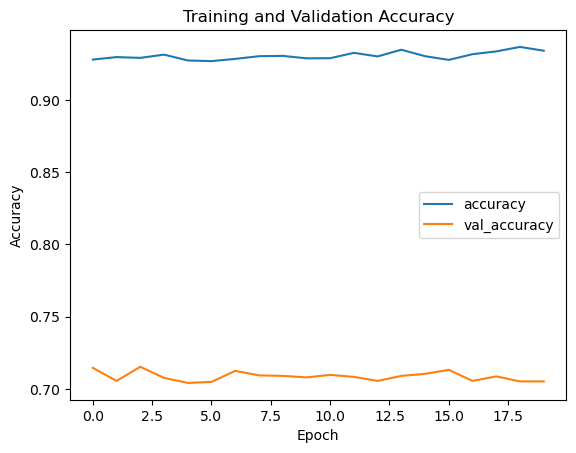

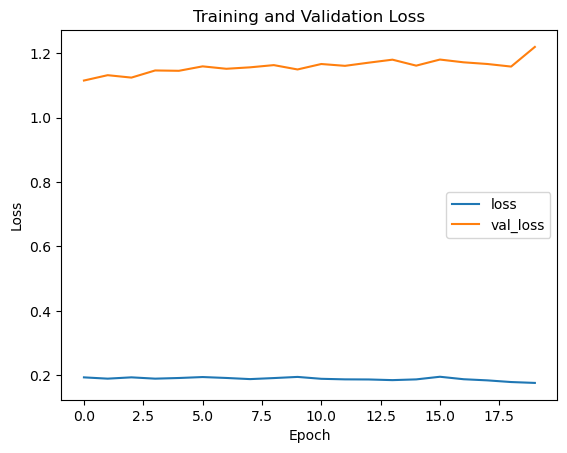

Fold 8
Epoch 1/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1711 - accuracy: 0.9378 - val_loss: 1.2351 - val_accuracy: 0.7105
Epoch 2/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1756 - accuracy: 0.9348 - val_loss: 1.1959 - val_accuracy: 0.7067
Epoch 3/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1791 - accuracy: 0.9338 - val_loss: 1.1916 - val_accuracy: 0.7081
Epoch 4/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1798 - accuracy: 0.9337 - val_loss: 1.2014 - val_accuracy: 0.7074
Epoch 5/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1850 - accuracy: 0.9361 - val_loss: 1.1834 - val_accuracy: 0.7035
Epoch 6/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1822 - accuracy: 0.9321 - val_loss: 1.1886 - val_accuracy: 0.7004
Epoch 7/20
203/203 [==============================] - 1s 7ms/step - loss: 0.1810 - accuracy: 0.9307 - val_loss: 1.2222 - val_accuracy: 0.6997

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6969380654140571, Validation F1 Score: 0.6915377065928175


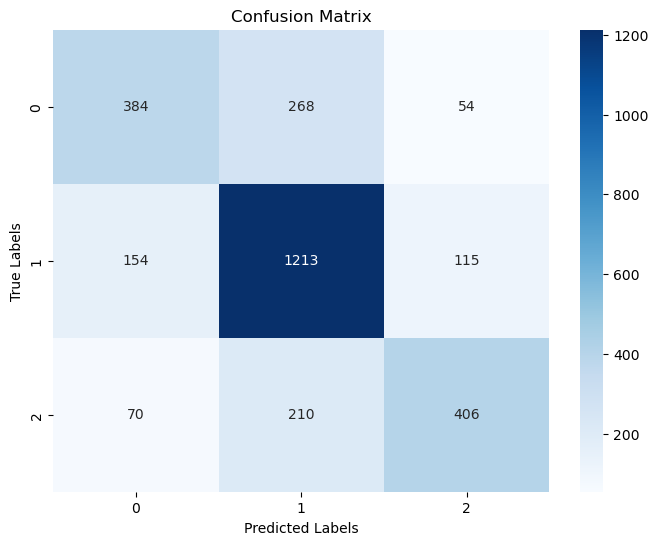

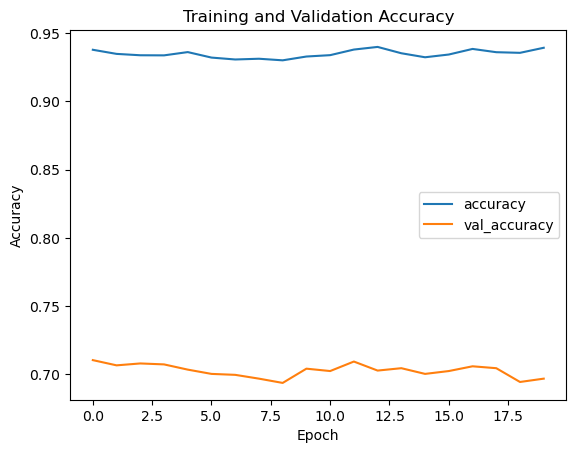

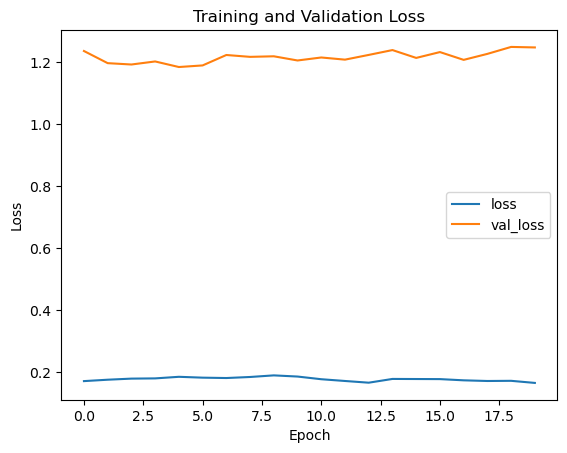

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.709812108559499
Mean F1 Score: 0.7052714397077577
Number of Epochs: 50, Test Size: 0.15, Validation Size: 0.15
Fold 1
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 1.4367 - accuracy: 0.5298 - val_loss: 0.8007 - val_accuracy: 0.6649
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.9053 - accuracy: 0.6114 - val_loss: 0.7410 - val_accuracy: 0.6800
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.7652 - accuracy: 0.6611 - val_loss: 0.7028 - val_accuracy: 0.6964
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.7125 - accuracy: 0.6866 - val_loss: 0.6854 - val_accuracy: 0.7034
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.6811 - accuracy: 0.7038 - val_loss: 0.6784 - val_accuracy: 0.7137
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.6540 - accuracy: 0.7191 - val_loss: 0.6629 - val_accuracy: 0.7184
Epoch 7/50
23

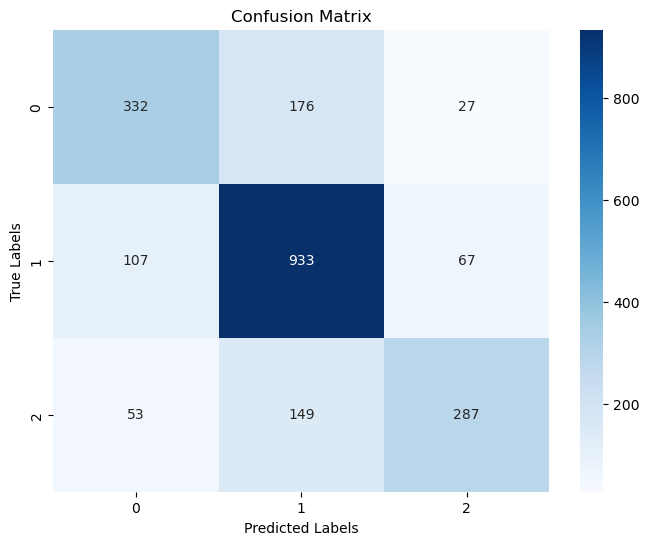

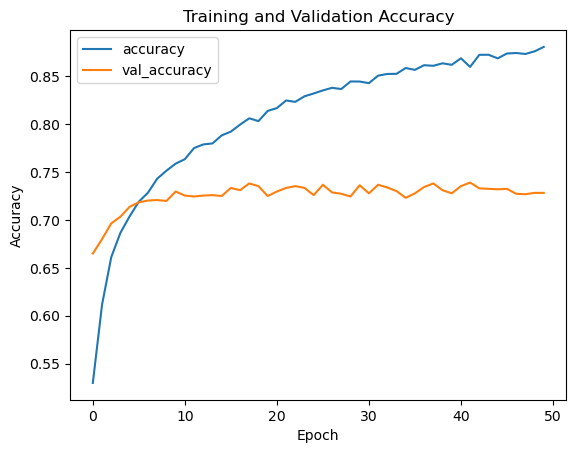

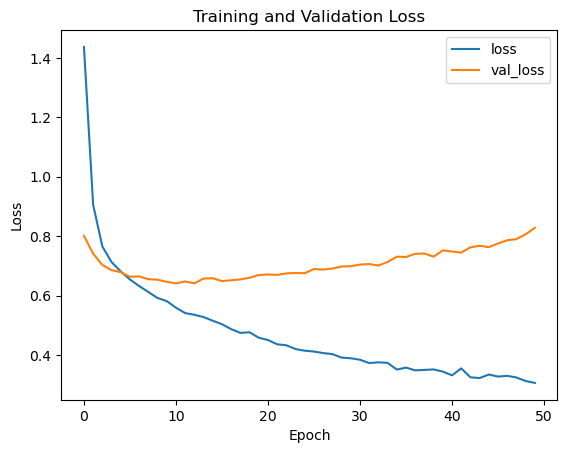

Fold 2
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.3097 - accuracy: 0.8783 - val_loss: 0.8076 - val_accuracy: 0.7227
Epoch 2/50
230/230 [==============================] - 2s 8ms/step - loss: 0.3112 - accuracy: 0.8777 - val_loss: 0.8071 - val_accuracy: 0.7274
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.3118 - accuracy: 0.8766 - val_loss: 0.8020 - val_accuracy: 0.7255
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2971 - accuracy: 0.8848 - val_loss: 0.8155 - val_accuracy: 0.7306
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.3097 - accuracy: 0.8791 - val_loss: 0.8177 - val_accuracy: 0.7264
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.3057 - accuracy: 0.8817 - val_loss: 0.8168 - val_accuracy: 0.7306
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2984 - accuracy: 0.8821 - val_loss: 0.8086 - val_accuracy: 0.7245

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7179727827311122, Validation F1 Score: 0.7143327431147841


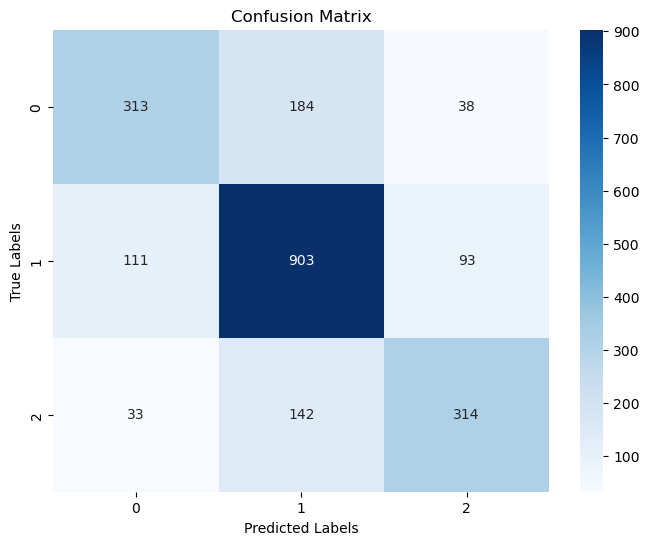

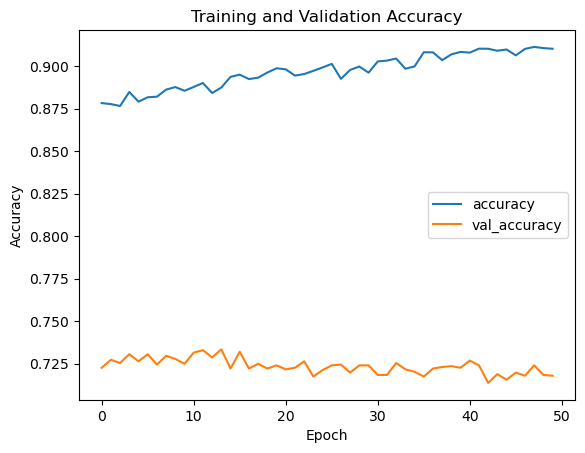

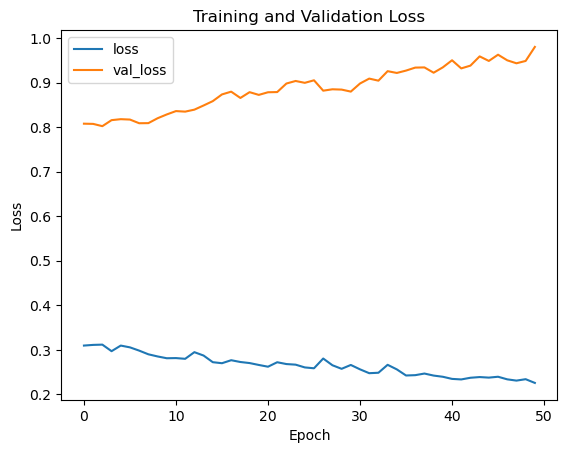

Fold 3
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2385 - accuracy: 0.9076 - val_loss: 0.9635 - val_accuracy: 0.7245
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2344 - accuracy: 0.9095 - val_loss: 0.9695 - val_accuracy: 0.7142
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2292 - accuracy: 0.9154 - val_loss: 0.9789 - val_accuracy: 0.7194
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2325 - accuracy: 0.9133 - val_loss: 1.0034 - val_accuracy: 0.7142
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2287 - accuracy: 0.9112 - val_loss: 0.9906 - val_accuracy: 0.7152
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2245 - accuracy: 0.9154 - val_loss: 0.9792 - val_accuracy: 0.7161
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2346 - accuracy: 0.9136 - val_loss: 0.9832 - val_accuracy: 0.7175

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7160957297043642, Validation F1 Score: 0.7131326732681856


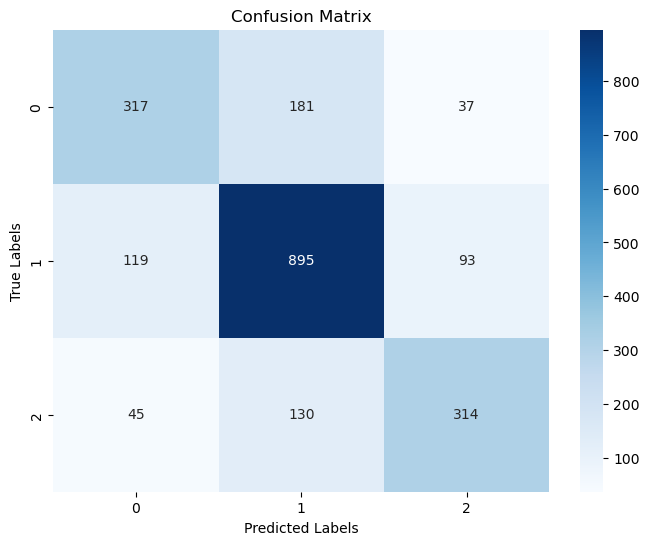

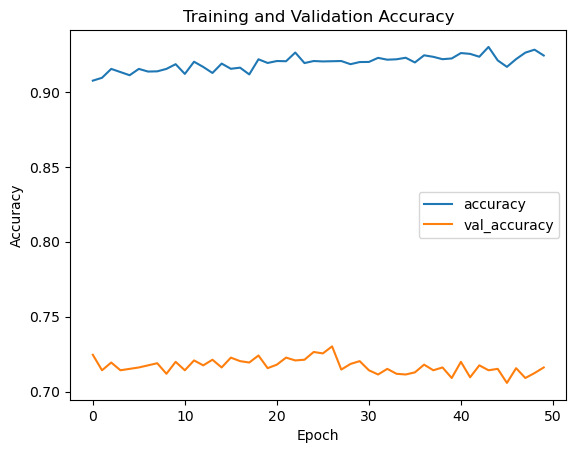

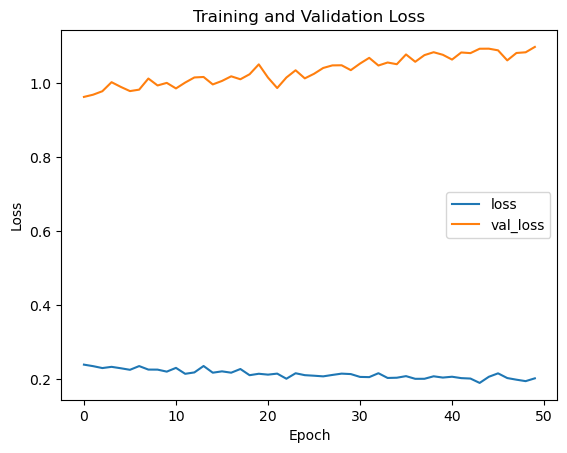

Fold 4
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1917 - accuracy: 0.9284 - val_loss: 1.1143 - val_accuracy: 0.7203
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1906 - accuracy: 0.9282 - val_loss: 1.1079 - val_accuracy: 0.7161
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1956 - accuracy: 0.9255 - val_loss: 1.1155 - val_accuracy: 0.7152
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1933 - accuracy: 0.9252 - val_loss: 1.0944 - val_accuracy: 0.7128
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1902 - accuracy: 0.9278 - val_loss: 1.1177 - val_accuracy: 0.7142
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1880 - accuracy: 0.9282 - val_loss: 1.1081 - val_accuracy: 0.7128
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1904 - accuracy: 0.9305 - val_loss: 1.0942 - val_accuracy: 0.7062

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7226654152979821, Validation F1 Score: 0.718687682814978


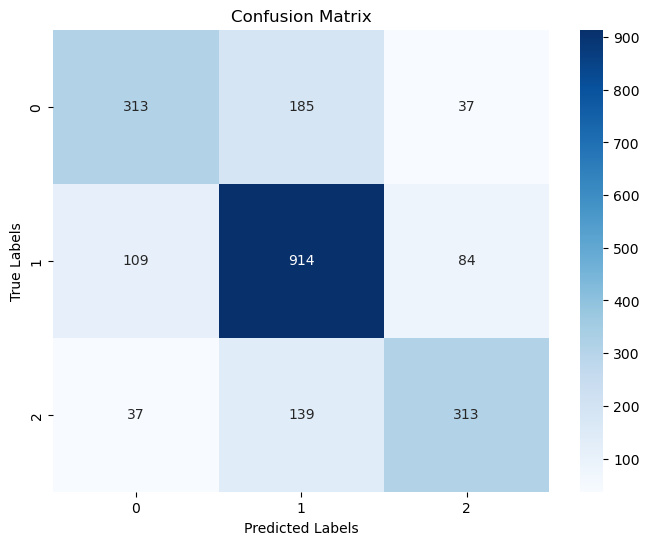

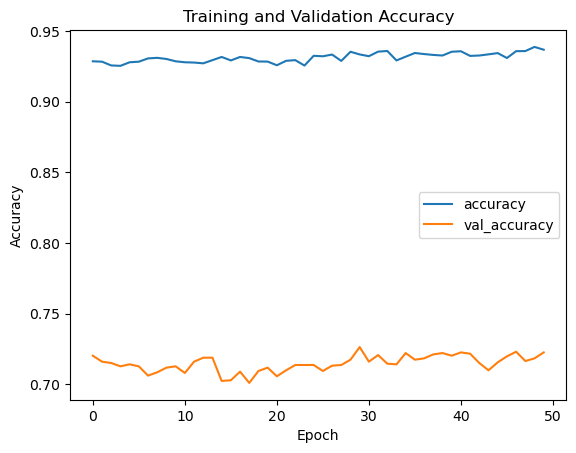

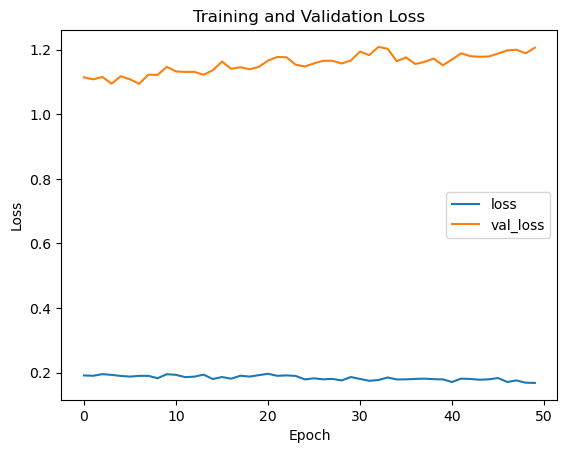

Fold 5
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1752 - accuracy: 0.9334 - val_loss: 1.2115 - val_accuracy: 0.7161
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1746 - accuracy: 0.9353 - val_loss: 1.2115 - val_accuracy: 0.7175
Epoch 3/50
230/230 [==============================] - 2s 8ms/step - loss: 0.1762 - accuracy: 0.9361 - val_loss: 1.1974 - val_accuracy: 0.7213
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1686 - accuracy: 0.9374 - val_loss: 1.2302 - val_accuracy: 0.7180
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1758 - accuracy: 0.9347 - val_loss: 1.2117 - val_accuracy: 0.7166
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1761 - accuracy: 0.9342 - val_loss: 1.2443 - val_accuracy: 0.7067
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1749 - accuracy: 0.9331 - val_loss: 1.2640 - val_accuracy: 0.7166

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7156264664476771, Validation F1 Score: 0.7141192221611938


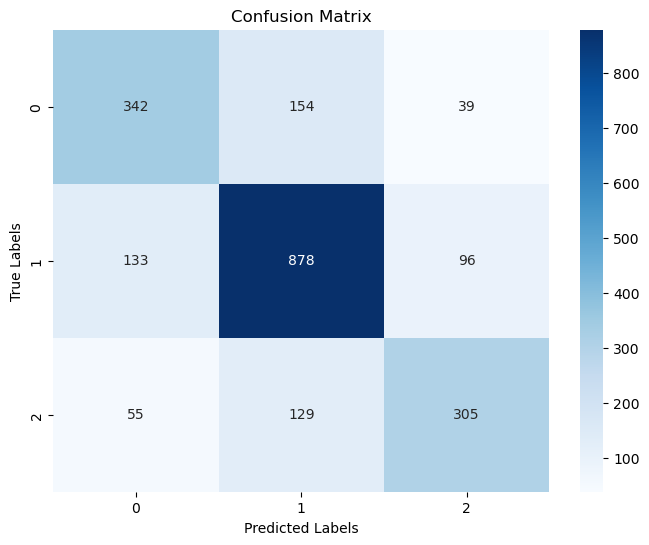

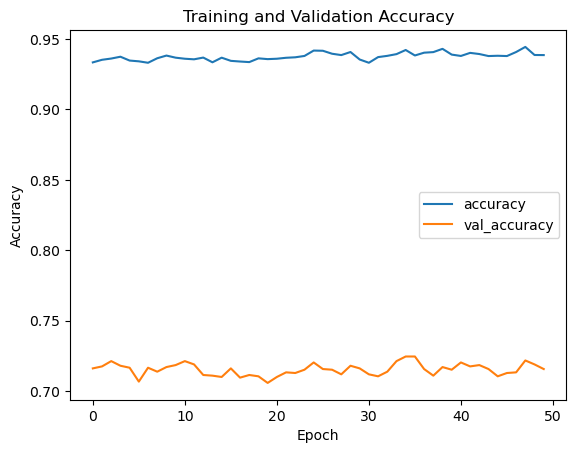

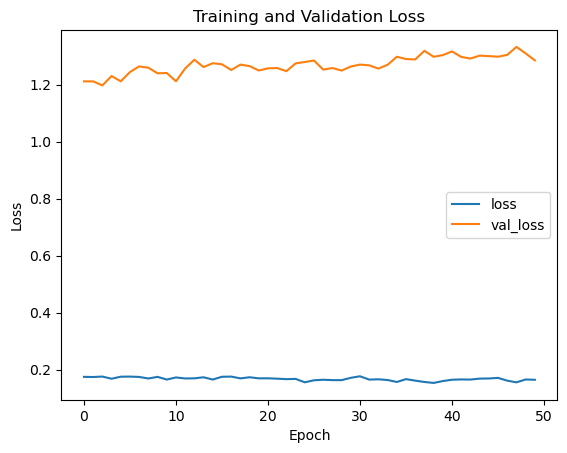

Fold 6
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1585 - accuracy: 0.9428 - val_loss: 1.3049 - val_accuracy: 0.7170
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1594 - accuracy: 0.9424 - val_loss: 1.3137 - val_accuracy: 0.7091
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1554 - accuracy: 0.9417 - val_loss: 1.3201 - val_accuracy: 0.7067
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1513 - accuracy: 0.9431 - val_loss: 1.3386 - val_accuracy: 0.7081
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1643 - accuracy: 0.9394 - val_loss: 1.3399 - val_accuracy: 0.7095
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1619 - accuracy: 0.9415 - val_loss: 1.3184 - val_accuracy: 0.7109
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1606 - accuracy: 0.9398 - val_loss: 1.3258 - val_accuracy: 0.7067

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 3ms/step
Validation Accuracy: 0.7029563585171281, Validation F1 Score: 0.6989954241866705


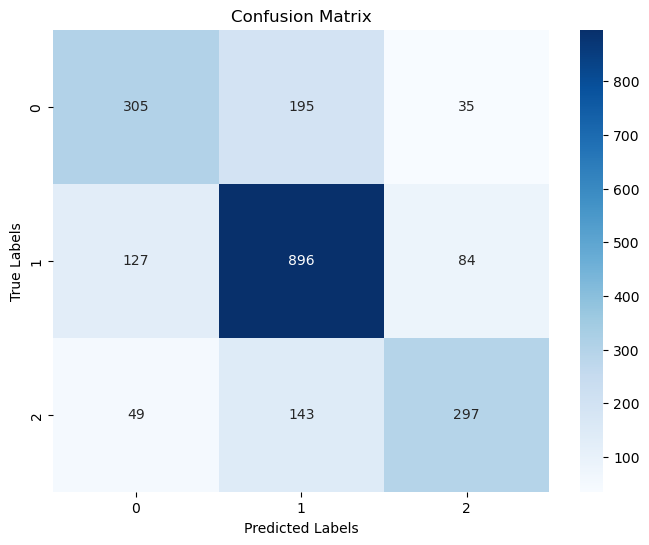

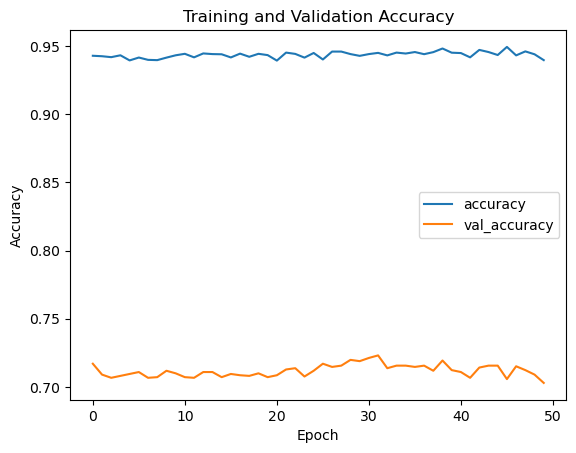

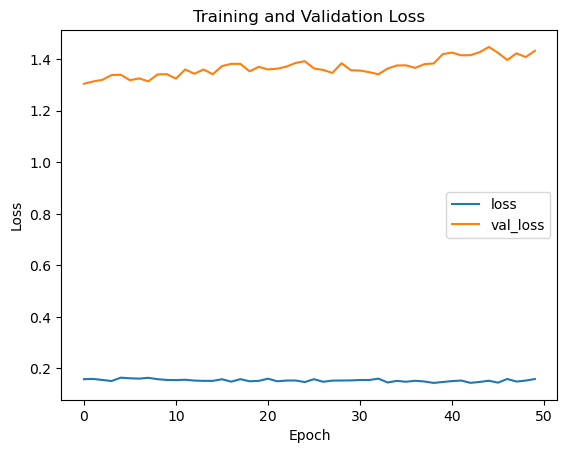

Fold 7
Epoch 1/50
230/230 [==============================] - 2s 8ms/step - loss: 0.1433 - accuracy: 0.9477 - val_loss: 1.4277 - val_accuracy: 0.7072
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1500 - accuracy: 0.9448 - val_loss: 1.4172 - val_accuracy: 0.7095
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1482 - accuracy: 0.9450 - val_loss: 1.4327 - val_accuracy: 0.7119
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1476 - accuracy: 0.9470 - val_loss: 1.4243 - val_accuracy: 0.7114
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1468 - accuracy: 0.9468 - val_loss: 1.4320 - val_accuracy: 0.7086
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1471 - accuracy: 0.9456 - val_loss: 1.4210 - val_accuracy: 0.7091
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1499 - accuracy: 0.9436 - val_loss: 1.4297 - val_accuracy: 0.7147

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7104645706241202, Validation F1 Score: 0.7069724549948055


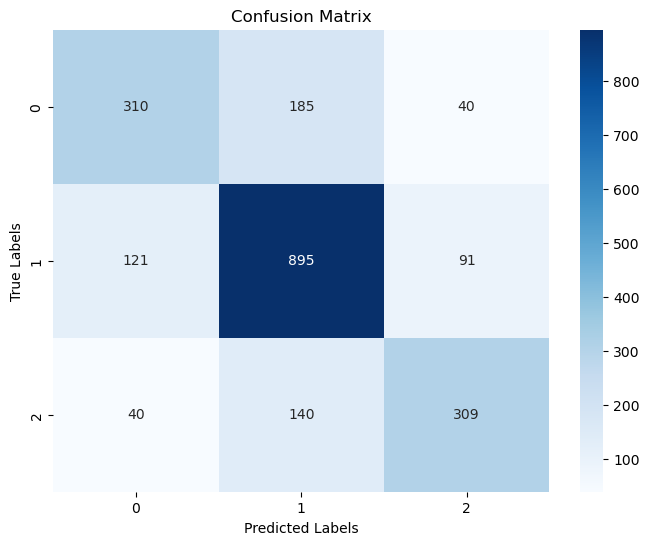

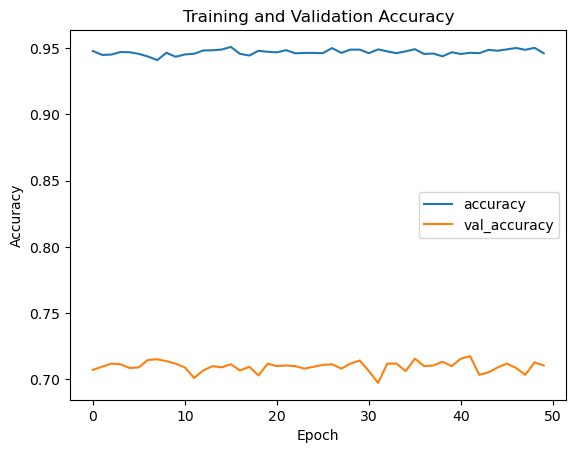

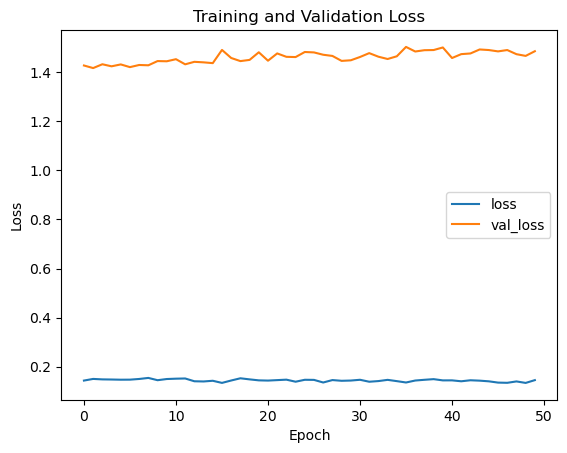

Fold 8
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1488 - accuracy: 0.9447 - val_loss: 1.4653 - val_accuracy: 0.7091
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1435 - accuracy: 0.9488 - val_loss: 1.4815 - val_accuracy: 0.7137
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1406 - accuracy: 0.9503 - val_loss: 1.5194 - val_accuracy: 0.7105
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1434 - accuracy: 0.9439 - val_loss: 1.4967 - val_accuracy: 0.7095
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1371 - accuracy: 0.9506 - val_loss: 1.5053 - val_accuracy: 0.7142
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1347 - accuracy: 0.9509 - val_loss: 1.4966 - val_accuracy: 0.7137
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1361 - accuracy: 0.9490 - val_loss: 1.4788 - val_accuracy: 0.7105

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7085875175973722, Validation F1 Score: 0.7053319571587902


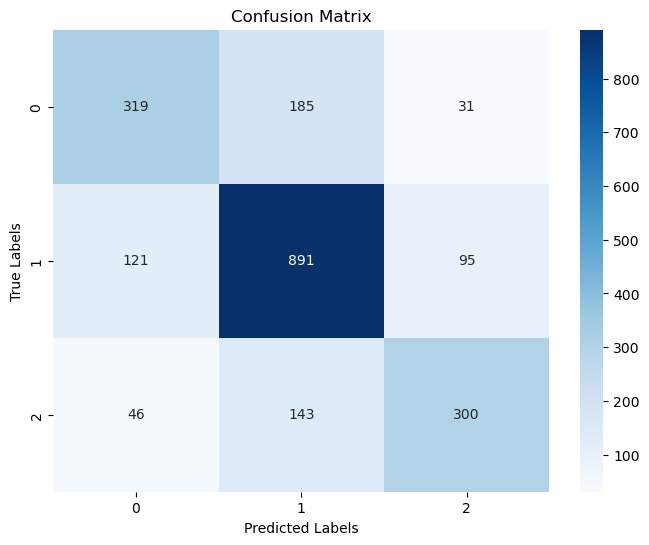

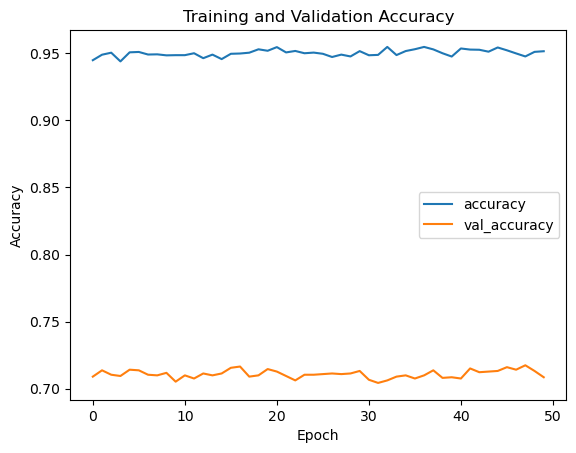

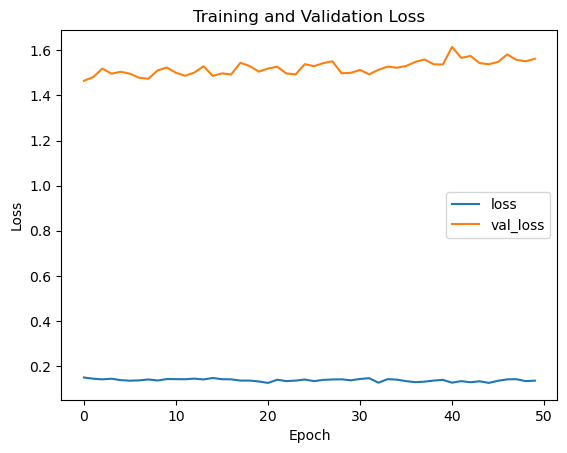

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7153331769122477
Mean F1 Score: 0.711894565755682
Number of Epochs: 50, Test Size: 0.15, Validation Size: 0.2
Fold 1
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 1.5708 - accuracy: 0.5172 - val_loss: 0.7822 - val_accuracy: 0.6660
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.9165 - accuracy: 0.6115 - val_loss: 0.7294 - val_accuracy: 0.6923
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.7778 - accuracy: 0.6612 - val_loss: 0.7044 - val_accuracy: 0.7054
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.7192 - accuracy: 0.6843 - val_loss: 0.6888 - val_accuracy: 0.7165
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.6853 - accuracy: 0.7024 - val_loss: 0.6716 - val_accuracy: 0.7155
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.6583 - accuracy: 0.7168 - val_loss: 0.6648 - val_accuracy: 0.7256
Epoch 7/50
230

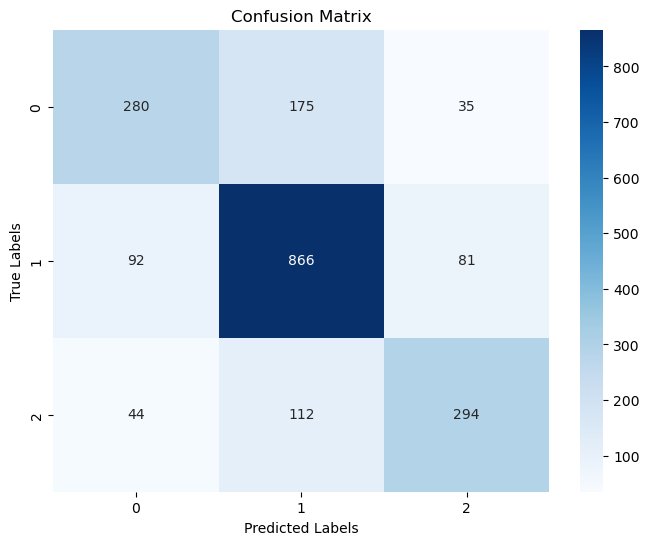

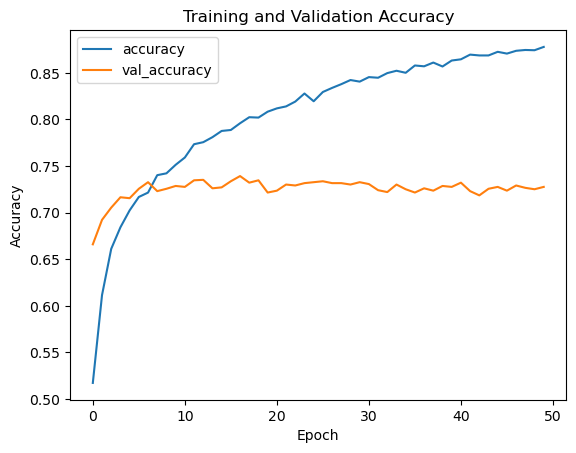

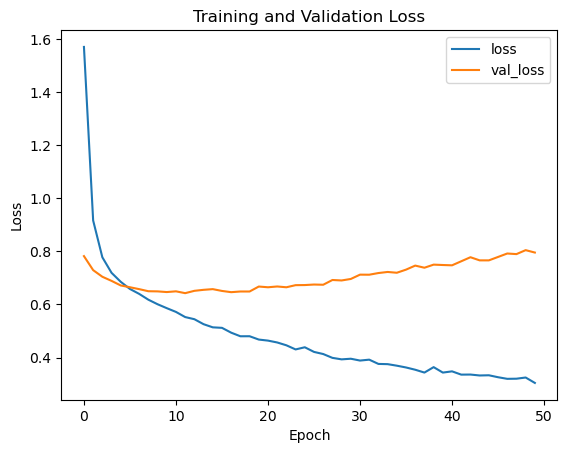

Fold 2
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.3232 - accuracy: 0.8735 - val_loss: 0.7941 - val_accuracy: 0.7287
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.3036 - accuracy: 0.8817 - val_loss: 0.7895 - val_accuracy: 0.7281
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.3105 - accuracy: 0.8748 - val_loss: 0.7894 - val_accuracy: 0.7281
Epoch 4/50
230/230 [==============================] - 2s 8ms/step - loss: 0.3101 - accuracy: 0.8806 - val_loss: 0.7936 - val_accuracy: 0.7322
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.3047 - accuracy: 0.8796 - val_loss: 0.8117 - val_accuracy: 0.7302
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2951 - accuracy: 0.8858 - val_loss: 0.8103 - val_accuracy: 0.7180
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2924 - accuracy: 0.8874 - val_loss: 0.8188 - val_accuracy: 0.7211

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 3ms/step
Validation Accuracy: 0.7311773623041941, Validation F1 Score: 0.7271893112796031


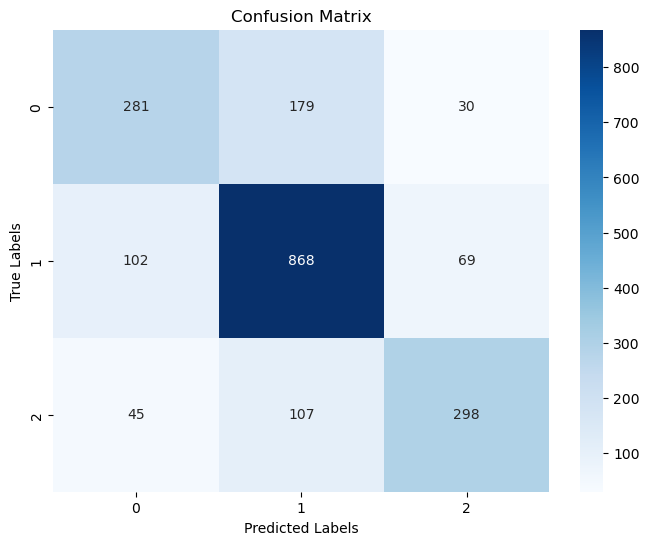

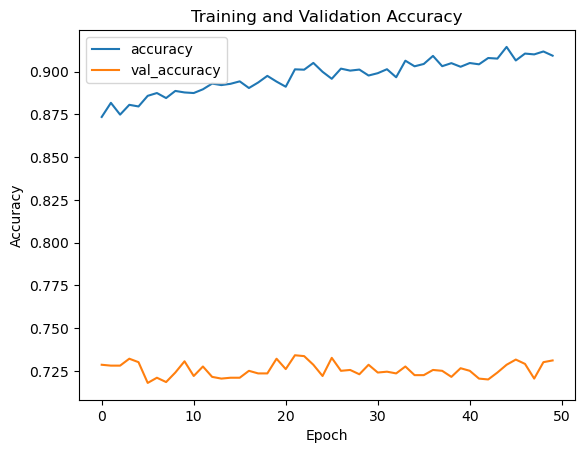

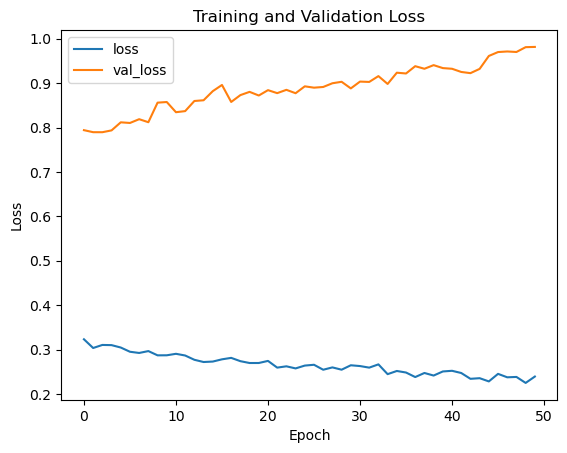

Fold 3
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2265 - accuracy: 0.9133 - val_loss: 0.9714 - val_accuracy: 0.7246
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2318 - accuracy: 0.9117 - val_loss: 0.9508 - val_accuracy: 0.7266
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2227 - accuracy: 0.9121 - val_loss: 0.9604 - val_accuracy: 0.7216
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2257 - accuracy: 0.9133 - val_loss: 0.9525 - val_accuracy: 0.7236
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2312 - accuracy: 0.9111 - val_loss: 0.9650 - val_accuracy: 0.7251
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2217 - accuracy: 0.9164 - val_loss: 0.9925 - val_accuracy: 0.7130
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2231 - accuracy: 0.9153 - val_loss: 1.0002 - val_accuracy: 0.7256

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7170288024254674, Validation F1 Score: 0.712116424260035


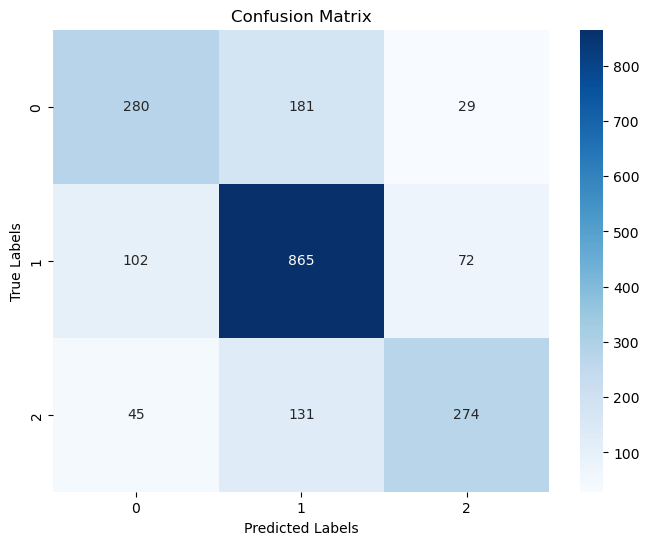

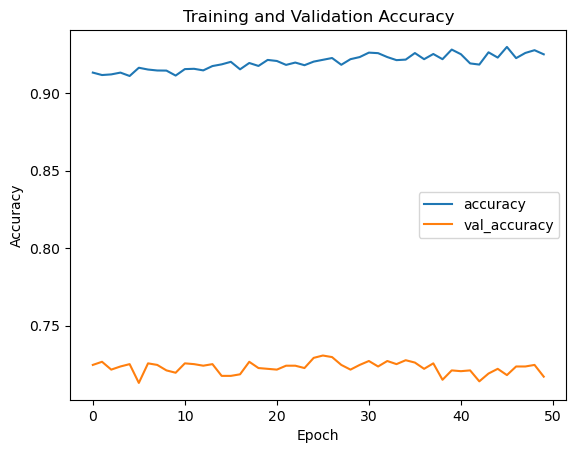

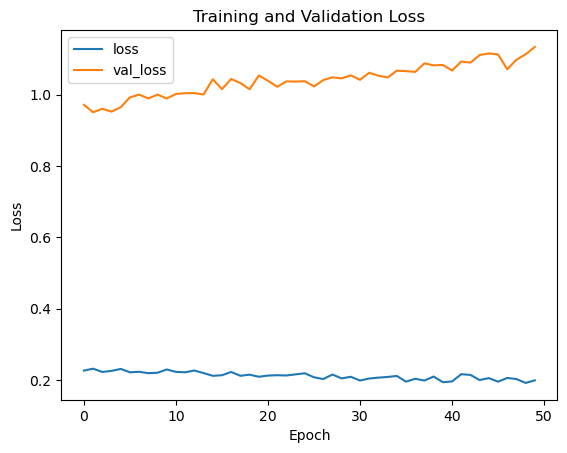

Fold 4
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2032 - accuracy: 0.9249 - val_loss: 1.1205 - val_accuracy: 0.7110
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1989 - accuracy: 0.9238 - val_loss: 1.1202 - val_accuracy: 0.7185
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2122 - accuracy: 0.9194 - val_loss: 1.1140 - val_accuracy: 0.7191
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1912 - accuracy: 0.9275 - val_loss: 1.1126 - val_accuracy: 0.7196
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1888 - accuracy: 0.9286 - val_loss: 1.1434 - val_accuracy: 0.7120
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1964 - accuracy: 0.9261 - val_loss: 1.1222 - val_accuracy: 0.7206
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1869 - accuracy: 0.9295 - val_loss: 1.1126 - val_accuracy: 0.7150

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.720565942395149, Validation F1 Score: 0.7168552222046121


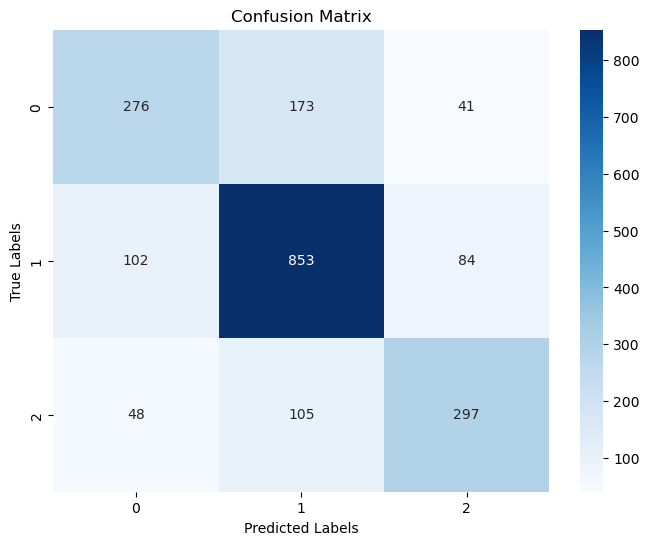

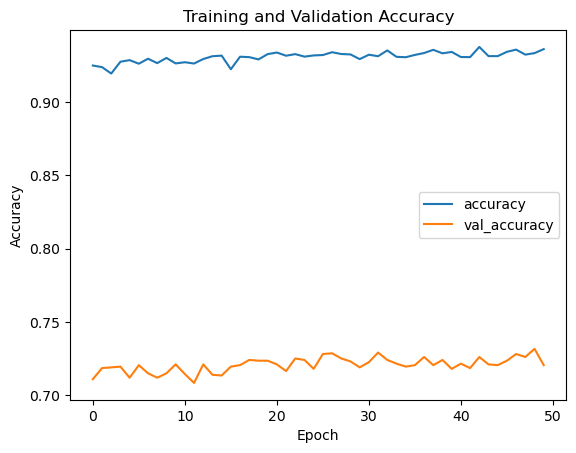

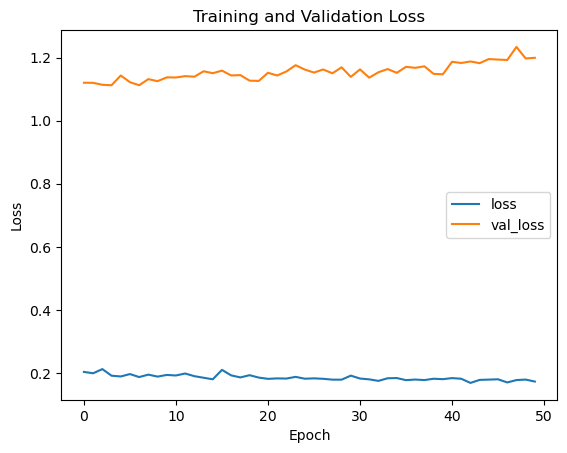

Fold 5
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1699 - accuracy: 0.9351 - val_loss: 1.2035 - val_accuracy: 0.7201
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1711 - accuracy: 0.9365 - val_loss: 1.2241 - val_accuracy: 0.7196
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1834 - accuracy: 0.9319 - val_loss: 1.2471 - val_accuracy: 0.7145
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1677 - accuracy: 0.9374 - val_loss: 1.2286 - val_accuracy: 0.7241
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1797 - accuracy: 0.9340 - val_loss: 1.2287 - val_accuracy: 0.7271
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1726 - accuracy: 0.9391 - val_loss: 1.1909 - val_accuracy: 0.7201
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1715 - accuracy: 0.9337 - val_loss: 1.2175 - val_accuracy: 0.7150

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 3ms/step
Validation Accuracy: 0.7230924709449217, Validation F1 Score: 0.7198312584593496


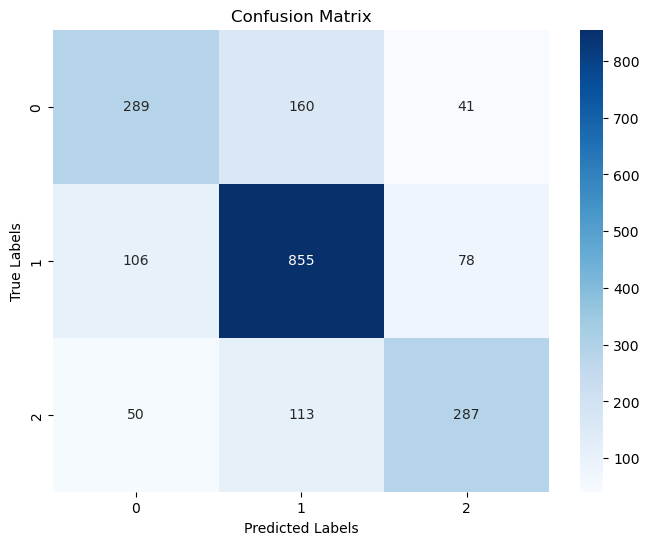

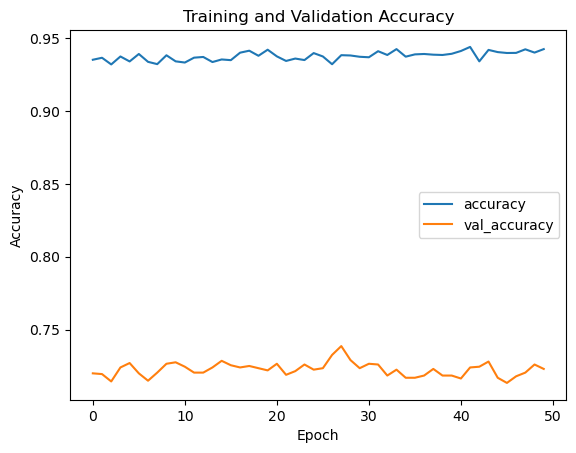

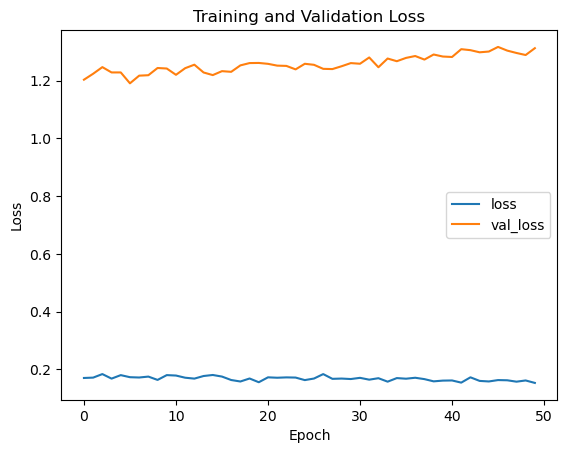

Fold 6
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1658 - accuracy: 0.9388 - val_loss: 1.3184 - val_accuracy: 0.7201
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1680 - accuracy: 0.9375 - val_loss: 1.3390 - val_accuracy: 0.7150
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1610 - accuracy: 0.9410 - val_loss: 1.3082 - val_accuracy: 0.7100
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1579 - accuracy: 0.9415 - val_loss: 1.3105 - val_accuracy: 0.7145
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1547 - accuracy: 0.9424 - val_loss: 1.3178 - val_accuracy: 0.7160
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1538 - accuracy: 0.9432 - val_loss: 1.3161 - val_accuracy: 0.7196
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1609 - accuracy: 0.9385 - val_loss: 1.2954 - val_accuracy: 0.7130

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7235977766548762, Validation F1 Score: 0.7206224577035176


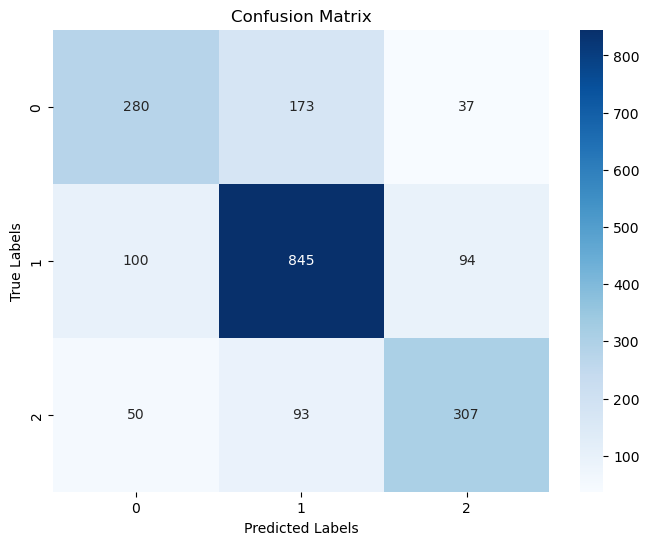

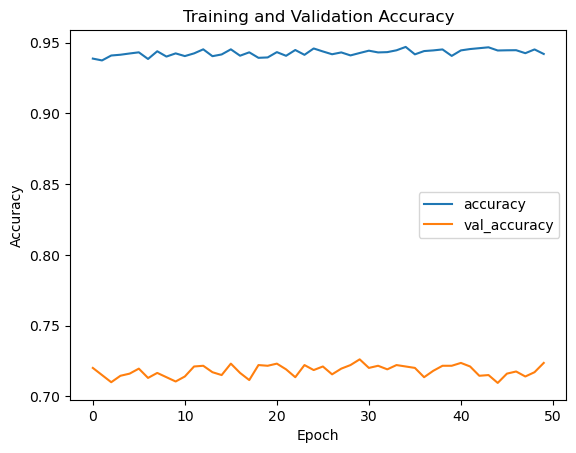

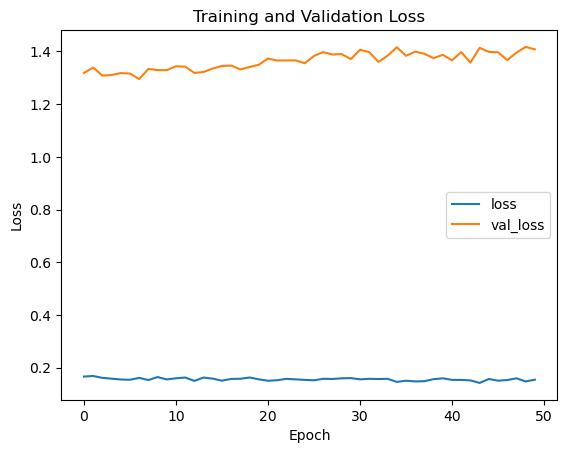

Fold 7
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1566 - accuracy: 0.9425 - val_loss: 1.4003 - val_accuracy: 0.7135
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1486 - accuracy: 0.9452 - val_loss: 1.3827 - val_accuracy: 0.7206
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1554 - accuracy: 0.9464 - val_loss: 1.3794 - val_accuracy: 0.7140
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1433 - accuracy: 0.9468 - val_loss: 1.3970 - val_accuracy: 0.7140
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1474 - accuracy: 0.9457 - val_loss: 1.3742 - val_accuracy: 0.7110
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1471 - accuracy: 0.9474 - val_loss: 1.3971 - val_accuracy: 0.7074
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1439 - accuracy: 0.9464 - val_loss: 1.3697 - val_accuracy: 0.7150

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7170288024254674, Validation F1 Score: 0.7128483773894955


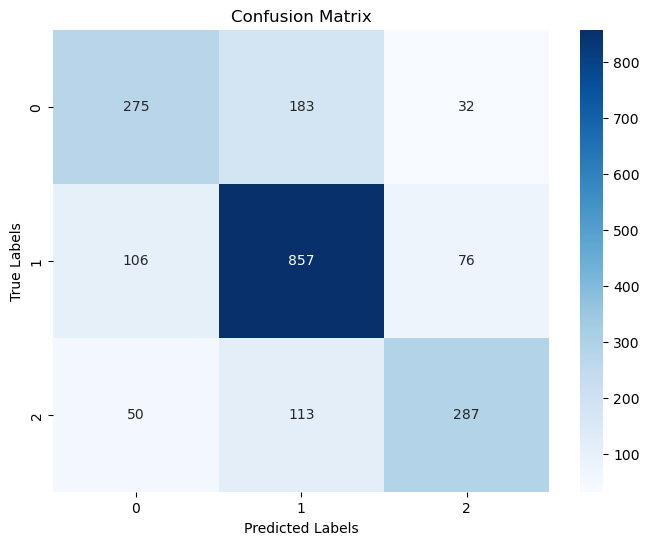

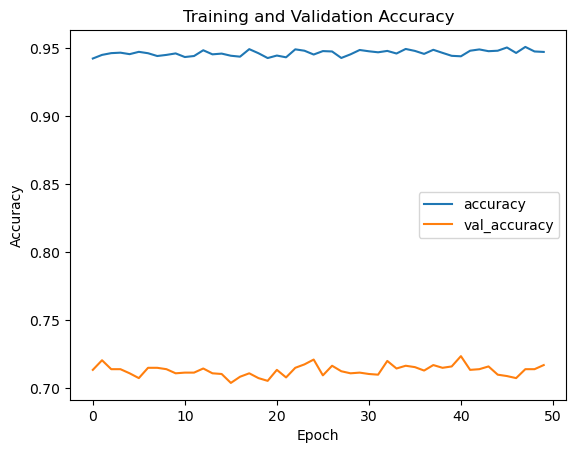

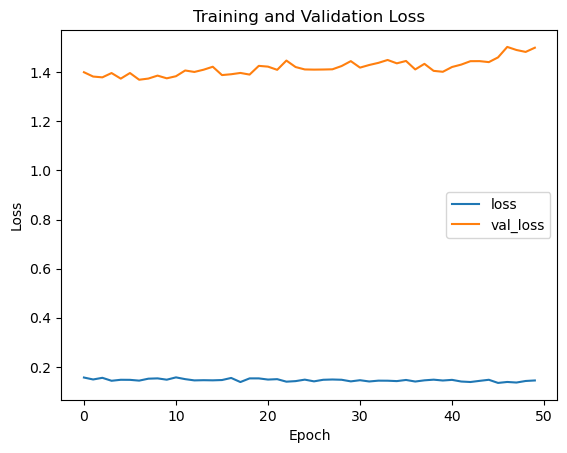

Fold 8
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1353 - accuracy: 0.9500 - val_loss: 1.5087 - val_accuracy: 0.7105
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1450 - accuracy: 0.9492 - val_loss: 1.4898 - val_accuracy: 0.7170
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1364 - accuracy: 0.9501 - val_loss: 1.4837 - val_accuracy: 0.7079
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1401 - accuracy: 0.9490 - val_loss: 1.4837 - val_accuracy: 0.7105
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1484 - accuracy: 0.9461 - val_loss: 1.4642 - val_accuracy: 0.7059
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1461 - accuracy: 0.9457 - val_loss: 1.4537 - val_accuracy: 0.7110
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1479 - accuracy: 0.9473 - val_loss: 1.4403 - val_accuracy: 0.7170

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7200606366851945, Validation F1 Score: 0.7153964138818735


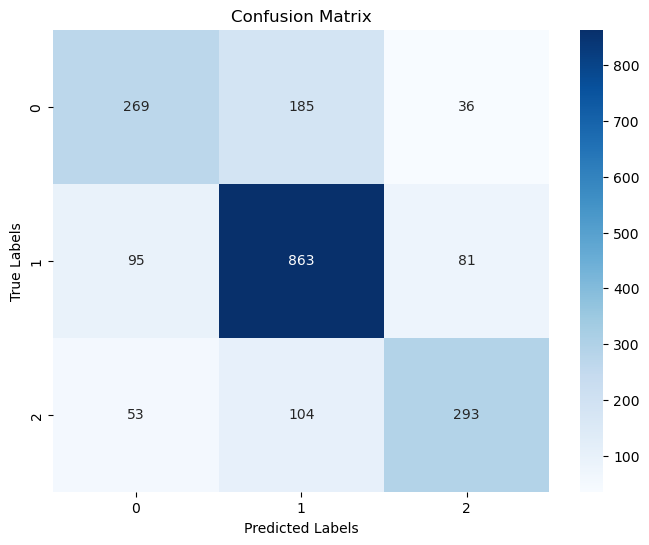

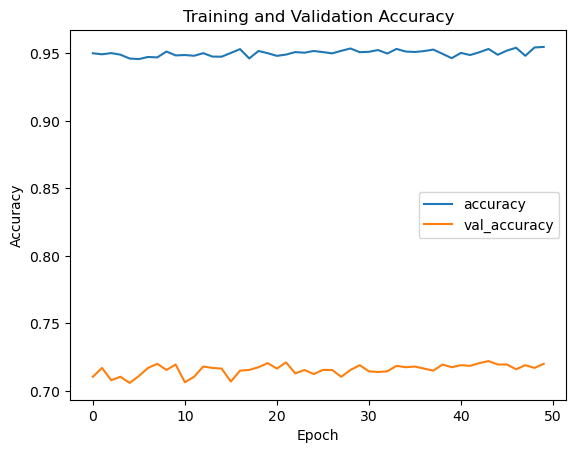

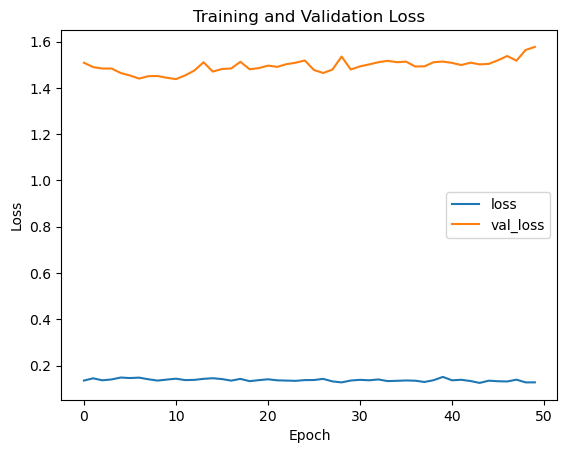

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7225240020212229
Mean F1 Score: 0.7185259434183543
Number of Epochs: 50, Test Size: 0.15, Validation Size: 0.25
Fold 1
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 1.3584 - accuracy: 0.5240 - val_loss: 0.7584 - val_accuracy: 0.6725
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.8602 - accuracy: 0.6274 - val_loss: 0.7412 - val_accuracy: 0.6802
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.7536 - accuracy: 0.6625 - val_loss: 0.6987 - val_accuracy: 0.7054
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.7097 - accuracy: 0.6912 - val_loss: 0.6870 - val_accuracy: 0.7021
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.6847 - accuracy: 0.7036 - val_loss: 0.6734 - val_accuracy: 0.7196
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.6520 - accuracy: 0.7151 - val_loss: 0.6557 - val_accuracy: 0.7202
Epoch 7/50
2

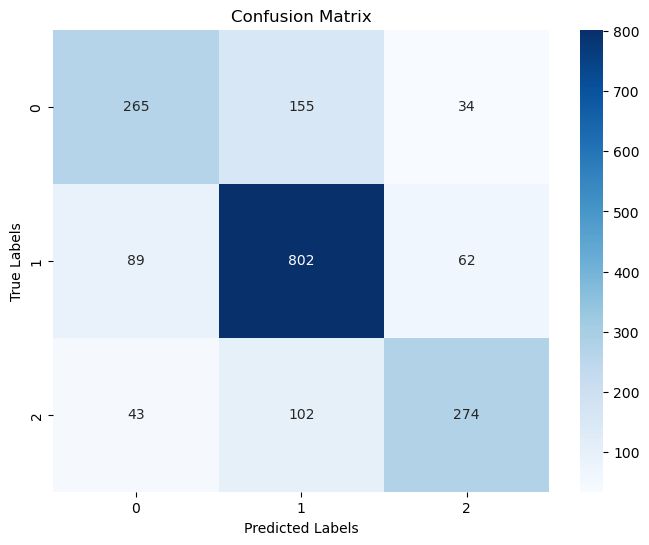

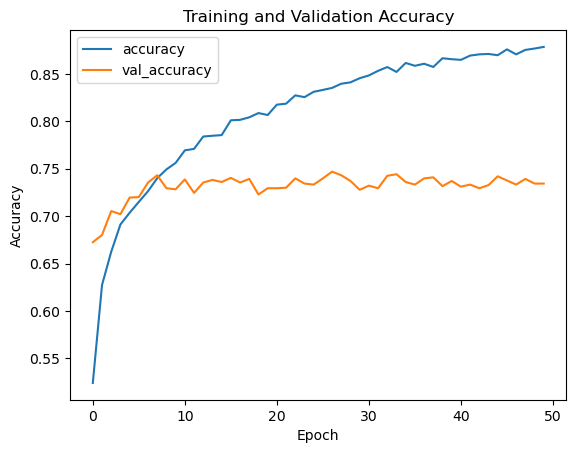

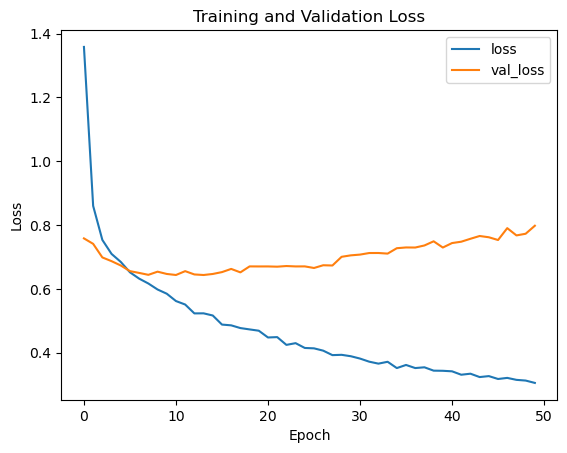

Fold 2
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2984 - accuracy: 0.8836 - val_loss: 0.7986 - val_accuracy: 0.7366
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2994 - accuracy: 0.8815 - val_loss: 0.8110 - val_accuracy: 0.7251
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.3069 - accuracy: 0.8814 - val_loss: 0.8064 - val_accuracy: 0.7360
Epoch 4/50
230/230 [==============================] - 2s 8ms/step - loss: 0.3061 - accuracy: 0.8793 - val_loss: 0.8023 - val_accuracy: 0.7256
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.3023 - accuracy: 0.8833 - val_loss: 0.8117 - val_accuracy: 0.7273
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2922 - accuracy: 0.8868 - val_loss: 0.8159 - val_accuracy: 0.7278
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2876 - accuracy: 0.8863 - val_loss: 0.8331 - val_accuracy: 0.7256

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7223439211391018, Validation F1 Score: 0.7179973785328793


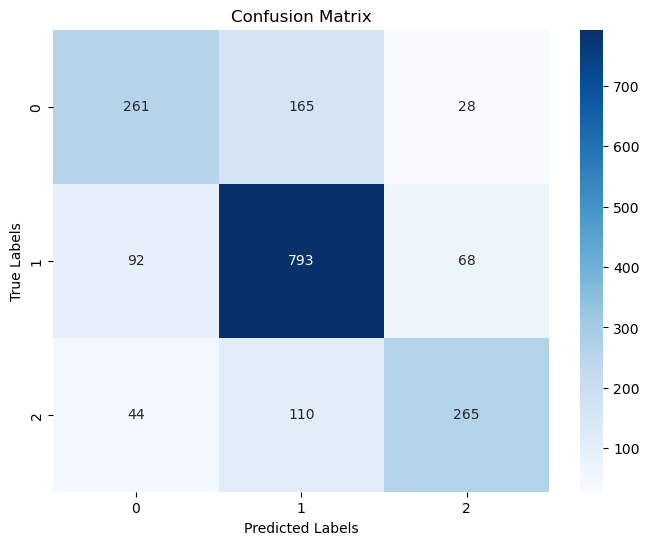

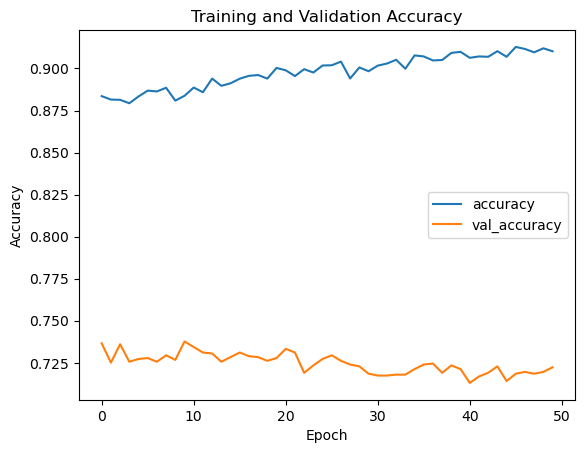

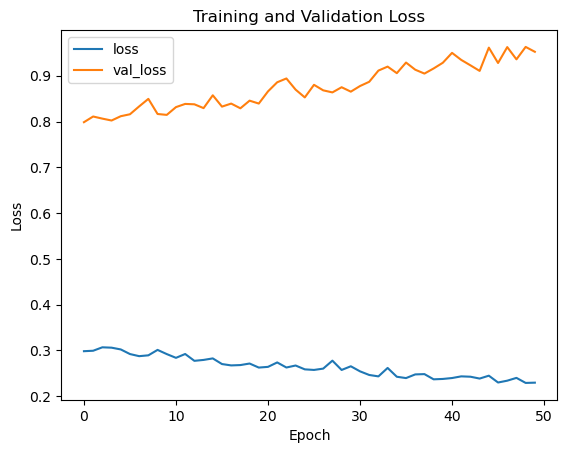

Fold 3
Epoch 1/50
230/230 [==============================] - 2s 8ms/step - loss: 0.2336 - accuracy: 0.9106 - val_loss: 0.9447 - val_accuracy: 0.7229
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2292 - accuracy: 0.9149 - val_loss: 0.9675 - val_accuracy: 0.7229
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2246 - accuracy: 0.9143 - val_loss: 0.9582 - val_accuracy: 0.7218
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2360 - accuracy: 0.9123 - val_loss: 0.9657 - val_accuracy: 0.7207
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2290 - accuracy: 0.9145 - val_loss: 0.9522 - val_accuracy: 0.7180
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2222 - accuracy: 0.9156 - val_loss: 0.9764 - val_accuracy: 0.7207
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2261 - accuracy: 0.9146 - val_loss: 0.9722 - val_accuracy: 0.7218

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Validation Accuracy: 0.7135815991237678, Validation F1 Score: 0.7073930266856334


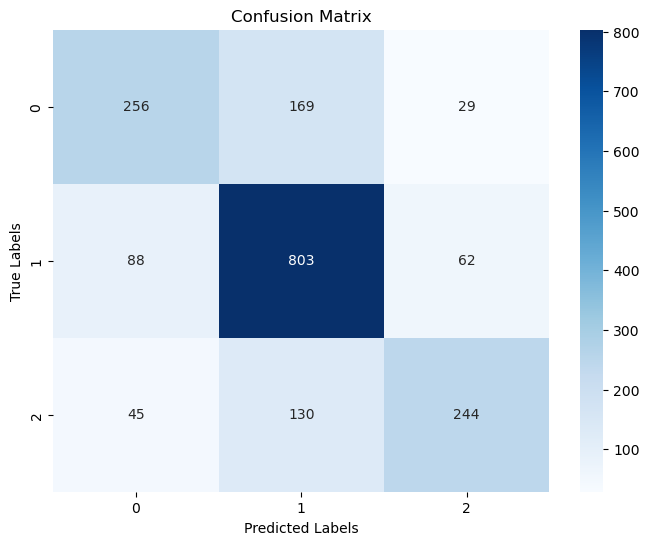

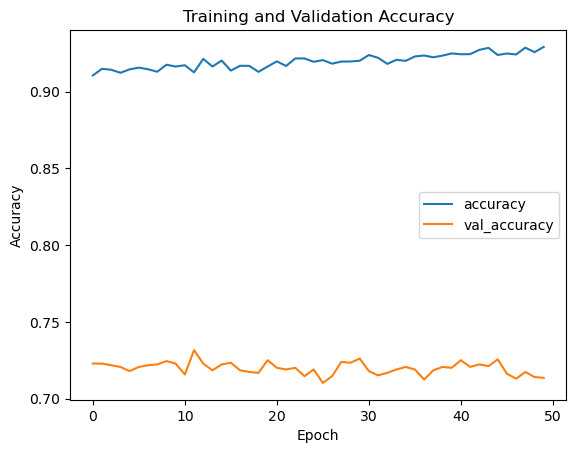

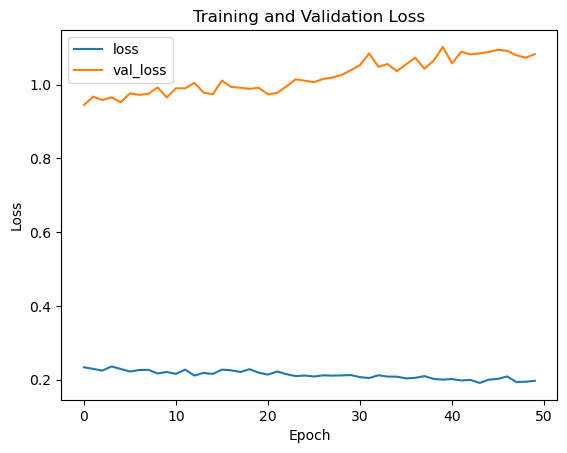

Fold 4
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2018 - accuracy: 0.9239 - val_loss: 1.0568 - val_accuracy: 0.7169
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1981 - accuracy: 0.9267 - val_loss: 1.0696 - val_accuracy: 0.7147
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2010 - accuracy: 0.9240 - val_loss: 1.0868 - val_accuracy: 0.7141
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1925 - accuracy: 0.9272 - val_loss: 1.1087 - val_accuracy: 0.7180
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1961 - accuracy: 0.9262 - val_loss: 1.1051 - val_accuracy: 0.7147
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1937 - accuracy: 0.9259 - val_loss: 1.0733 - val_accuracy: 0.7152
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.2056 - accuracy: 0.9252 - val_loss: 1.0989 - val_accuracy: 0.7141

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7179627601314348, Validation F1 Score: 0.7138166311966286


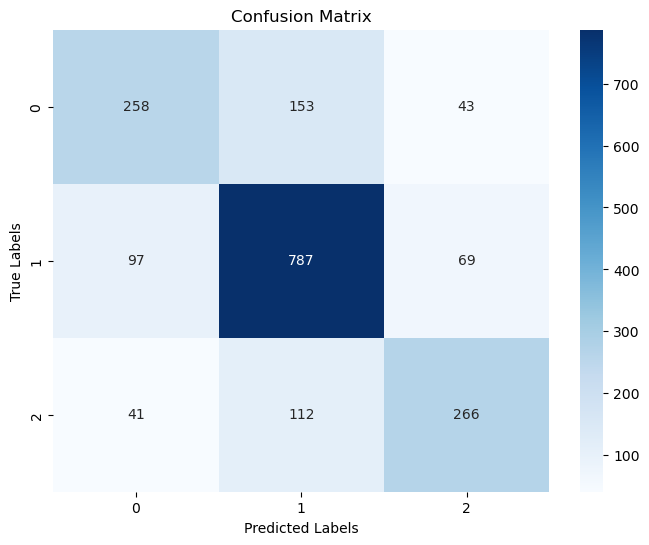

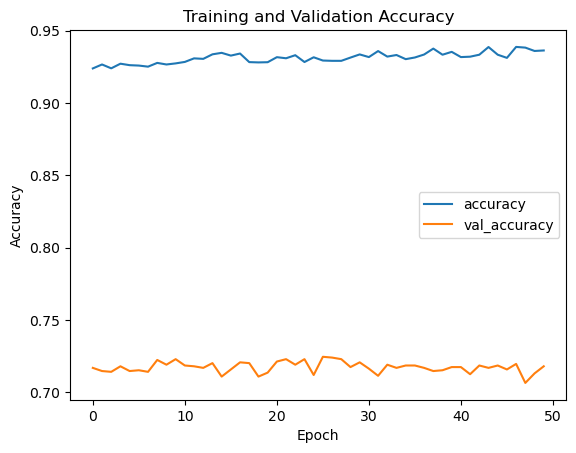

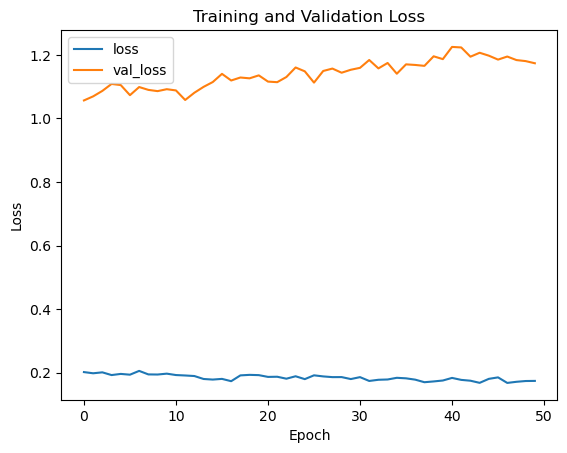

Fold 5
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1765 - accuracy: 0.9338 - val_loss: 1.2072 - val_accuracy: 0.7212
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1738 - accuracy: 0.9344 - val_loss: 1.1841 - val_accuracy: 0.7202
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1685 - accuracy: 0.9381 - val_loss: 1.1939 - val_accuracy: 0.7185
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1804 - accuracy: 0.9336 - val_loss: 1.1828 - val_accuracy: 0.7223
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1763 - accuracy: 0.9355 - val_loss: 1.1892 - val_accuracy: 0.7245
Epoch 6/50
230/230 [==============================] - 2s 8ms/step - loss: 0.1669 - accuracy: 0.9371 - val_loss: 1.1945 - val_accuracy: 0.7229
Epoch 7/50
230/230 [==============================] - 2s 8ms/step - loss: 0.1766 - accuracy: 0.9368 - val_loss: 1.1849 - val_accuracy: 0.7169

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7228915662650602, Validation F1 Score: 0.718160922163985


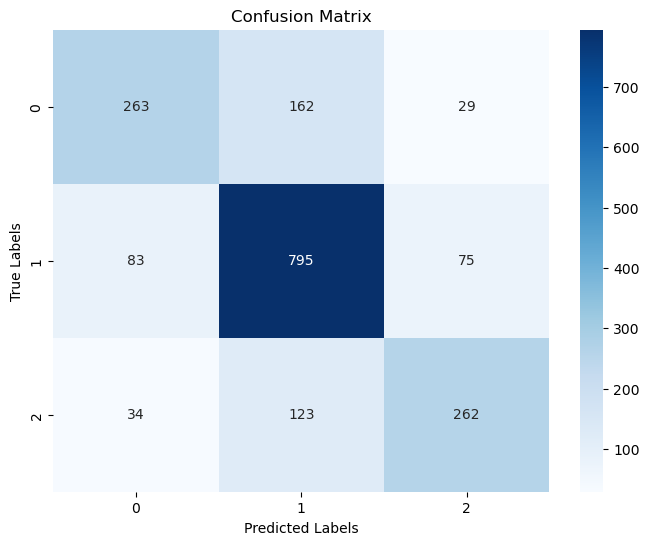

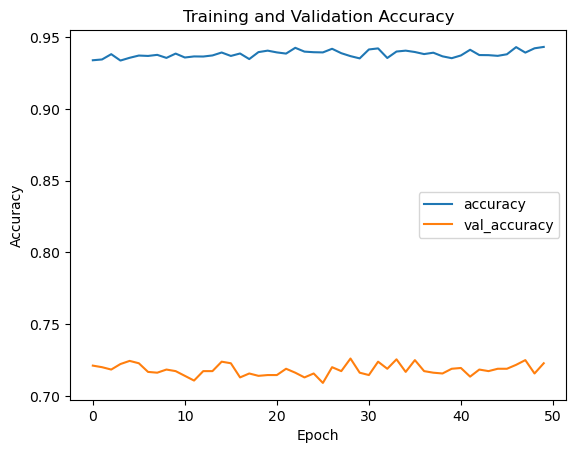

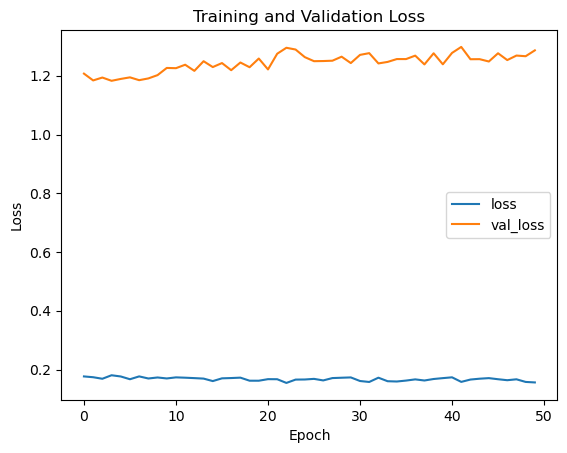

Fold 6
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1592 - accuracy: 0.9438 - val_loss: 1.3167 - val_accuracy: 0.7212
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1586 - accuracy: 0.9408 - val_loss: 1.2981 - val_accuracy: 0.7163
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1578 - accuracy: 0.9410 - val_loss: 1.2860 - val_accuracy: 0.7245
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1751 - accuracy: 0.9373 - val_loss: 1.2785 - val_accuracy: 0.7196
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1655 - accuracy: 0.9404 - val_loss: 1.2966 - val_accuracy: 0.7163
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1582 - accuracy: 0.9418 - val_loss: 1.2938 - val_accuracy: 0.7207
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1589 - accuracy: 0.9400 - val_loss: 1.3078 - val_accuracy: 0.7125

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7059145673603505, Validation F1 Score: 0.7008936804247811


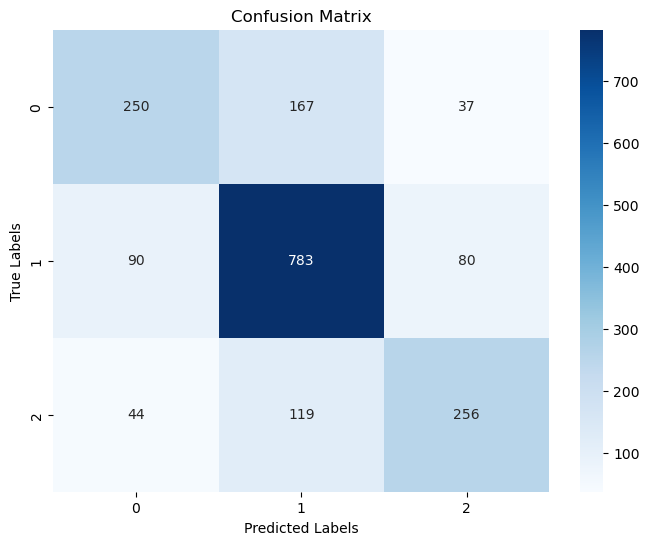

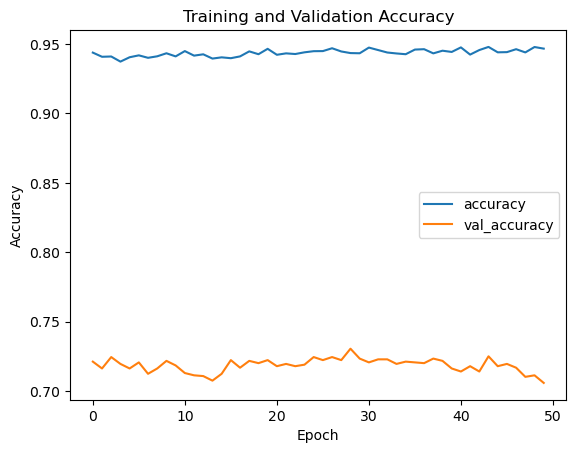

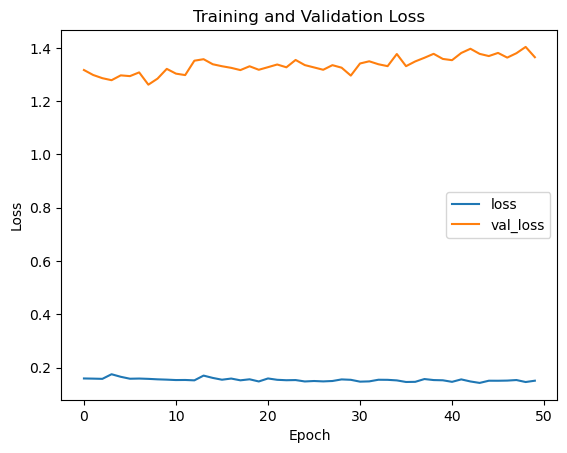

Fold 7
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1529 - accuracy: 0.9449 - val_loss: 1.3564 - val_accuracy: 0.7119
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1481 - accuracy: 0.9460 - val_loss: 1.3856 - val_accuracy: 0.7158
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1519 - accuracy: 0.9487 - val_loss: 1.4026 - val_accuracy: 0.7158
Epoch 4/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1499 - accuracy: 0.9446 - val_loss: 1.4066 - val_accuracy: 0.7147
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1489 - accuracy: 0.9447 - val_loss: 1.3990 - val_accuracy: 0.7180
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1458 - accuracy: 0.9468 - val_loss: 1.4142 - val_accuracy: 0.7114
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1458 - accuracy: 0.9462 - val_loss: 1.3887 - val_accuracy: 0.7152

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7217962760131434, Validation F1 Score: 0.7164838779268188


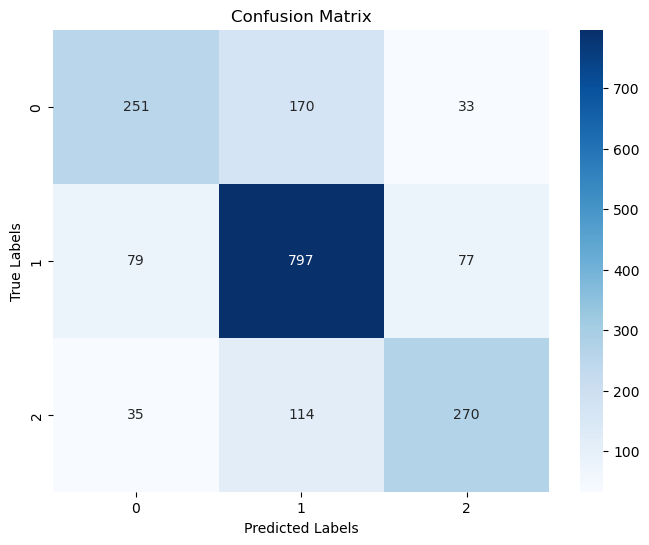

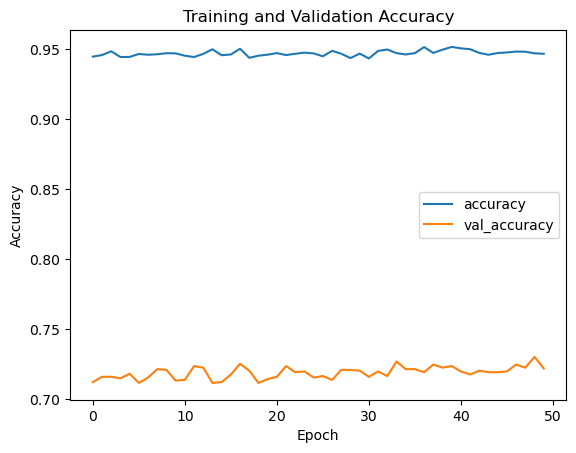

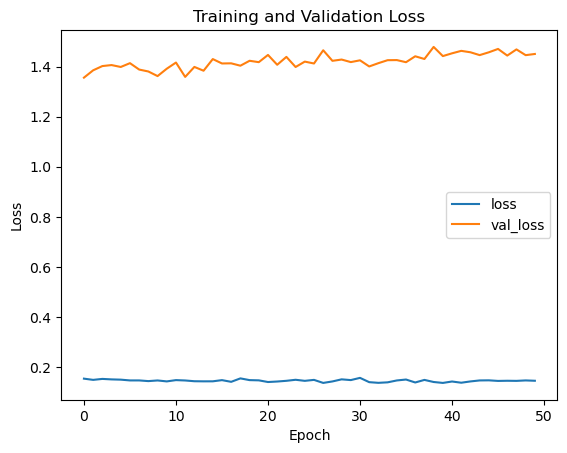

Fold 8
Epoch 1/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1457 - accuracy: 0.9460 - val_loss: 1.4266 - val_accuracy: 0.7218
Epoch 2/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1435 - accuracy: 0.9460 - val_loss: 1.4473 - val_accuracy: 0.7273
Epoch 3/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1383 - accuracy: 0.9503 - val_loss: 1.4566 - val_accuracy: 0.7191
Epoch 4/50
230/230 [==============================] - 2s 8ms/step - loss: 0.1359 - accuracy: 0.9511 - val_loss: 1.4342 - val_accuracy: 0.7174
Epoch 5/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1401 - accuracy: 0.9508 - val_loss: 1.4234 - val_accuracy: 0.7174
Epoch 6/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1361 - accuracy: 0.9505 - val_loss: 1.4361 - val_accuracy: 0.7114
Epoch 7/50
230/230 [==============================] - 2s 7ms/step - loss: 0.1392 - accuracy: 0.9511 - val_loss: 1.4296 - val_accuracy: 0.7141

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


58/58 [==============================] - 0s 2ms/step
Validation Accuracy: 0.71960569550931, Validation F1 Score: 0.7141179077842459


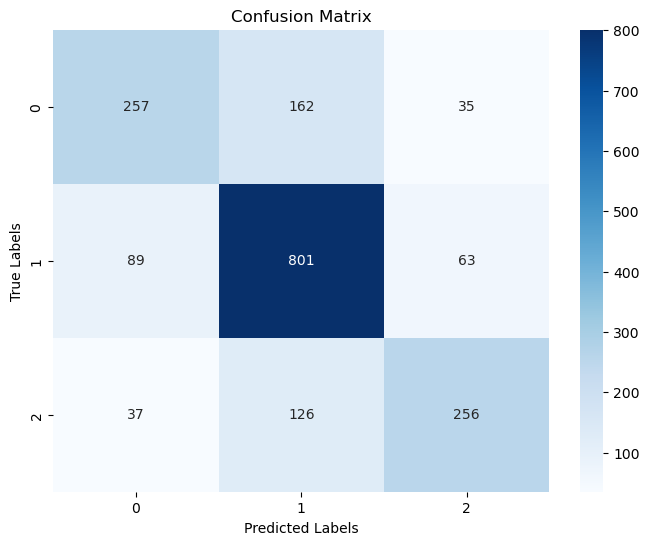

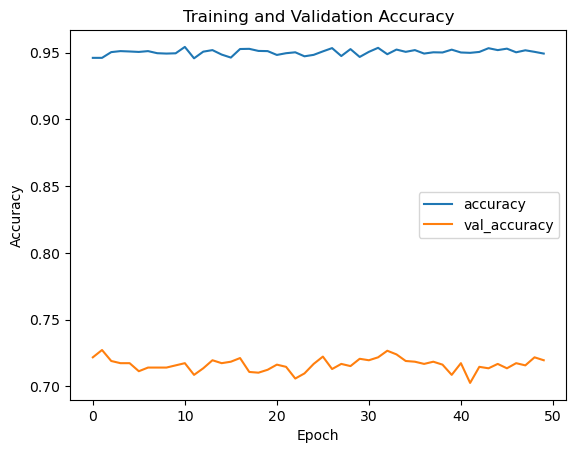

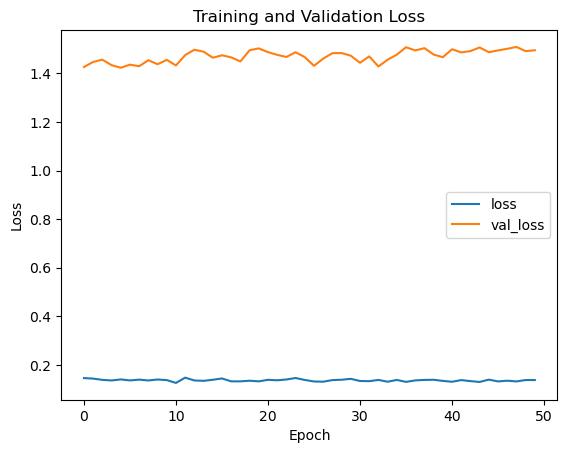

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7198110624315444
Mean F1 Score: 0.7148944627067799
Number of Epochs: 50, Test Size: 0.2, Validation Size: 0.15
Fold 1
Epoch 1/50
216/216 [==============================] - 2s 8ms/step - loss: 1.3693 - accuracy: 0.5248 - val_loss: 0.7797 - val_accuracy: 0.6646
Epoch 2/50
216/216 [==============================] - 1s 7ms/step - loss: 0.8647 - accuracy: 0.6209 - val_loss: 0.7253 - val_accuracy: 0.6989
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.7588 - accuracy: 0.6626 - val_loss: 0.6913 - val_accuracy: 0.7053
Epoch 4/50
216/216 [==============================] - 1s 7ms/step - loss: 0.7157 - accuracy: 0.6855 - val_loss: 0.6760 - val_accuracy: 0.7085
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.6714 - accuracy: 0.7128 - val_loss: 0.6598 - val_accuracy: 0.7228
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.6511 - accuracy: 0.7188 - val_loss: 0.6558 - val_accuracy: 0.7249
Epoch 7/50
21

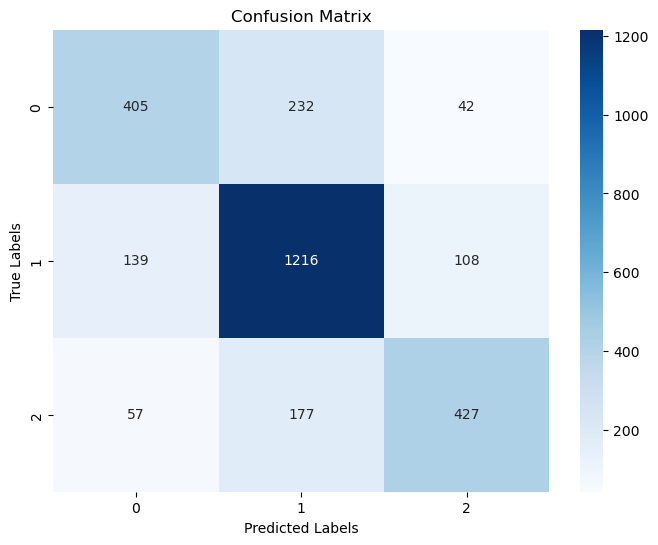

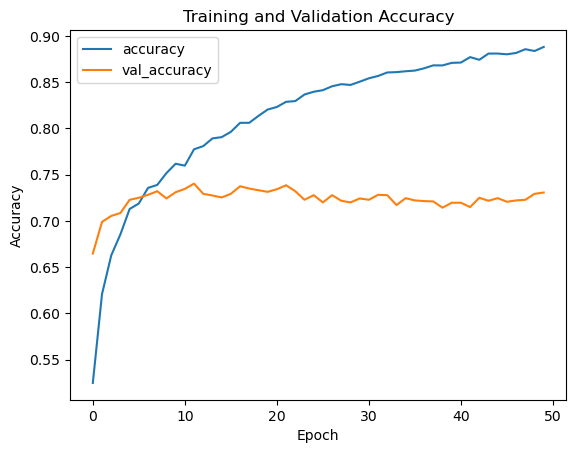

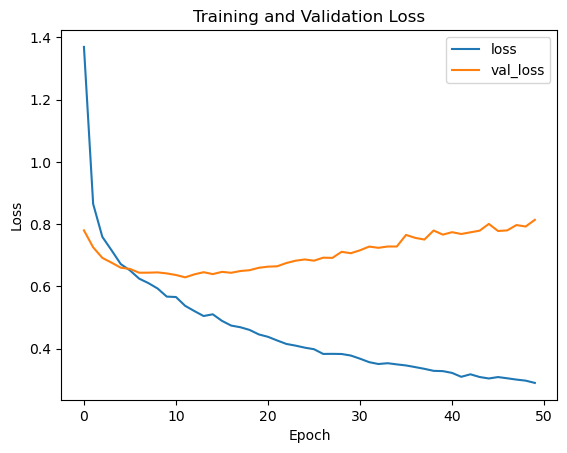

Fold 2
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2882 - accuracy: 0.8843 - val_loss: 0.8069 - val_accuracy: 0.7249
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2896 - accuracy: 0.8853 - val_loss: 0.8071 - val_accuracy: 0.7232
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2880 - accuracy: 0.8875 - val_loss: 0.8016 - val_accuracy: 0.7257
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2829 - accuracy: 0.8885 - val_loss: 0.8196 - val_accuracy: 0.7196
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2790 - accuracy: 0.8898 - val_loss: 0.8300 - val_accuracy: 0.7214
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2812 - accuracy: 0.8916 - val_loss: 0.8279 - val_accuracy: 0.7199
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2810 - accuracy: 0.8932 - val_loss: 0.8191 - val_accuracy: 0.7257

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7188726364609347, Validation F1 Score: 0.716296751703491


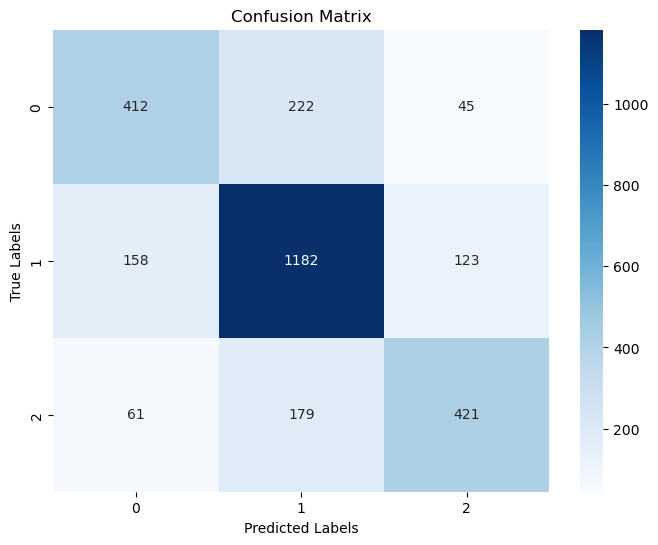

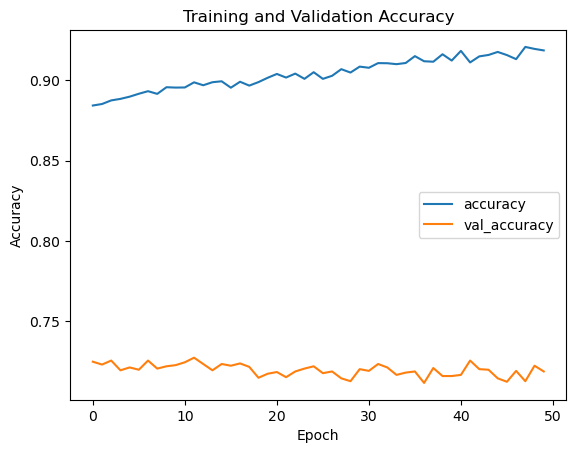

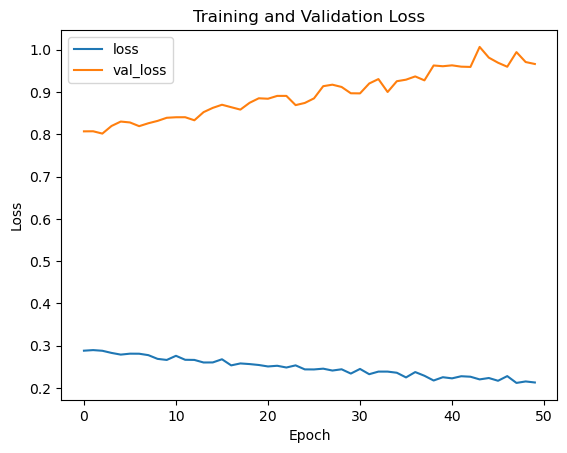

Fold 3
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2141 - accuracy: 0.9179 - val_loss: 0.9640 - val_accuracy: 0.7182
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2222 - accuracy: 0.9168 - val_loss: 0.9661 - val_accuracy: 0.7217
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2116 - accuracy: 0.9222 - val_loss: 0.9691 - val_accuracy: 0.7271
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2070 - accuracy: 0.9231 - val_loss: 0.9819 - val_accuracy: 0.7274
Epoch 5/50
216/216 [==============================] - 2s 8ms/step - loss: 0.2170 - accuracy: 0.9197 - val_loss: 0.9870 - val_accuracy: 0.7214
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2136 - accuracy: 0.9193 - val_loss: 0.9670 - val_accuracy: 0.7210
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2149 - accuracy: 0.9212 - val_loss: 1.0090 - val_accuracy: 0.7224

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7113806635747414, Validation F1 Score: 0.7060878537497401


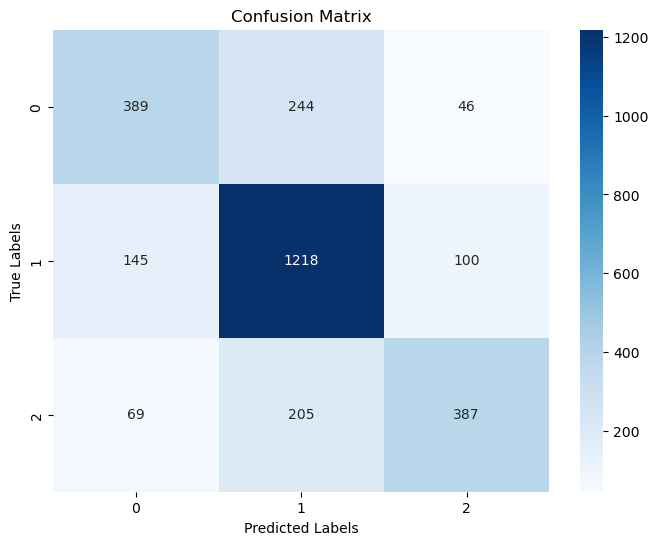

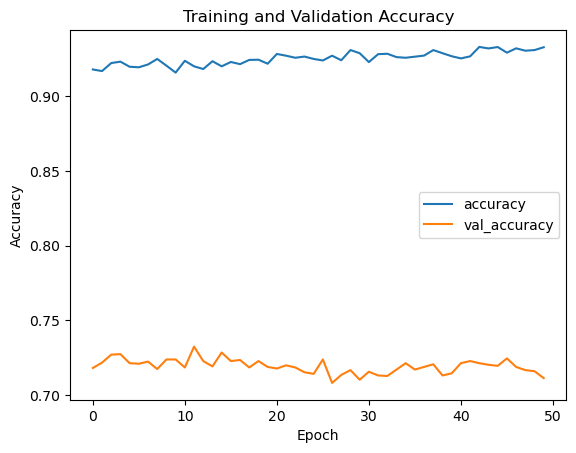

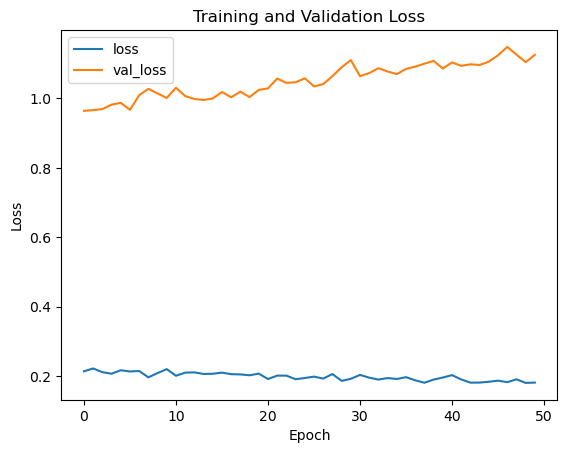

Fold 4
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1811 - accuracy: 0.9308 - val_loss: 1.1451 - val_accuracy: 0.7157
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1958 - accuracy: 0.9282 - val_loss: 1.1356 - val_accuracy: 0.7110
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1896 - accuracy: 0.9304 - val_loss: 1.1342 - val_accuracy: 0.7185
Epoch 4/50
216/216 [==============================] - 2s 11ms/step - loss: 0.1908 - accuracy: 0.9295 - val_loss: 1.1449 - val_accuracy: 0.7207
Epoch 5/50
216/216 [==============================] - 2s 10ms/step - loss: 0.1787 - accuracy: 0.9330 - val_loss: 1.1398 - val_accuracy: 0.7135
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1820 - accuracy: 0.9332 - val_loss: 1.1468 - val_accuracy: 0.7139
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1768 - accuracy: 0.9342 - val_loss: 1.1383 - val_accuracy: 0.71

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7145915090973957, Validation F1 Score: 0.7107163416216251


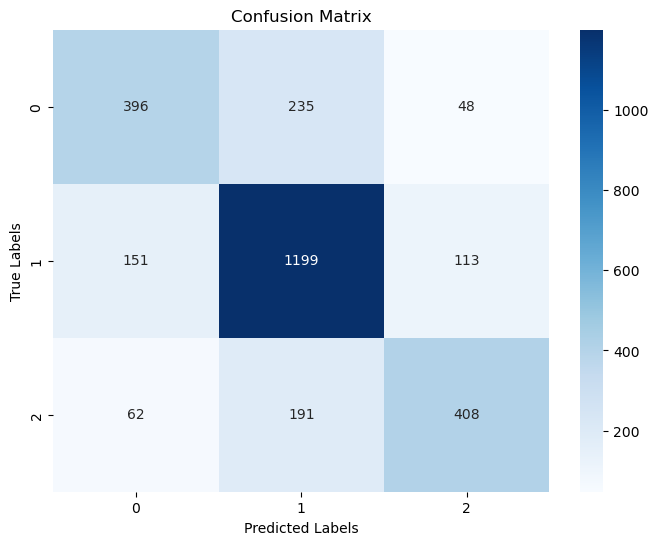

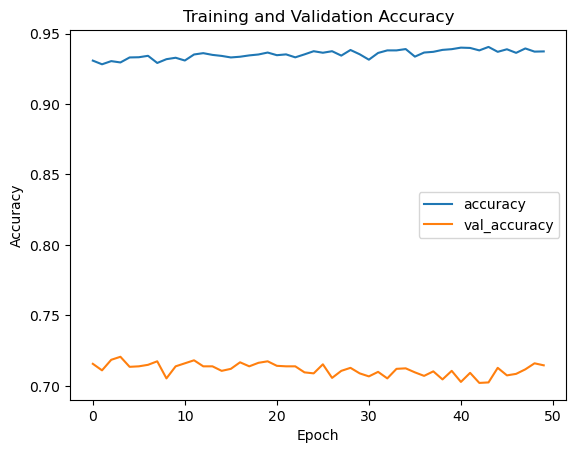

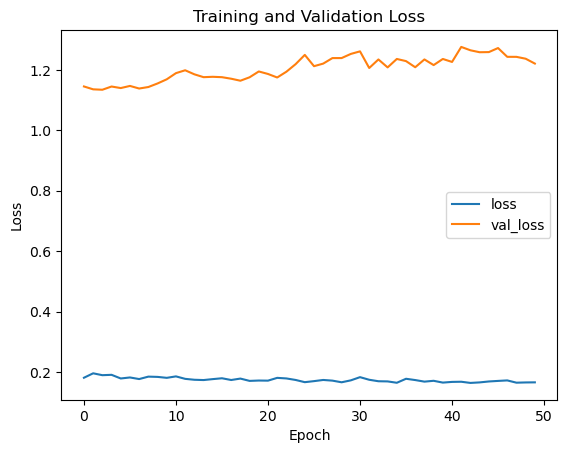

Fold 5
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1623 - accuracy: 0.9410 - val_loss: 1.2566 - val_accuracy: 0.7103
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1669 - accuracy: 0.9385 - val_loss: 1.2617 - val_accuracy: 0.7046
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1599 - accuracy: 0.9406 - val_loss: 1.2679 - val_accuracy: 0.7121
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1618 - accuracy: 0.9395 - val_loss: 1.2616 - val_accuracy: 0.7082
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1655 - accuracy: 0.9376 - val_loss: 1.2591 - val_accuracy: 0.7057
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1639 - accuracy: 0.9385 - val_loss: 1.2724 - val_accuracy: 0.7046
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1660 - accuracy: 0.9379 - val_loss: 1.2463 - val_accuracy: 0.7075

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7103103817338566, Validation F1 Score: 0.7077318431435591


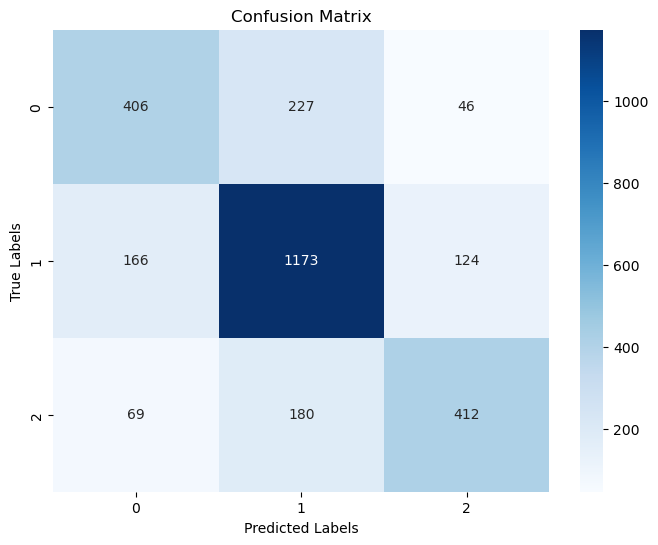

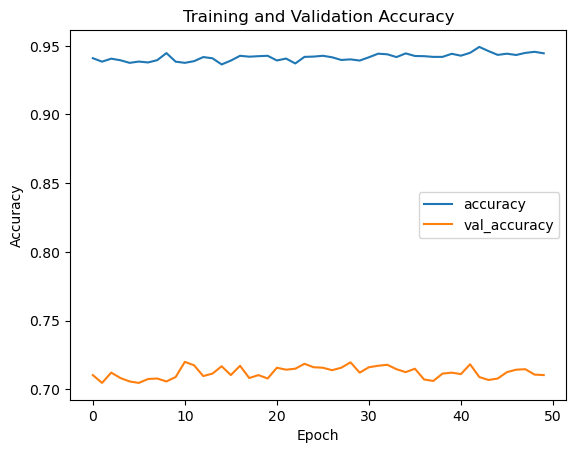

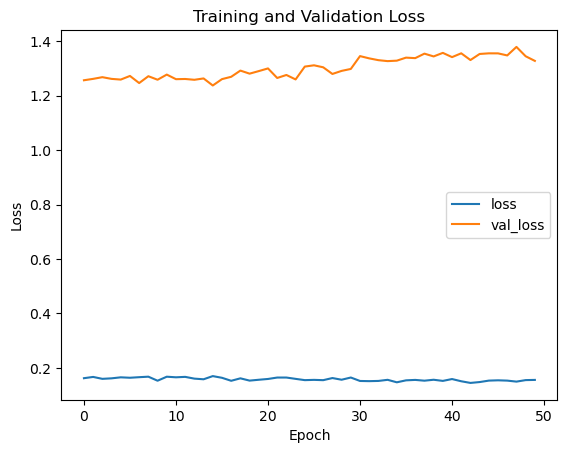

Fold 6
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1489 - accuracy: 0.9438 - val_loss: 1.3614 - val_accuracy: 0.7117
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1505 - accuracy: 0.9460 - val_loss: 1.3752 - val_accuracy: 0.7050
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1493 - accuracy: 0.9448 - val_loss: 1.3485 - val_accuracy: 0.7057
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1481 - accuracy: 0.9467 - val_loss: 1.3425 - val_accuracy: 0.7071
Epoch 5/50
216/216 [==============================] - 2s 8ms/step - loss: 0.1473 - accuracy: 0.9447 - val_loss: 1.3674 - val_accuracy: 0.7075
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1517 - accuracy: 0.9446 - val_loss: 1.3795 - val_accuracy: 0.7132
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1487 - accuracy: 0.9471 - val_loss: 1.3553 - val_accuracy: 0.7149

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6992508027113806, Validation F1 Score: 0.6946589118685855


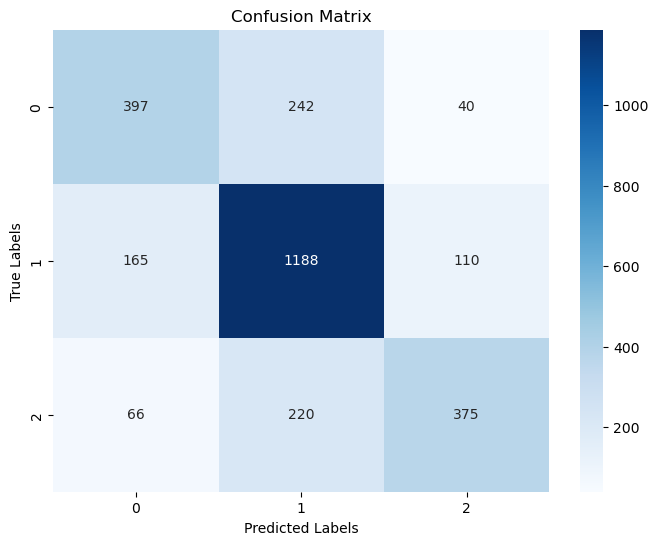

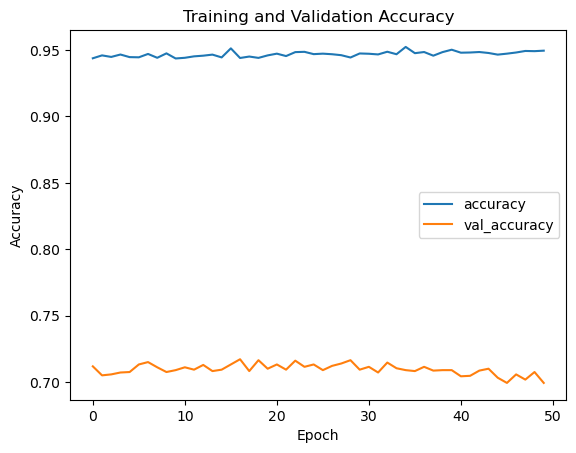

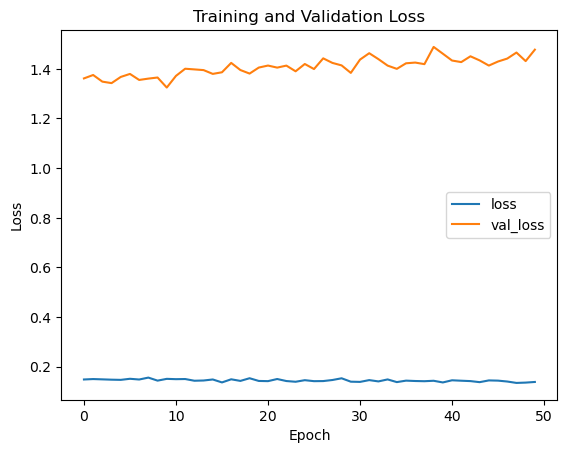

Fold 7
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1338 - accuracy: 0.9506 - val_loss: 1.4666 - val_accuracy: 0.7028
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1440 - accuracy: 0.9477 - val_loss: 1.4654 - val_accuracy: 0.7039
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1441 - accuracy: 0.9475 - val_loss: 1.4617 - val_accuracy: 0.7057
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1402 - accuracy: 0.9472 - val_loss: 1.4540 - val_accuracy: 0.7010
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1479 - accuracy: 0.9474 - val_loss: 1.4768 - val_accuracy: 0.6996
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1361 - accuracy: 0.9485 - val_loss: 1.4759 - val_accuracy: 0.7060
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1320 - accuracy: 0.9518 - val_loss: 1.4821 - val_accuracy: 0.7064

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.703888690688548, Validation F1 Score: 0.6989215846040431


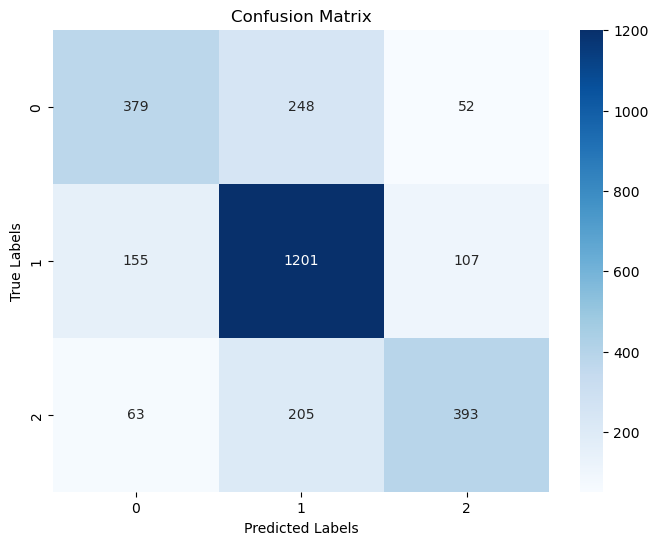

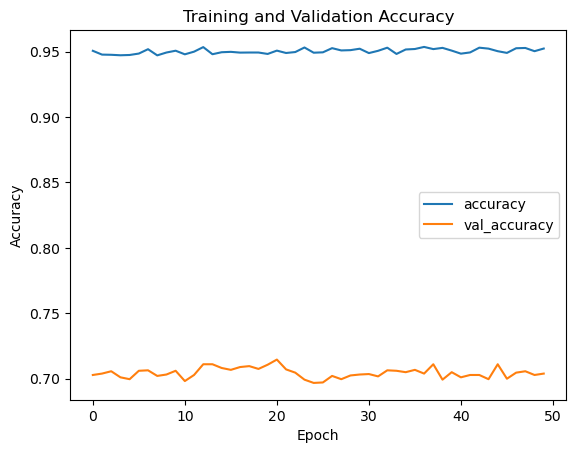

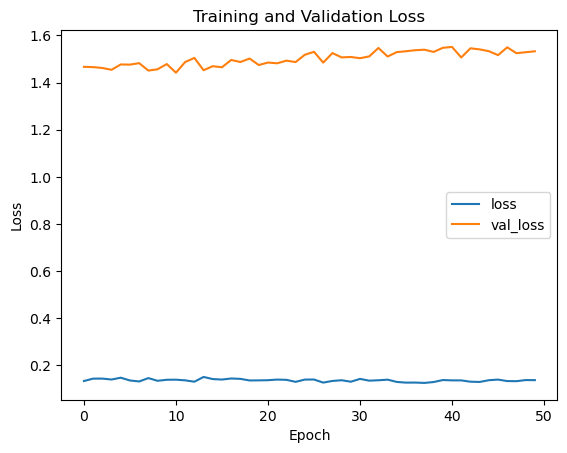

Fold 8
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1315 - accuracy: 0.9533 - val_loss: 1.5437 - val_accuracy: 0.7014
Epoch 2/50
216/216 [==============================] - 2s 8ms/step - loss: 0.1253 - accuracy: 0.9538 - val_loss: 1.5769 - val_accuracy: 0.7057
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1320 - accuracy: 0.9525 - val_loss: 1.5612 - val_accuracy: 0.7075
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1353 - accuracy: 0.9501 - val_loss: 1.5617 - val_accuracy: 0.7053
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1309 - accuracy: 0.9517 - val_loss: 1.6087 - val_accuracy: 0.7007
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1355 - accuracy: 0.9523 - val_loss: 1.5500 - val_accuracy: 0.7035
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1361 - accuracy: 0.9509 - val_loss: 1.5627 - val_accuracy: 0.7042

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


88/88 [==============================] - 0s 2ms/step
Validation Accuracy: 0.702461648234035, Validation F1 Score: 0.698837068325691


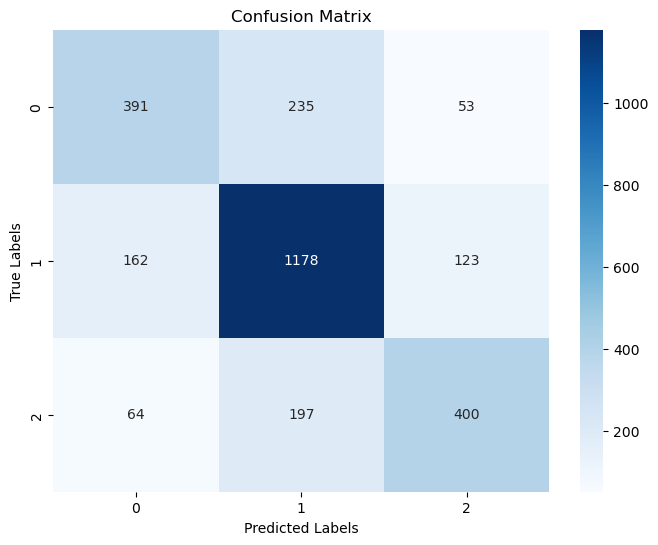

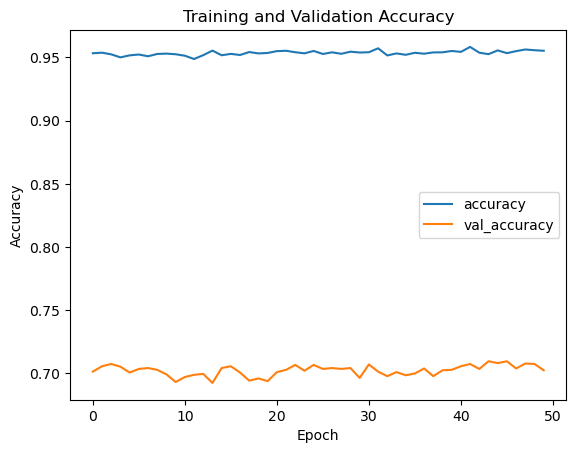

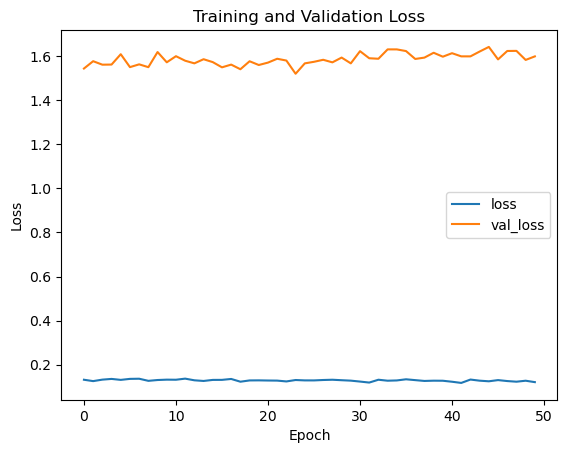

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7114252586514449
Mean F1 Score: 0.7075347940977019
Number of Epochs: 50, Test Size: 0.2, Validation Size: 0.2
Fold 1
Epoch 1/50
216/216 [==============================] - 2s 8ms/step - loss: 1.4842 - accuracy: 0.5253 - val_loss: 0.7944 - val_accuracy: 0.6602
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.9046 - accuracy: 0.6176 - val_loss: 0.7431 - val_accuracy: 0.6768
Epoch 3/50
216/216 [==============================] - 2s 8ms/step - loss: 0.7764 - accuracy: 0.6622 - val_loss: 0.7036 - val_accuracy: 0.6942
Epoch 4/50
216/216 [==============================] - 2s 8ms/step - loss: 0.7188 - accuracy: 0.6873 - val_loss: 0.6832 - val_accuracy: 0.7085
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.6882 - accuracy: 0.7054 - val_loss: 0.6722 - val_accuracy: 0.7174
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.6571 - accuracy: 0.7173 - val_loss: 0.6579 - val_accuracy: 0.7248
Epoch 7/50
216

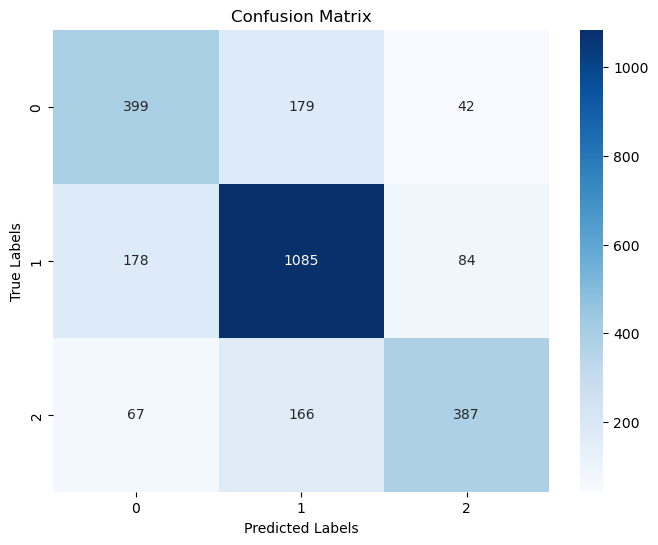

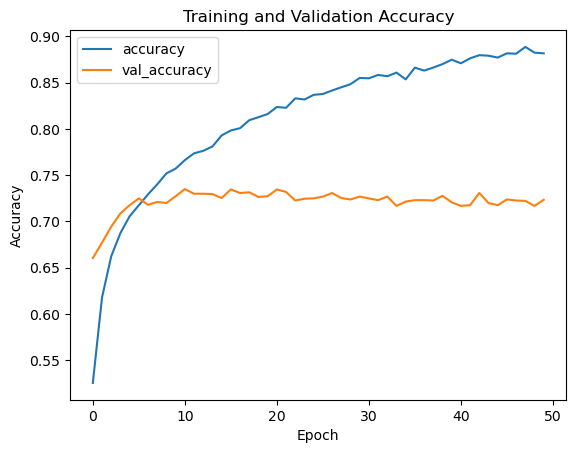

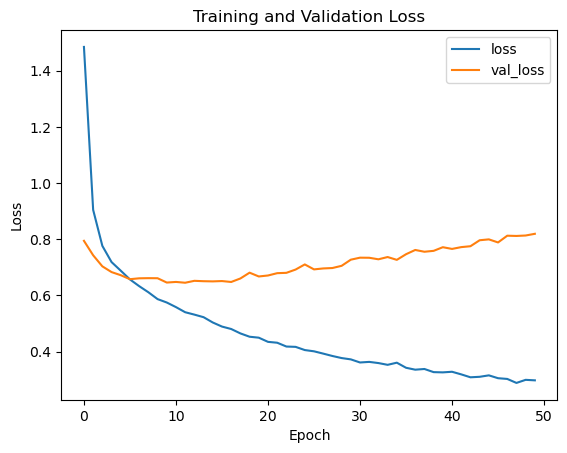

Fold 2
Epoch 1/50
216/216 [==============================] - 2s 8ms/step - loss: 0.2861 - accuracy: 0.8878 - val_loss: 0.8113 - val_accuracy: 0.7194
Epoch 2/50
216/216 [==============================] - 2s 8ms/step - loss: 0.2937 - accuracy: 0.8884 - val_loss: 0.8236 - val_accuracy: 0.7174
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2801 - accuracy: 0.8955 - val_loss: 0.8264 - val_accuracy: 0.7178
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2790 - accuracy: 0.8934 - val_loss: 0.8407 - val_accuracy: 0.7182
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2787 - accuracy: 0.8884 - val_loss: 0.8327 - val_accuracy: 0.7263
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2763 - accuracy: 0.8940 - val_loss: 0.8309 - val_accuracy: 0.7244
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2835 - accuracy: 0.8900 - val_loss: 0.8438 - val_accuracy: 0.7252

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7189795129493622, Validation F1 Score: 0.7178345701498716


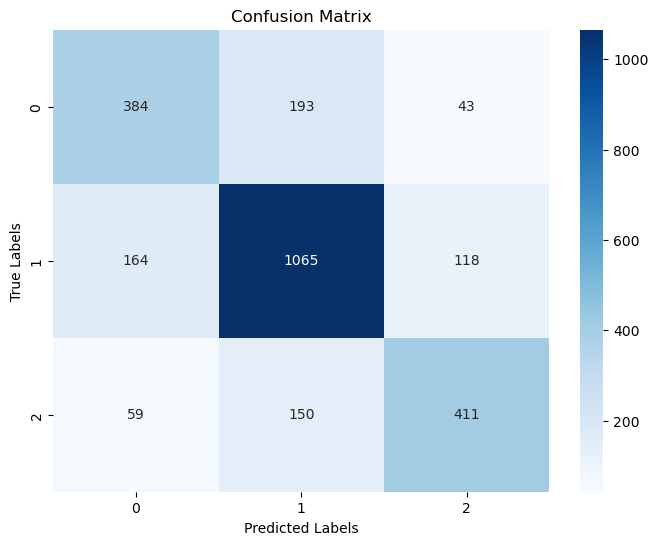

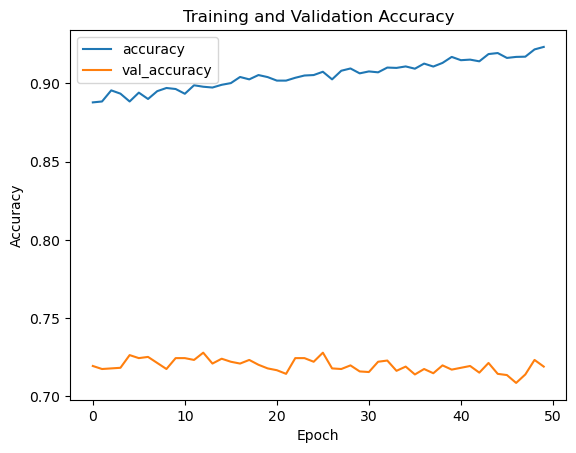

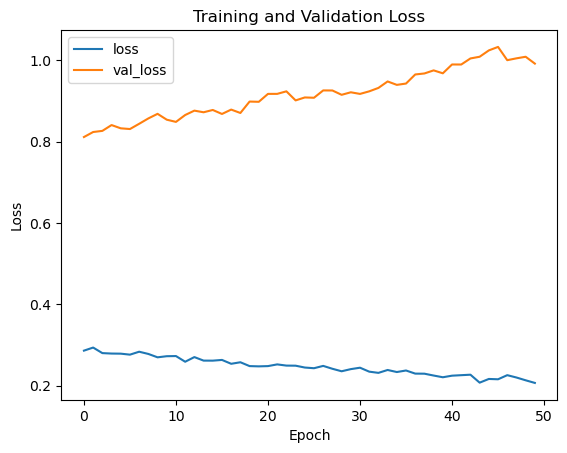

Fold 3
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2096 - accuracy: 0.9200 - val_loss: 1.0046 - val_accuracy: 0.7213
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2131 - accuracy: 0.9183 - val_loss: 1.0261 - val_accuracy: 0.7194
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2094 - accuracy: 0.9203 - val_loss: 1.0375 - val_accuracy: 0.7236
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2081 - accuracy: 0.9228 - val_loss: 1.0397 - val_accuracy: 0.7182
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2120 - accuracy: 0.9177 - val_loss: 1.0316 - val_accuracy: 0.7194
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2074 - accuracy: 0.9222 - val_loss: 1.0399 - val_accuracy: 0.7228
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2121 - accuracy: 0.9197 - val_loss: 1.0128 - val_accuracy: 0.7190

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7147274835717047, Validation F1 Score: 0.7112670440780716


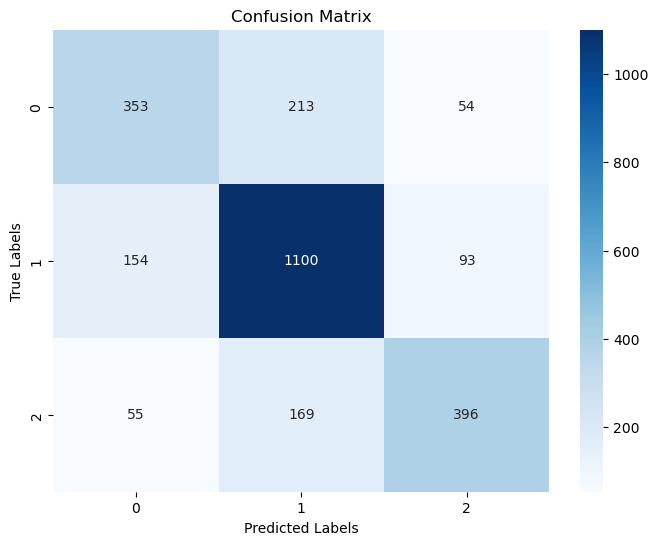

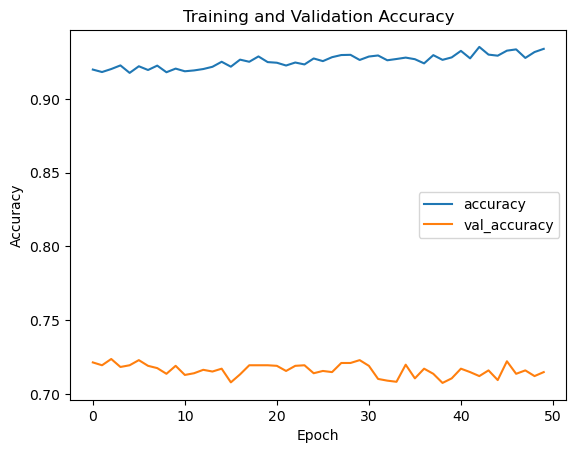

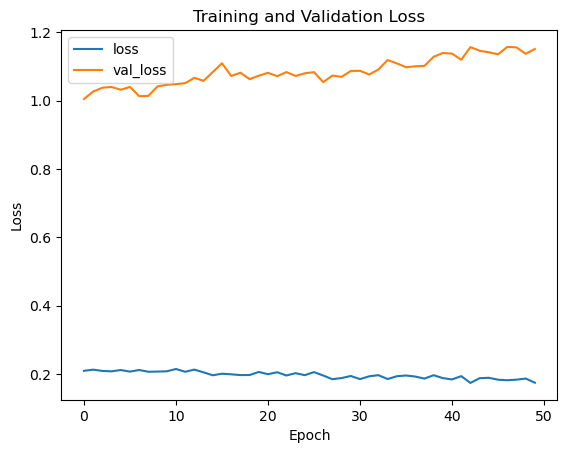

Fold 4
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1770 - accuracy: 0.9357 - val_loss: 1.1207 - val_accuracy: 0.7159
Epoch 2/50
216/216 [==============================] - 2s 8ms/step - loss: 0.1799 - accuracy: 0.9316 - val_loss: 1.1281 - val_accuracy: 0.7194
Epoch 3/50
216/216 [==============================] - 2s 8ms/step - loss: 0.1807 - accuracy: 0.9301 - val_loss: 1.1692 - val_accuracy: 0.7078
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1812 - accuracy: 0.9317 - val_loss: 1.1894 - val_accuracy: 0.7109
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1786 - accuracy: 0.9346 - val_loss: 1.1912 - val_accuracy: 0.7167
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1775 - accuracy: 0.9340 - val_loss: 1.1867 - val_accuracy: 0.7101
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1836 - accuracy: 0.9317 - val_loss: 1.1618 - val_accuracy: 0.7124

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7127947429454967, Validation F1 Score: 0.707577400569163


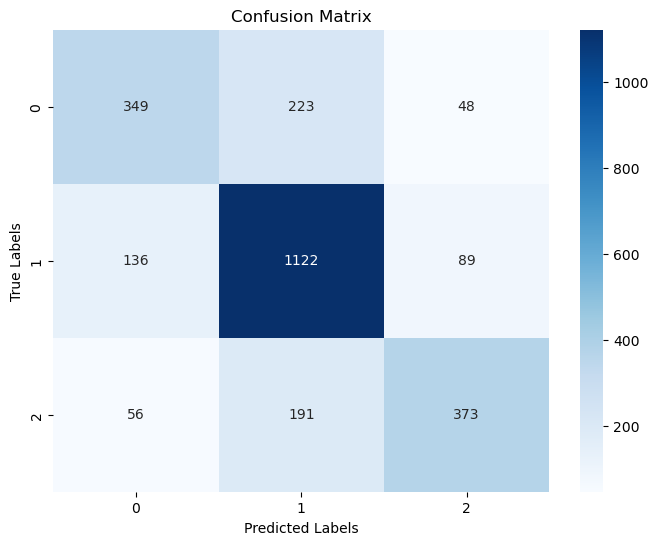

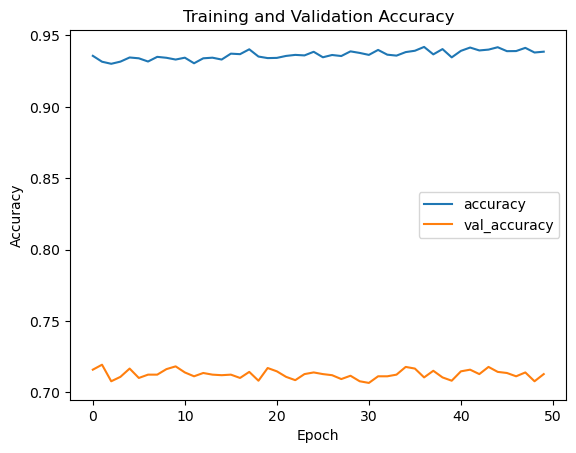

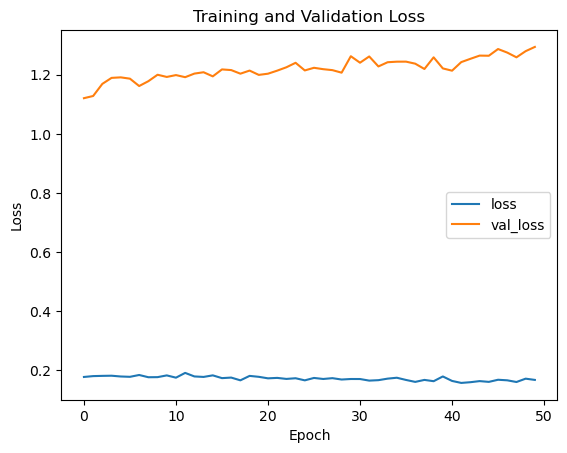

Fold 5
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1671 - accuracy: 0.9397 - val_loss: 1.2789 - val_accuracy: 0.7155
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1552 - accuracy: 0.9406 - val_loss: 1.2996 - val_accuracy: 0.7140
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1699 - accuracy: 0.9369 - val_loss: 1.2803 - val_accuracy: 0.7120
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1473 - accuracy: 0.9464 - val_loss: 1.3129 - val_accuracy: 0.7078
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1627 - accuracy: 0.9398 - val_loss: 1.2983 - val_accuracy: 0.7109
Epoch 6/50
216/216 [==============================] - 2s 8ms/step - loss: 0.1649 - accuracy: 0.9377 - val_loss: 1.2755 - val_accuracy: 0.7124
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1662 - accuracy: 0.9392 - val_loss: 1.2819 - val_accuracy: 0.7120

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7104754541940471, Validation F1 Score: 0.7086588628754292


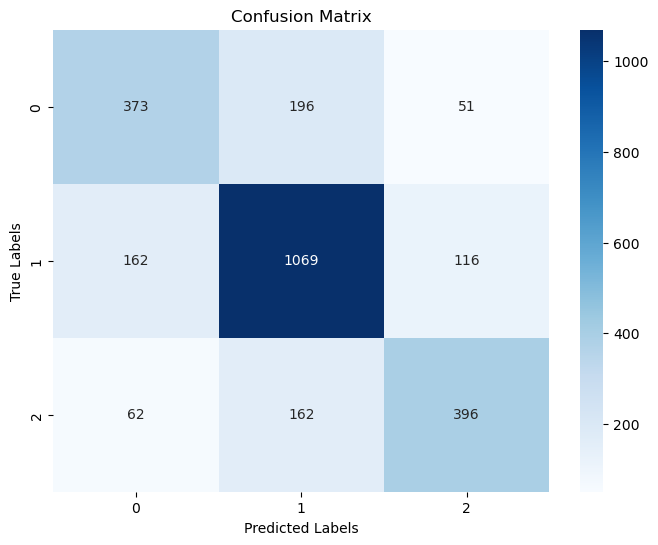

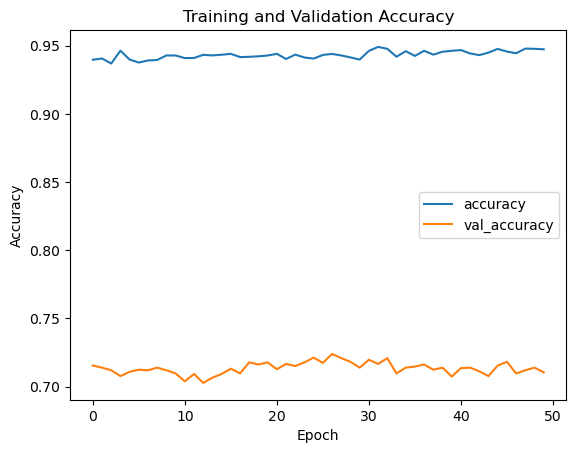

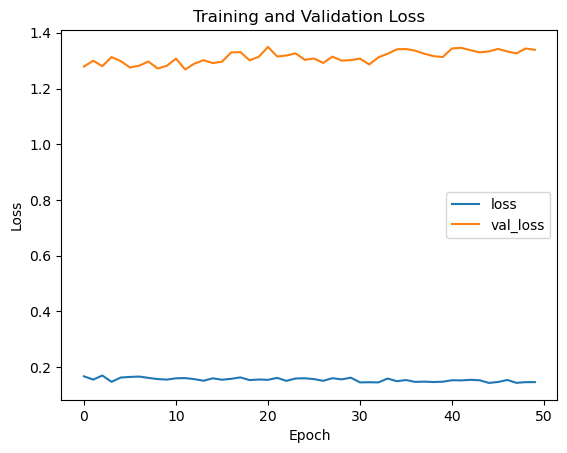

Fold 6
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1484 - accuracy: 0.9482 - val_loss: 1.3261 - val_accuracy: 0.7105
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1486 - accuracy: 0.9478 - val_loss: 1.3591 - val_accuracy: 0.7089
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1483 - accuracy: 0.9440 - val_loss: 1.3513 - val_accuracy: 0.7116
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1496 - accuracy: 0.9467 - val_loss: 1.3542 - val_accuracy: 0.7159
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1440 - accuracy: 0.9470 - val_loss: 1.3848 - val_accuracy: 0.7109
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1592 - accuracy: 0.9427 - val_loss: 1.3703 - val_accuracy: 0.7089
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1581 - accuracy: 0.9442 - val_loss: 1.3821 - val_accuracy: 0.7078

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7069965210668728, Validation F1 Score: 0.7035676171521329


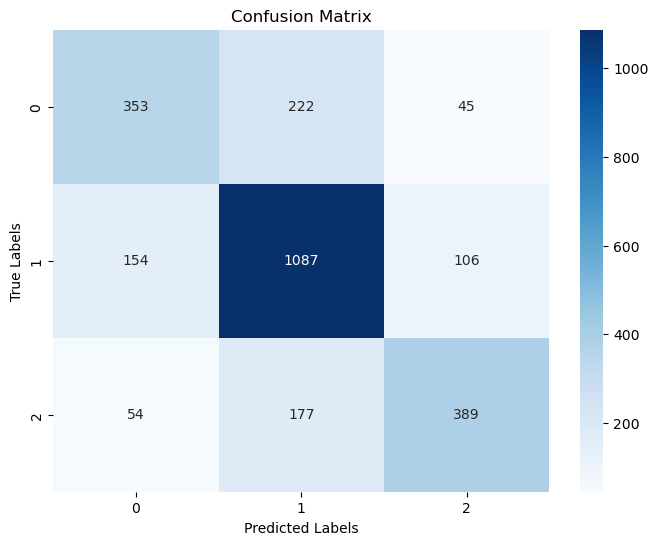

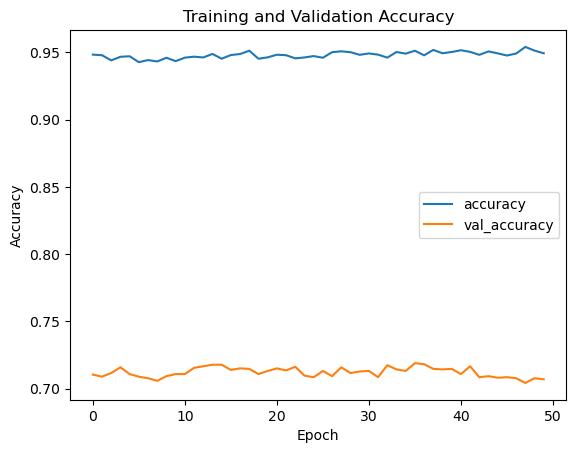

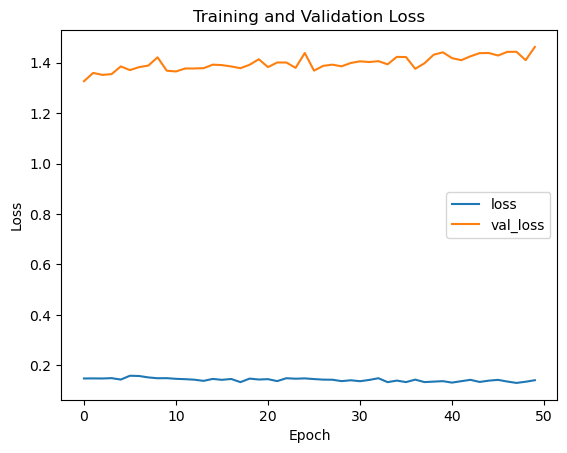

Fold 7
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1444 - accuracy: 0.9478 - val_loss: 1.4440 - val_accuracy: 0.7085
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1340 - accuracy: 0.9508 - val_loss: 1.4337 - val_accuracy: 0.7124
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1509 - accuracy: 0.9484 - val_loss: 1.4411 - val_accuracy: 0.7085
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1352 - accuracy: 0.9516 - val_loss: 1.4344 - val_accuracy: 0.7124
Epoch 5/50
216/216 [==============================] - 2s 8ms/step - loss: 0.1283 - accuracy: 0.9530 - val_loss: 1.4541 - val_accuracy: 0.7170
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1352 - accuracy: 0.9488 - val_loss: 1.4299 - val_accuracy: 0.7147
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1338 - accuracy: 0.9525 - val_loss: 1.4489 - val_accuracy: 0.7078

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7116350985697719, Validation F1 Score: 0.708121412010403


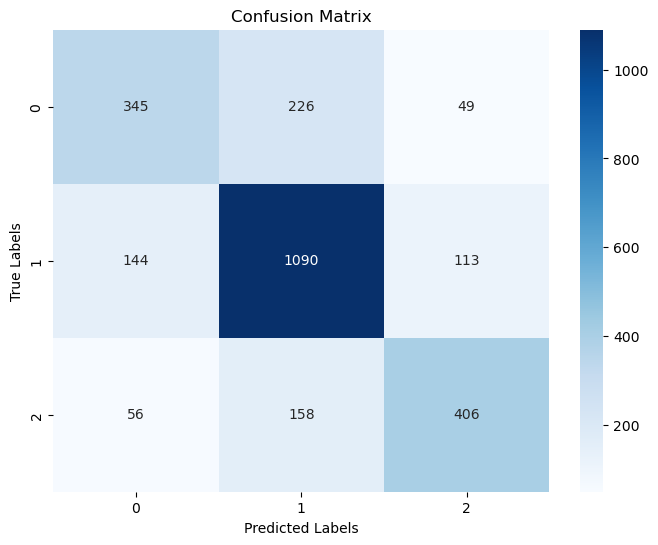

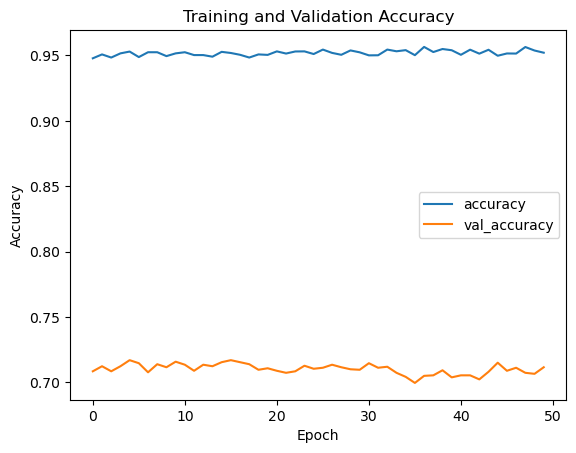

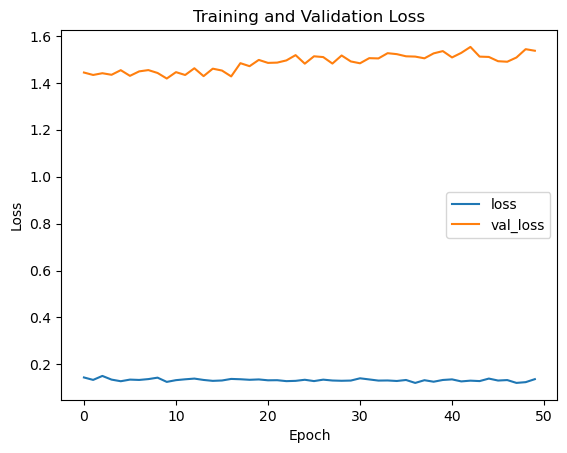

Fold 8
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1221 - accuracy: 0.9556 - val_loss: 1.5915 - val_accuracy: 0.7066
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1309 - accuracy: 0.9535 - val_loss: 1.5358 - val_accuracy: 0.7089
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1329 - accuracy: 0.9518 - val_loss: 1.5468 - val_accuracy: 0.7078
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1330 - accuracy: 0.9498 - val_loss: 1.5646 - val_accuracy: 0.7097
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1277 - accuracy: 0.9542 - val_loss: 1.5404 - val_accuracy: 0.7058
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1281 - accuracy: 0.9530 - val_loss: 1.5394 - val_accuracy: 0.7132
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1322 - accuracy: 0.9523 - val_loss: 1.5509 - val_accuracy: 0.7155

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


81/81 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7089292616930808, Validation F1 Score: 0.7062743587472076


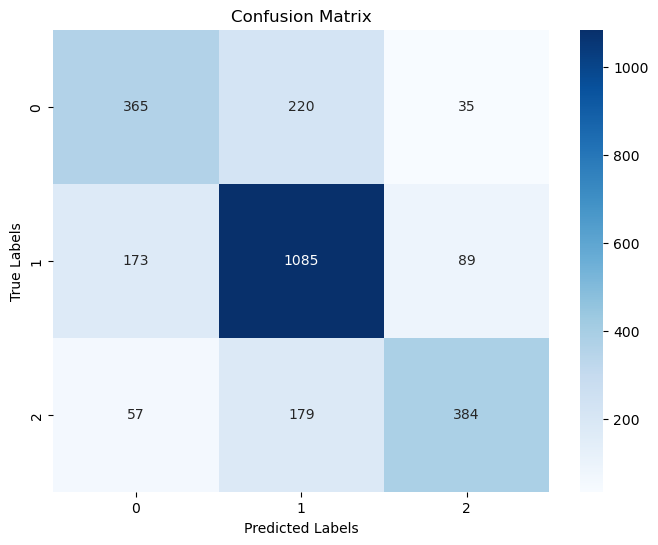

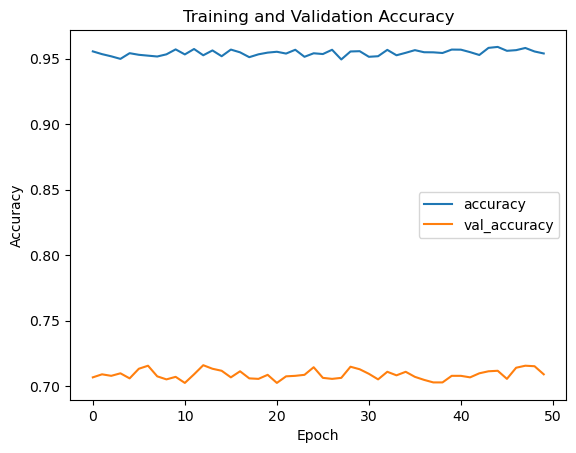

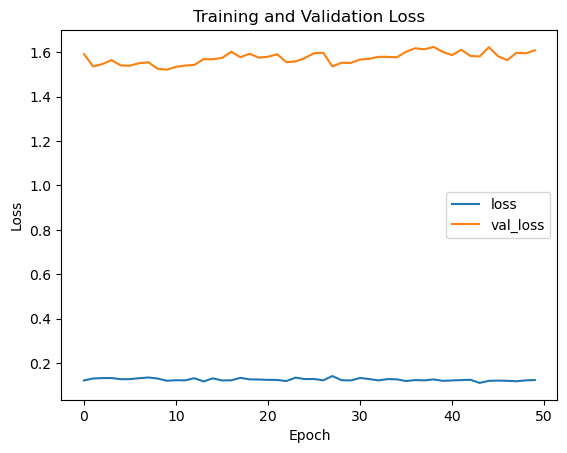

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7134712021646694
Mean F1 Score: 0.7106495770675926
Number of Epochs: 50, Test Size: 0.2, Validation Size: 0.25
Fold 1
Epoch 1/50
216/216 [==============================] - 2s 8ms/step - loss: 1.5855 - accuracy: 0.5174 - val_loss: 0.7944 - val_accuracy: 0.6588
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.9326 - accuracy: 0.6154 - val_loss: 0.7362 - val_accuracy: 0.6849
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.7894 - accuracy: 0.6553 - val_loss: 0.7075 - val_accuracy: 0.7001
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.7140 - accuracy: 0.6888 - val_loss: 0.6816 - val_accuracy: 0.7065
Epoch 5/50
216/216 [==============================] - 1s 7ms/step - loss: 0.6834 - accuracy: 0.7063 - val_loss: 0.6696 - val_accuracy: 0.7178
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.6550 - accuracy: 0.7214 - val_loss: 0.6581 - val_accuracy: 0.7208
Epoch 7/50
21

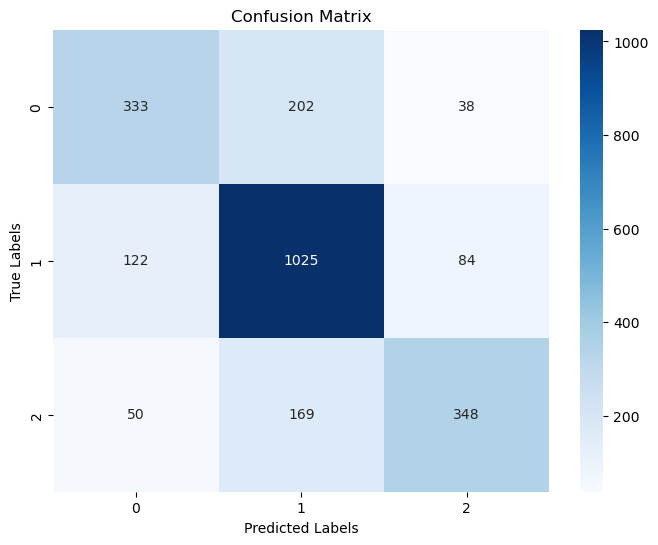

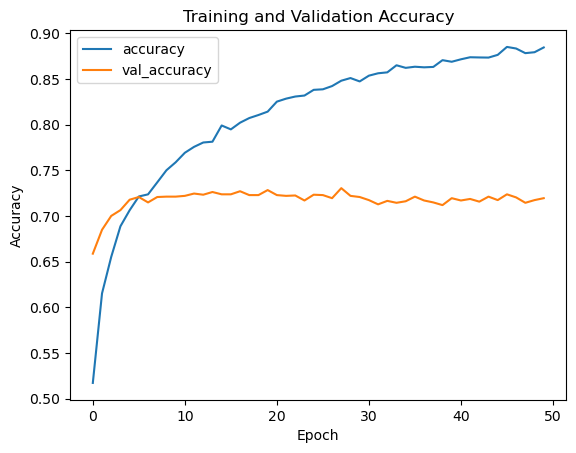

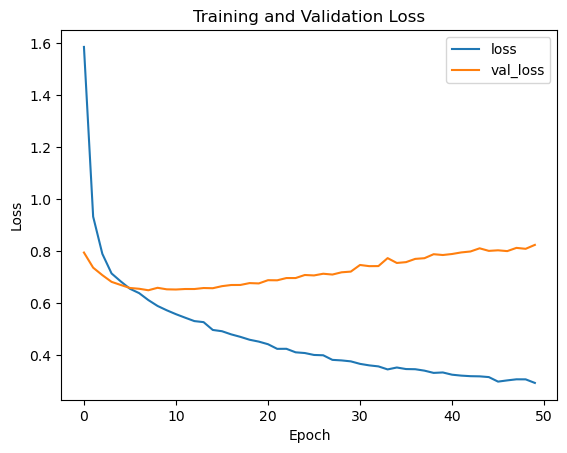

Fold 2
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2893 - accuracy: 0.8891 - val_loss: 0.8242 - val_accuracy: 0.7111
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2985 - accuracy: 0.8857 - val_loss: 0.8387 - val_accuracy: 0.7056
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2895 - accuracy: 0.8885 - val_loss: 0.8343 - val_accuracy: 0.7174
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2788 - accuracy: 0.8918 - val_loss: 0.8536 - val_accuracy: 0.7153
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2890 - accuracy: 0.8870 - val_loss: 0.8599 - val_accuracy: 0.7174
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2883 - accuracy: 0.8903 - val_loss: 0.8474 - val_accuracy: 0.7221
Epoch 7/50
216/216 [==============================] - 2s 8ms/step - loss: 0.2810 - accuracy: 0.8890 - val_loss: 0.8563 - val_accuracy: 0.7195

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7186840995360607, Validation F1 Score: 0.7159045326997174


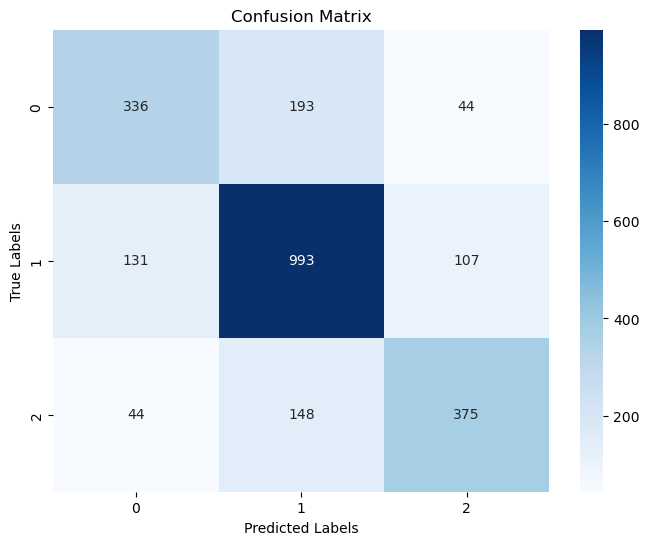

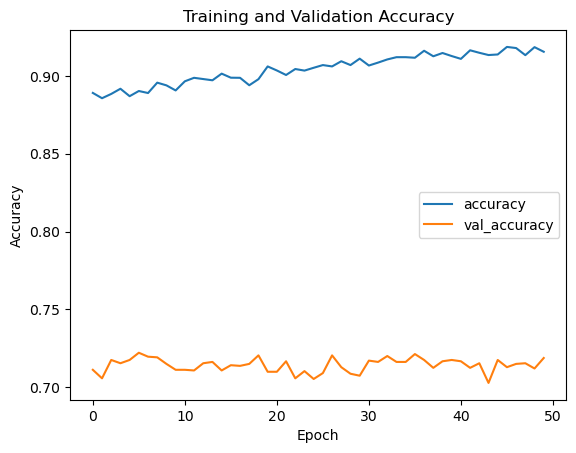

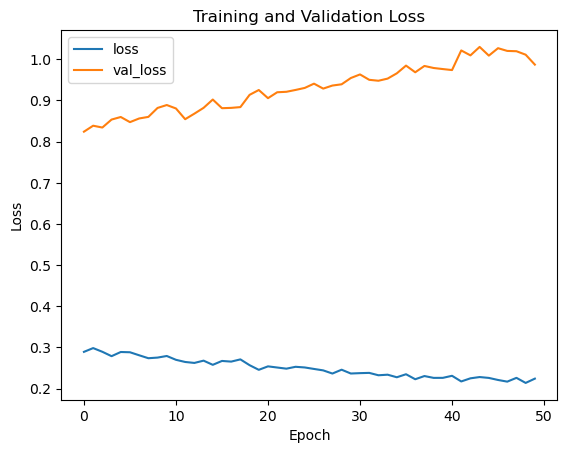

Fold 3
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2227 - accuracy: 0.9147 - val_loss: 1.0064 - val_accuracy: 0.7145
Epoch 2/50
216/216 [==============================] - 2s 8ms/step - loss: 0.2101 - accuracy: 0.9221 - val_loss: 1.0364 - val_accuracy: 0.7022
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2130 - accuracy: 0.9198 - val_loss: 1.0139 - val_accuracy: 0.7115
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2154 - accuracy: 0.9150 - val_loss: 1.0186 - val_accuracy: 0.7157
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2134 - accuracy: 0.9206 - val_loss: 1.0182 - val_accuracy: 0.7128
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2031 - accuracy: 0.9216 - val_loss: 1.0304 - val_accuracy: 0.7149
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.2122 - accuracy: 0.9211 - val_loss: 1.0161 - val_accuracy: 0.7136

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7132011809363138, Validation F1 Score: 0.7093241215417091


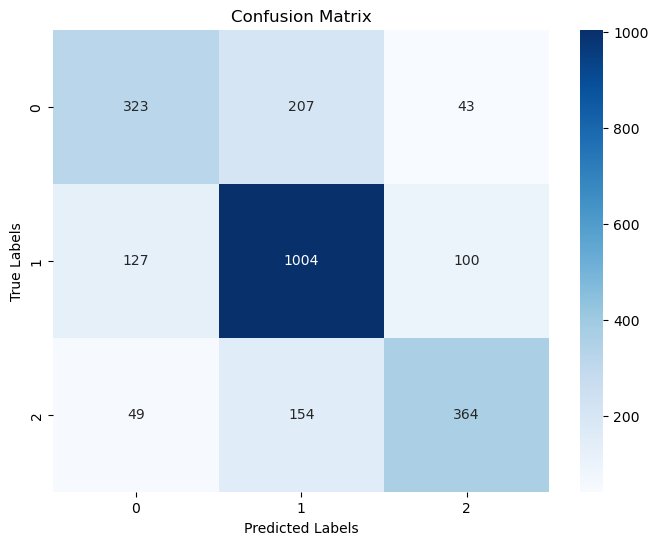

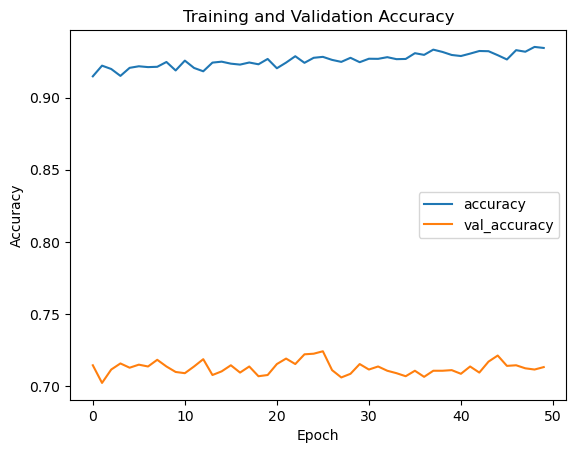

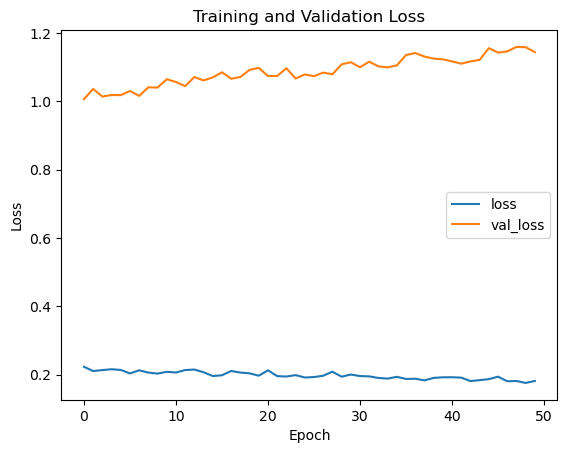

Fold 4
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1830 - accuracy: 0.9314 - val_loss: 1.1675 - val_accuracy: 0.7060
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1836 - accuracy: 0.9330 - val_loss: 1.1804 - val_accuracy: 0.7069
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1768 - accuracy: 0.9330 - val_loss: 1.1481 - val_accuracy: 0.7136
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1817 - accuracy: 0.9322 - val_loss: 1.1435 - val_accuracy: 0.7069
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1777 - accuracy: 0.9359 - val_loss: 1.1465 - val_accuracy: 0.7043
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1864 - accuracy: 0.9282 - val_loss: 1.1666 - val_accuracy: 0.7048
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1685 - accuracy: 0.9369 - val_loss: 1.2085 - val_accuracy: 0.7077

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7089835512442008, Validation F1 Score: 0.7054251370885355


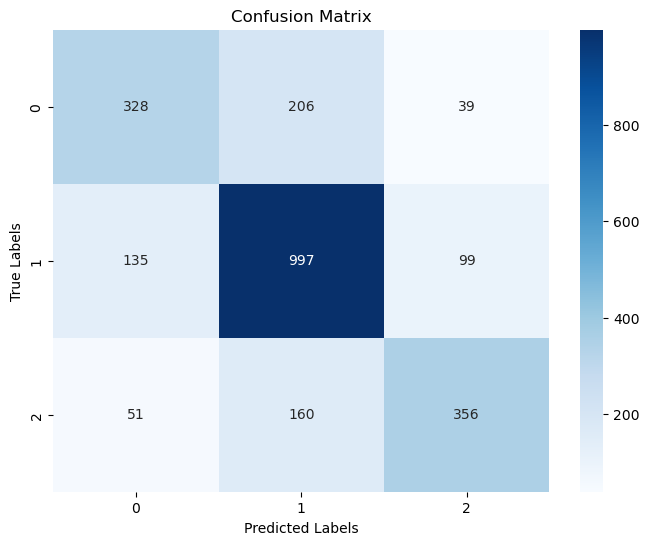

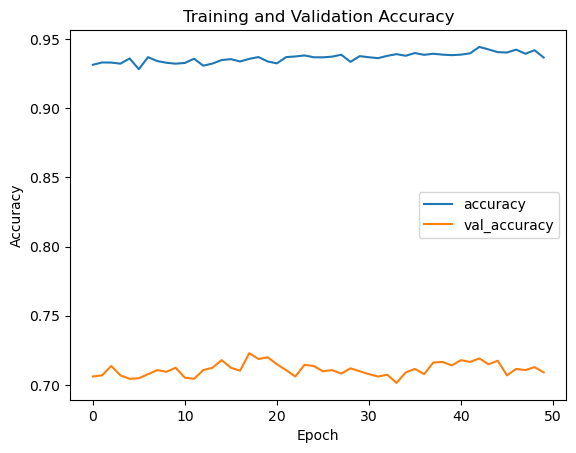

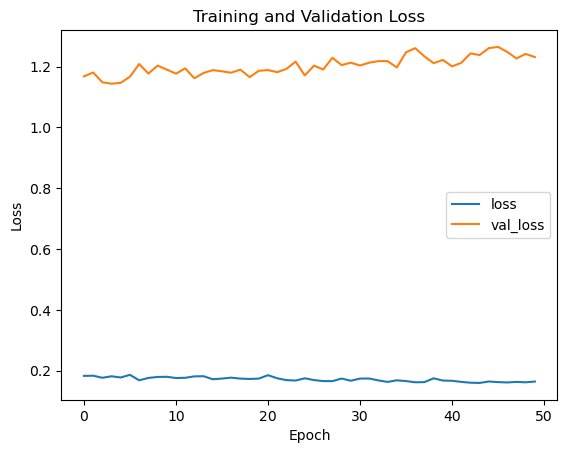

Fold 5
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1589 - accuracy: 0.9419 - val_loss: 1.2586 - val_accuracy: 0.7128
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1575 - accuracy: 0.9398 - val_loss: 1.2493 - val_accuracy: 0.7149
Epoch 3/50
216/216 [==============================] - 1s 7ms/step - loss: 0.1651 - accuracy: 0.9411 - val_loss: 1.2611 - val_accuracy: 0.7119
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1567 - accuracy: 0.9422 - val_loss: 1.2647 - val_accuracy: 0.7094
Epoch 5/50
216/216 [==============================] - 1s 7ms/step - loss: 0.1545 - accuracy: 0.9439 - val_loss: 1.2747 - val_accuracy: 0.7140
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1575 - accuracy: 0.9423 - val_loss: 1.2904 - val_accuracy: 0.7090
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1588 - accuracy: 0.9414 - val_loss: 1.2582 - val_accuracy: 0.7145

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7127794179671025, Validation F1 Score: 0.7092414375399057


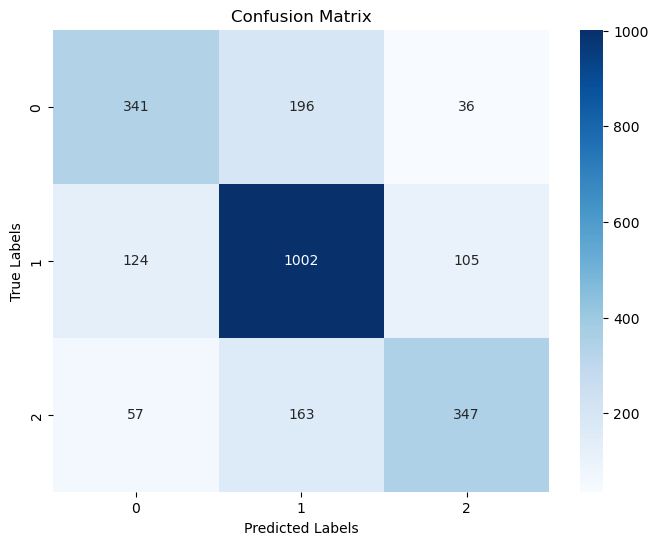

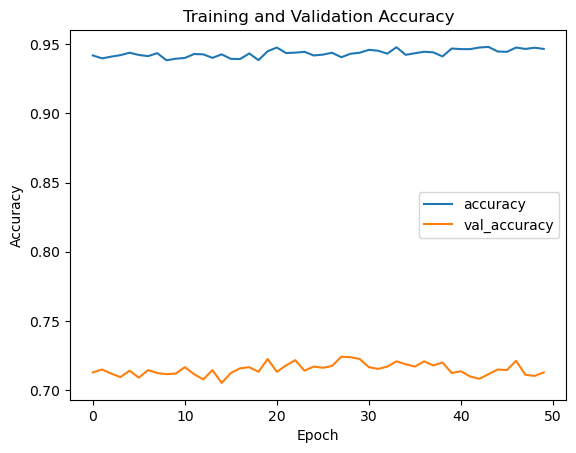

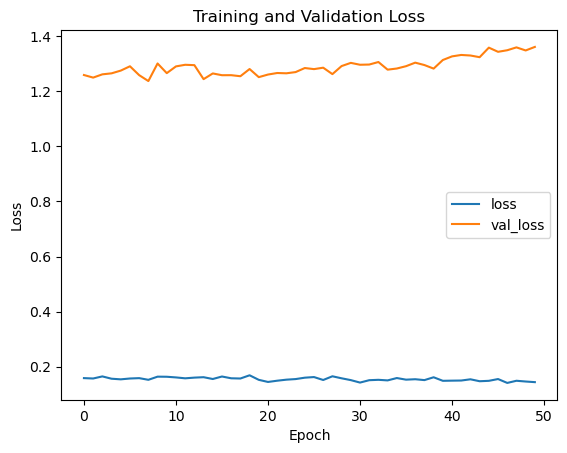

Fold 6
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1504 - accuracy: 0.9437 - val_loss: 1.3374 - val_accuracy: 0.7178
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1464 - accuracy: 0.9472 - val_loss: 1.3300 - val_accuracy: 0.7132
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1435 - accuracy: 0.9468 - val_loss: 1.3505 - val_accuracy: 0.7195
Epoch 4/50
216/216 [==============================] - 1s 7ms/step - loss: 0.1501 - accuracy: 0.9462 - val_loss: 1.3333 - val_accuracy: 0.7208
Epoch 5/50
216/216 [==============================] - 1s 7ms/step - loss: 0.1506 - accuracy: 0.9446 - val_loss: 1.3450 - val_accuracy: 0.7187
Epoch 6/50
216/216 [==============================] - 1s 7ms/step - loss: 0.1537 - accuracy: 0.9431 - val_loss: 1.3297 - val_accuracy: 0.7191
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1491 - accuracy: 0.9448 - val_loss: 1.3521 - val_accuracy: 0.7183

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7169970476592156, Validation F1 Score: 0.7135103171708623


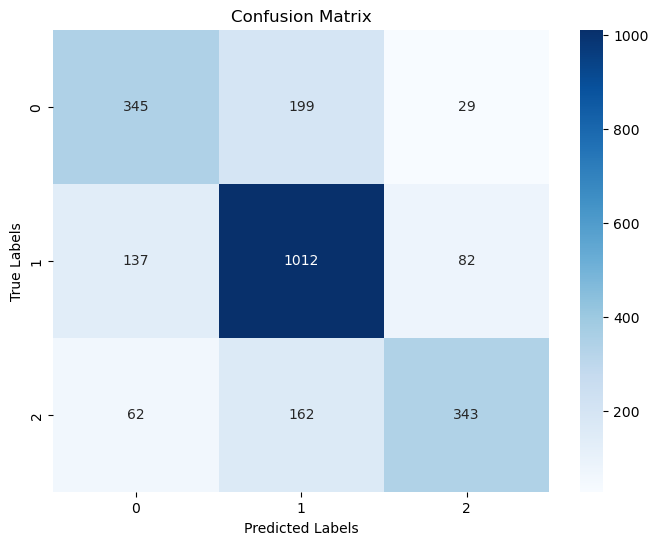

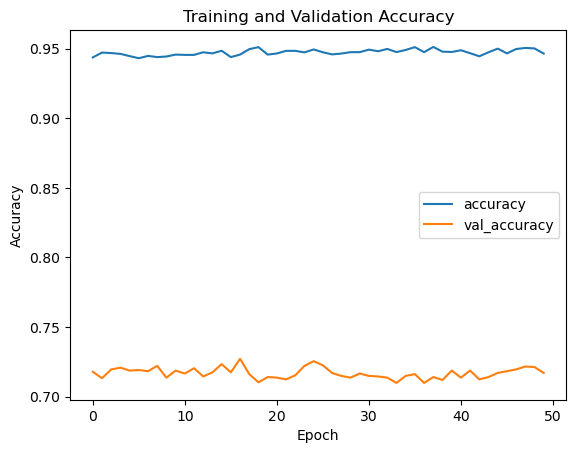

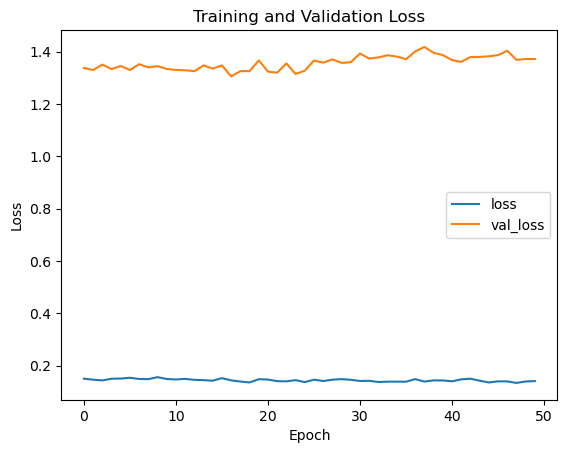

Fold 7
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1401 - accuracy: 0.9483 - val_loss: 1.4128 - val_accuracy: 0.7149
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1356 - accuracy: 0.9497 - val_loss: 1.4355 - val_accuracy: 0.7119
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1363 - accuracy: 0.9506 - val_loss: 1.4055 - val_accuracy: 0.7136
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1403 - accuracy: 0.9493 - val_loss: 1.4149 - val_accuracy: 0.7145
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1348 - accuracy: 0.9504 - val_loss: 1.4320 - val_accuracy: 0.7132
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1391 - accuracy: 0.9479 - val_loss: 1.4056 - val_accuracy: 0.7153
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1483 - accuracy: 0.9468 - val_loss: 1.4285 - val_accuracy: 0.7149

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7191058625052721, Validation F1 Score: 0.716241673820979


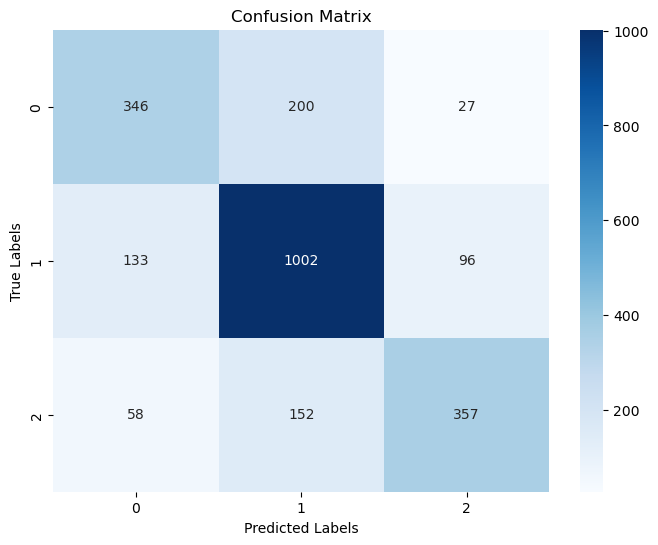

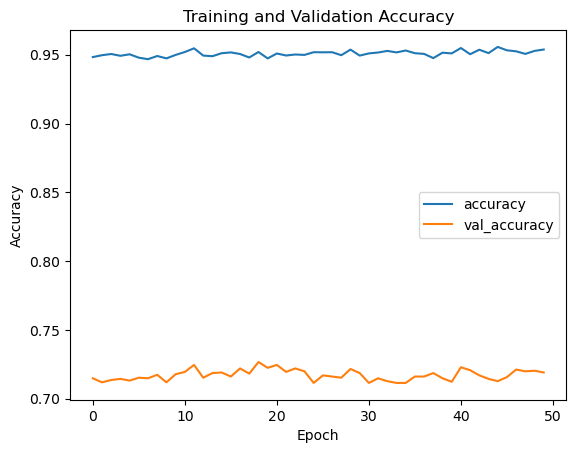

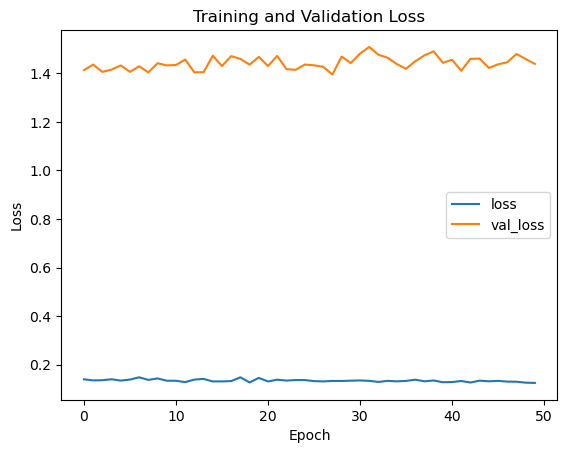

Fold 8
Epoch 1/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1356 - accuracy: 0.9511 - val_loss: 1.4581 - val_accuracy: 0.7166
Epoch 2/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1350 - accuracy: 0.9511 - val_loss: 1.4813 - val_accuracy: 0.7153
Epoch 3/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1256 - accuracy: 0.9536 - val_loss: 1.5049 - val_accuracy: 0.7178
Epoch 4/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1247 - accuracy: 0.9546 - val_loss: 1.5124 - val_accuracy: 0.7128
Epoch 5/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1314 - accuracy: 0.9553 - val_loss: 1.5074 - val_accuracy: 0.7128
Epoch 6/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1332 - accuracy: 0.9519 - val_loss: 1.4882 - val_accuracy: 0.7136
Epoch 7/50
216/216 [==============================] - 2s 7ms/step - loss: 0.1309 - accuracy: 0.9535 - val_loss: 1.5028 - val_accuracy: 0.7149

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


75/75 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7169970476592156, Validation F1 Score: 0.7133398404973772


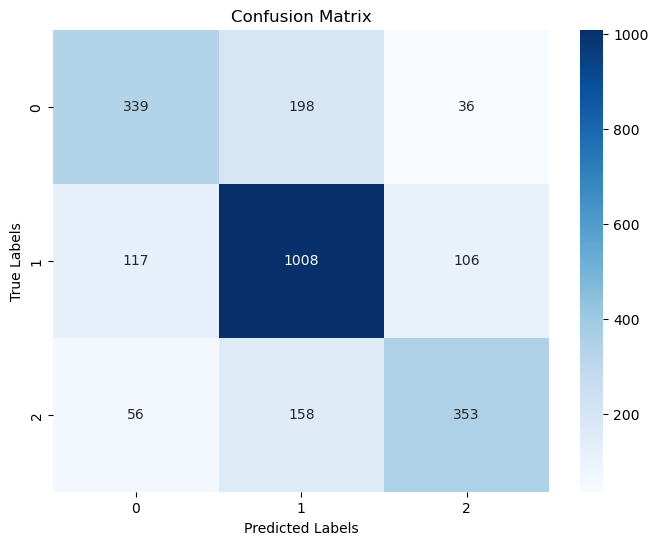

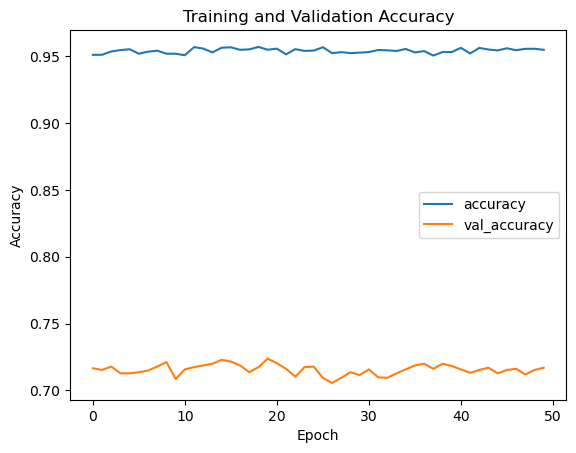

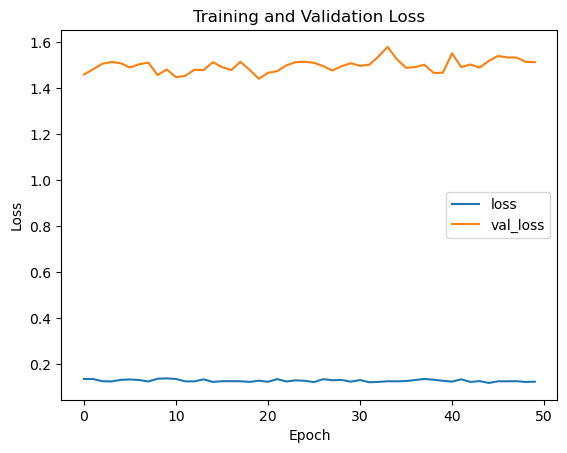

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.715784479122733
Mean F1 Score: 0.7122437767153585
Number of Epochs: 50, Test Size: 0.25, Validation Size: 0.15
Fold 1
Epoch 1/50
203/203 [==============================] - 2s 8ms/step - loss: 1.4730 - accuracy: 0.5256 - val_loss: 0.8374 - val_accuracy: 0.6437
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.9036 - accuracy: 0.6217 - val_loss: 0.7693 - val_accuracy: 0.6628
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.7765 - accuracy: 0.6601 - val_loss: 0.7355 - val_accuracy: 0.6758
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.7169 - accuracy: 0.6888 - val_loss: 0.7140 - val_accuracy: 0.6866
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.6884 - accuracy: 0.7041 - val_loss: 0.7061 - val_accuracy: 0.6854
Epoch 6/50
203/203 [==============================] - 2s 7ms/step - loss: 0.6547 - accuracy: 0.7216 - val_loss: 0.6927 - val_accuracy: 0.6964
Epoch 7/50
20

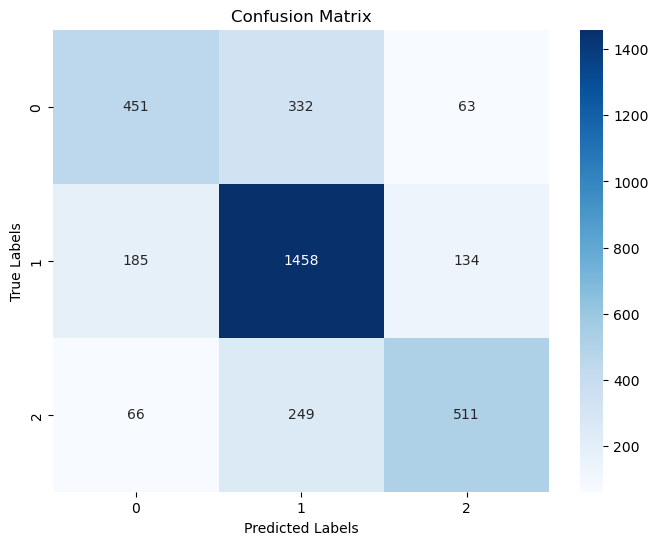

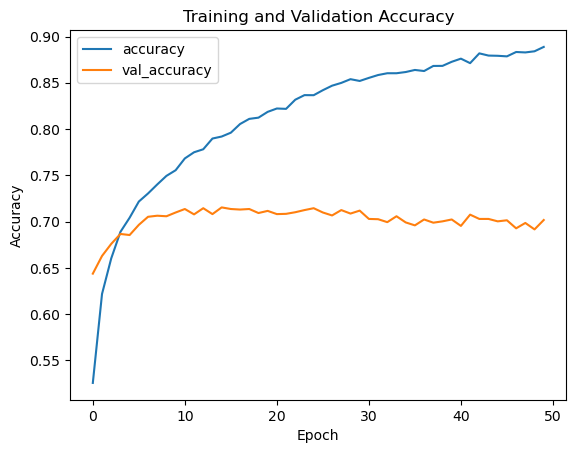

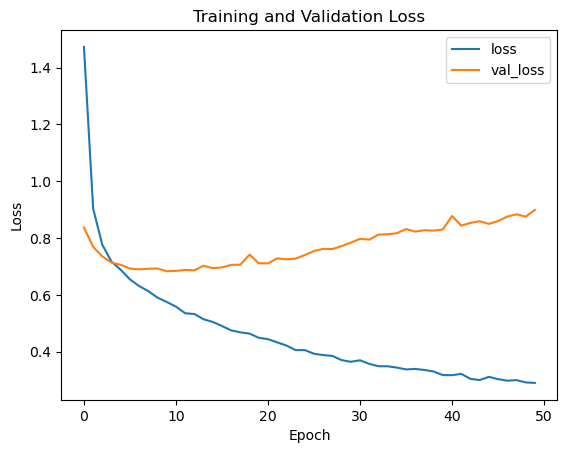

Fold 2
Epoch 1/50
203/203 [==============================] - 2s 8ms/step - loss: 0.2888 - accuracy: 0.8891 - val_loss: 0.8759 - val_accuracy: 0.6976
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2911 - accuracy: 0.8857 - val_loss: 0.8902 - val_accuracy: 0.6944
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2741 - accuracy: 0.8936 - val_loss: 0.8967 - val_accuracy: 0.7005
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2840 - accuracy: 0.8874 - val_loss: 0.9135 - val_accuracy: 0.7025
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2837 - accuracy: 0.8902 - val_loss: 0.8970 - val_accuracy: 0.6956
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2697 - accuracy: 0.8963 - val_loss: 0.9108 - val_accuracy: 0.6993
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2750 - accuracy: 0.8922 - val_loss: 0.9383 - val_accuracy: 0.7022

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6967236880255147, Validation F1 Score: 0.691839792908137


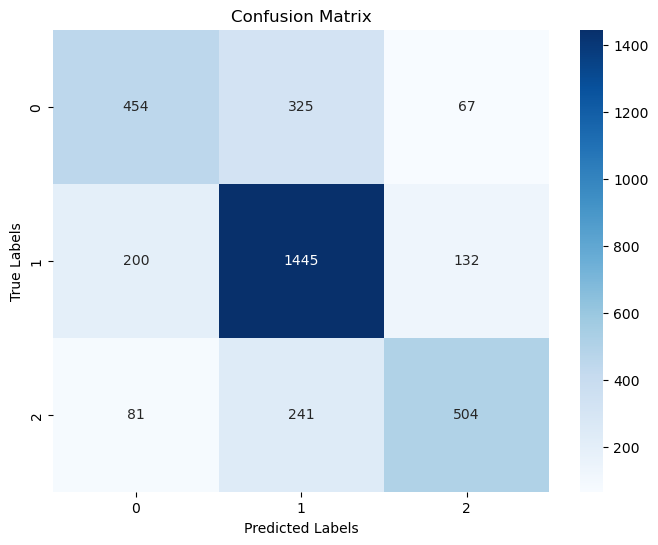

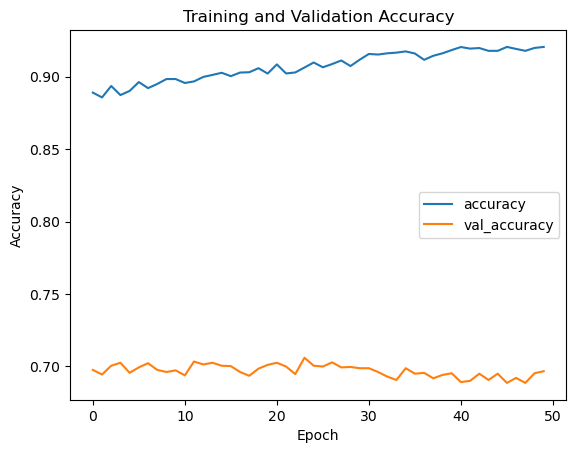

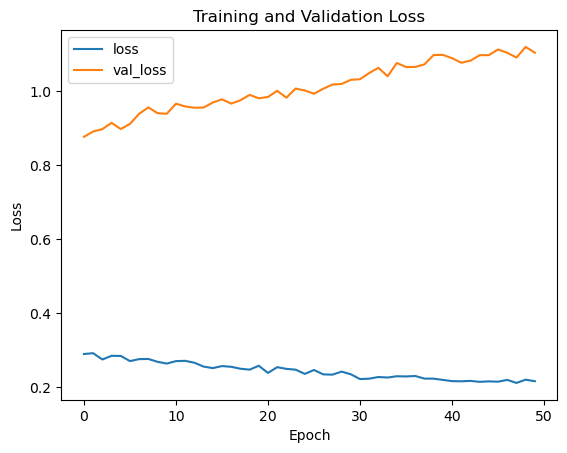

Fold 3
Epoch 1/50
203/203 [==============================] - 2s 7ms/step - loss: 0.2083 - accuracy: 0.9201 - val_loss: 1.1047 - val_accuracy: 0.6941
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2158 - accuracy: 0.9221 - val_loss: 1.0883 - val_accuracy: 0.6999
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2055 - accuracy: 0.9254 - val_loss: 1.1020 - val_accuracy: 0.6964
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2159 - accuracy: 0.9198 - val_loss: 1.1069 - val_accuracy: 0.6938
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2084 - accuracy: 0.9197 - val_loss: 1.1131 - val_accuracy: 0.6985
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2104 - accuracy: 0.9222 - val_loss: 1.1094 - val_accuracy: 0.6956
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1987 - accuracy: 0.9227 - val_loss: 1.1099 - val_accuracy: 0.6990

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6851261235140621, Validation F1 Score: 0.6797329429247815


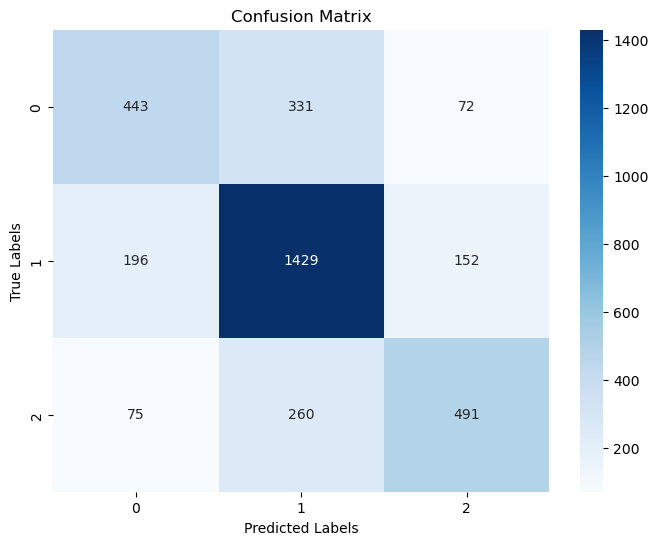

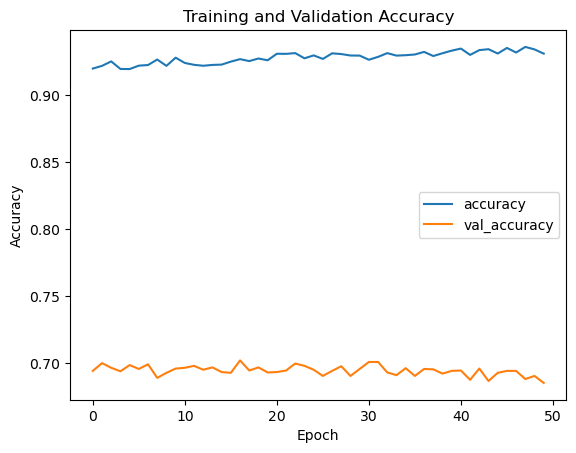

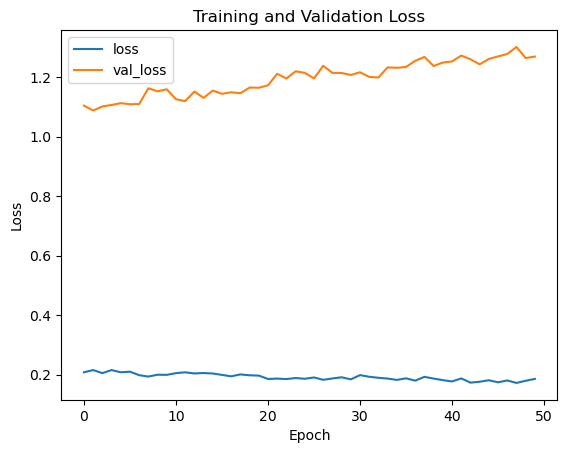

Fold 4
Epoch 1/50
203/203 [==============================] - 2s 7ms/step - loss: 0.1758 - accuracy: 0.9354 - val_loss: 1.2842 - val_accuracy: 0.6918
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1773 - accuracy: 0.9326 - val_loss: 1.2764 - val_accuracy: 0.6947
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1785 - accuracy: 0.9339 - val_loss: 1.2614 - val_accuracy: 0.6930
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1718 - accuracy: 0.9338 - val_loss: 1.2861 - val_accuracy: 0.6895
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1697 - accuracy: 0.9338 - val_loss: 1.3188 - val_accuracy: 0.6930
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1680 - accuracy: 0.9356 - val_loss: 1.2740 - val_accuracy: 0.6901
Epoch 7/50
203/203 [==============================] - 2s 7ms/step - loss: 0.1787 - accuracy: 0.9358 - val_loss: 1.2829 - val_accuracy: 0.6947

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6952739924615831, Validation F1 Score: 0.691027008037923


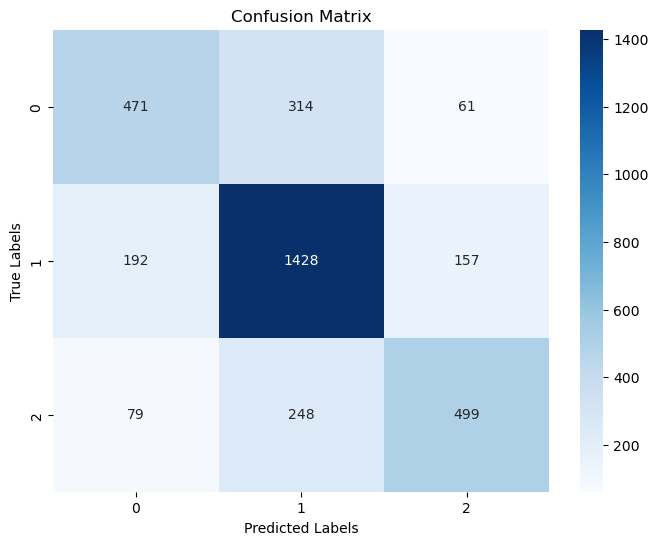

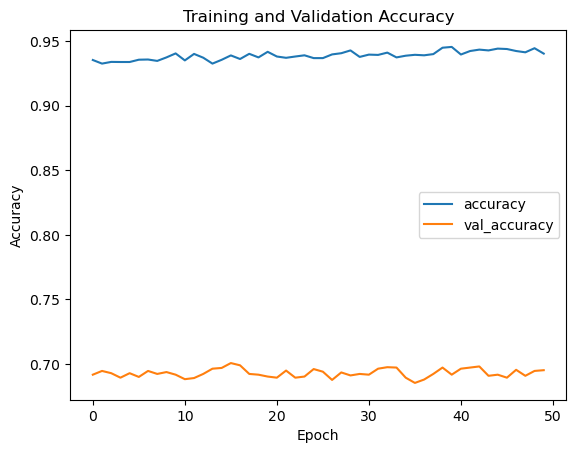

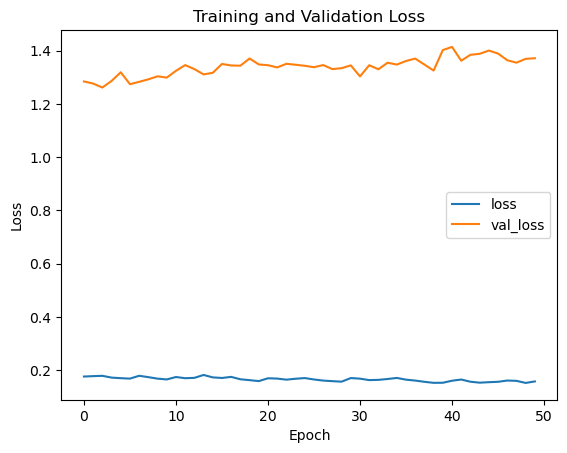

Fold 5
Epoch 1/50
203/203 [==============================] - 2s 7ms/step - loss: 0.1488 - accuracy: 0.9438 - val_loss: 1.3869 - val_accuracy: 0.6863
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1525 - accuracy: 0.9464 - val_loss: 1.3787 - val_accuracy: 0.6903
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1598 - accuracy: 0.9416 - val_loss: 1.3711 - val_accuracy: 0.6932
Epoch 4/50
203/203 [==============================] - 2s 8ms/step - loss: 0.1488 - accuracy: 0.9441 - val_loss: 1.3678 - val_accuracy: 0.6935
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1503 - accuracy: 0.9430 - val_loss: 1.4095 - val_accuracy: 0.6973
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1460 - accuracy: 0.9467 - val_loss: 1.4171 - val_accuracy: 0.6918
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1643 - accuracy: 0.9419 - val_loss: 1.4011 - val_accuracy: 0.6851

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6883154537547115, Validation F1 Score: 0.6843196922538968


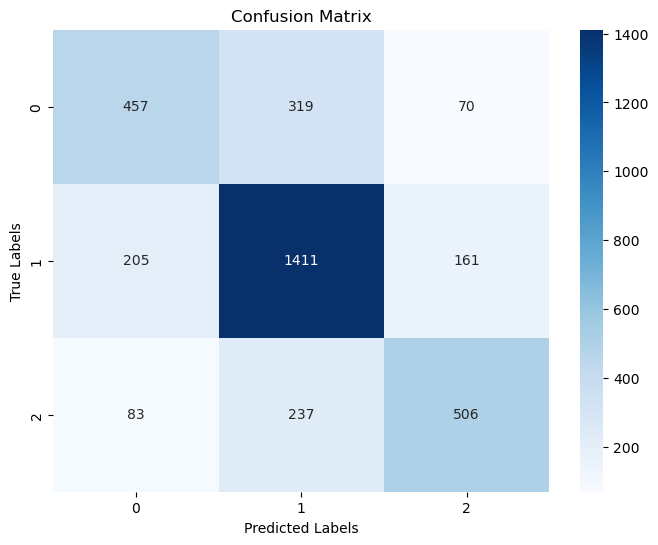

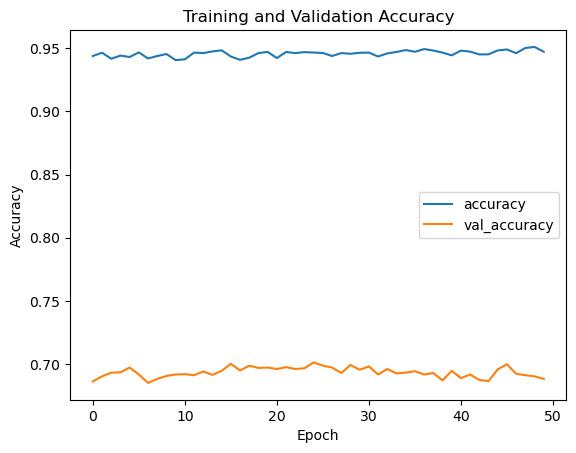

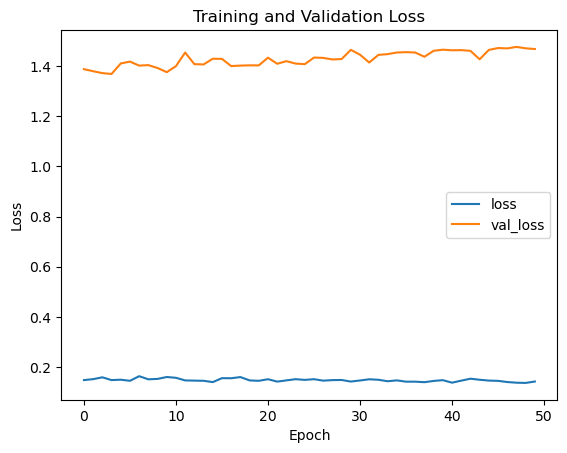

Fold 6
Epoch 1/50
203/203 [==============================] - 2s 7ms/step - loss: 0.1416 - accuracy: 0.9470 - val_loss: 1.4658 - val_accuracy: 0.6903
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1463 - accuracy: 0.9484 - val_loss: 1.4659 - val_accuracy: 0.6901
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1384 - accuracy: 0.9503 - val_loss: 1.4833 - val_accuracy: 0.6863
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1334 - accuracy: 0.9507 - val_loss: 1.4827 - val_accuracy: 0.6898
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1381 - accuracy: 0.9502 - val_loss: 1.5022 - val_accuracy: 0.6927
Epoch 6/50
203/203 [==============================] - 2s 7ms/step - loss: 0.1398 - accuracy: 0.9460 - val_loss: 1.4834 - val_accuracy: 0.6967
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1479 - accuracy: 0.9480 - val_loss: 1.4542 - val_accuracy: 0.6953

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6900550884314294, Validation F1 Score: 0.6843738768964474


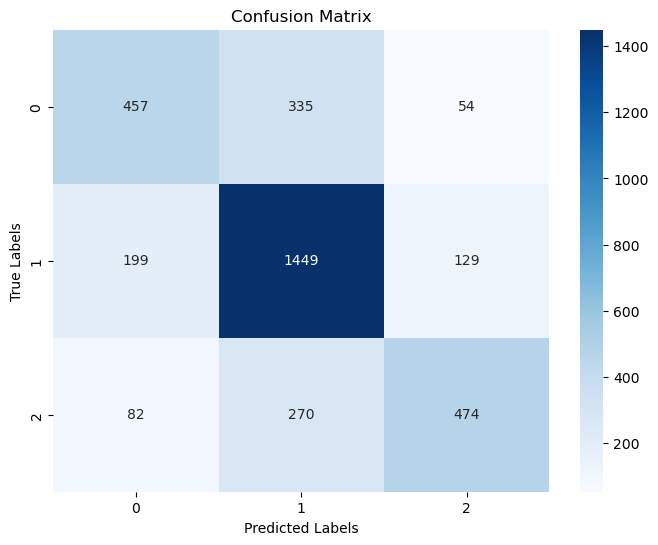

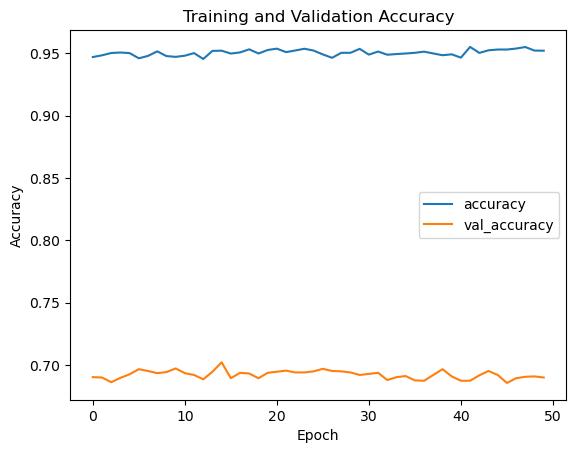

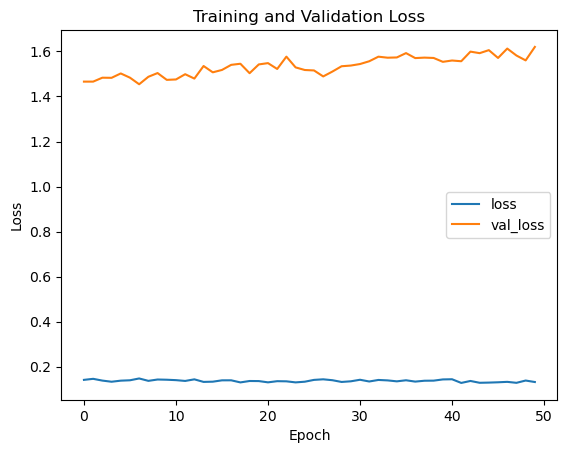

Fold 7
Epoch 1/50
203/203 [==============================] - 2s 7ms/step - loss: 0.1340 - accuracy: 0.9522 - val_loss: 1.5869 - val_accuracy: 0.6877
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1330 - accuracy: 0.9521 - val_loss: 1.6082 - val_accuracy: 0.6874
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1379 - accuracy: 0.9509 - val_loss: 1.6282 - val_accuracy: 0.6901
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1277 - accuracy: 0.9536 - val_loss: 1.6254 - val_accuracy: 0.6860
Epoch 5/50
203/203 [==============================] - 2s 7ms/step - loss: 0.1365 - accuracy: 0.9511 - val_loss: 1.6373 - val_accuracy: 0.6854
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1242 - accuracy: 0.9562 - val_loss: 1.6371 - val_accuracy: 0.6843
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1329 - accuracy: 0.9504 - val_loss: 1.6087 - val_accuracy: 0.6851

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6917947231081473, Validation F1 Score: 0.6859926163869539


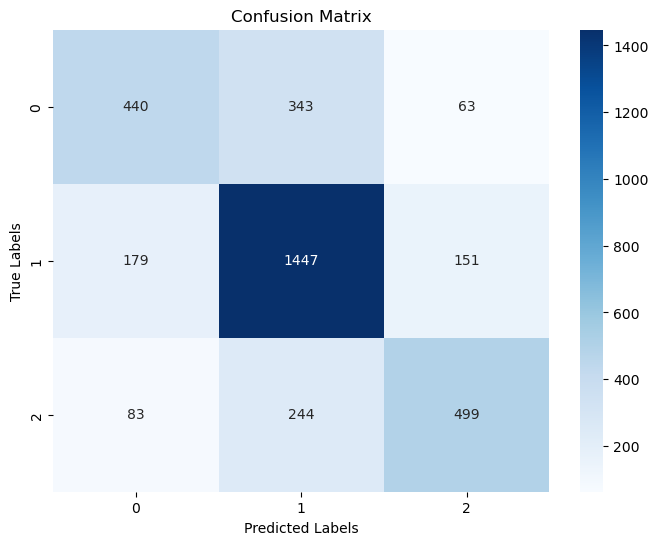

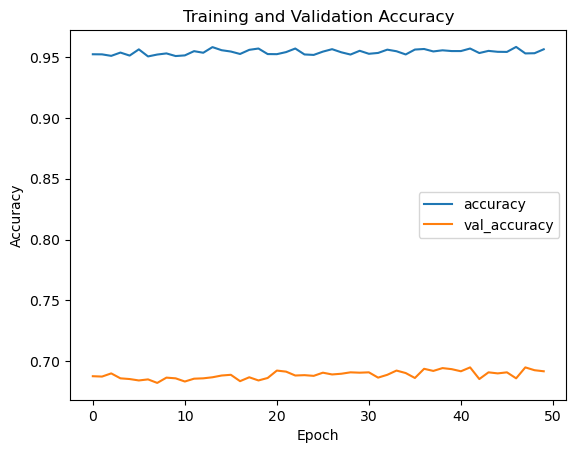

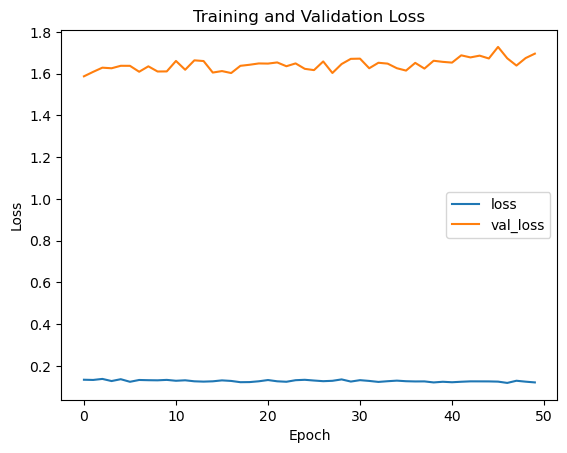

Fold 8
Epoch 1/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1220 - accuracy: 0.9559 - val_loss: 1.6506 - val_accuracy: 0.6848
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1324 - accuracy: 0.9527 - val_loss: 1.7230 - val_accuracy: 0.6854
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1326 - accuracy: 0.9538 - val_loss: 1.6839 - val_accuracy: 0.6857
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1259 - accuracy: 0.9537 - val_loss: 1.6664 - val_accuracy: 0.6863
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1196 - accuracy: 0.9562 - val_loss: 1.6661 - val_accuracy: 0.6924
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1184 - accuracy: 0.9572 - val_loss: 1.7217 - val_accuracy: 0.6889
Epoch 7/50
203/203 [==============================] - 2s 9ms/step - loss: 0.1262 - accuracy: 0.9555 - val_loss: 1.7053 - val_accuracy: 0.6889

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6920846622209336, Validation F1 Score: 0.6874195840083096


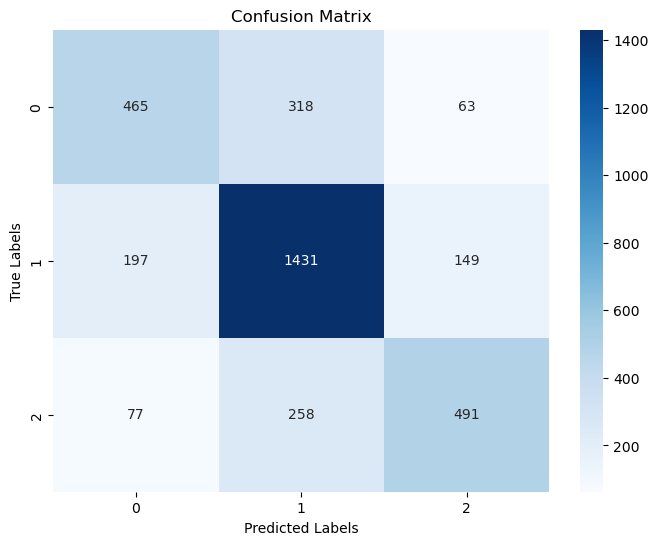

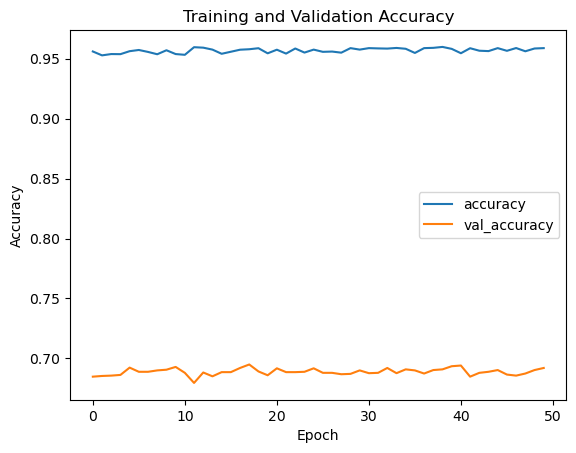

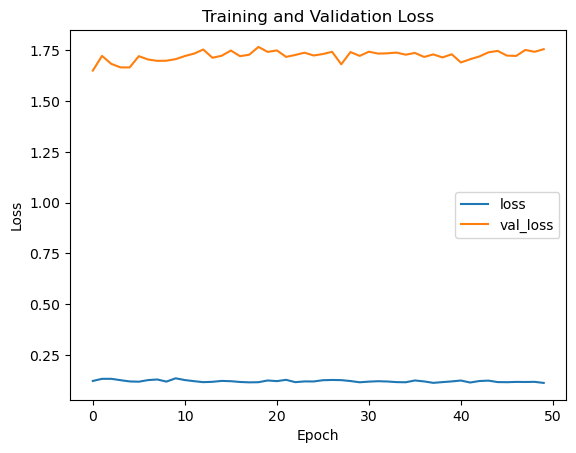

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.6926282980574079
Mean F1 Score: 0.6876118702112284
Number of Epochs: 50, Test Size: 0.25, Validation Size: 0.2
Fold 1
Epoch 1/50
203/203 [==============================] - 2s 8ms/step - loss: 1.6237 - accuracy: 0.5179 - val_loss: 0.8278 - val_accuracy: 0.6287
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.9819 - accuracy: 0.5984 - val_loss: 0.7641 - val_accuracy: 0.6645
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.7960 - accuracy: 0.6506 - val_loss: 0.7368 - val_accuracy: 0.6806
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.7322 - accuracy: 0.6792 - val_loss: 0.7184 - val_accuracy: 0.6831
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.6893 - accuracy: 0.6976 - val_loss: 0.7095 - val_accuracy: 0.6844
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.6646 - accuracy: 0.7054 - val_loss: 0.6908 - val_accuracy: 0.7021
Epoch 7/50
20

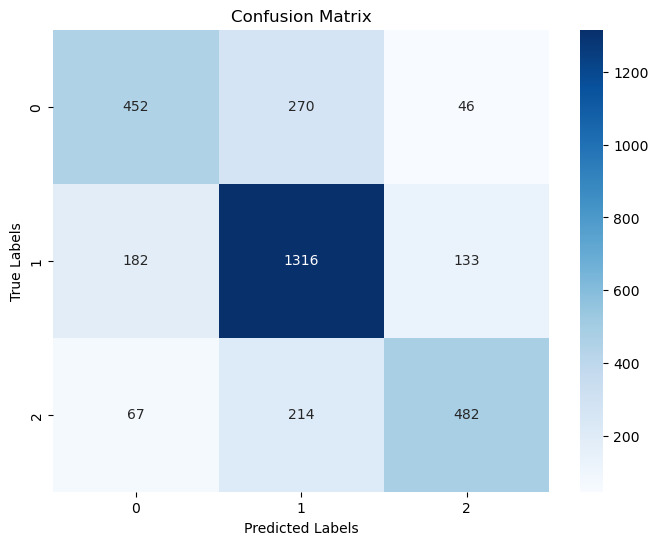

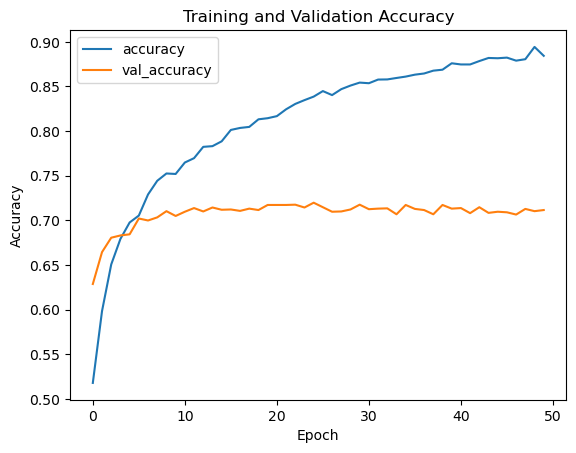

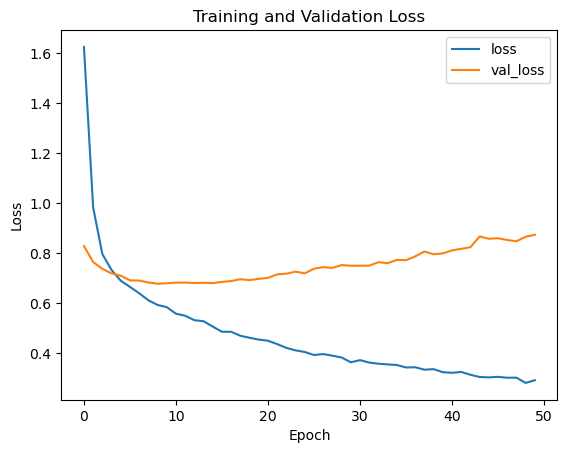

Fold 2
Epoch 1/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2914 - accuracy: 0.8847 - val_loss: 0.8589 - val_accuracy: 0.7100
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2809 - accuracy: 0.8902 - val_loss: 0.8621 - val_accuracy: 0.7141
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2780 - accuracy: 0.8924 - val_loss: 0.8932 - val_accuracy: 0.7084
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2901 - accuracy: 0.8871 - val_loss: 0.8891 - val_accuracy: 0.7103
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2851 - accuracy: 0.8905 - val_loss: 0.8804 - val_accuracy: 0.7100
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2703 - accuracy: 0.8969 - val_loss: 0.8967 - val_accuracy: 0.7132
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2793 - accuracy: 0.8915 - val_loss: 0.8812 - val_accuracy: 0.7122

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7131562302340291, Validation F1 Score: 0.7094637444895758


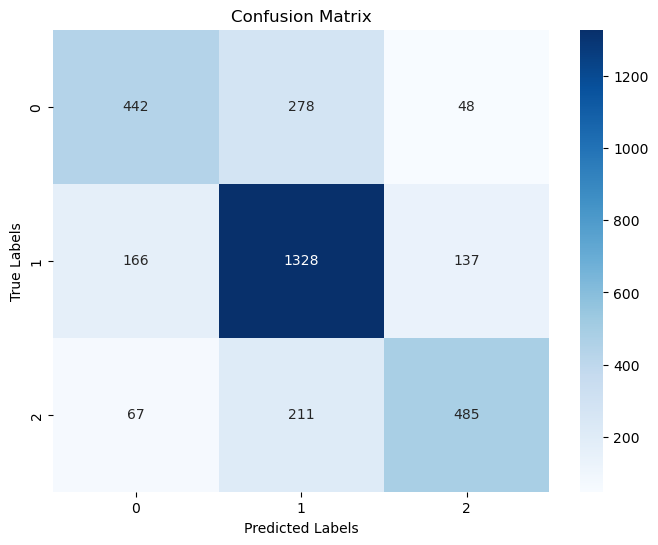

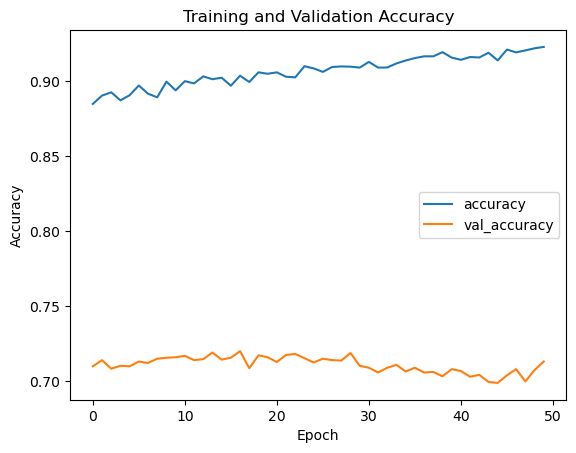

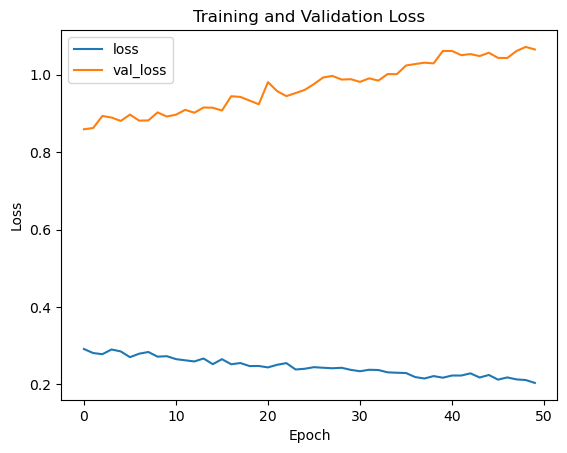

Fold 3
Epoch 1/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2031 - accuracy: 0.9246 - val_loss: 1.0786 - val_accuracy: 0.7043
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2123 - accuracy: 0.9190 - val_loss: 1.0697 - val_accuracy: 0.7049
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2083 - accuracy: 0.9205 - val_loss: 1.0761 - val_accuracy: 0.6961
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2075 - accuracy: 0.9245 - val_loss: 1.1032 - val_accuracy: 0.7090
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2127 - accuracy: 0.9209 - val_loss: 1.0761 - val_accuracy: 0.7015
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2102 - accuracy: 0.9187 - val_loss: 1.1132 - val_accuracy: 0.6961
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2063 - accuracy: 0.9219 - val_loss: 1.0904 - val_accuracy: 0.6983

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7014547754585705, Validation F1 Score: 0.6962067417704377


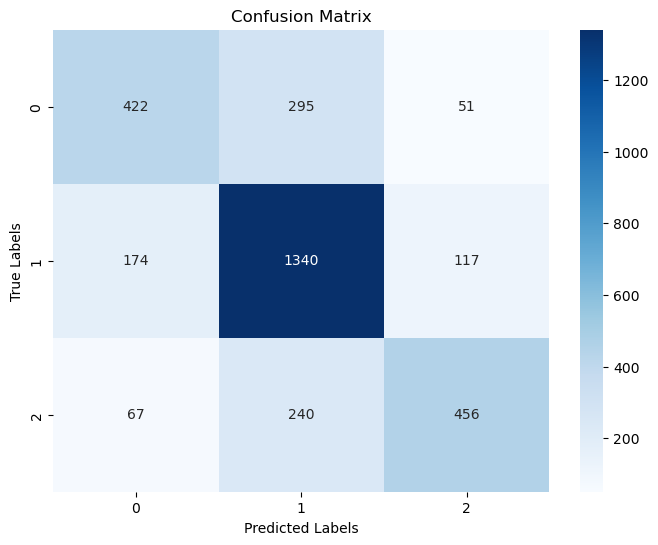

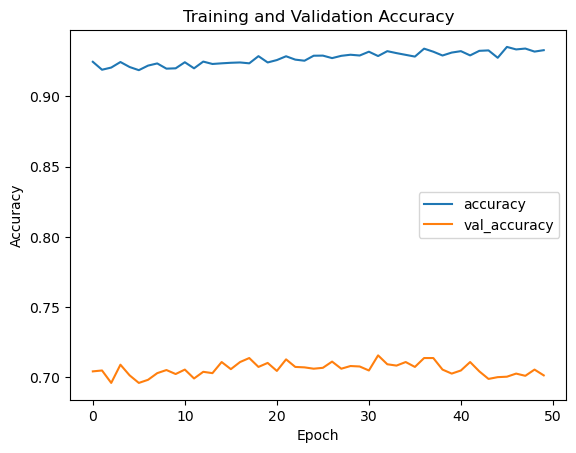

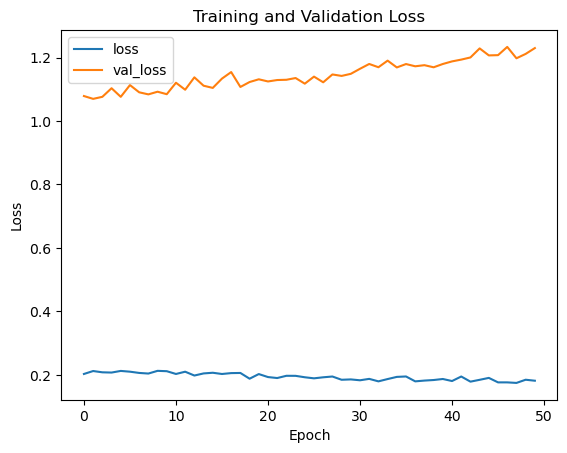

Fold 4
Epoch 1/50
203/203 [==============================] - 2s 7ms/step - loss: 0.1759 - accuracy: 0.9338 - val_loss: 1.2104 - val_accuracy: 0.7030
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1812 - accuracy: 0.9339 - val_loss: 1.2002 - val_accuracy: 0.7081
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1700 - accuracy: 0.9366 - val_loss: 1.2303 - val_accuracy: 0.7062
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1781 - accuracy: 0.9333 - val_loss: 1.2670 - val_accuracy: 0.7075
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1838 - accuracy: 0.9317 - val_loss: 1.2168 - val_accuracy: 0.6992
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1749 - accuracy: 0.9351 - val_loss: 1.2380 - val_accuracy: 0.6983
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1770 - accuracy: 0.9337 - val_loss: 1.2165 - val_accuracy: 0.7059

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7011385199240987, Validation F1 Score: 0.697505486919144


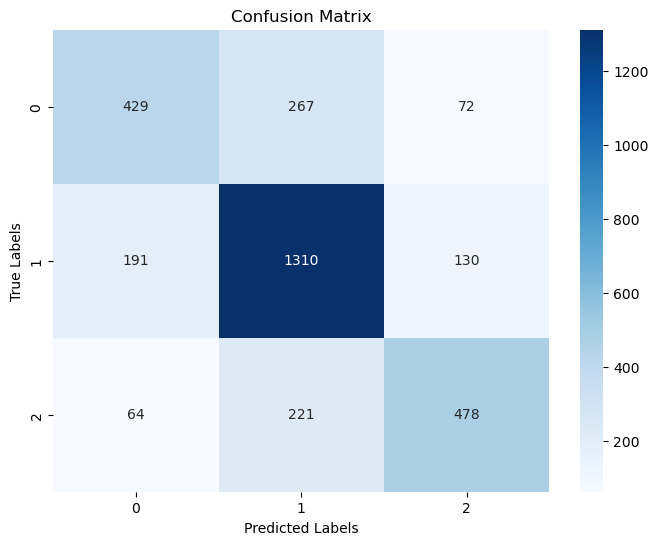

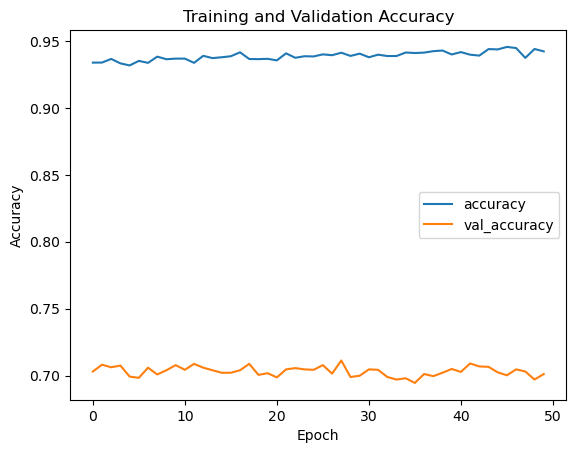

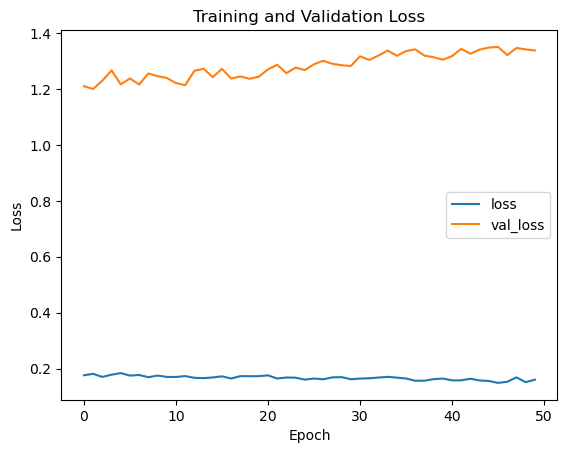

Fold 5
Epoch 1/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1526 - accuracy: 0.9426 - val_loss: 1.3526 - val_accuracy: 0.7002
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1550 - accuracy: 0.9419 - val_loss: 1.3423 - val_accuracy: 0.7030
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1578 - accuracy: 0.9436 - val_loss: 1.3752 - val_accuracy: 0.7043
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1508 - accuracy: 0.9449 - val_loss: 1.3886 - val_accuracy: 0.7027
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1553 - accuracy: 0.9450 - val_loss: 1.3784 - val_accuracy: 0.7021
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1589 - accuracy: 0.9435 - val_loss: 1.3830 - val_accuracy: 0.6983
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1527 - accuracy: 0.9432 - val_loss: 1.3505 - val_accuracy: 0.7049

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7049335863377609, Validation F1 Score: 0.7020253453340803


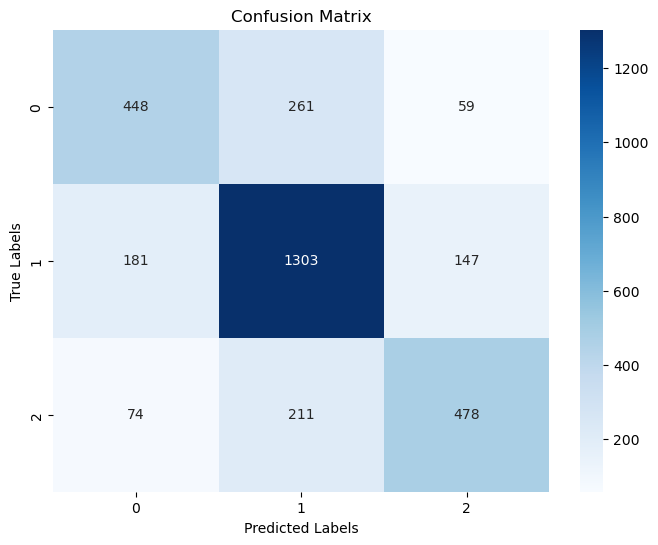

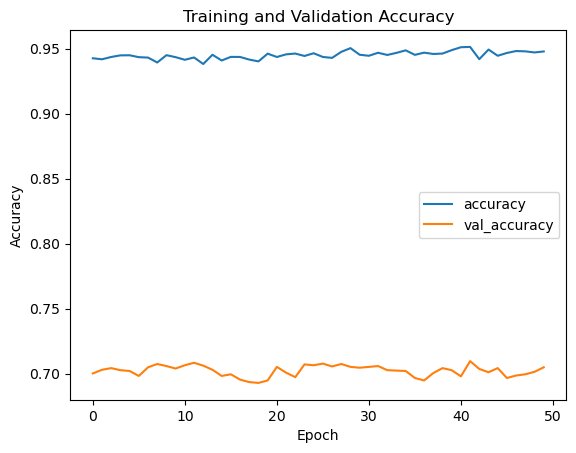

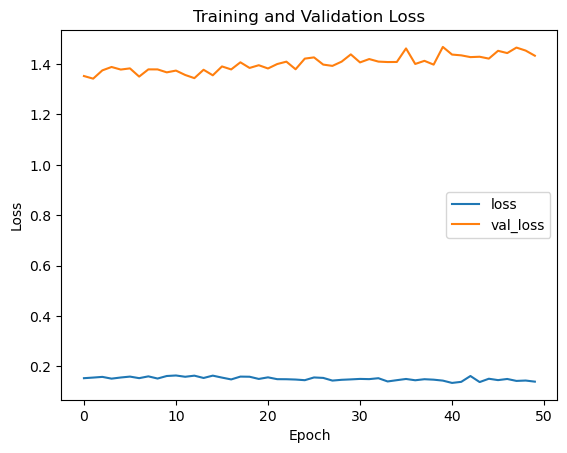

Fold 6
Epoch 1/50
203/203 [==============================] - 2s 9ms/step - loss: 0.1360 - accuracy: 0.9518 - val_loss: 1.4760 - val_accuracy: 0.7062
Epoch 2/50
203/203 [==============================] - 2s 8ms/step - loss: 0.1432 - accuracy: 0.9494 - val_loss: 1.4754 - val_accuracy: 0.6996
Epoch 3/50
203/203 [==============================] - 2s 8ms/step - loss: 0.1416 - accuracy: 0.9497 - val_loss: 1.4454 - val_accuracy: 0.7084
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1393 - accuracy: 0.9491 - val_loss: 1.4714 - val_accuracy: 0.7011
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1457 - accuracy: 0.9487 - val_loss: 1.4625 - val_accuracy: 0.7056
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1375 - accuracy: 0.9515 - val_loss: 1.4741 - val_accuracy: 0.7030
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1406 - accuracy: 0.9490 - val_loss: 1.4790 - val_accuracy: 0.7034

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7036685641998734, Validation F1 Score: 0.6997446829961939


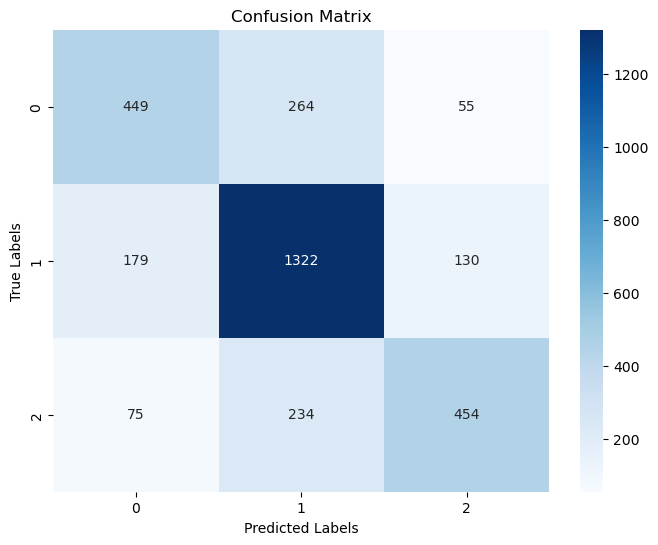

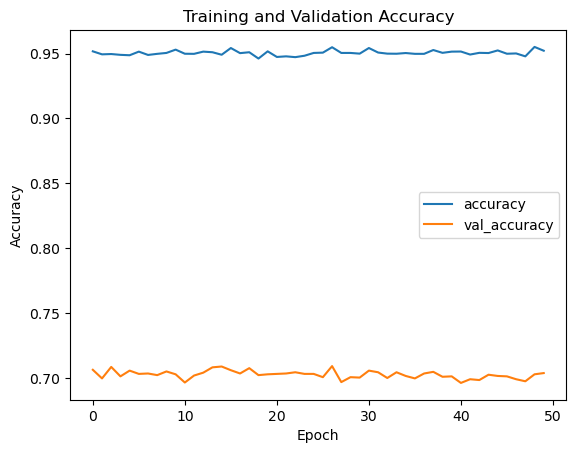

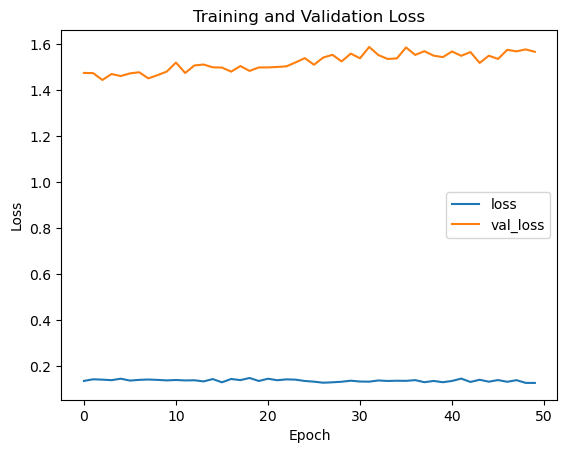

Fold 7
Epoch 1/50
203/203 [==============================] - 2s 7ms/step - loss: 0.1277 - accuracy: 0.9550 - val_loss: 1.5489 - val_accuracy: 0.7024
Epoch 2/50
203/203 [==============================] - 2s 7ms/step - loss: 0.1310 - accuracy: 0.9529 - val_loss: 1.5614 - val_accuracy: 0.7034
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1308 - accuracy: 0.9528 - val_loss: 1.5532 - val_accuracy: 0.7030
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1319 - accuracy: 0.9524 - val_loss: 1.5586 - val_accuracy: 0.7065
Epoch 5/50
203/203 [==============================] - 2s 8ms/step - loss: 0.1358 - accuracy: 0.9508 - val_loss: 1.5590 - val_accuracy: 0.7068
Epoch 6/50
203/203 [==============================] - 2s 8ms/step - loss: 0.1306 - accuracy: 0.9536 - val_loss: 1.6083 - val_accuracy: 0.7078
Epoch 7/50
203/203 [==============================] - 2s 7ms/step - loss: 0.1240 - accuracy: 0.9550 - val_loss: 1.5923 - val_accuracy: 0.7059

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7077798861480076, Validation F1 Score: 0.7038838236713646


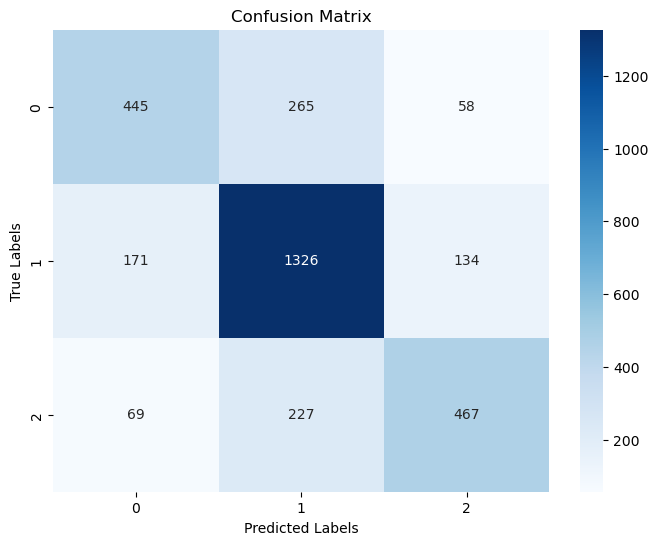

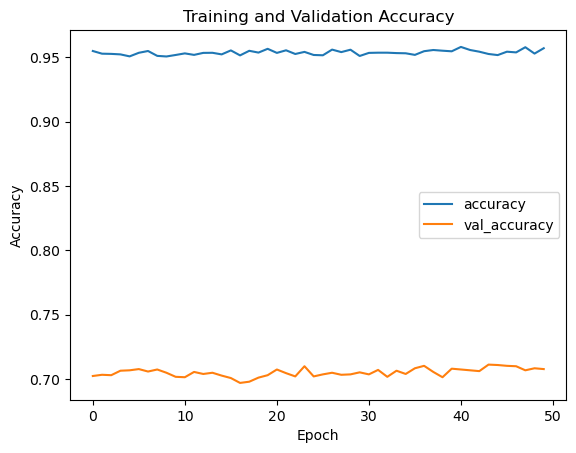

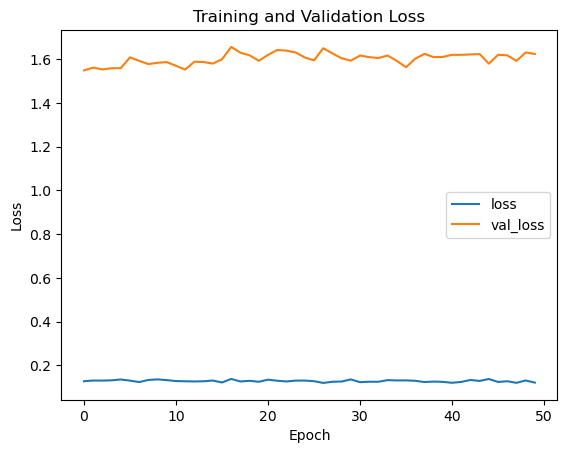

Fold 8
Epoch 1/50
203/203 [==============================] - 2s 8ms/step - loss: 0.1228 - accuracy: 0.9564 - val_loss: 1.6157 - val_accuracy: 0.7027
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1270 - accuracy: 0.9528 - val_loss: 1.6273 - val_accuracy: 0.7049
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1237 - accuracy: 0.9565 - val_loss: 1.6548 - val_accuracy: 0.7068
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1231 - accuracy: 0.9552 - val_loss: 1.6484 - val_accuracy: 0.7018
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1360 - accuracy: 0.9510 - val_loss: 1.6493 - val_accuracy: 0.7046
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1291 - accuracy: 0.9559 - val_loss: 1.6498 - val_accuracy: 0.7062
Epoch 7/50
203/203 [==============================] - 2s 8ms/step - loss: 0.1251 - accuracy: 0.9536 - val_loss: 1.6270 - val_accuracy: 0.7030

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


99/99 [==============================] - 0s 2ms/step
Validation Accuracy: 0.709044908285895, Validation F1 Score: 0.7048929558853615


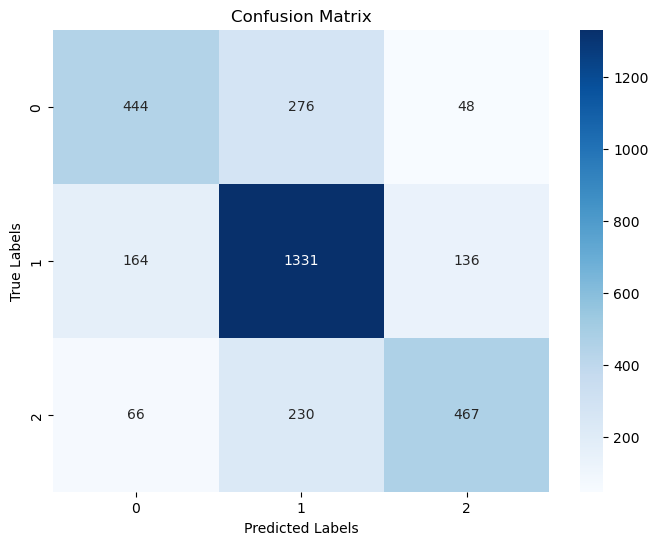

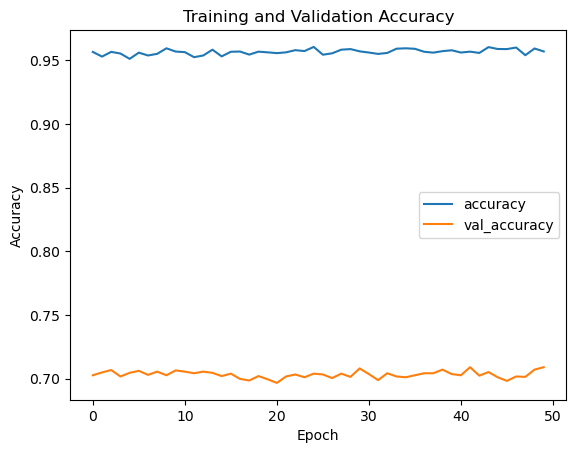

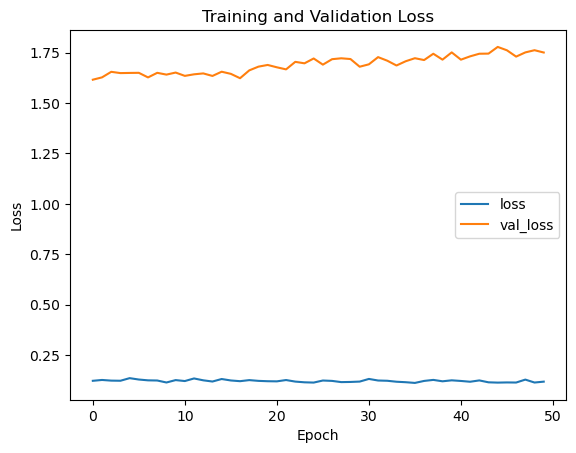

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Mean Accuracy: 0.7065939278937381
Mean F1 Score: 0.7027794980011557
Number of Epochs: 50, Test Size: 0.25, Validation Size: 0.25
Fold 1
Epoch 1/50
203/203 [==============================] - 2s 8ms/step - loss: 1.4588 - accuracy: 0.5244 - val_loss: 0.8054 - val_accuracy: 0.6496
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.9008 - accuracy: 0.6170 - val_loss: 0.7721 - val_accuracy: 0.6583
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.7729 - accuracy: 0.6565 - val_loss: 0.7360 - val_accuracy: 0.6768
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.7281 - accuracy: 0.6809 - val_loss: 0.7087 - val_accuracy: 0.6990
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.6772 - accuracy: 0.7046 - val_loss: 0.6958 - val_accuracy: 0.6969
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.6541 - accuracy: 0.7191 - val_loss: 0.6820 - val_accuracy: 0.7063
Epoch 7/50
2

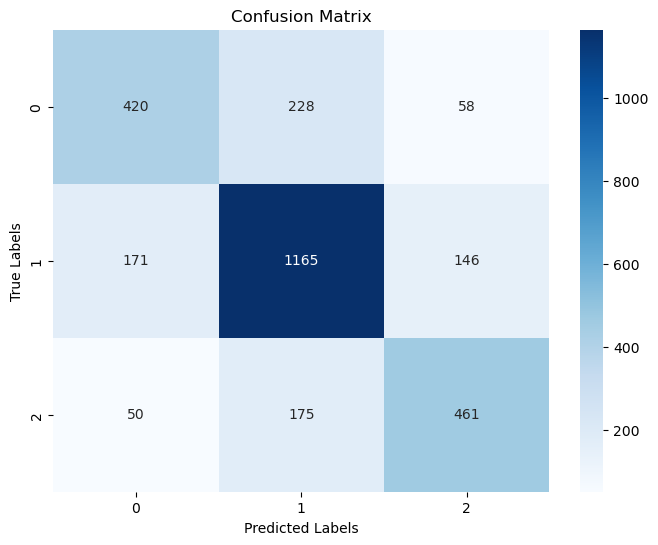

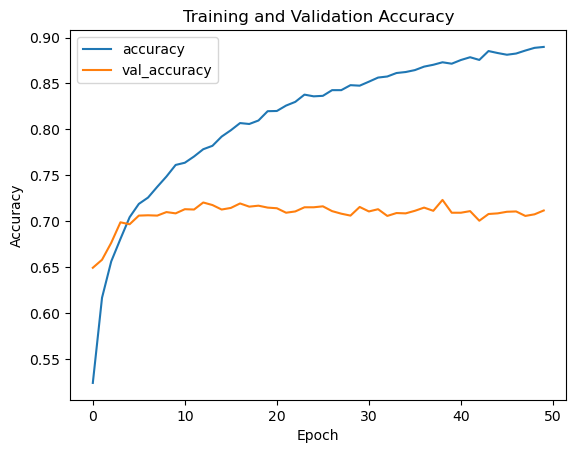

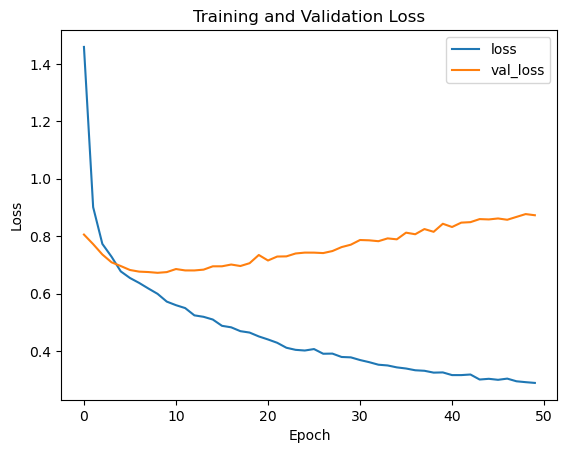

Fold 2
Epoch 1/50
203/203 [==============================] - 2s 7ms/step - loss: 0.2958 - accuracy: 0.8850 - val_loss: 0.8793 - val_accuracy: 0.7112
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2763 - accuracy: 0.8924 - val_loss: 0.8835 - val_accuracy: 0.7126
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2866 - accuracy: 0.8901 - val_loss: 0.8767 - val_accuracy: 0.7088
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2732 - accuracy: 0.8973 - val_loss: 0.8761 - val_accuracy: 0.7035
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2816 - accuracy: 0.8931 - val_loss: 0.8984 - val_accuracy: 0.7074
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2787 - accuracy: 0.8890 - val_loss: 0.8956 - val_accuracy: 0.7032
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2758 - accuracy: 0.8939 - val_loss: 0.8871 - val_accuracy: 0.7112

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7108559498956158, Validation F1 Score: 0.7065714314990759


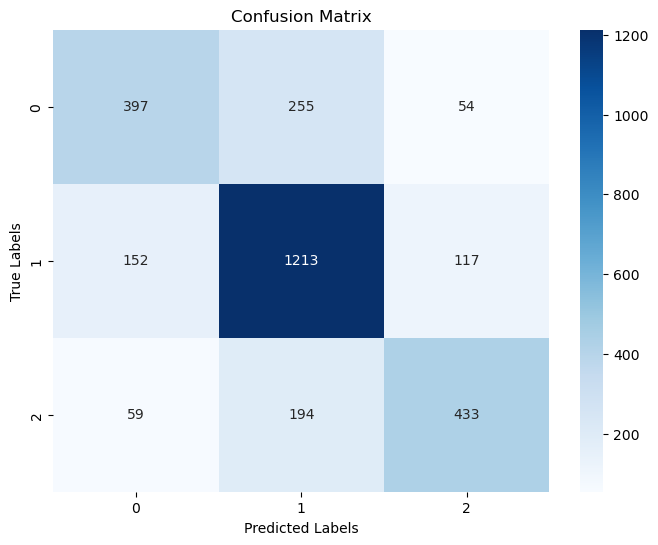

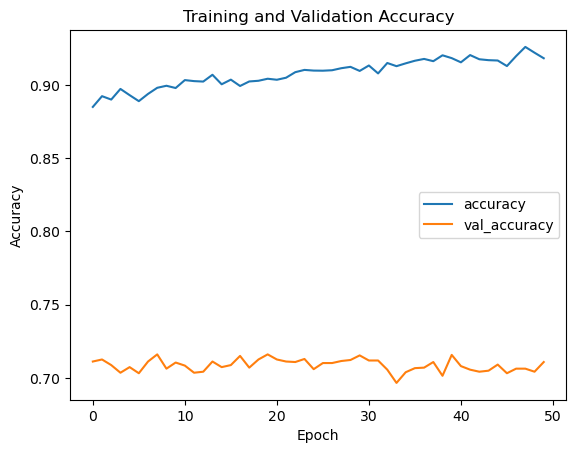

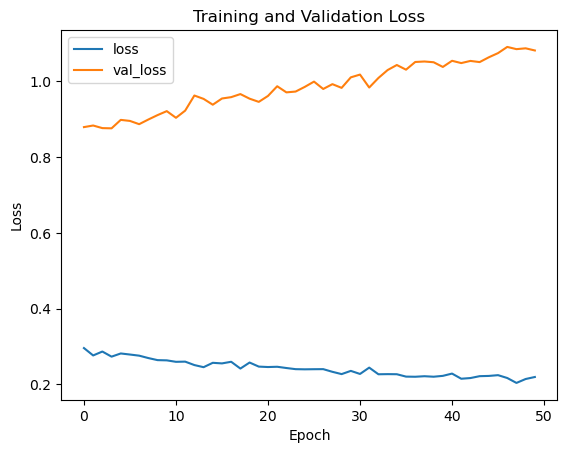

Fold 3
Epoch 1/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2107 - accuracy: 0.9198 - val_loss: 1.1128 - val_accuracy: 0.7025
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2072 - accuracy: 0.9218 - val_loss: 1.0900 - val_accuracy: 0.7001
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2130 - accuracy: 0.9182 - val_loss: 1.1060 - val_accuracy: 0.7015
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2068 - accuracy: 0.9249 - val_loss: 1.0990 - val_accuracy: 0.7074
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.2126 - accuracy: 0.9187 - val_loss: 1.1165 - val_accuracy: 0.6990
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1983 - accuracy: 0.9234 - val_loss: 1.1220 - val_accuracy: 0.7070
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1955 - accuracy: 0.9273 - val_loss: 1.1245 - val_accuracy: 0.7056

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7014613778705637, Validation F1 Score: 0.6946949066387508


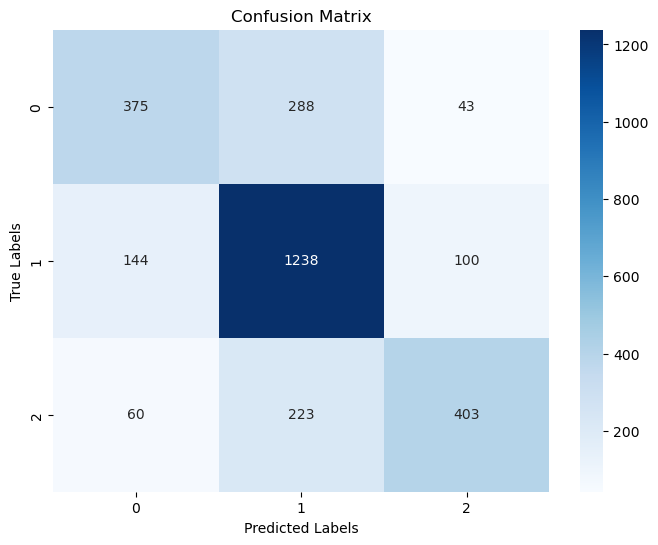

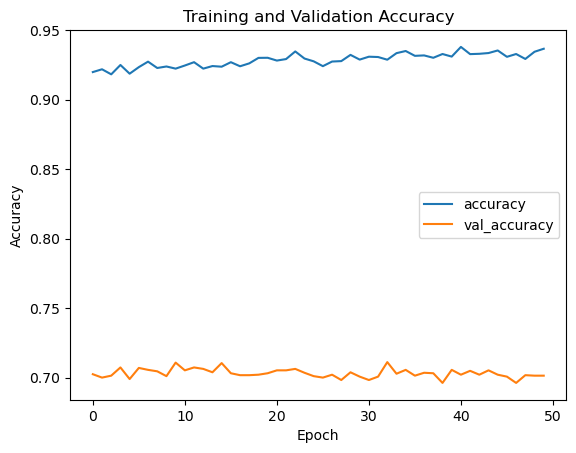

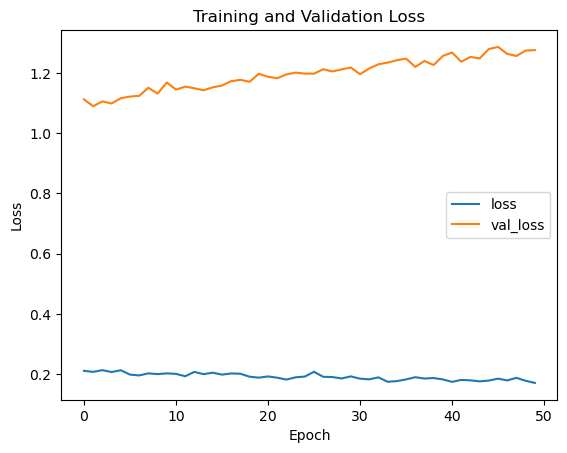

Fold 4
Epoch 1/50
203/203 [==============================] - 2s 8ms/step - loss: 0.1803 - accuracy: 0.9313 - val_loss: 1.2686 - val_accuracy: 0.6994
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1842 - accuracy: 0.9313 - val_loss: 1.2889 - val_accuracy: 0.7004
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1767 - accuracy: 0.9364 - val_loss: 1.2864 - val_accuracy: 0.7063
Epoch 4/50
203/203 [==============================] - 2s 7ms/step - loss: 0.1729 - accuracy: 0.9377 - val_loss: 1.2785 - val_accuracy: 0.7039
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1679 - accuracy: 0.9384 - val_loss: 1.3088 - val_accuracy: 0.7015
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1752 - accuracy: 0.9376 - val_loss: 1.2784 - val_accuracy: 0.6990
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1751 - accuracy: 0.9344 - val_loss: 1.2862 - val_accuracy: 0.6994

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7028531663187195, Validation F1 Score: 0.6979761829356279


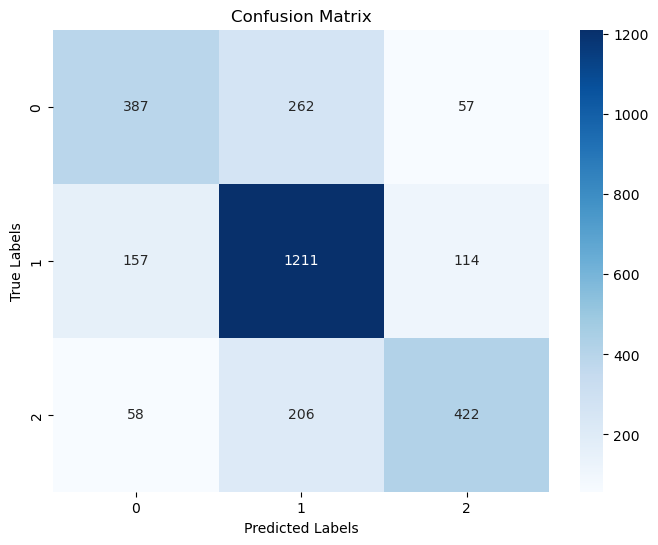

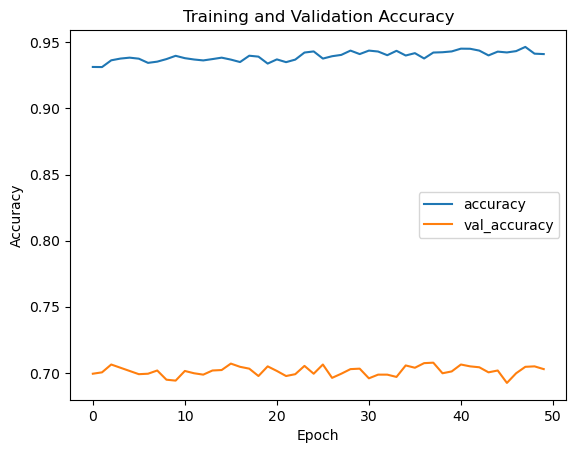

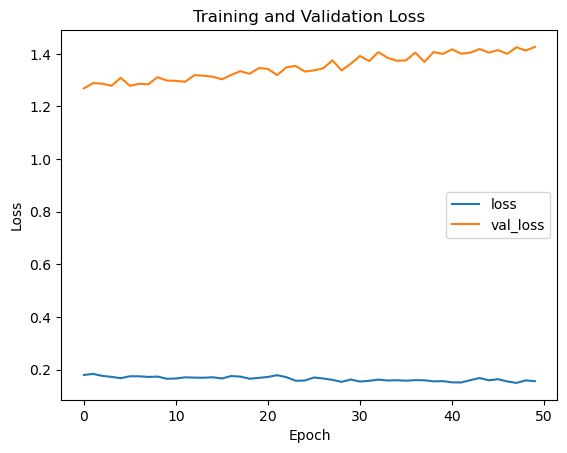

Fold 5
Epoch 1/50
203/203 [==============================] - 2s 8ms/step - loss: 0.1564 - accuracy: 0.9406 - val_loss: 1.3908 - val_accuracy: 0.7060
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1500 - accuracy: 0.9438 - val_loss: 1.4263 - val_accuracy: 0.7049
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1626 - accuracy: 0.9408 - val_loss: 1.4507 - val_accuracy: 0.7004
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1489 - accuracy: 0.9456 - val_loss: 1.4292 - val_accuracy: 0.6983
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1510 - accuracy: 0.9446 - val_loss: 1.4493 - val_accuracy: 0.6976
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1552 - accuracy: 0.9413 - val_loss: 1.4809 - val_accuracy: 0.6994
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1550 - accuracy: 0.9451 - val_loss: 1.4787 - val_accuracy: 0.6973

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7028531663187195, Validation F1 Score: 0.6977663741826092


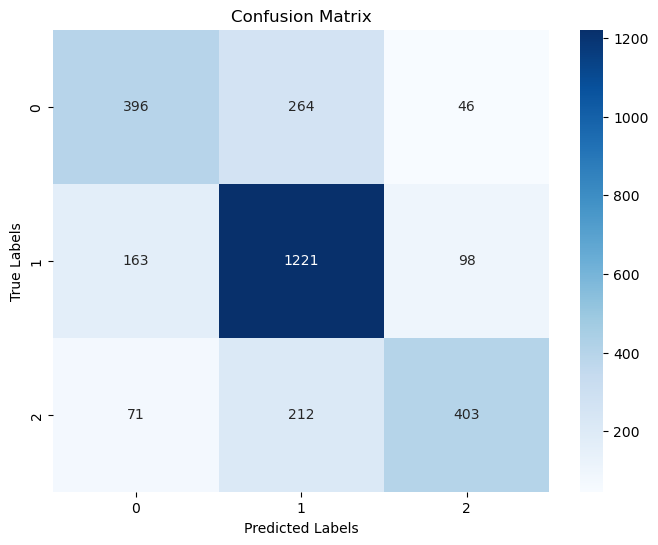

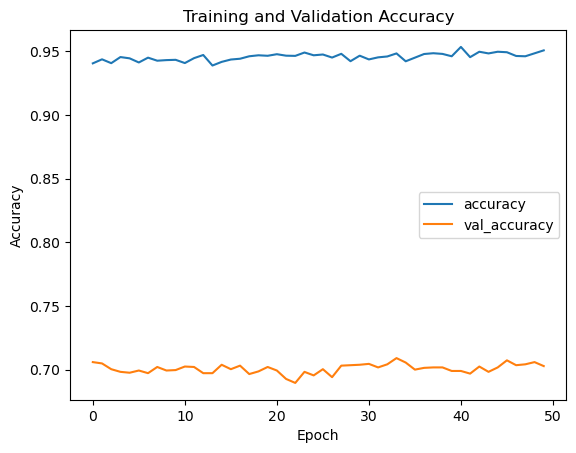

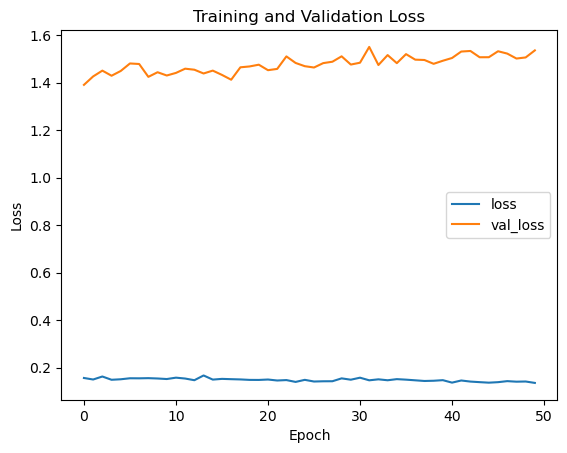

Fold 6
Epoch 1/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1292 - accuracy: 0.9528 - val_loss: 1.5237 - val_accuracy: 0.7015
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1444 - accuracy: 0.9469 - val_loss: 1.5355 - val_accuracy: 0.7056
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1470 - accuracy: 0.9486 - val_loss: 1.5267 - val_accuracy: 0.7105
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1487 - accuracy: 0.9460 - val_loss: 1.5254 - val_accuracy: 0.7105
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1438 - accuracy: 0.9469 - val_loss: 1.5492 - val_accuracy: 0.7042
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1411 - accuracy: 0.9488 - val_loss: 1.5694 - val_accuracy: 0.6987
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1443 - accuracy: 0.9475 - val_loss: 1.5539 - val_accuracy: 0.7056

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.697981906750174, Validation F1 Score: 0.6928904429804114


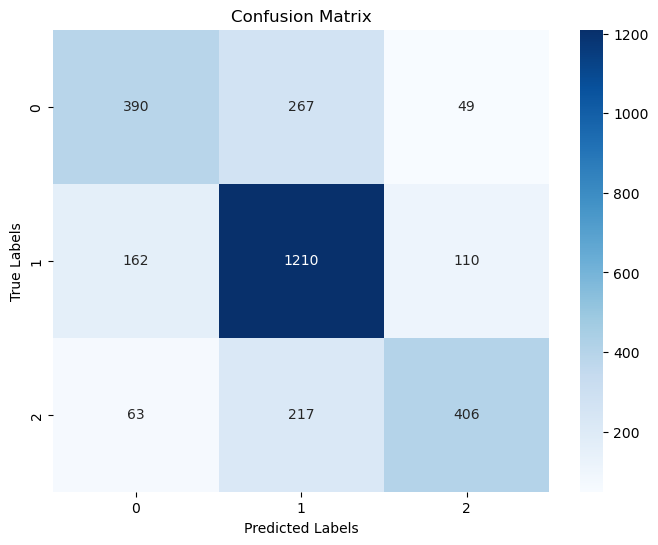

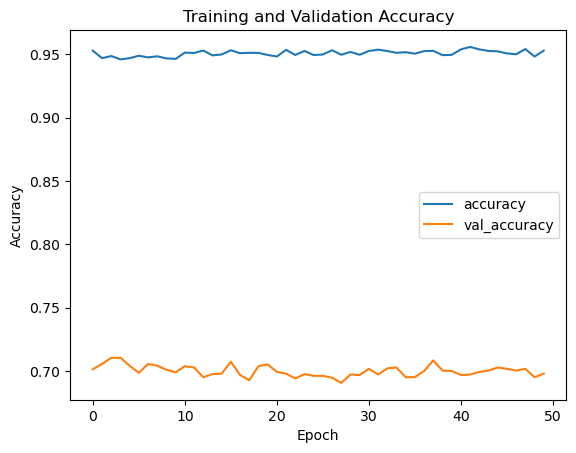

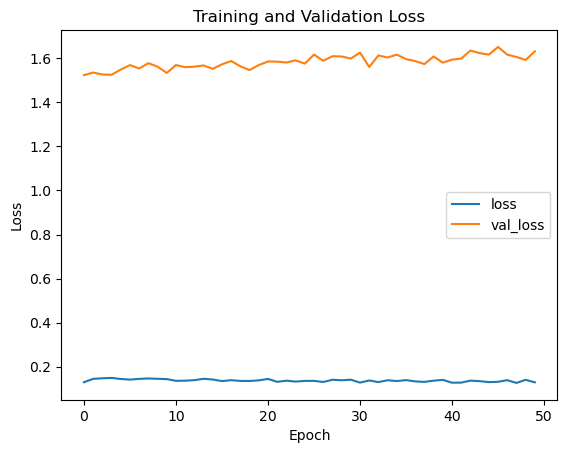

Fold 7
Epoch 1/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1371 - accuracy: 0.9513 - val_loss: 1.6204 - val_accuracy: 0.6921
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1344 - accuracy: 0.9500 - val_loss: 1.6452 - val_accuracy: 0.6942
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1422 - accuracy: 0.9496 - val_loss: 1.6272 - val_accuracy: 0.6983
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1326 - accuracy: 0.9518 - val_loss: 1.6335 - val_accuracy: 0.6994
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1366 - accuracy: 0.9506 - val_loss: 1.6554 - val_accuracy: 0.6976
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1331 - accuracy: 0.9503 - val_loss: 1.6266 - val_accuracy: 0.6990
Epoch 7/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1377 - accuracy: 0.9523 - val_loss: 1.6463 - val_accuracy: 0.6900

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6965901183020181, Validation F1 Score: 0.690756133662521


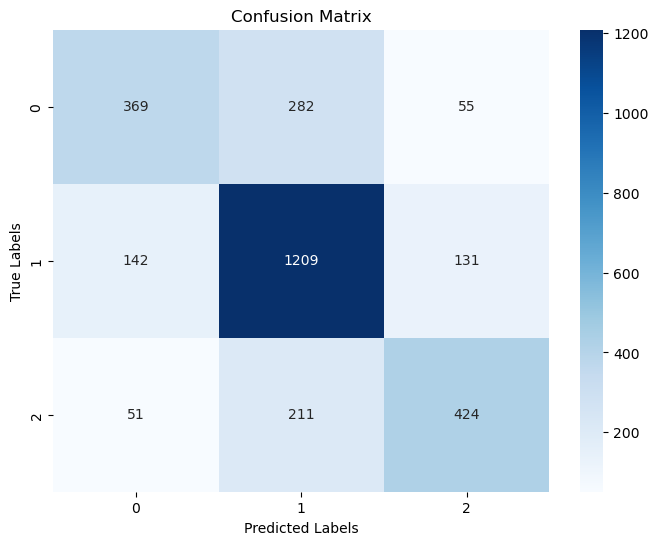

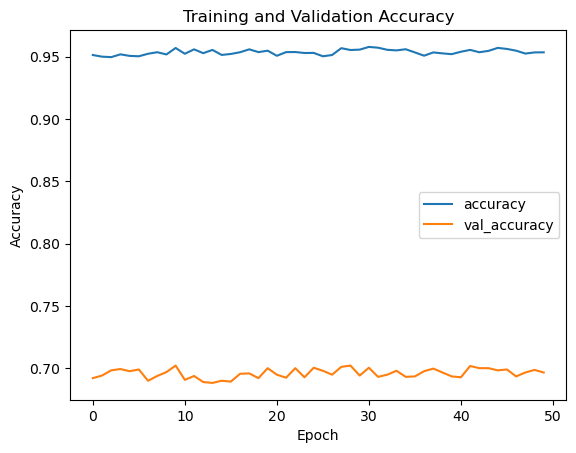

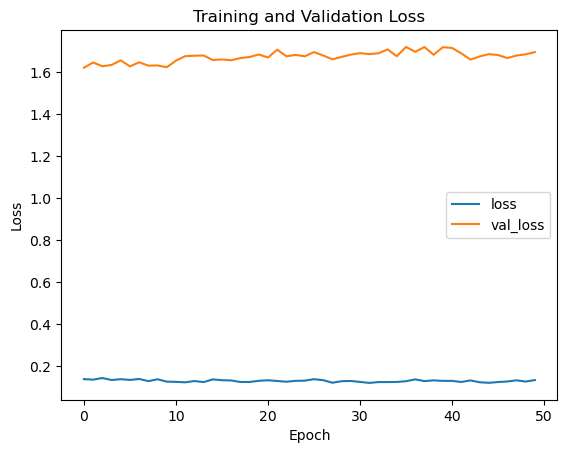

Fold 8
Epoch 1/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1275 - accuracy: 0.9560 - val_loss: 1.7004 - val_accuracy: 0.6973
Epoch 2/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1358 - accuracy: 0.9533 - val_loss: 1.6915 - val_accuracy: 0.6973
Epoch 3/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1156 - accuracy: 0.9557 - val_loss: 1.7325 - val_accuracy: 0.7070
Epoch 4/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1219 - accuracy: 0.9553 - val_loss: 1.7090 - val_accuracy: 0.7063
Epoch 5/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1276 - accuracy: 0.9550 - val_loss: 1.7313 - val_accuracy: 0.7070
Epoch 6/50
203/203 [==============================] - 1s 7ms/step - loss: 0.1226 - accuracy: 0.9583 - val_loss: 1.7166 - val_accuracy: 0.7035
Epoch 7/50
203/203 [==============================] - 2s 9ms/step - loss: 0.1220 - accuracy: 0.9551 - val_loss: 1.7102 - val_accuracy: 0.6962

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


90/90 [==============================] - 0s 2ms/step
Validation Accuracy: 0.6993736951983298, Validation F1 Score: 0.6925538811486441


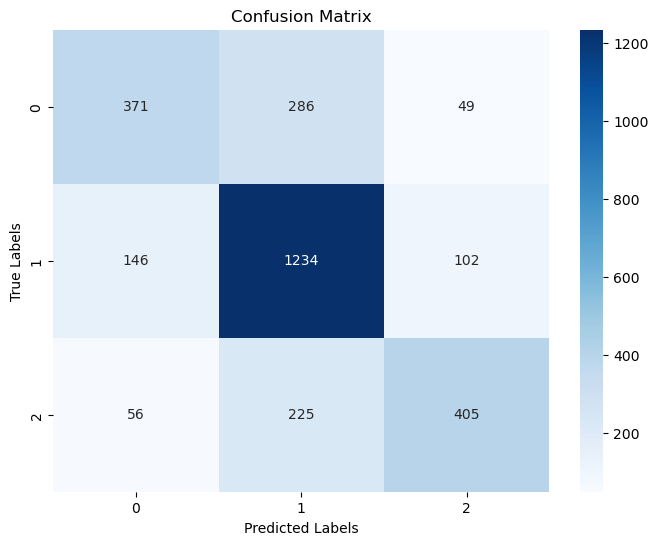

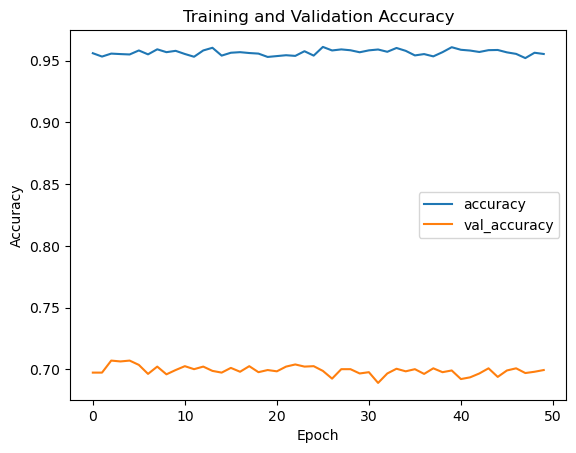

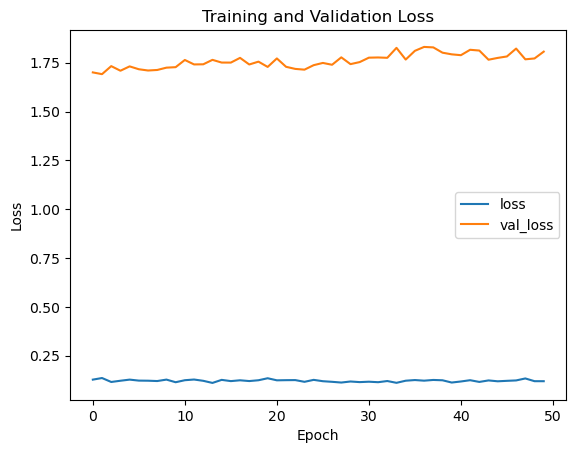

Mean Accuracy: 0.7029836464857342
Mean F1 Score: 0.6979030777670026


C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [19]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import KFold, train_test_split
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix
import tensorflow as tf
from tensorflow.keras.models import load_model, Model
from tensorflow.keras.layers import Input, Embedding, Conv1D, GlobalMaxPooling1D, Dense, Dropout
from graphviz import Digraph
from keras.preprocessing.sequence import pad_sequences

# Define your create_model function with learning_rate as an argument
def create_model():
    input_layer = Input(shape=(max_len,))
    embedding_layer = Embedding(input_dim=len(tokenizer.word_index) + 1, output_dim=100, input_length=max_len,
                                weights=[embedding_matrix], trainable=False)(input_layer)
    conv_layer = Conv1D(128, 3, activation='relu')(embedding_layer)
    pooling_layer = GlobalMaxPooling1D()(conv_layer)
    dropout_layer = Dropout(0.5)(pooling_layer)
    output_layer = Dense(3, activation='softmax')(dropout_layer)

    model = Model(inputs=input_layer, outputs=output_layer)
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# Function to plot confusion matrix
def plot_confusion_matrix(y_true, y_pred, labels):
    cm = confusion_matrix(y_true, y_pred, labels=labels)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title('Confusion Matrix')
    plt.show()

# Function to train and evaluate model for each fold
def train_and_evaluate_model(X_train, y_train, X_val, y_val, fold, previous_model=None):
    if previous_model is None:
        model = create_model()
    else:
        model = previous_model

    # Train model
    history = model.fit(X_train, y_train, epochs=num_epochs, batch_size=64, validation_data=(X_val, y_val))
    model.save(f"model_fold{fold}.h5")

    # Evaluate model
    y_pred = np.argmax(model.predict(X_val), axis=1)
    accuracy = accuracy_score(y_val, y_pred)
    f1 = f1_score(y_val, y_pred, average='weighted')
    accuracy_scores.append(accuracy)
    f1_scores.append(f1)
    print(f"Validation Accuracy: {accuracy}, Validation F1 Score: {f1}")

    # Plot confusion matrix
    plot_confusion_matrix(y_val, y_pred, labels=[0, 1, 2])

    # Plot training history
    plt.plot(history.history['accuracy'], label='accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.legend()
    plt.show()

    plt.plot(history.history['loss'], label='loss')
    plt.plot(history.history['val_loss'], label='val_loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss')
    plt.legend()
    plt.show()

    return model  # Return the trained model

# Main program
num_epochs_list = [10, 20, 50]  # Different numbers of epochs to try
test_size_list = [0.15, 0.2, 0.25]    # Different test sizes to try
val_size_list = [0.15, 0.2, 0.25]      # Different validation sizes to try

for num_epochs in num_epochs_list:
    for test_size in test_size_list:
        for val_size in val_size_list:
            print(f"Number of Epochs: {num_epochs}, Test Size: {test_size}, Validation Size: {val_size}")
            accuracy_scores = []
            f1_scores = []
            precisions = []
            recalls = []
            kfold = KFold(n_splits=8, shuffle=True, random_state=42)
            # Iterate over each fold
            final_models = []  # List to store final models for each fold
            previous_model = None
            for fold, (train_indices, val_indices) in enumerate(kfold.split(text, y), 1):
                print(f'Fold {fold}')

                X_train, X_test, y_train, y_test = train_test_split(text, y, test_size=test_size, random_state=42)
                X_val, X_test, y_val, y_test = train_test_split(X_test, y_test, test_size=val_size/(1-test_size), random_state=42)

                final_model = train_and_evaluate_model(X_train, y_train, X_val, y_val, fold, previous_model)
                final_models.append(final_model)  # Append the final model for this fold
                previous_model = final_model  # Set current model as previous model for next fold

            # Save final models for each fold
            for fold, model in enumerate(final_models, 1):
                model.save(f"final_model_variation_epochs_{num_epochs}_test_size_{test_size}_val_size_{val_size}_fold_{fold}.h5")

            # Print mean evaluation metrics across all folds
            print(f'Mean Accuracy: {np.mean(accuracy_scores)}')
            print(f'Mean F1 Score: {np.mean(f1_scores)}')




Fold 1
Epoch 1/20


216/216 [==============================] - 2s 7ms/step - loss: 1.5298 - accuracy: 0.5216 - val_loss: 0.7903 - val_accuracy: 0.6675
Epoch 2/20
216/216 [==============================] - 1s 6ms/step - loss: 0.9069 - accuracy: 0.6133 - val_loss: 0.7382 - val_accuracy: 0.6823
Epoch 3/20
216/216 [==============================] - 1s 6ms/step - loss: 0.7762 - accuracy: 0.6596 - val_loss: 0.7099 - val_accuracy: 0.6878
Epoch 4/20
216/216 [==============================] - 1s 6ms/step - loss: 0.7238 - accuracy: 0.6815 - val_loss: 0.6932 - val_accuracy: 0.7075
Epoch 5/20
216/216 [==============================] - 1s 6ms/step - loss: 0.6833 - accuracy: 0.7039 - val_loss: 0.6783 - val_accuracy: 0.7128
Epoch 6/20
216/216 [==============================] - 1s 6ms/step - loss: 0.6561 - accuracy: 0.7194 - val_loss: 0.6660 - val_accuracy: 0.7151
Epoch 7/20
216/216 [==============================] - 1s 6ms/step - loss: 0.6299 - accuracy: 0.7302 - val_loss: 0.6649 - val_accuracy: 0.

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.7252173913043478, Validation F1 Score: 0.7202615616707158
              precision    recall  f1-score   support

    Positive       0.69      0.57      0.63       859
    Negative       0.73      0.84      0.78      1782
     Neutral       0.75      0.63      0.69       809

    accuracy                           0.73      3450
   macro avg       0.72      0.68      0.70      3450
weighted avg       0.72      0.73      0.72      3450



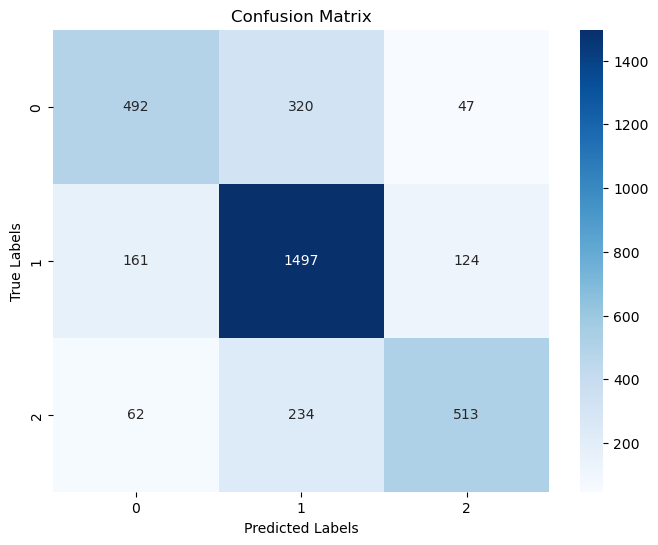

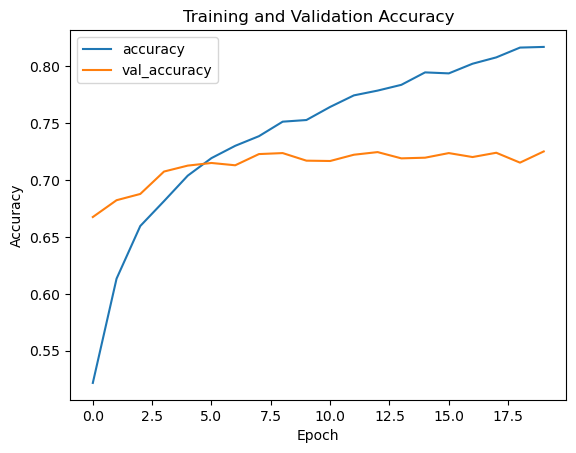

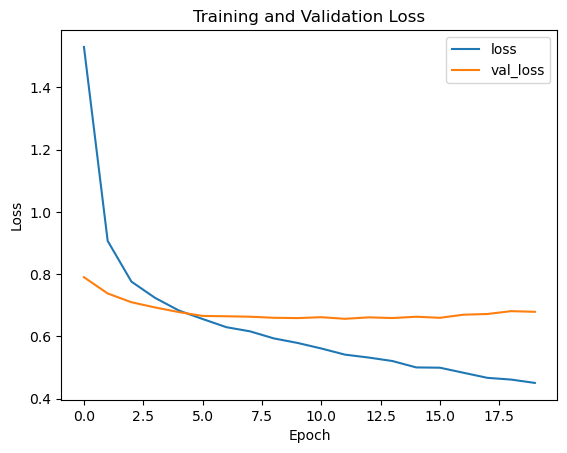

Fold 2
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 0.5336 - accuracy: 0.7865 - val_loss: 0.3405 - val_accuracy: 0.8762
Epoch 2/20
216/216 [==============================] - 1s 7ms/step - loss: 0.5054 - accuracy: 0.7998 - val_loss: 0.3697 - val_accuracy: 0.8649
Epoch 3/20
216/216 [==============================] - 1s 7ms/step - loss: 0.4810 - accuracy: 0.8047 - val_loss: 0.3884 - val_accuracy: 0.8504
Epoch 4/20
216/216 [==============================] - 1s 7ms/step - loss: 0.4663 - accuracy: 0.8104 - val_loss: 0.4060 - val_accuracy: 0.8362
Epoch 5/20
216/216 [==============================] - 1s 7ms/step - loss: 0.4558 - accuracy: 0.8138 - val_loss: 0.4271 - val_accuracy: 0.8290
Epoch 6/20
216/216 [==============================] - 1s 7ms/step - loss: 0.4423 - accuracy: 0.8221 - val_loss: 0.4306 - val_accuracy: 0.8267
Epoch 7/20
216/216 [==============================] - 1s 7ms/step - loss: 0.4377 - accuracy: 0.8209 - val_loss: 0.4460 - val_accuracy: 0.8122

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.776231884057971, Validation F1 Score: 0.7717527247028233
              precision    recall  f1-score   support

    Positive       0.76      0.61      0.68       856
    Negative       0.78      0.88      0.83      1806
     Neutral       0.78      0.71      0.74       788

    accuracy                           0.78      3450
   macro avg       0.77      0.73      0.75      3450
weighted avg       0.78      0.78      0.77      3450



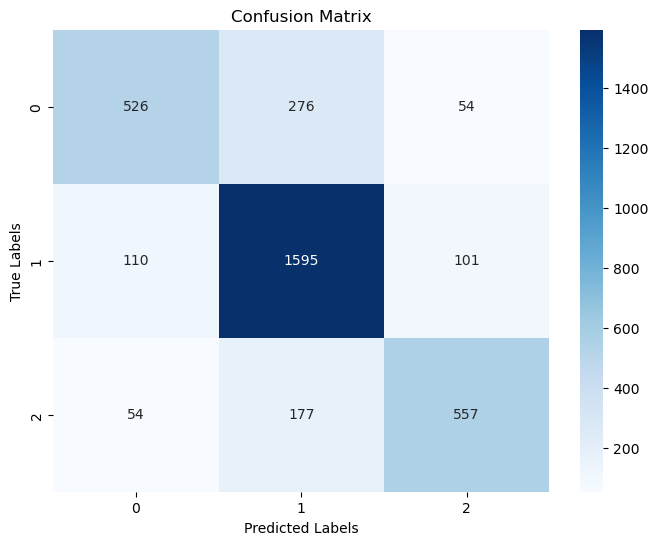

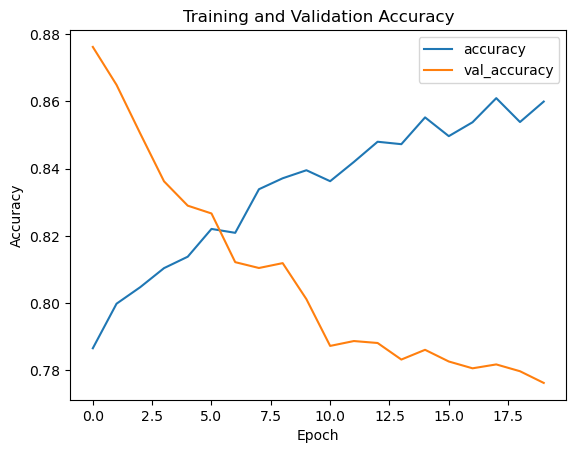

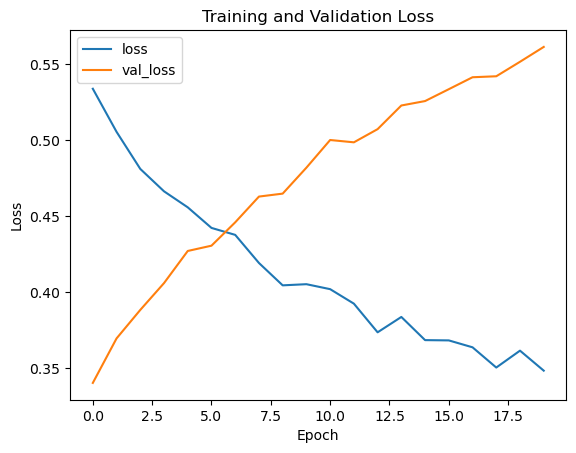

Fold 3
Epoch 1/20
216/216 [==============================] - 2s 7ms/step - loss: 0.4438 - accuracy: 0.8293 - val_loss: 0.2206 - val_accuracy: 0.9345
Epoch 2/20
216/216 [==============================] - 1s 7ms/step - loss: 0.4125 - accuracy: 0.8374 - val_loss: 0.2438 - val_accuracy: 0.9206
Epoch 3/20
216/216 [==============================] - 1s 7ms/step - loss: 0.3911 - accuracy: 0.8445 - val_loss: 0.2662 - val_accuracy: 0.9139
Epoch 4/20
216/216 [==============================] - 1s 7ms/step - loss: 0.3756 - accuracy: 0.8504 - val_loss: 0.2858 - val_accuracy: 0.8959
Epoch 5/20
216/216 [==============================] - 1s 7ms/step - loss: 0.3619 - accuracy: 0.8579 - val_loss: 0.3047 - val_accuracy: 0.8803
Epoch 6/20
216/216 [==============================] - 1s 7ms/step - loss: 0.3527 - accuracy: 0.8594 - val_loss: 0.3042 - val_accuracy: 0.8861
Epoch 7/20
216/216 [==============================] - 1s 7ms/step - loss: 0.3438 - accuracy: 0.8677 - val_loss: 0.3244 - val_accuracy: 0.8736

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.817628298057408, Validation F1 Score: 0.8152415352074822
              precision    recall  f1-score   support

    Positive       0.81      0.69      0.75       868
    Negative       0.82      0.90      0.86      1766
     Neutral       0.81      0.78      0.80       815

    accuracy                           0.82      3449
   macro avg       0.82      0.79      0.80      3449
weighted avg       0.82      0.82      0.82      3449



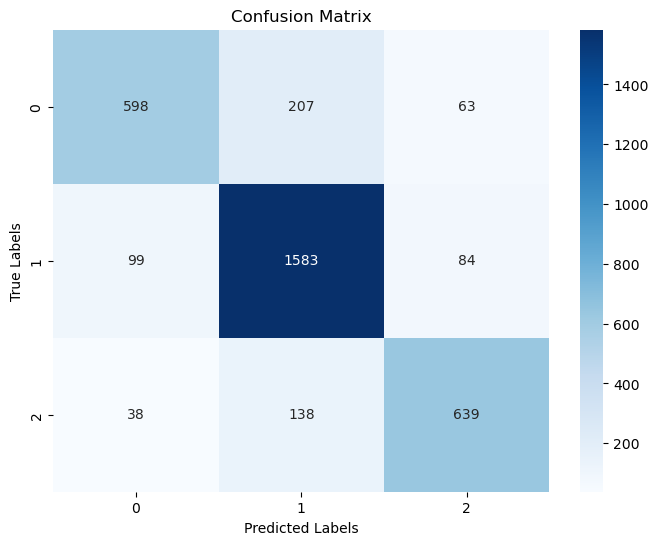

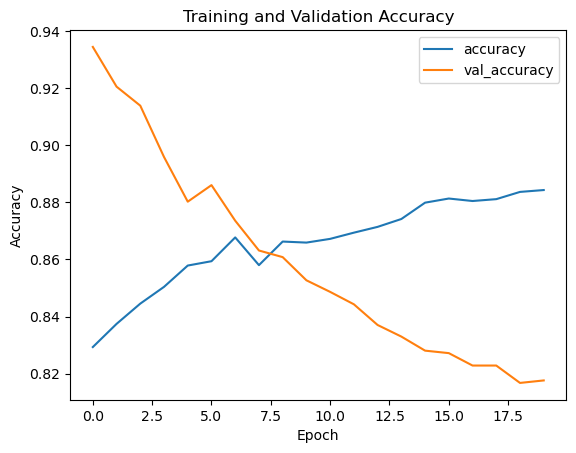

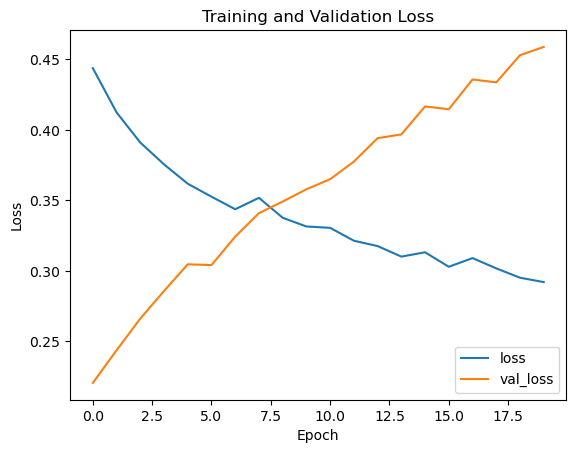

Fold 4
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 0.3992 - accuracy: 0.8464 - val_loss: 0.1681 - val_accuracy: 0.9469
Epoch 2/20
216/216 [==============================] - 1s 7ms/step - loss: 0.3531 - accuracy: 0.8622 - val_loss: 0.1825 - val_accuracy: 0.9455
Epoch 3/20
216/216 [==============================] - 2s 7ms/step - loss: 0.3347 - accuracy: 0.8679 - val_loss: 0.2021 - val_accuracy: 0.9339
Epoch 4/20
216/216 [==============================] - 2s 7ms/step - loss: 0.3189 - accuracy: 0.8771 - val_loss: 0.2120 - val_accuracy: 0.9249
Epoch 5/20
216/216 [==============================] - 1s 7ms/step - loss: 0.3090 - accuracy: 0.8757 - val_loss: 0.2329 - val_accuracy: 0.9110
Epoch 6/20
216/216 [==============================] - 1s 7ms/step - loss: 0.3107 - accuracy: 0.8809 - val_loss: 0.2487 - val_accuracy: 0.9055
Epoch 7/20
216/216 [==============================] - 1s 7ms/step - loss: 0.3022 - accuracy: 0.8821 - val_loss: 0.2550 - val_accuracy: 0.9046

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.8390837924035952, Validation F1 Score: 0.8379354956110106
              precision    recall  f1-score   support

    Positive       0.84      0.75      0.79       875
    Negative       0.84      0.90      0.87      1765
     Neutral       0.84      0.81      0.83       809

    accuracy                           0.84      3449
   macro avg       0.84      0.82      0.83      3449
weighted avg       0.84      0.84      0.84      3449



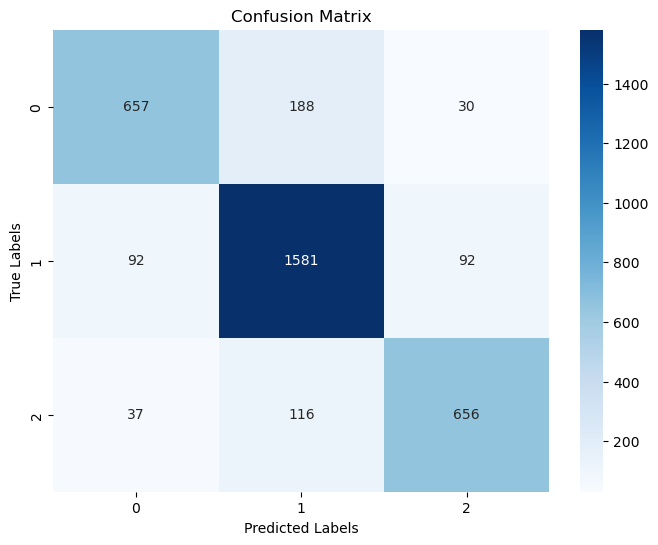

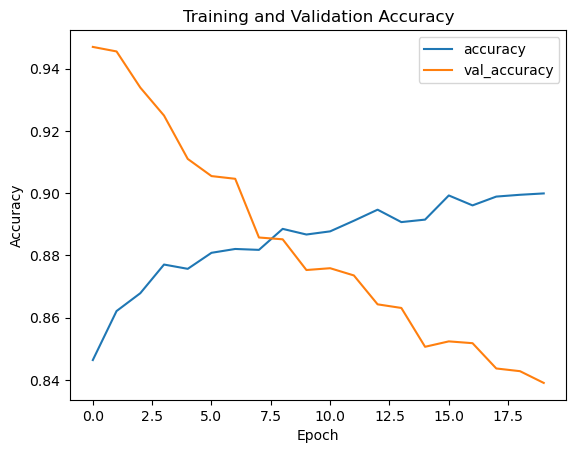

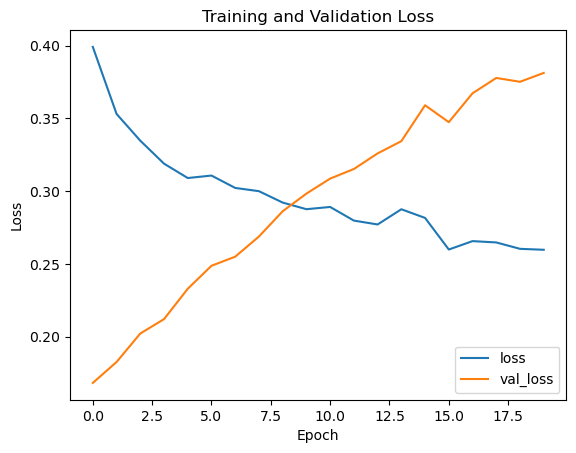

Fold 5
Epoch 1/20
216/216 [==============================] - 2s 8ms/step - loss: 0.3544 - accuracy: 0.8645 - val_loss: 0.1123 - val_accuracy: 0.9774
Epoch 2/20
216/216 [==============================] - 1s 7ms/step - loss: 0.3191 - accuracy: 0.8743 - val_loss: 0.1337 - val_accuracy: 0.9678
Epoch 3/20
216/216 [==============================] - 1s 7ms/step - loss: 0.3063 - accuracy: 0.8848 - val_loss: 0.1490 - val_accuracy: 0.9574
Epoch 4/20
216/216 [==============================] - 1s 7ms/step - loss: 0.3062 - accuracy: 0.8814 - val_loss: 0.1627 - val_accuracy: 0.9435
Epoch 5/20
216/216 [==============================] - 1s 7ms/step - loss: 0.2874 - accuracy: 0.8909 - val_loss: 0.1684 - val_accuracy: 0.9449
Epoch 6/20
216/216 [==============================] - 1s 7ms/step - loss: 0.2836 - accuracy: 0.8911 - val_loss: 0.1732 - val_accuracy: 0.9411
Epoch 7/20
216/216 [==============================] - 1s 7ms/step - loss: 0.2745 - accuracy: 0.8927 - val_loss: 0.1862 - val_accuracy: 0.9327

C:\Users\ekaad\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


108/108 [==============================] - 0s 2ms/step
Validation Accuracy: 0.884894172223833, Validation F1 Score: 0.8838555509531439
              precision    recall  f1-score   support

    Positive       0.89      0.84      0.86       854
    Negative       0.88      0.94      0.91      1808
     Neutral       0.89      0.80      0.84       787

    accuracy                           0.88      3449
   macro avg       0.89      0.86      0.87      3449
weighted avg       0.89      0.88      0.88      3449



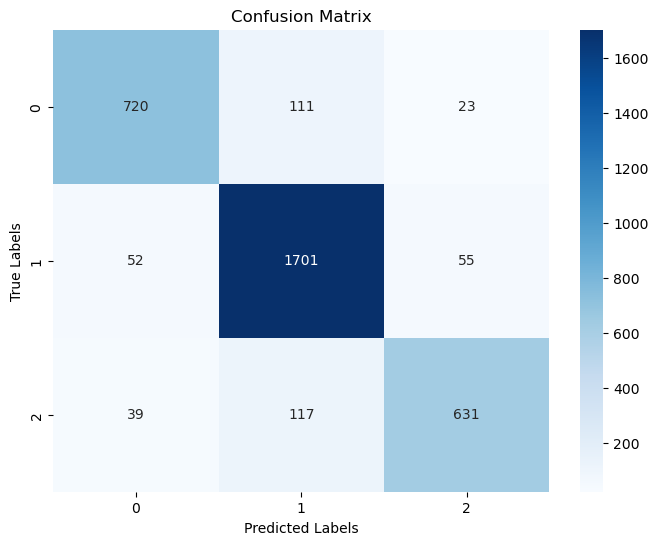

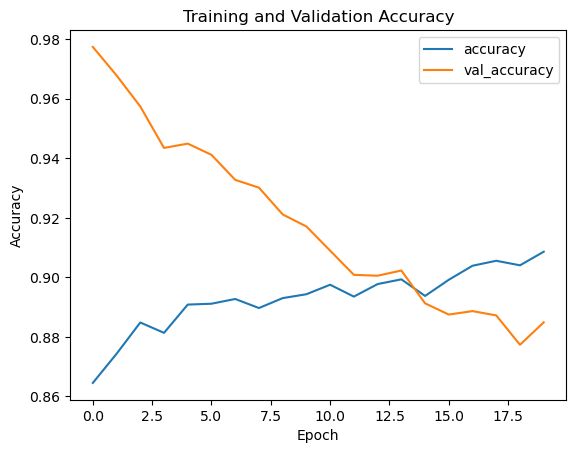

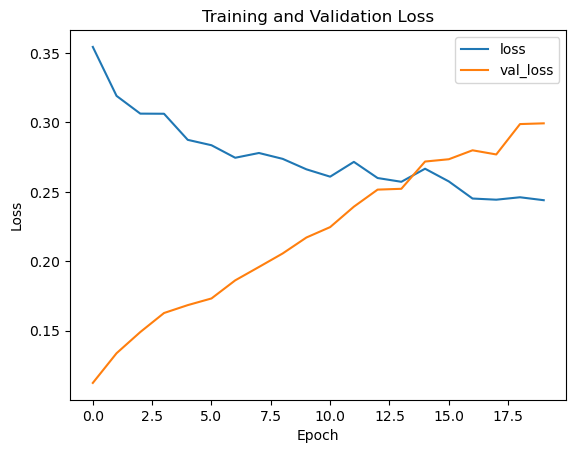

Mean Accuracy: 0.808611107609431
Mean F1 Score: 0.8058093736290353

Fold 1 Classification Report:
              precision    recall  f1-score   support

    Positive       0.69      0.57      0.63       859
    Negative       0.73      0.84      0.78      1782
     Neutral       0.75      0.63      0.69       809

    accuracy                           0.73      3450
   macro avg       0.72      0.68      0.70      3450
weighted avg       0.72      0.73      0.72      3450


Fold 2 Classification Report:
              precision    recall  f1-score   support

    Positive       0.76      0.61      0.68       856
    Negative       0.78      0.88      0.83      1806
     Neutral       0.78      0.71      0.74       788

    accuracy                           0.78      3450
   macro avg       0.77      0.73      0.75      3450
weighted avg       0.78      0.78      0.77      3450


Fold 3 Classification Report:
              precision    recall  f1-score   support

    Positive       0.81

In [22]:
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold, train_test_split
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, classification_report
import seaborn as sns
import tensorflow as tf
from tensorflow.keras.models import load_model, Model
from tensorflow.keras.layers import Input, Embedding, Conv1D, GlobalMaxPooling1D, Dense, Dropout
from graphviz import Digraph

def create_model():
    input_layer = Input(shape=(max_len,))
    embedding_layer = Embedding(input_dim=len(tokenizer.word_index) + 1, output_dim=100, input_length=max_len,
                                weights=[embedding_matrix], trainable=False)(input_layer)
    conv_layer = Conv1D(128, 3, activation='relu')(embedding_layer)
    pooling_layer = GlobalMaxPooling1D()(conv_layer)
    dropout_layer = Dropout(0.5)(pooling_layer)
    output_layer = Dense(3, activation='softmax')(dropout_layer)

    model = Model(inputs=input_layer, outputs=output_layer)
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# Function to plot confusion matrix
def plot_confusion_matrix(y_true, y_pred, labels):
    cm = confusion_matrix(y_true, y_pred, labels=labels)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title('Confusion Matrix')
    plt.show()

## Start Modeling
model = create_model()

accuracy_scores = []
f1_scores = []
precisions = []
recalls = []
classification_reports = []  # Store classification reports for each fold

kfold = KFold(n_splits=5, shuffle=True, random_state=42)

for fold, (train_indices, val_indices) in enumerate(kfold.split(text, y), 1):
    print(f'Fold {fold}')

    X_train, X_val = text[train_indices], text[val_indices]
    y_train, y_val = y[train_indices], y[val_indices]

    # Train model or load model from previous fold
    if fold > 1:
        model = load_model(f"model_fold{fold - 1}.h5")

    # Train model
    history = model.fit(X_train, y_train, epochs=20, batch_size=64, validation_data=(X_val, y_val))
    model.save(f"model_fold{fold}.h5")

    # Evaluate model
    y_pred = np.argmax(model.predict(X_val), axis=1)
    accuracy = accuracy_score(y_val, y_pred)
    f1 = f1_score(y_val, y_pred, average='weighted')
    accuracy_scores.append(accuracy)
    f1_scores.append(f1)
    print(f"Validation Accuracy: {accuracy}, Validation F1 Score: {f1}")

    # Generate classification report with labels
    report = classification_report(y_val, y_pred, labels=[0, 1, 2], target_names=['Positive', 'Negative', 'Neutral'])
    classification_reports.append(report)
    print(report)

    # Plot confusion matrix, save plots, and show
    cm = confusion_matrix(y_val, y_pred, labels=[0, 1, 2])
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=[0, 1, 2], yticklabels=[0, 1, 2])
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title('Confusion Matrix')
    plt.show()

    # Plot training history, save plots, and show
    plt.plot(history.history['accuracy'], label='accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.legend()
    plt.show()

    plt.plot(history.history['loss'], label='loss')
    plt.plot(history.history['val_loss'], label='val_loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss')
    plt.legend()
    plt.show()

    # Generate flowchart
    dot = Digraph(comment='Model Flowchart')
    dot.node('A', 'Input')
    dot.node('B', 'Embedding')
    dot.node('C', 'Conv1D')
    dot.node('D', 'GlobalMaxPooling1D')
    dot.node('E', 'Dropout')
    dot.node('F', 'Dense')

    dot.edges(['AB', 'BC', 'CD', 'DE', 'EF'])
    dot.render(f'flowchart_fold{fold}', format='png', cleanup=True)

# Print mean evaluation metrics across all folds
print(f'Mean Accuracy: {np.mean(accuracy_scores)}')
print(f'Mean F1 Score: {np.mean(f1_scores)}')

# Print the classification reports for each fold
for idx, report in enumerate(classification_reports, 1):
    print(f"\nFold {idx} Classification Report:")
    print(report)


In [26]:
data = pd.read_csv('dataset_skripsi_clean_labeling_fix.csv',delimiter=';')
data

,Unnamed: 0,text,label
0,0,pesan gusdur jabat ikhlas prabowo,positive
1,1,sambung sesi debat pangung ngawur,negative
2,2,teori penting ikhlas sosok pimpin idola presid...,positive
3,3,anak muda indonesia butuh pimpin pandai rangka...,neutral
4,4,refleksi pakde nyata bismillah indonesia butuh,positive
...,...,...,...
17242,17303,tertawa data bps yohanes mnjabat tingkat miski...,neutral
17243,17304,nathanizqian orang jawa tau kakak,neutral
17244,17305,nampancoklat orang jateng kadrun masuk kepala,neutral
17245,17306,prabowo uzurngurus rumah tanga beranta urus ne...,neutral


In [27]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
sentimen_negatif = data[data['label'] == 'negative']['text'].str.cat(sep=' ')
sentimen_positif = data[data['label'] == 'positive']['text'].str.cat(sep=' ')
sentimen_netral = data[data['label'] == 'neutral']['text'].str.cat(sep=' ')

In [28]:
def create_wordcloud(text, title):
    wordcloud = WordCloud(width=800, height=400, random_state=42, max_font_size=100, background_color='black').generate(text)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(title)
    plt.show()

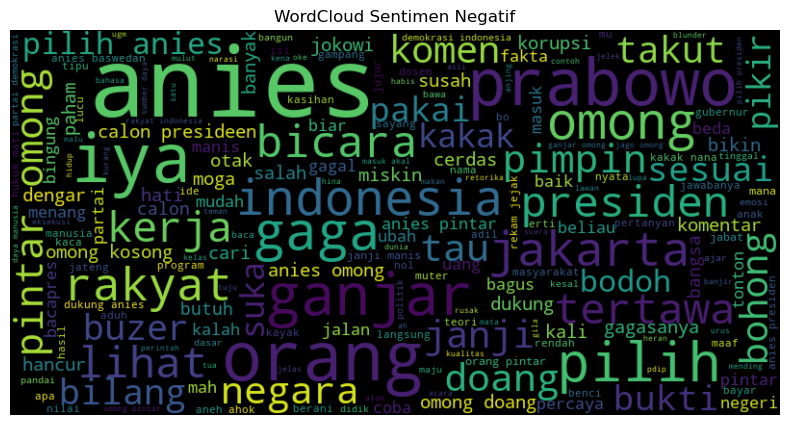

In [29]:
# Membuat WordCloud untuk sentimen negatif
create_wordcloud(sentimen_negatif, 'WordCloud Sentimen Negatif')

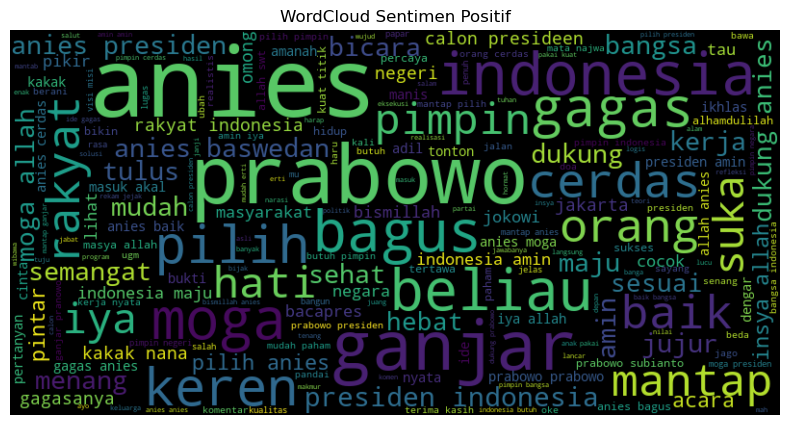

In [30]:
# Membuat WordCloud untuk sentimen positif
create_wordcloud(sentimen_positif, 'WordCloud Sentimen Positif')

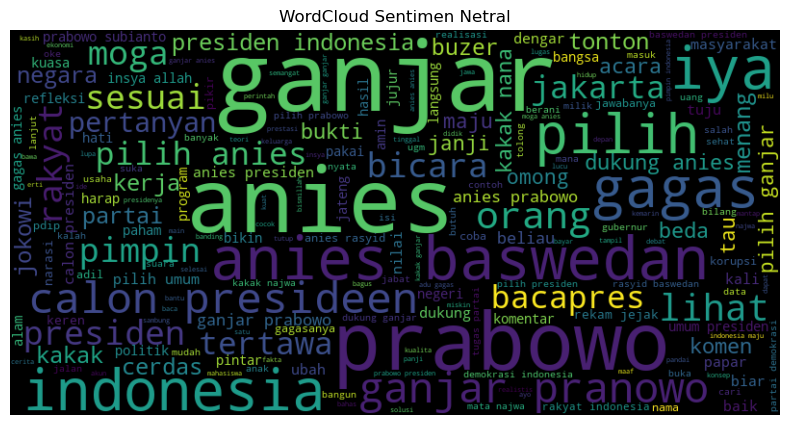

In [31]:
# Membuat WordCloud untuk sentimen netral
create_wordcloud(sentimen_netral, 'WordCloud Sentimen Netral')

In [33]:
from keras.preprocessing.sequence import pad_sequences
import numpy as np

# Function to predict new texts and evaluate their accuracy
def predict_and_evaluate(model, tokenizer, max_len, new_texts, true_labels=None):
    # Tokenize and pad the new texts
    new_sequences = tokenizer.texts_to_sequences(new_texts)
    new_padded_sequences = pad_sequences(new_sequences, maxlen=max_len, padding='post')

    # Perform prediction using the model
    predicted_probabilities = model.predict(new_padded_sequences)

    # Get the predicted labels
    predicted_labels_index = np.argmax(predicted_probabilities, axis=1)
    predicted_labels = label_encoder.classes_[predicted_labels_index]

    # Display the prediction results
    for i, new_text in enumerate(new_texts):
        print(f'Text: {new_text}')
        print(f'Predicted Label: {predicted_labels[i]}')
        print('Prediction Probabilities:')
        for label, prob in zip(label_encoder.classes_, predicted_probabilities[i]):
            print(f'{label}: {prob:.4f}')

        print('\n')

# Example new texts and true labels (optional)
new_texts = [
    "Pembangunan saat ini semakin bagus dan keren.",
    "Proyek ini tidak efisien dan mengecewakan.",
    "iya lihat ganjar muka sinis enak"
]
true_labels = ['positif', 'negatif', 'positif']

# Predict and evaluate each new text
predict_and_evaluate(model, tokenizer, max_len, new_texts, true_labels)


1/1 [==============================] - 0s 23ms/step
Text: Pembangunan saat ini semakin bagus dan keren.
Predicted Label: positive
Prediction Probabilities:
negative: 0.0001
neutral: 0.0051
positive: 0.9948


Text: Proyek ini tidak efisien dan mengecewakan.
Predicted Label: neutral
Prediction Probabilities:
negative: 0.2624
neutral: 0.7322
positive: 0.0054


Text: iya lihat ganjar muka sinis enak
Predicted Label: negative
Prediction Probabilities:
negative: 0.7457
neutral: 0.1882
positive: 0.0661


